In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import glob
from os import path
import xarray as xr
from matplotlib.colors import Normalize
import sys
from mpl_toolkits.basemap import Basemap
from collections import Counter
from sklearn.linear_model import LinearRegression
sys.path.append('../')
from mmctools.helper_functions import calc_uv
from mmctools.helper_functions import calc_wind
from mmctools.wrf.utils import Tower, tsout_seriesReader
from pydicts.obsdict import read_AWOS, AWOS_to_ds
from pydicts.baybreezedict import DetectBayBreeze

# Read in ASOS data:

In [3]:
asos_path = '/Users/hawbecke/Research/Chesapeake/Data/Obs/ASOS/5min/ASOS_2019to2020.nc'
if path.exists(asos_path):
    print('loading in full dataset!')
    asos_ds = xr.open_dataset(asos_path)
else:
    print('Please run AWOS_Station_Locations notebook to get data')


loading in full dataset!


# Read in AWOS data:

In [4]:
awos_path = '/Users/hawbecke/Research/Chesapeake/Data/Obs/AWOS/AWOS_2019to2020.nc'
if path.exists(awos_path):
    print('loading in full dataset!')
    awos_ds = xr.open_dataset(awos_path)
else:
    print('Please run AWOS_Station_Locations notebook to get data')


loading in full dataset!


# Read in APG data:

In [5]:
apg_path = '/Users/hawbecke/Research/Chesapeake/Data/Obs/APG/APG_data_2019.nc'
if path.exists(apg_path):
    print('loading in full dataset!')
    apg_ds = xr.open_dataset(apg_path)
else:
    print('Please run AWOS_Station_Locations notebook to get data')
apg_stn_list = list(apg_ds.station.data)
for ss,apg_stn in enumerate(apg_stn_list):
    if apg_stn == 'PAA':
        apg_stn_list[ss] = 'APG'
apg_ds = apg_ds.assign_coords({'station': apg_stn_list})
non_apg_list = apg_stn_list.copy()
non_apg_list.remove('APG')
apg_ds = apg_ds.drop_sel(station=non_apg_list)
apg_ds = apg_ds.drop(['rh','gust','radt','rain','alt'])

loading in full dataset!


# Combine AWOS and APG:

In [6]:
temp = awos_ds.sel(station='APG').combine_first(apg_ds)
temp = temp.squeeze()
temp = temp.expand_dims('station')

lat_da = xr.DataArray([float(apg_ds.lat)], dims=('station'))
lon_da = xr.DataArray([float(apg_ds.lon)], dims=('station'))

temp = temp.assign_coords({'lat':lat_da})
temp = temp.assign_coords({'lon':lon_da})

awos_ds = awos_ds.drop_sel(station=['APG'])

awos_ds = xr.merge([awos_ds,temp])

if obs_type == 'ASOS':
    if path.exists('{}ASOS_Allsites_2000to2019.nc'.format(fdir)):
        print('loading in full dataset!')
        ds_stn = xr.open_dataset('{}ASOS_Allsites_2000to2019.nc'.format(fdir))
    else:
        df = pd.read_csv('{}{}'.format(fdir,f_asos),parse_dates=True,index_col=['valid','station'] )

        df = df[~df.index.duplicated()]

        ds_stn = df.to_xarray()

        stn_lon = []
        stn_lat = []
        for ss in ds_stn.get_index('station'):
            stn_lon.append(np.nanmax(ds_stn.sel(station=ss).lon))
            stn_lat.append(np.nanmax(ds_stn.sel(station=ss).lat))
        nstations = np.shape(ds_stn.get_index('station'))[0]

        ds_stn['lon'] = (['station'],stn_lon)
        ds_stn['lat'] = (['station'],stn_lat)
        ds_stn = ds_stn.assign_coords(lat=ds_stn.lat).assign_coords(lon=ds_stn.lon).rename({'valid':'datetime'})
        ds_stn['tmpc'] = (ds_stn['tmpf']-32.0)*(5.0/9.0)
        ds_stn['dwpt'] = (ds_stn['dwpf']-32.0)*(5.0/9.0)

        # Dict defined as onshore_min, onshore_max
        onshore_dict = {'2W6':[5,150], 
                        'APG':[50,200], 
                        'BWI':[60,160], 
                        'CGS':[np.nan,np.nan], 
                        'DMH':[80,160], 
                        'DMW':[np.nan,np.nan], 
                        'FDK':[np.nan,np.nan], 
                        'FME':[65,125], 
                        'GAI':[np.nan,np.nan], 
                        'MTN':[70,190], 
                        'NAK':[20,190], 
                        'NHK':[-10,170], 
                        'NUI':[0,150], 
                        'W29':[np.nan,np.nan]}

        ds_stn['onshore_min'] = (['station'],[None]*nstations)
        ds_stn['onshore_max'] = (['station'],[None]*nstations)

        for stn in ds_stn.station.data: 
            ds_stn.onshore_min.loc[stn] = onshore_dict[stn][0]
            ds_stn.onshore_max.loc[stn] = onshore_dict[stn][1]

        region = ['coastal','coastal','coastal','coastal','coastal','inland','inland',
                  'coastal','inland','coastal','coastal','coastal','coastal','inland']
        ds_stn['region'] = (['station'],region)

        ds_stn['wspd'] = ds_stn['sknt']*0.514444444444
        ds_stn = ds_stn.rename_vars({'drct':'wdir'})
        ds_stn['pcip'] = ds_stn['p01i']
        ds_stn = ds_stn.drop('p01i')
        ds_stn.to_netcdf('{}ASOS_Allsites_2000to2019.nc'.format(fdir),'w')

# Plot combined AWOS and ASOS near-shore stations and IAD

In [7]:
buoy_ds = xr.open_dataset('/Users/hawbecke/Research/Chesapeake/Data/Obs/Buoy/combined_buoy_data_res_2019.nc')

In [8]:
awos_near_shore_stations  = []
asos_near_shore_stations  = []
for stn in awos_ds.get_index('station'):
    if awos_ds.sel(station=stn).region.data == 'coastal':
        awos_near_shore_stations.append(stn)
                                         
for stn in asos_ds.get_index('station'):
    if asos_ds.sel(station=stn).region.data == 'coastal':
        asos_near_shore_stations.append(stn)


both_near_shore_stations = []
for stn in awos_near_shore_stations:
    if stn in asos_near_shore_stations:
        both_near_shore_stations.append(stn)

for stn in both_near_shore_stations:
    if stn in awos_near_shore_stations:
        awos_near_shore_stations.remove(stn)
    if stn in asos_near_shore_stations:
        asos_near_shore_stations.remove(stn)

station_dict = {}
for stn in awos_near_shore_stations:
    station_dict[stn] = {'lat':float(awos_ds.sel(station=stn).lat.data),
                         'lon':float(awos_ds.sel(station=stn).lon.data),
                         'min':float(awos_ds.sel(station=stn).onshore_min.data),
                         'max':float(awos_ds.sel(station=stn).onshore_max.data),
                           #'c':'#e3e022'}
                           'c':'goldenrod'}
for stn in asos_near_shore_stations:
    station_dict[stn] = {'lat':float(awos_ds.sel(station=stn).lat.data),
                         'lon':float(awos_ds.sel(station=stn).lon.data),
                         'min':float(awos_ds.sel(station=stn).onshore_min.data),
                         'max':float(awos_ds.sel(station=stn).onshore_max.data),
                           'c':'b'}
for stn in both_near_shore_stations:
    station_dict[stn] = {'lat':float(awos_ds.sel(station=stn).lat.data),
                         'lon':float(awos_ds.sel(station=stn).lon.data),
                         'min':float(awos_ds.sel(station=stn).onshore_min.data),
                         'max':float(awos_ds.sel(station=stn).onshore_max.data),
                           'c':'coral'}


/Users/hawbecke/.conda/envs/pyhawbeck/lib/python3.7/site-packages/ipykernel_launcher.py:8: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  
/Users/hawbecke/.conda/envs/pyhawbeck/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  if sys.path[0] == '':
/Users/hawbecke/.conda/envs/pyhawbeck/lib/python3.7/site-packages/ipykernel_launcher.py:24: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
/Users/hawbecke/.conda/envs/pyhawbeck/lib/python3.7/site-packages/ipykernel_launcher.py:28: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.


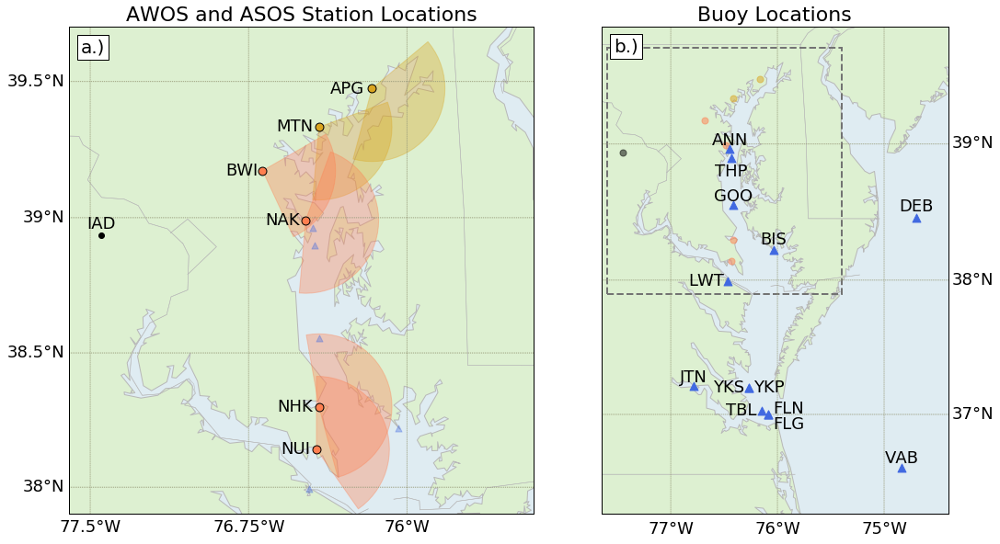

In [9]:
fig, ax = plt.subplots(1, 2, figsize=(16, 8))

center_lat = 38.7
center_lon = -76.4
m1 = Basemap(projection='merc',lat_ts=center_lat,
            llcrnrlat=center_lat-0.8,urcrnrlat=center_lat+1.0,
            llcrnrlon=center_lon-1.2,urcrnrlon=center_lon+1.0, 
            resolution='i', ax=ax[0]) # use 'f' for presentations
m1.fillcontinents(color="#ddf0d1", lake_color='#ebf9ff')
m1.drawmapboundary(fill_color="#dfecf2")
m1.drawcoastlines(color='#b8b8b8')
m1.drawstates(color='#b8b8b8')

parallels = np.arange(38.0,40.1,0.5)
meridians = np.arange(-80.5,-74.9,0.75)
m1.drawparallels(parallels,labels=[True,False,True,False],color='#999c7b',size=18)
m1.drawmeridians(meridians,labels=[True,False,False,True],color='#999c7b',size=18)

center_lat = 38.5

m2 = Basemap(projection='merc',lat_ts=center_lat,
            llcrnrlat=center_lat-2.25,urcrnrlat=center_lat+1.35,
            llcrnrlon=center_lon-1.25,urcrnrlon=center_lon+2.0, 
            resolution='i', ax=ax[1]) # use 'f' for presentations
m2.fillcontinents(color="#ddf0d1", lake_color='#ebf9ff')
m2.drawmapboundary(fill_color="#dfecf2")
m2.drawcoastlines(color='#b8b8b8')
m2.drawstates(color='#b8b8b8')

parallels = np.arange(34.0,40.1,1.0)
meridians = np.arange(-80.0,-72.9,1.0)
m2.drawparallels(parallels,labels=[False,True,True,False],color='#999c7b',size=18)
m2.drawmeridians(meridians,labels=[True,False,False,True],color='#999c7b',size=18)


box_x1,box_y1 = m2(m1.llcrnrlon, m1.llcrnrlat)
box_x2,box_y2 = m2(m1.llcrnrlon, m1.urcrnrlat)
box_x3,box_y3 = m2(m1.urcrnrlon, m1.urcrnrlat)
box_x4,box_y4 = m2(m1.urcrnrlon, m1.llcrnrlat)

box_x = [box_x1,box_x2,box_x3,box_x4,box_x1]
box_y = [box_y1,box_y2,box_y3,box_y4,box_y1]

ax[1].fill(box_x,box_y,zorder=2,facecolor='None',lw=2.0,edgecolor='#737373',ls='--')
plt.tight_layout()


# Station Labels:
for stn in station_dict:
    x, y = m1(station_dict[stn]['lon'], station_dict[stn]['lat'])
    ax[0].scatter(x,y,zorder=3,facecolor=station_dict[stn]['c'],marker='o',s=80,edgecolor='k')
    ax[0].text(x*0.975,y*1.00,stn,size=18,ha='right',va='center',zorder=3)
    pts  = np.arange(station_dict[stn]['min'],station_dict[stn]['max'],5.0)
    npts = pts.size
    fill_x = [x]
    fill_y = [y]
    for dd,wdir in enumerate(pts):
        d = 270.0 - wdir    # Convert met degrees to polar
        plt_dist = -30000.0 # Met degrees are FROM dir... need negative distance!
        fill_x.append(x+plt_dist*np.cos(np.radians(d)))
        fill_y.append(y+plt_dist*np.sin(np.radians(d)))

    ax[0].fill(fill_x, fill_y,alpha=0.35,lw=None,color=station_dict[stn]['c'],zorder=2)
    x, y = m2(station_dict[stn]['lon'], station_dict[stn]['lat'])
    ax[1].scatter(x,y,zorder=3,facecolor=station_dict[stn]['c'],alpha=0.5,marker='o',s=50,lw=None,edgecolor=None)
    
x, y = m1(float(awos_ds.sel(station='IAD').lon.data), float(awos_ds.sel(station='IAD').lat.data))
ax[0].scatter(x,y,zorder=3,c='k')
ax[0].text(x,y*1.01,'IAD',size=18,ha='center',va='bottom',zorder=3)


# Station Labels:
buoys_to_plot = list(buoy_ds.station.data)
bad_buoys = ['PMC','GRF','SRP','CAM','SLM','WDC'] # On land in WRF or Obs missing data

buoy_c = 'royalblue'
for bad_buoy in bad_buoys:
    buoys_to_plot.remove(bad_buoy)
for stn in buoys_to_plot:
    buoy_lon = float(buoy_ds.sel(station=stn).lon.data)
    buoy_lat = float(buoy_ds.sel(station=stn).lat.data)
    if stn == 'JTN':
        buoy_lat, buoy_lon = 37.21137, -76.78677
    x, y = m2(buoy_lon, buoy_lat)
    ax[1].scatter(x,y,zorder=3,c=buoy_c,marker='^',s=80)
    xa,ya = 1.0,1.0
    if stn == 'ANN':
        ha,va = 'center','bottom'
        xa,ya = 1.0,1.0
    elif stn == 'THP':
        ha,va = 'center','top'
        xa,ya = 1.0,0.985
    elif stn == 'GOO':
        ha,va = 'center','bottom'
        xa,ya = 1.0,1.0
    elif stn == 'GRF':
        ha,va = 'left','center'
        xa,ya = 1.03,1.0
    elif stn == 'JTN':
        ha,va = 'center','bottom'
        xa,ya = 1.0,1.0
    elif stn == 'LWT':
        ha,va = 'right','center'
        xa,ya = 0.97,1.0
    elif stn == 'YKS':
        ha,va = 'right','center'
        xa,ya = 0.97,1.0
    elif stn == 'YKP':
        ha,va = 'left','center'
        xa,ya = 1.03,1.0
    elif stn == 'TBL':
        ha,va = 'right','center'
        xa,ya = 0.97,1.0
    elif stn == 'FLN':
        ha,va = 'left','bottom'
        xa,ya = 1.03,0.98
    elif stn == 'FLG':
        ha,va = 'left','top'
        xa,ya = 1.03,0.985
    else:
        ha,va = 'center','bottom'
        xa,ya = 1.0,1.01
    ax[1].text(x*xa,y*ya,stn,size=18,ha=ha,va=va,zorder=3)
    x, y = m1(buoy_lon, buoy_lat)
    ax[0].scatter(x,y,zorder=3,facecolor=buoy_c,alpha=0.35,marker='^',s=50,edgecolor=None)
x, y = m2(float(awos_ds.sel(station='IAD').lon.data), float(awos_ds.sel(station='IAD').lat.data))
ax[1].scatter(x,y,zorder=3,facecolor='k',alpha=0.5,marker='o',s=50,lw=None,edgecolor=None)


ax[0].tick_params(labelsize=18)
ax[0].set_title('AWOS and ASOS Station Locations',size=22)
ax[1].tick_params(labelsize=18)
ax[1].set_title('Buoy Locations',size=22)


props = dict(facecolor='w', alpha=1.0)

# place a text box in upper left in axes coords
map1_width  = m1.urcrnrlon - m1.llcrnrlon
map1_height = m1.urcrnrlat - m1.llcrnrlat
map2_width  = m2.urcrnrlon - m2.llcrnrlon
map2_height = m2.urcrnrlat - m2.llcrnrlat

txt_loc1 = m1(m1.llcrnrlon+0.025*map1_width, m1.urcrnrlat-0.025*map1_height)
txt_loc2 = m2(m2.llcrnrlon+0.035*map2_width, m2.urcrnrlat-0.022*map2_height)
ax[0].text(txt_loc1[0],txt_loc1[1], 'a.)', bbox=props, ha='left',va='top',fontsize=20)
ax[1].text(txt_loc2[0],txt_loc2[1], 'b.)', bbox=props, ha='left',va='top',fontsize=20)

plt.show()

# Start Detection

# User settings:

In [36]:
fdir      = '/Users/hawbecke/Research/Chesapeake/Data/Obs/'

obs_type = 'AWOS'

detection_methods = ['StaufferThompson2015', 'Stauffer2015', 'Sikora2010']


# Start time:     0900 Local (1300 UTC) 
start_time = pd.to_timedelta(13,unit='h')
# End time:       1600 Local (2000 UTC)
end_time   = pd.to_timedelta(20,unit='h')

year_range = np.arange(2019,2020,1)
nyears = year_range.size

# Dates (month-day) to analyze:
date_start = '01-01'
date_end   = '12-31'

light_winds = 3.08667 # m/s

sample_rate = '60min'

min_points = 3

show_plot = True

In [41]:
if obs_type == 'ASOS':
    ds_stn = asos_ds
elif obs_type == 'AWOS':
    ds_stn = awos_ds
near_shore_stations  = []
inland_station_names = []
for stn in ds_stn.get_index('station'):
    if ds_stn.sel(station=stn).region.data == 'inland':
        inland_station_names.append(stn)
    if ds_stn.sel(station=stn).region.data == 'coastal':
        near_shore_stations.append(stn)

if obs_type == 'ASOS':
    inland_station_names = ['IAD','DCA','MRB','HGR']
elif obs_type == 'AWOS':
    inland_station_names = ['IAD','CJR','GAI','FDK']


In [42]:
print(near_shore_stations)
print(inland_station_names)


['APG', 'BWI', 'MTN', 'NAK', 'NHK', 'NUI']
['IAD', 'CJR', 'GAI', 'FDK']


# Plot the stations:

In [14]:
all_stations = sorted(np.unique(['ADW', 'APG', 'BWI', 'CBE', 'CGE', 'CGS', 'CJR', 'ESN', 'FDK',
       'GAI', 'HGR', 'IAD', 'MTN', 'NAK', 'NHK', 'NUI', 'OXB', 'SBY',
       'W29', 'BWI', 'DCA', 'GED', 'HGR', 'IAD', 'ILG', 'MIV', 'MRB', 'NAK',
       'NHK', 'NUI', 'OXB', 'PHL', 'SBY', 'WAL']))

/Users/hawbecke/.conda/envs/pyhawbeck/lib/python3.7/site-packages/ipykernel_launcher.py:8: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  
/Users/hawbecke/.conda/envs/pyhawbeck/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  if sys.path[0] == '':


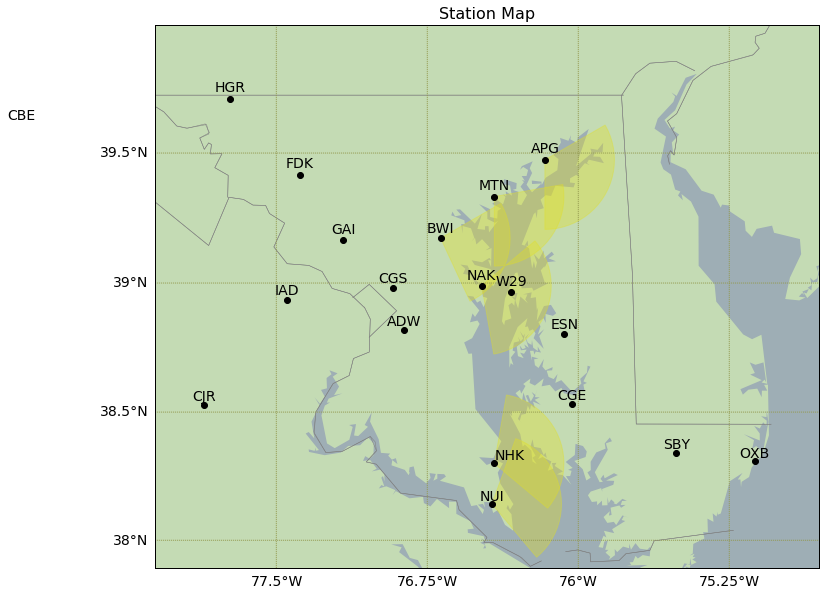

In [43]:
fig, ax = plt.subplots(1, 1, figsize=(12, 10))

center_lat = 38.690760
center_lon = -76.401987
m = Basemap(projection='merc',lat_ts=center_lat,
            llcrnrlat=center_lat-0.8,urcrnrlat=center_lat+1.3,
            llcrnrlon=center_lon-1.7,urcrnrlon=center_lon+1.6, 
            resolution='i', ax=ax) # use 'f' for presentations
m.fillcontinents(color="#c4dbb4", lake_color='#9eaeb5')
m.drawmapboundary(fill_color="#9eaeb5")
#m.drawcoastlines(color='gray')
m.drawstates(color='gray')

parallels = np.arange(38.0,40.1,0.5)
meridians = np.arange(-80.5,-74.9,0.75)
m.drawparallels(parallels,labels=[True,False,True,False],color='#93994d',size=14)
m.drawmeridians(meridians,labels=[True,False,False,True],color='#93994d',size=14)

# Station Labels:
for stn in ds_stn.station.values:
    x, y = m(ds_stn.sel(station=stn).lon, ds_stn.sel(station=stn).lat)
    ax.scatter(x,y,zorder=3,c='k')
    if stn == '2W6':
        ax.text(x,y*1.01,stn,size=14,ha='right',va='bottom')
    elif stn == 'NHK':
        ax.text(x,y*1.01,stn,size=14,ha='left',va='bottom')
    else:
        ax.text(x,y*1.01,stn,size=14,ha='center',va='bottom')
    if ~np.isnan(ds_stn.sel(station=stn).onshore_min.values.astype(float)):
        if stn == 'NAK':
            pts = np.arange(50,170.1,5.0)
        elif stn == 'NHK':
            pts = np.arange(10,130.1,5.0)
        elif stn == 'NUI':
            pts = np.arange(20,140.1,5.0)
        elif stn == 'MTN':
            pts = np.arange(80,180.1,5.0)
        elif stn == 'APG':
            pts = np.arange(60,180.1,5.0)
        else:
            pts  = np.arange(ds_stn.sel(station=stn).onshore_min.data,ds_stn.sel(station=stn).onshore_max.data,5.0)
        npts = pts.size
        fill_x = [x]
        fill_y = [y]
        for dd,wdir in enumerate(pts):
            d = 270.0 - wdir    # Convert met degrees to polar
            plt_dist = -30000.0 # Met degrees are FROM dir... need negative distance!
            fill_x.append(x+plt_dist*np.cos(np.radians(d)))
            fill_y.append(y+plt_dist*np.sin(np.radians(d)))

        plt.fill(fill_x, fill_y,alpha=0.35,lw=None,color='#e3e022')

    ax.tick_params(size=14)
    ax.set_title('Station Map',size=16)
plt.show()

# Find and validate bay breezes:

In [16]:
import pydicts.baybreezedict as bbd

starting station: APG
Year: 2019


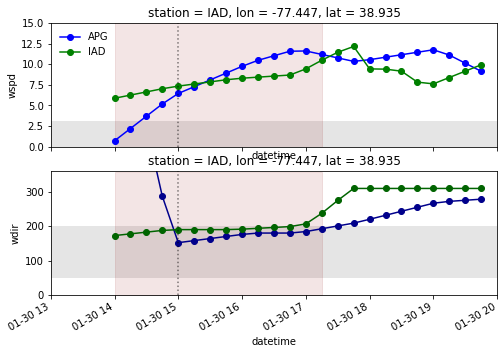

bay breeze validated for 3/19/2019


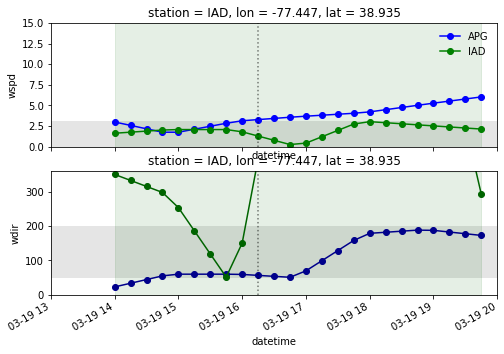

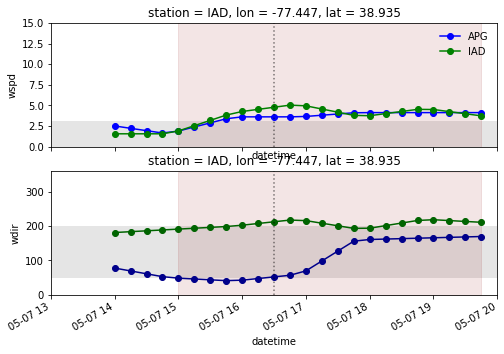

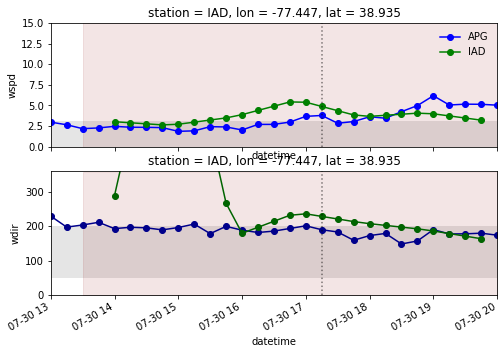

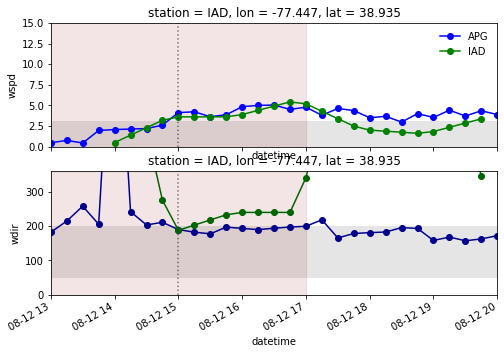

bay breeze validated for 8/20/2019


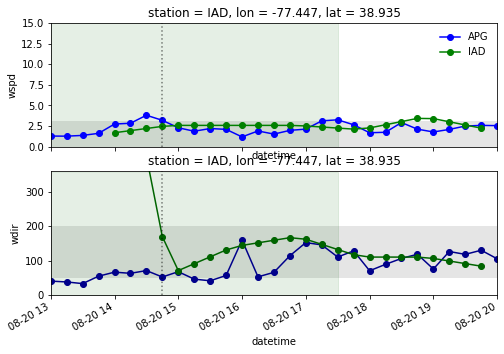

bay breeze validated for 10/28/2019


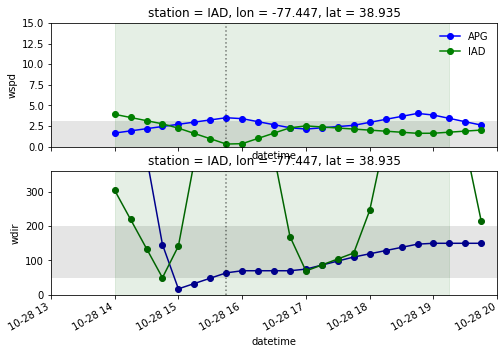

starting station: BWI
Year: 2019
bay breeze validated for 7/26/2019


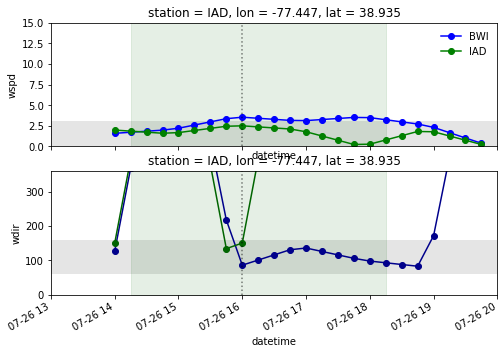

bay breeze validated for 8/20/2019


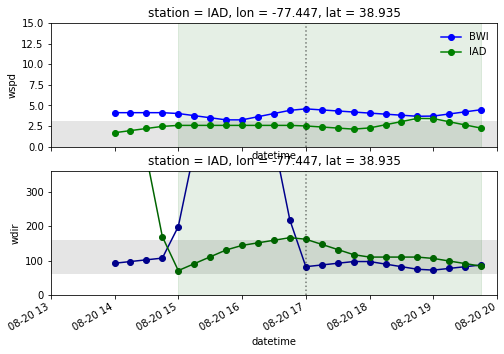

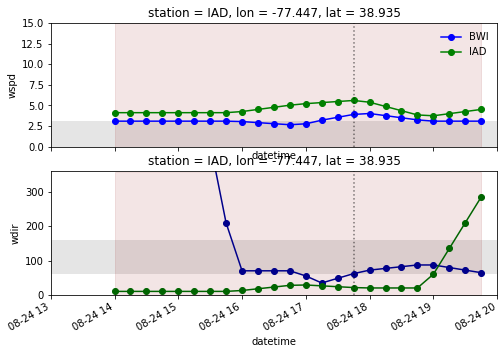

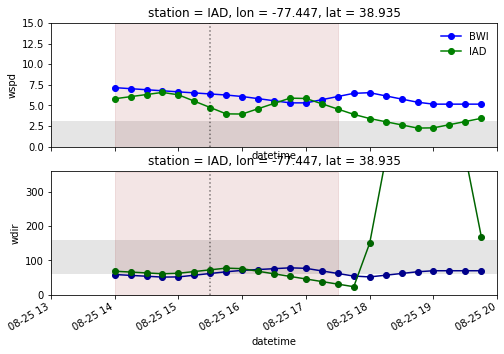

bay breeze validated for 10/28/2019


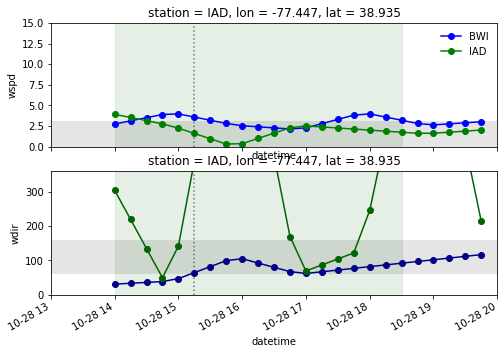

starting station: MTN
Year: 2019


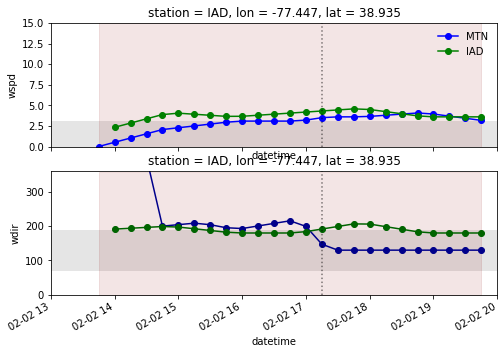

bay breeze validated for 2/4/2019


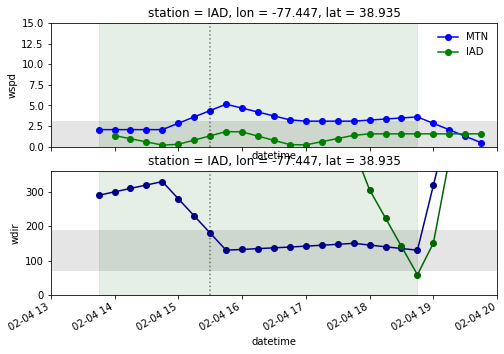

bay breeze validated for 3/19/2019


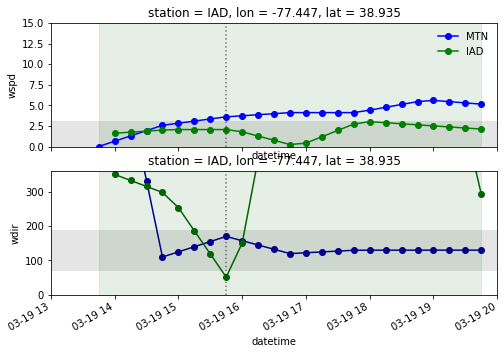

bay breeze validated for 4/6/2019


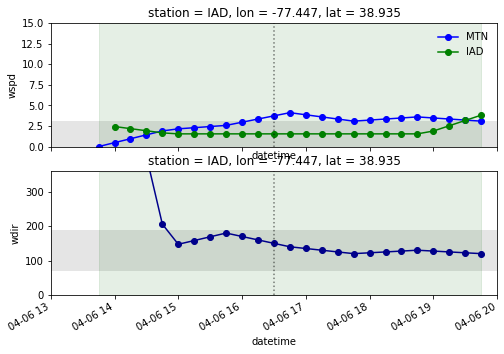

bay breeze validated for 6/17/2019


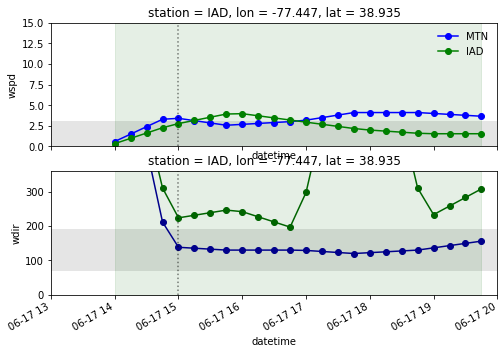

bay breeze validated for 6/26/2019


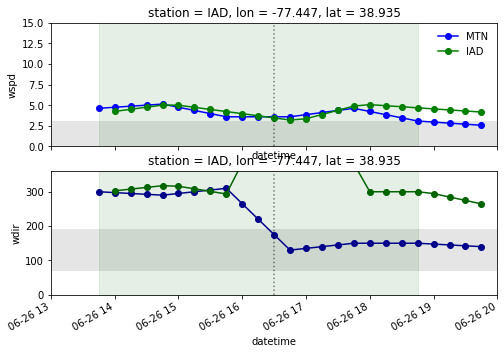

bay breeze validated for 6/27/2019


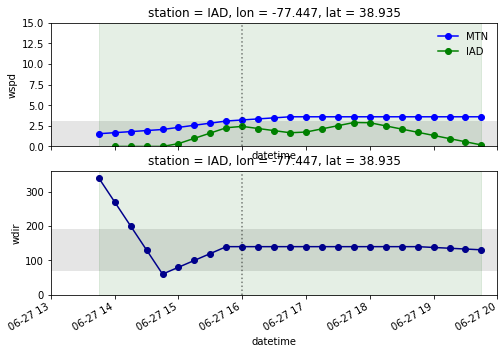

bay breeze validated for 6/28/2019


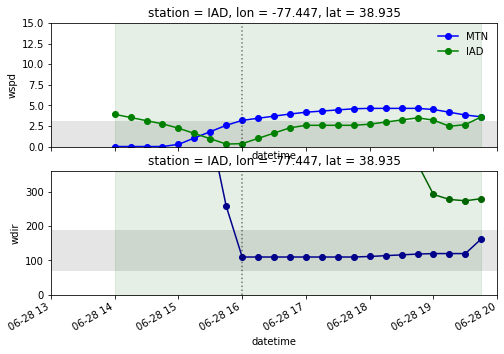

bay breeze validated for 7/9/2019


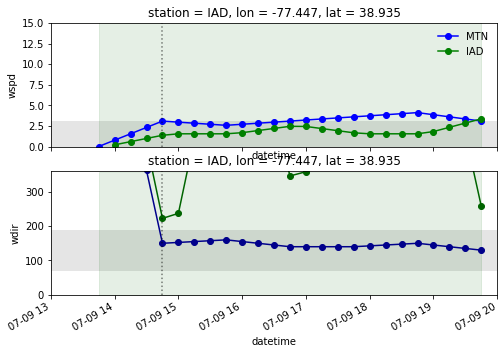

bay breeze validated for 7/15/2019


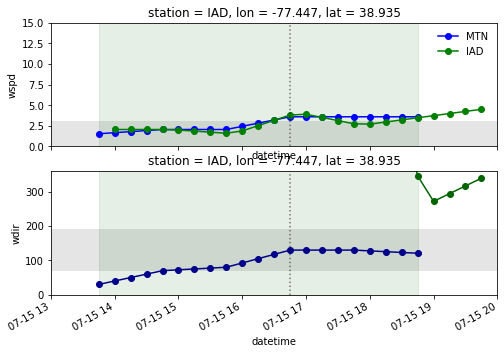

bay breeze validated for 7/19/2019


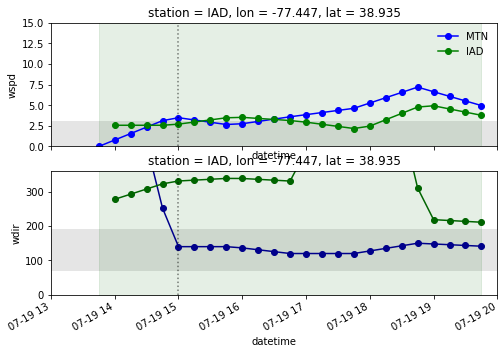

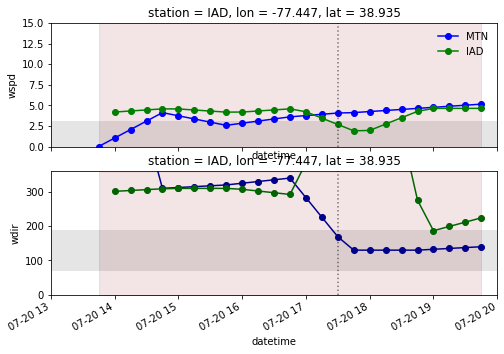

bay breeze validated for 7/26/2019


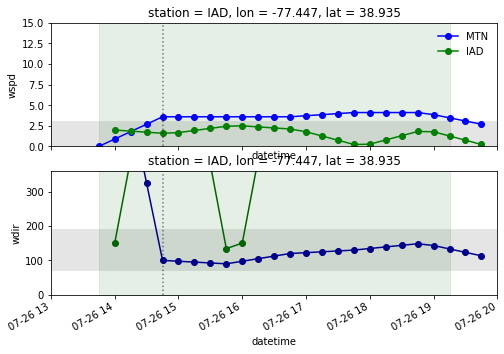

bay breeze validated for 7/27/2019


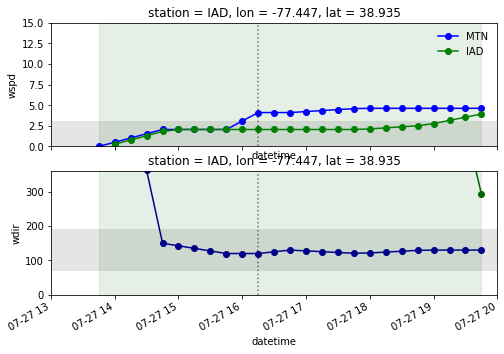

bay breeze validated for 7/29/2019


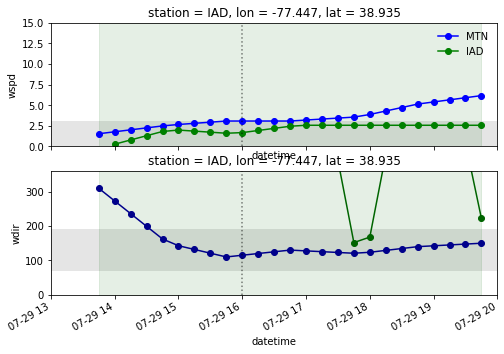

bay breeze validated for 8/1/2019


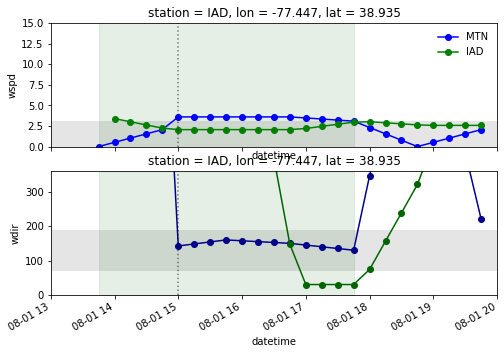

bay breeze validated for 8/3/2019


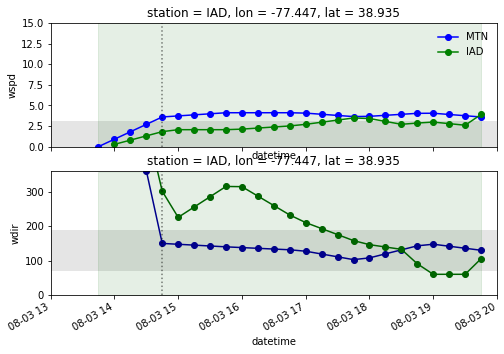

bay breeze validated for 8/11/2019


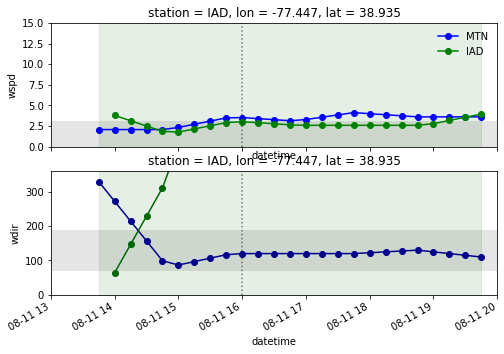

bay breeze validated for 8/12/2019


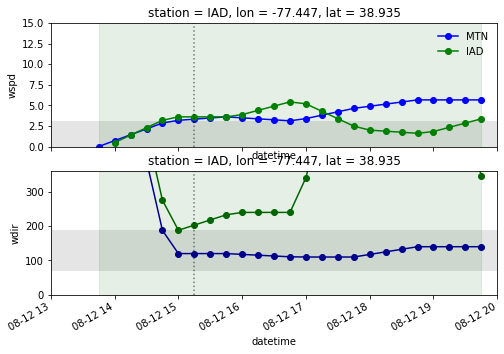

bay breeze validated for 8/19/2019


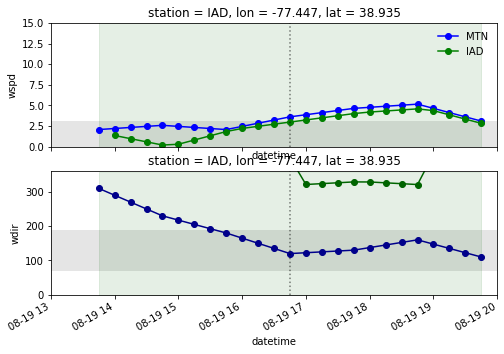

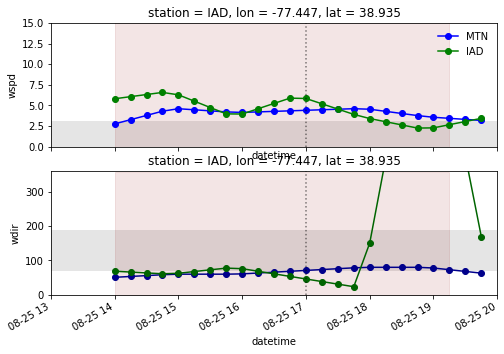

bay breeze validated for 8/30/2019


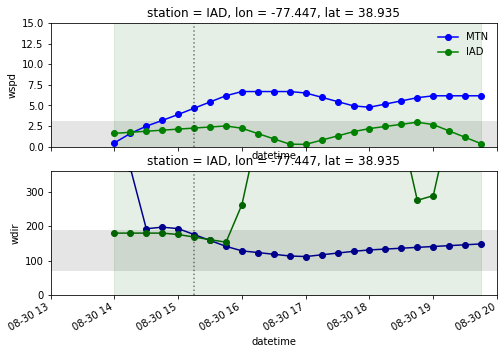

bay breeze validated for 9/11/2019


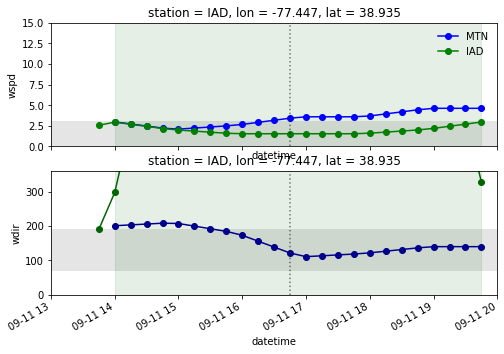

bay breeze validated for 9/18/2019


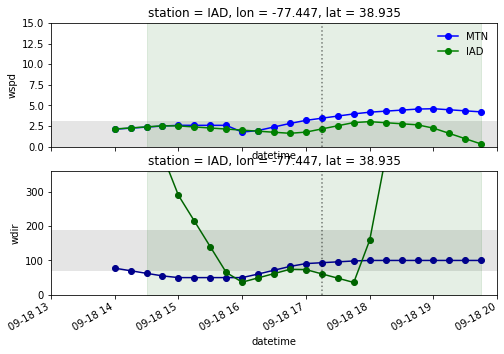

bay breeze validated for 9/20/2019


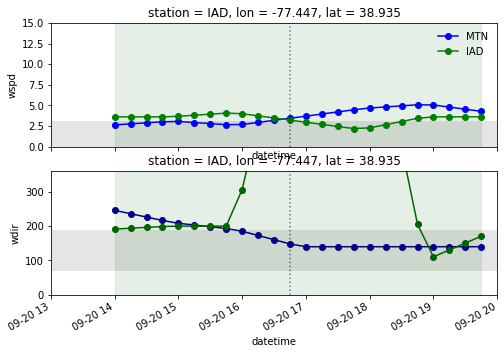

bay breeze validated for 9/22/2019


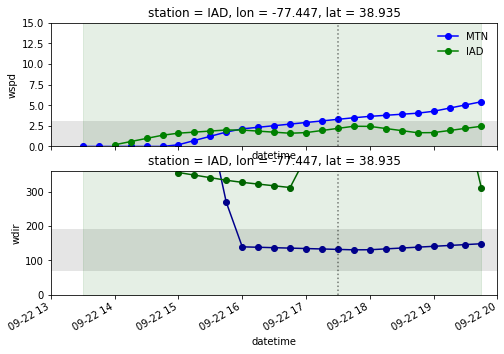

bay breeze validated for 9/25/2019


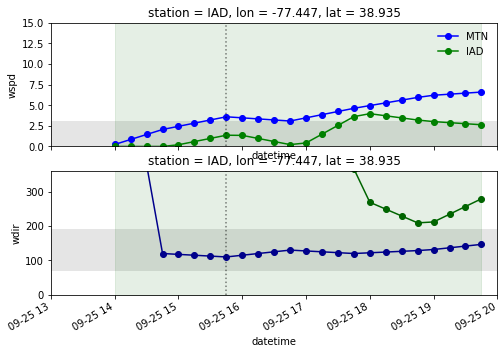

bay breeze validated for 10/19/2019


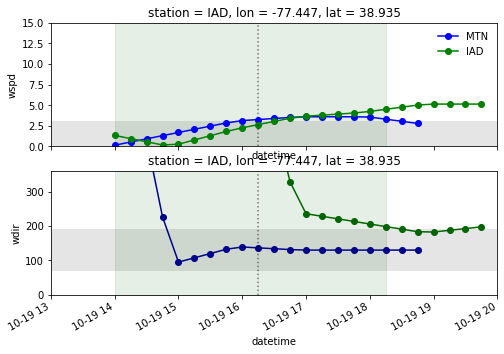

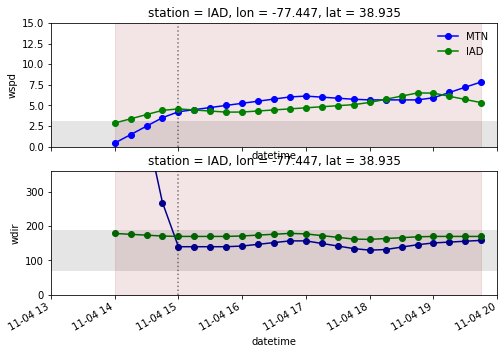

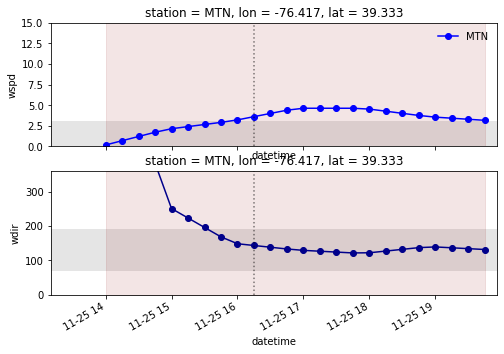

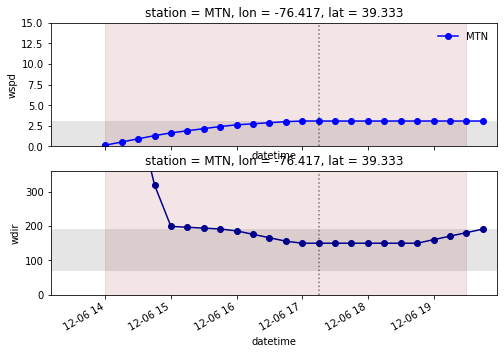

starting station: NAK
Year: 2019


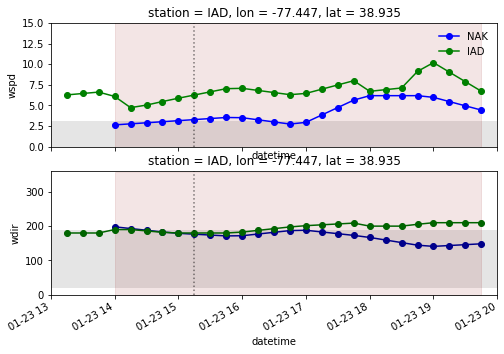

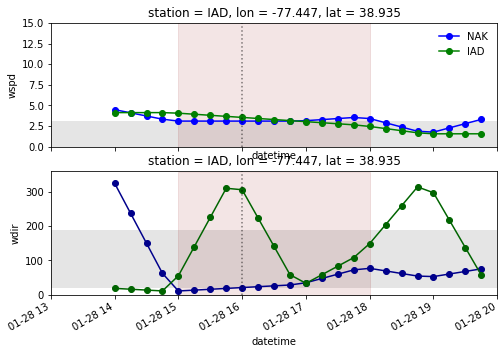

bay breeze validated for 2/5/2019


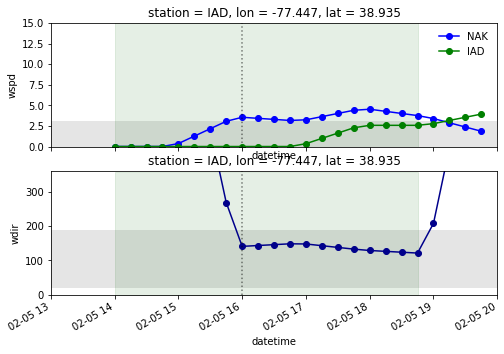

bay breeze validated for 2/10/2019


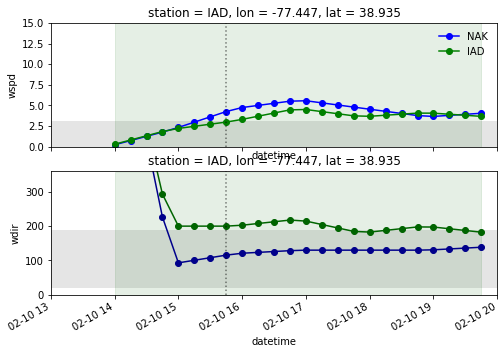

bay breeze validated for 2/14/2019


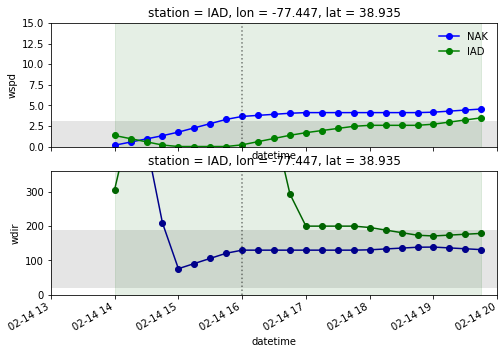

bay breeze validated for 2/28/2019


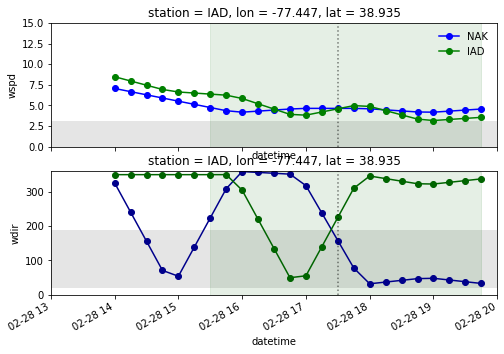

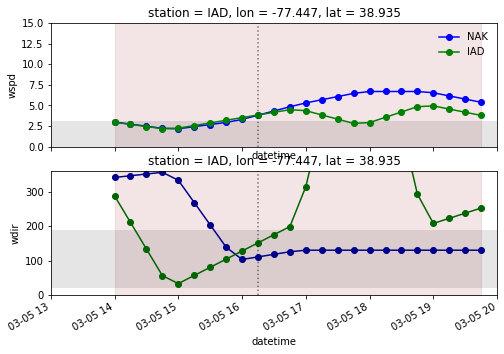

bay breeze validated for 3/19/2019


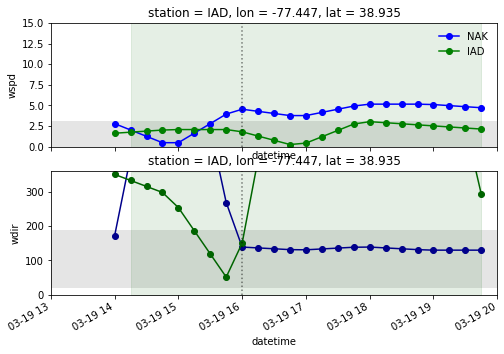

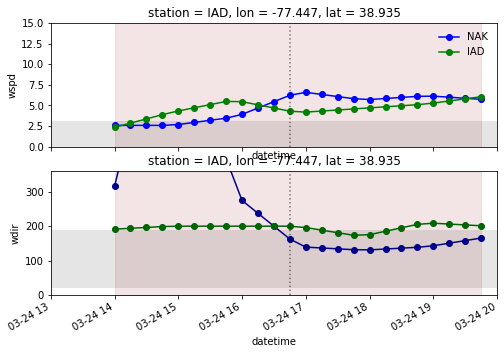

bay breeze validated for 4/6/2019


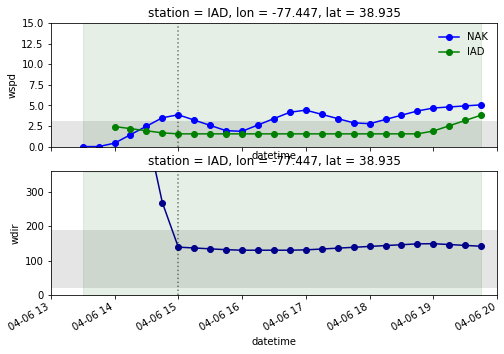

bay breeze validated for 4/17/2019


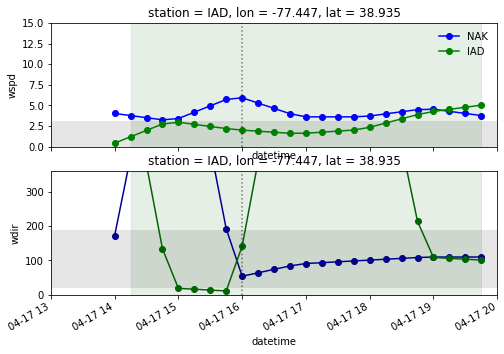

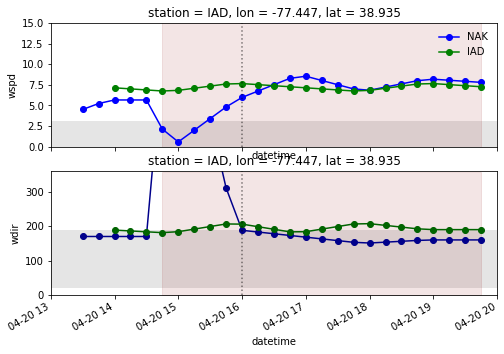

bay breeze validated for 4/21/2019


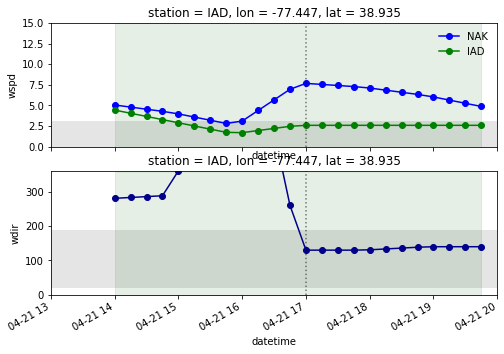

bay breeze validated for 5/2/2019


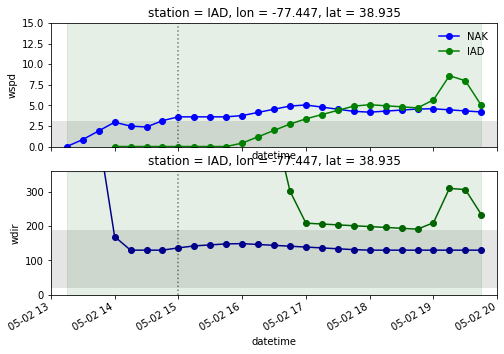

bay breeze validated for 5/6/2019


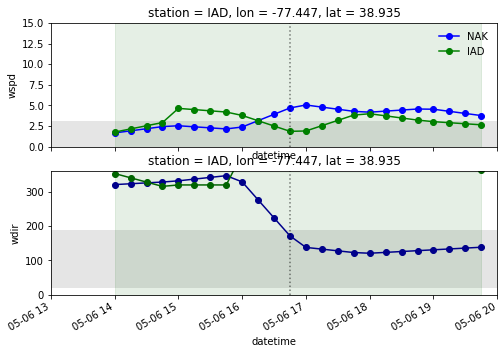

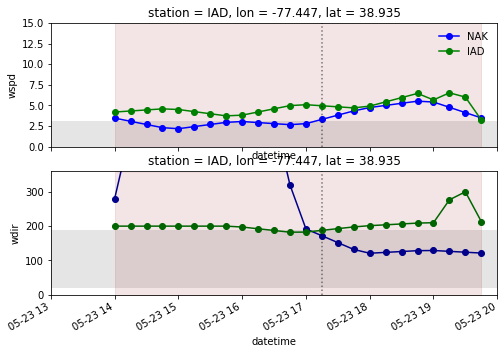

bay breeze validated for 5/30/2019


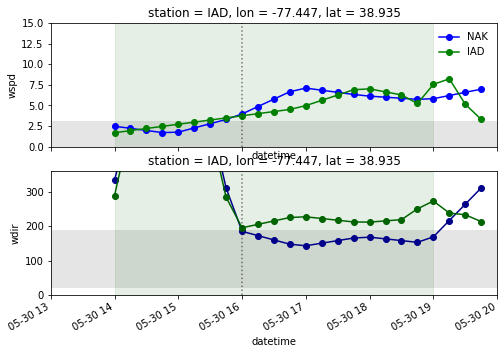

bay breeze validated for 6/17/2019


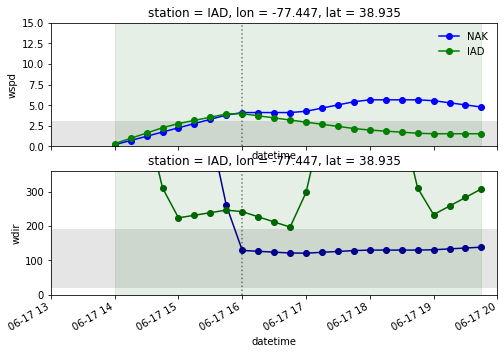

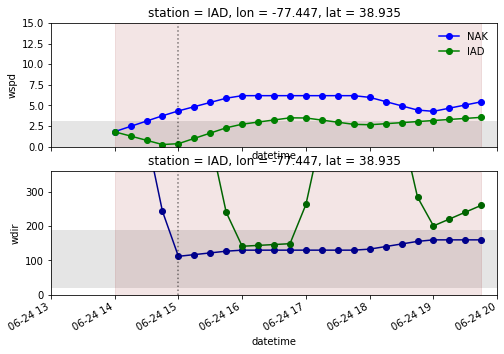

bay breeze validated for 6/26/2019


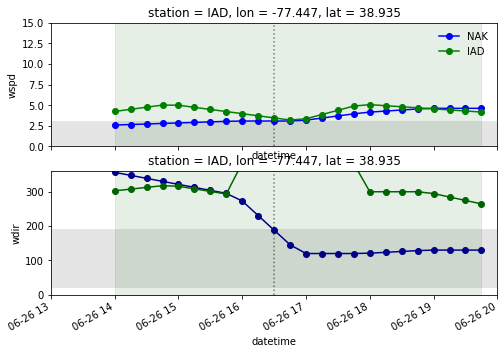

bay breeze validated for 6/27/2019


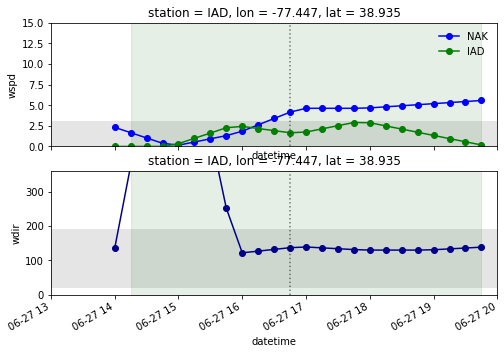

bay breeze validated for 6/28/2019


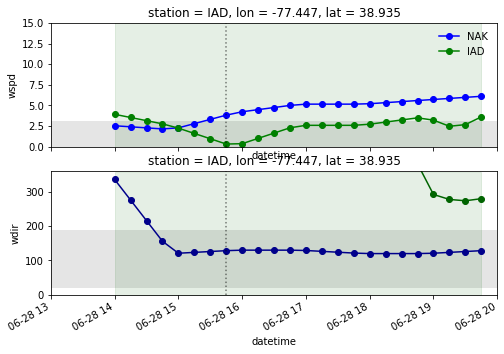

bay breeze validated for 7/9/2019


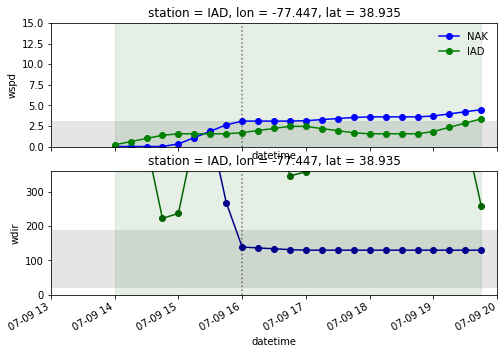

bay breeze validated for 7/15/2019


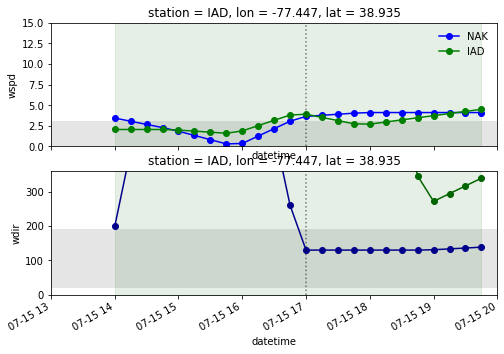

bay breeze validated for 7/17/2019


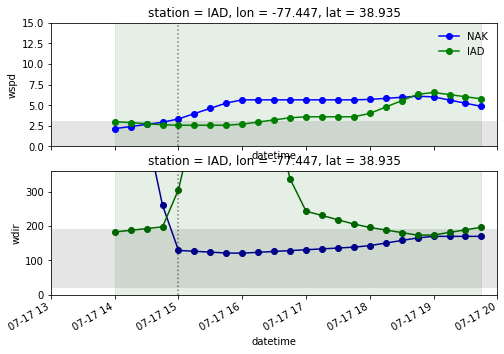

bay breeze validated for 7/19/2019


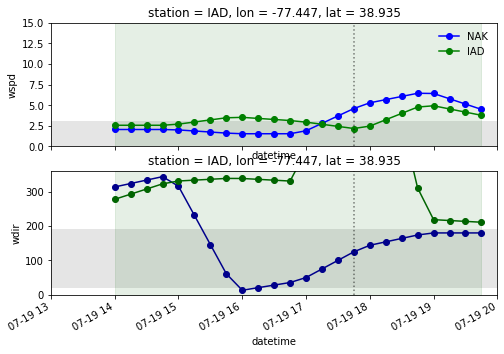

bay breeze validated for 7/26/2019


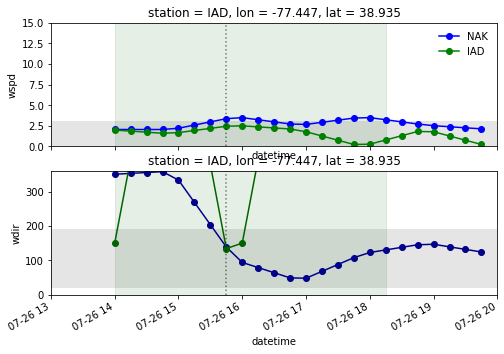

bay breeze validated for 7/28/2019


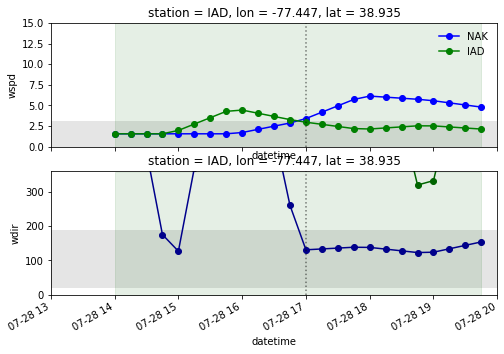

bay breeze validated for 7/29/2019


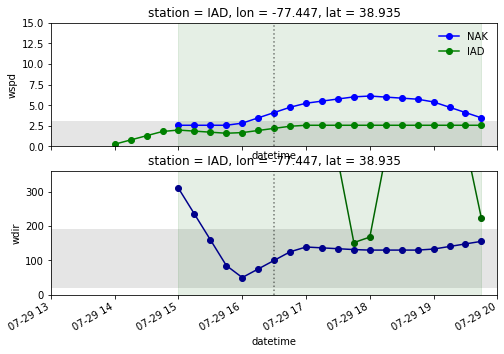

bay breeze validated for 7/31/2019


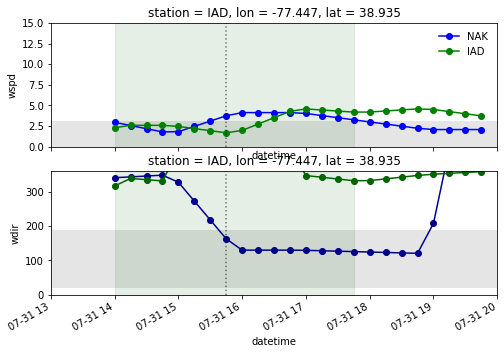

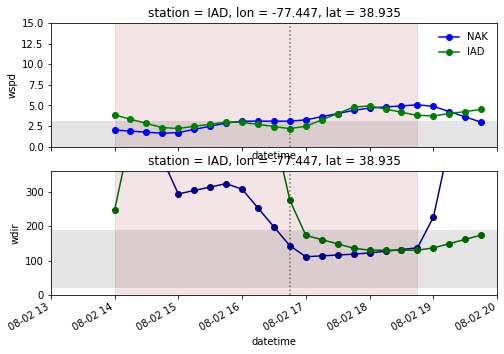

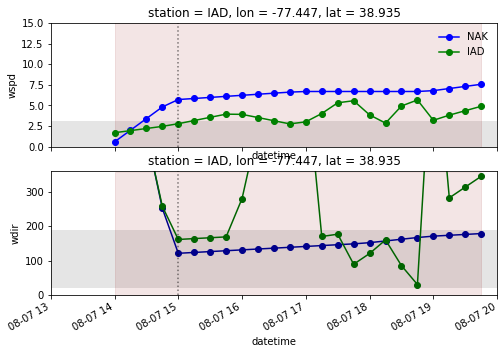

bay breeze validated for 8/11/2019


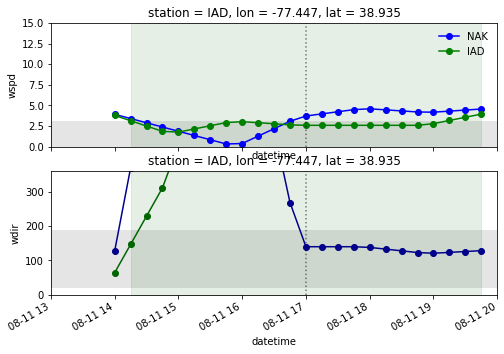

bay breeze validated for 8/19/2019


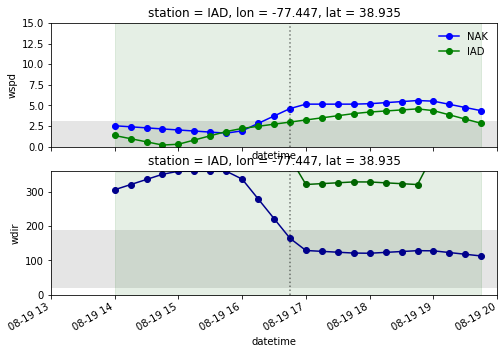

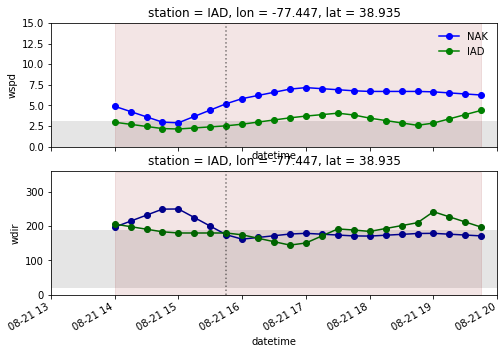

bay breeze validated for 9/7/2019


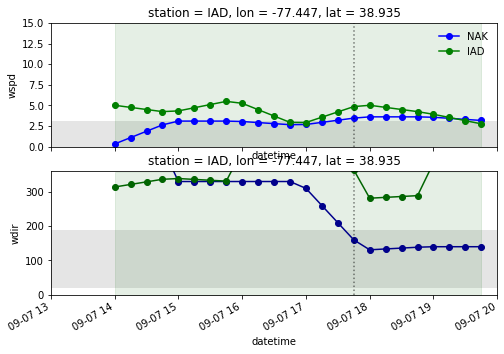

bay breeze validated for 9/8/2019


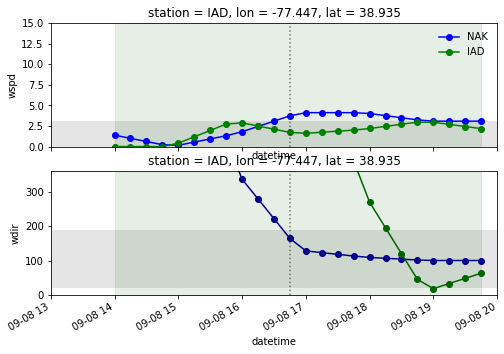

bay breeze validated for 9/11/2019


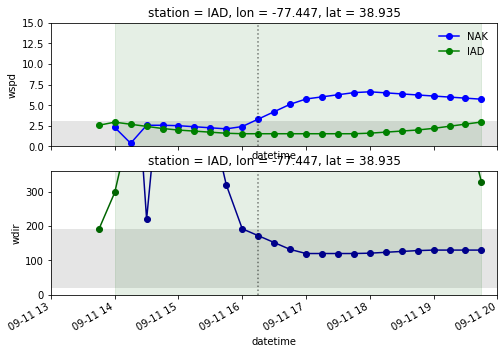

bay breeze validated for 9/16/2019


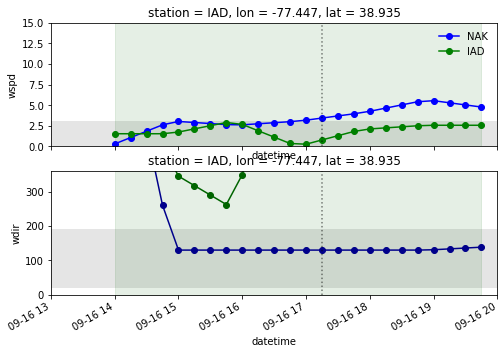

bay breeze validated for 9/20/2019


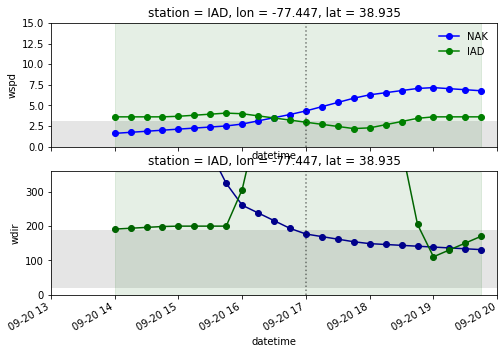

bay breeze validated for 9/21/2019


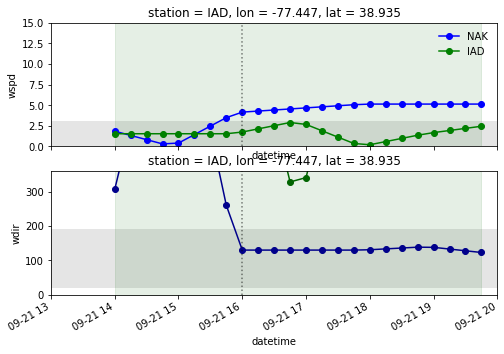

bay breeze validated for 9/23/2019


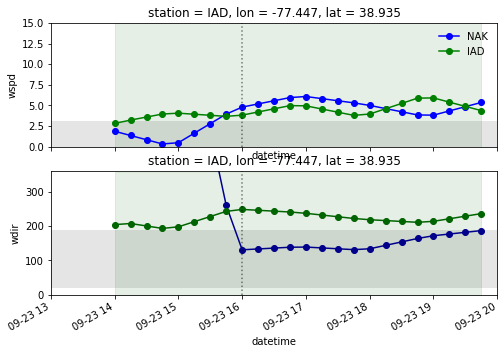

bay breeze validated for 9/25/2019


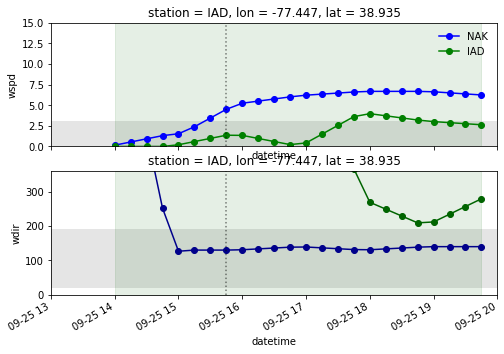

bay breeze validated for 10/7/2019


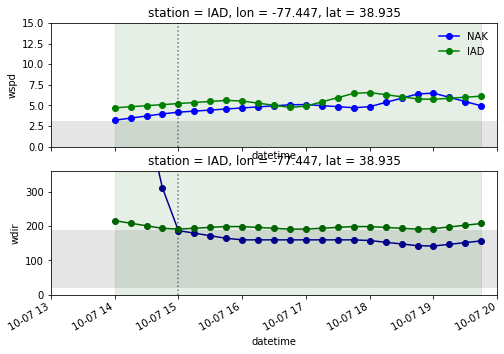

bay breeze validated for 10/24/2019


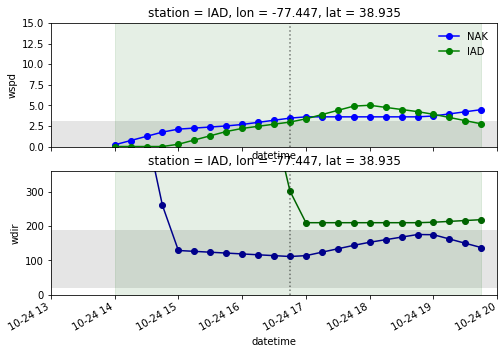

bay breeze validated for 11/2/2019


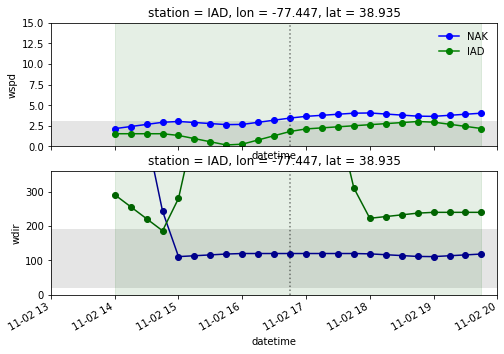

bay breeze validated for 11/6/2019


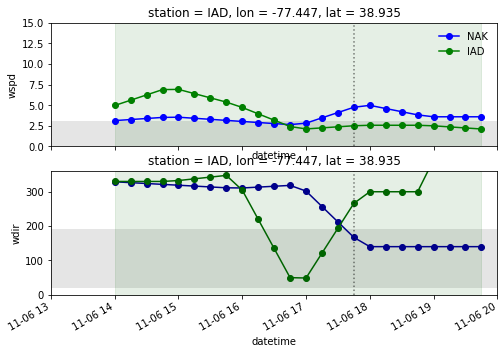

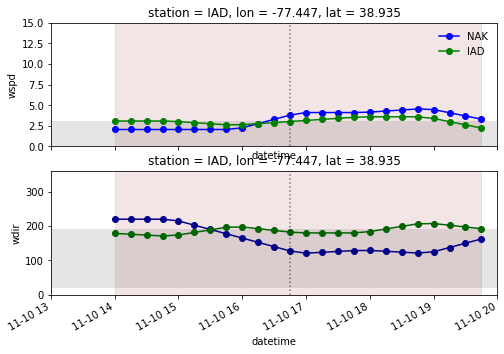

bay breeze validated for 11/11/2019


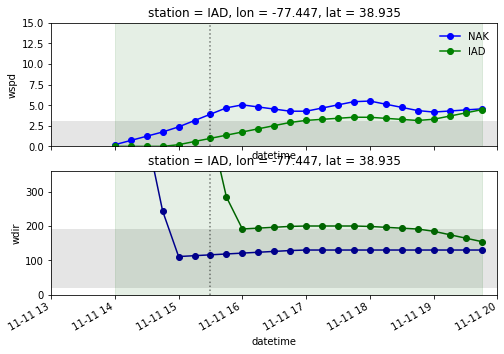

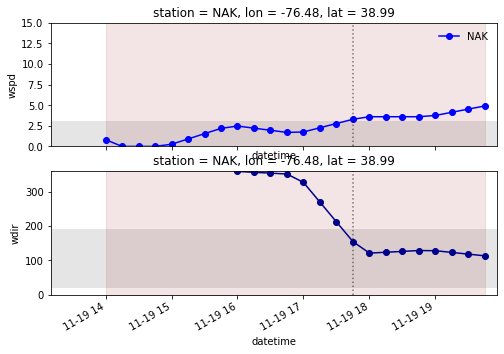

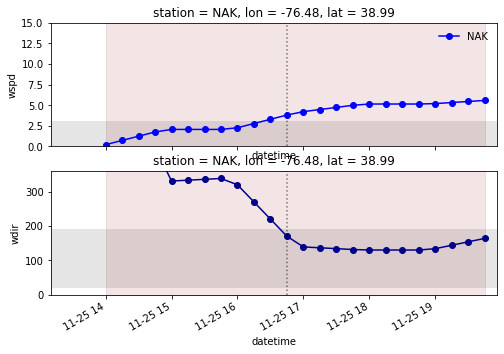

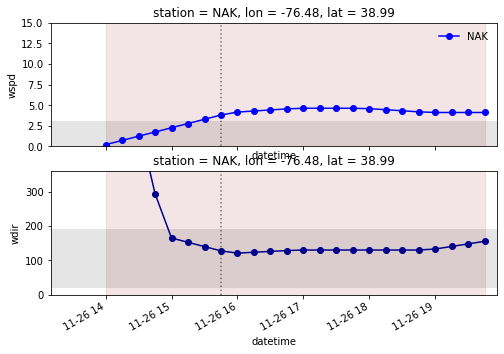

starting station: NHK
Year: 2019
bay breeze validated for 2/2/2019


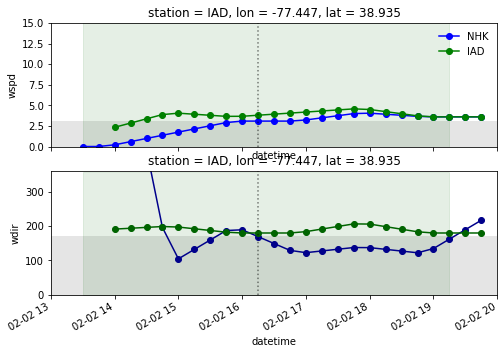

bay breeze validated for 2/10/2019


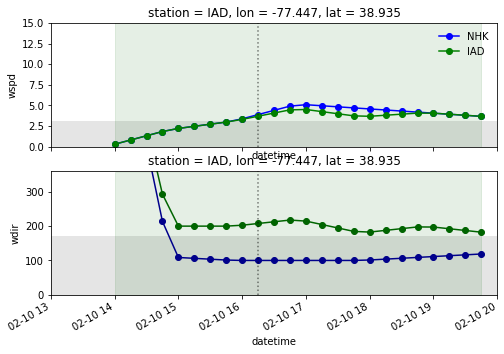

bay breeze validated for 2/14/2019


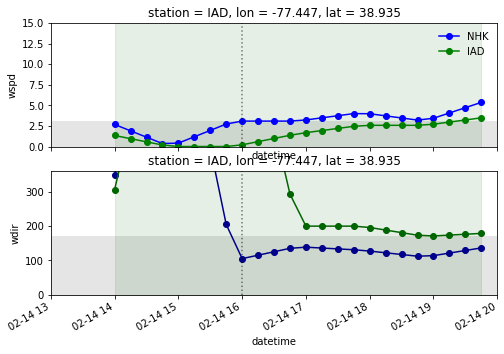

bay breeze validated for 2/26/2019


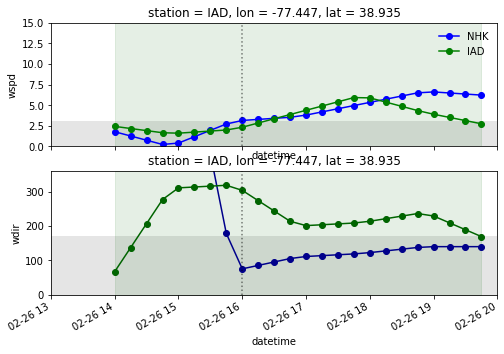

bay breeze validated for 3/14/2019


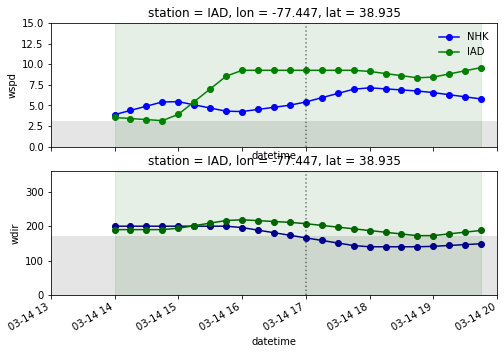

bay breeze validated for 3/17/2019


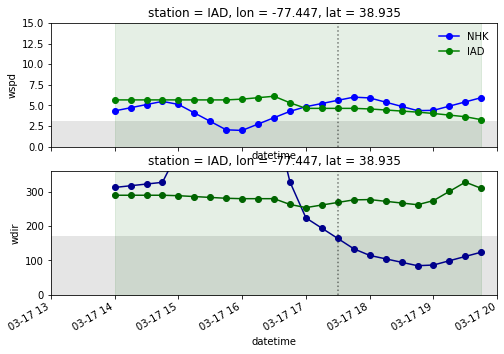

bay breeze validated for 4/1/2019


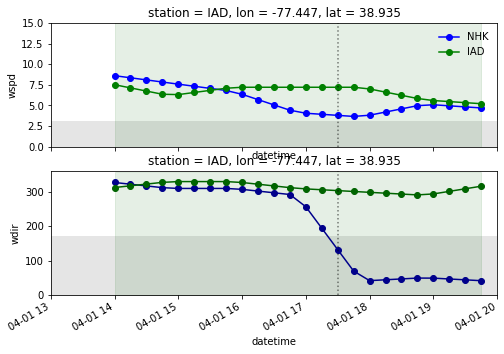

bay breeze validated for 4/10/2019


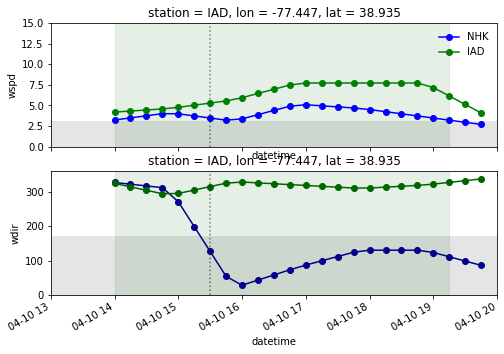

bay breeze validated for 4/21/2019


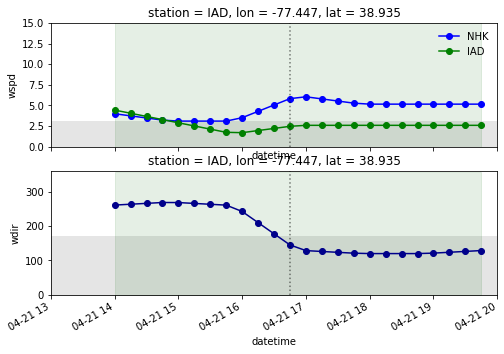

bay breeze validated for 5/7/2019


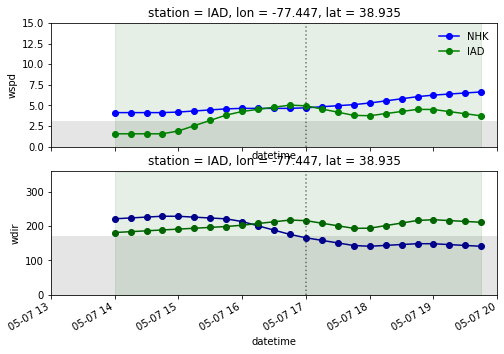

bay breeze validated for 5/16/2019


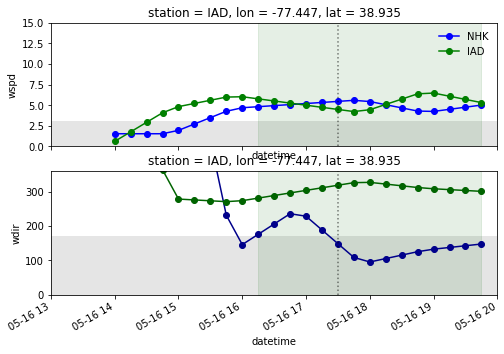

bay breeze validated for 6/17/2019


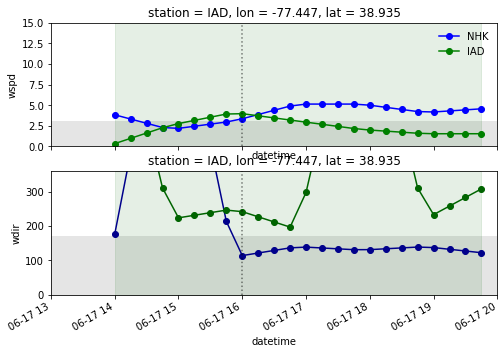

bay breeze validated for 6/23/2019


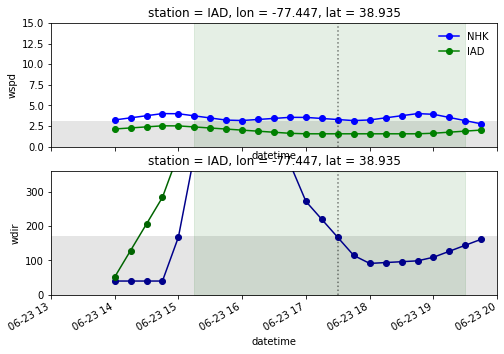

bay breeze validated for 6/24/2019


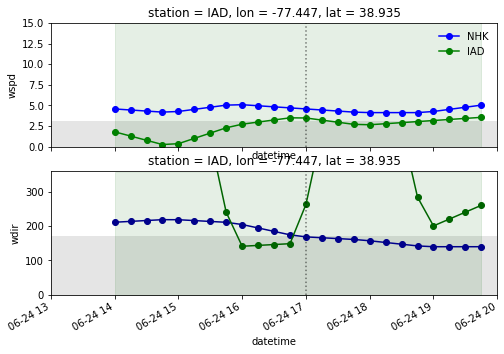

bay breeze validated for 6/28/2019


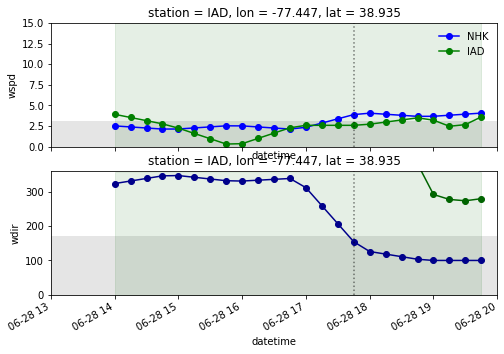

bay breeze validated for 7/10/2019


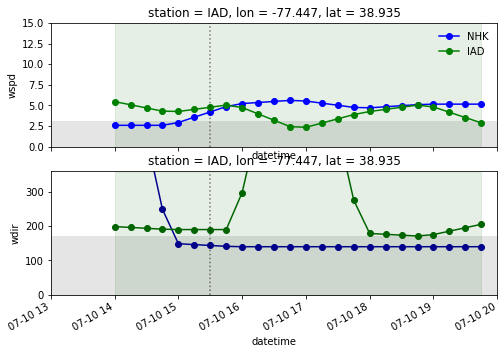

bay breeze validated for 7/16/2019


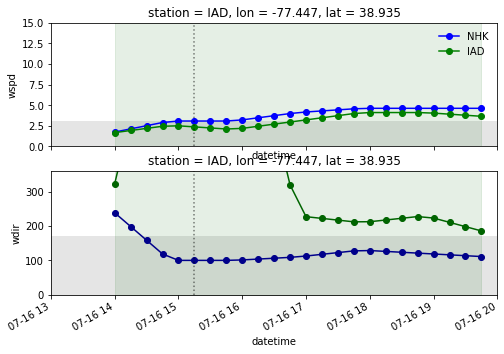

bay breeze validated for 7/19/2019


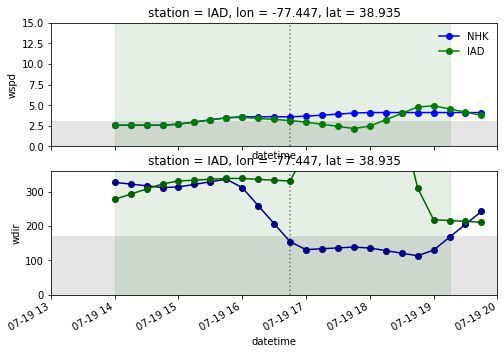

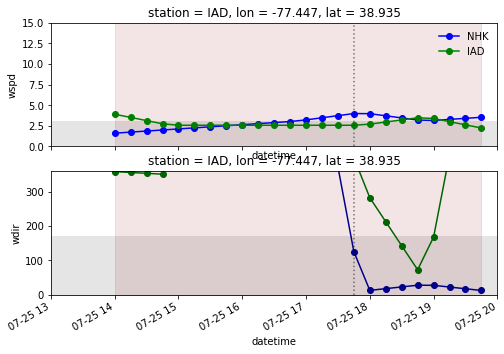

bay breeze validated for 7/27/2019


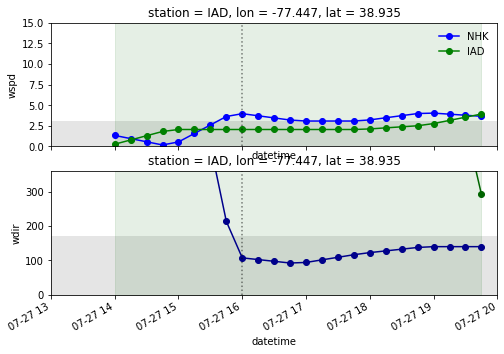

bay breeze validated for 7/28/2019


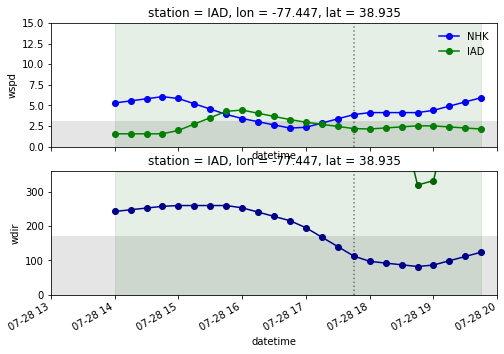

bay breeze validated for 7/29/2019


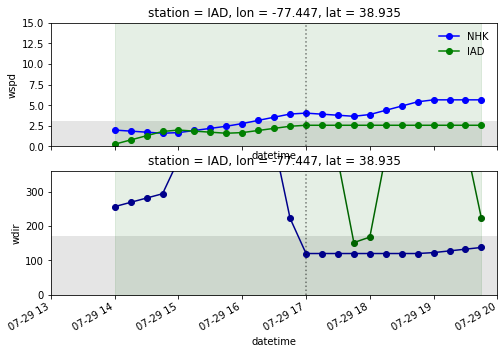

bay breeze validated for 7/30/2019


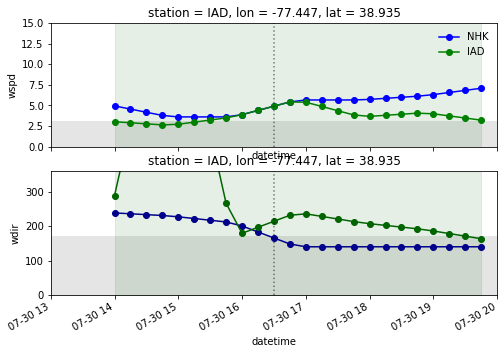

bay breeze validated for 7/31/2019


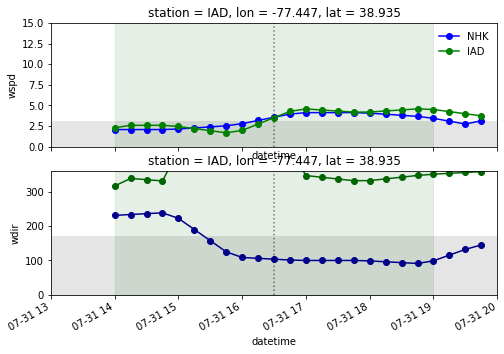

bay breeze validated for 8/1/2019


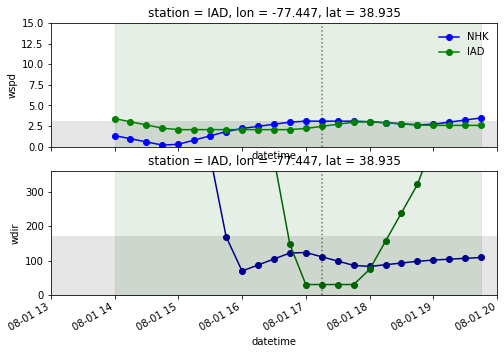

bay breeze validated for 8/17/2019


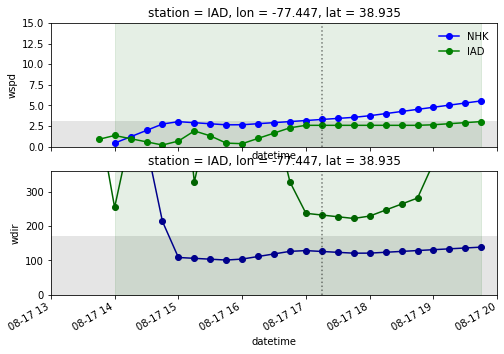

bay breeze validated for 9/16/2019


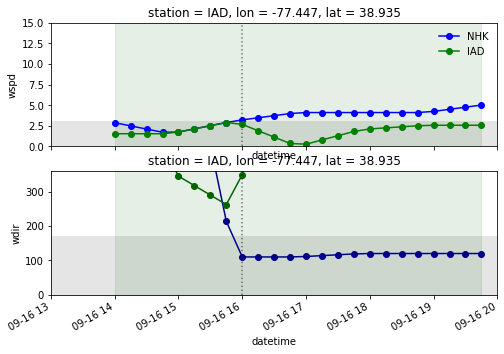

bay breeze validated for 9/20/2019


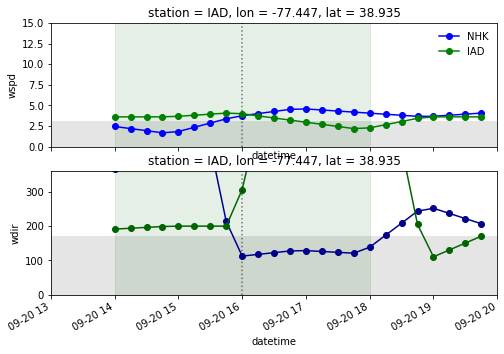

bay breeze validated for 9/21/2019


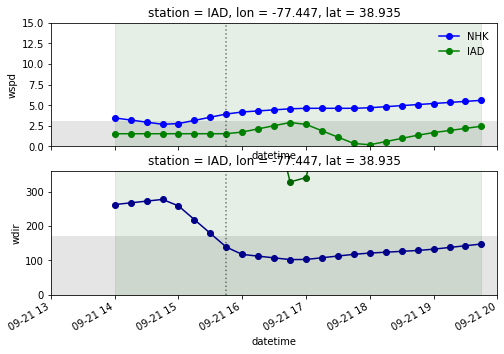

bay breeze validated for 9/22/2019


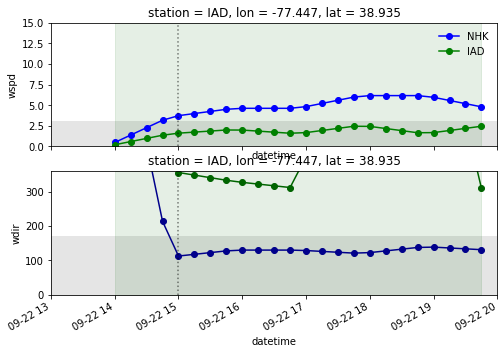

bay breeze validated for 9/25/2019


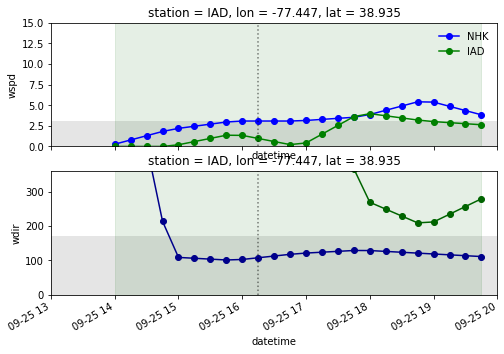

bay breeze validated for 10/1/2019


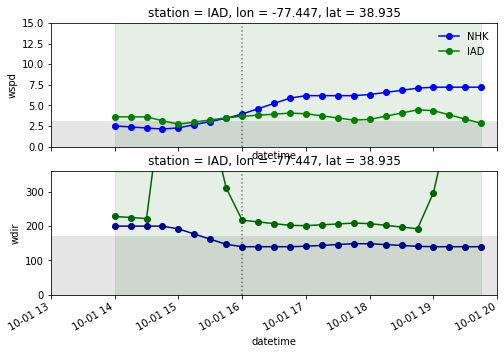

bay breeze validated for 10/11/2019


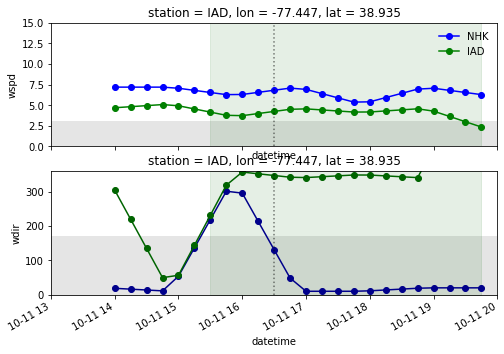

bay breeze validated for 10/12/2019


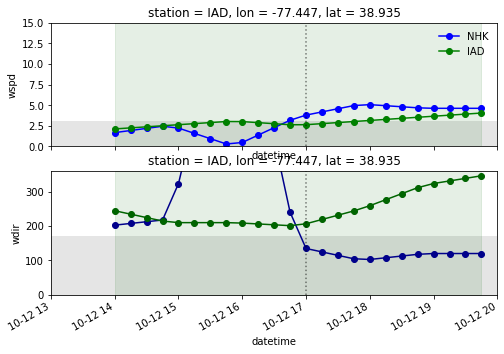

bay breeze validated for 10/19/2019


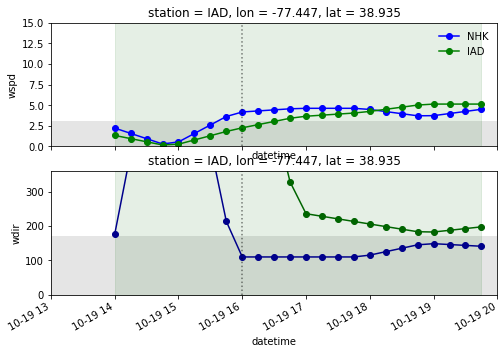

bay breeze validated for 11/2/2019


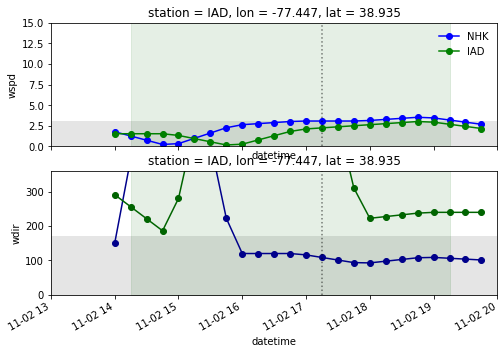

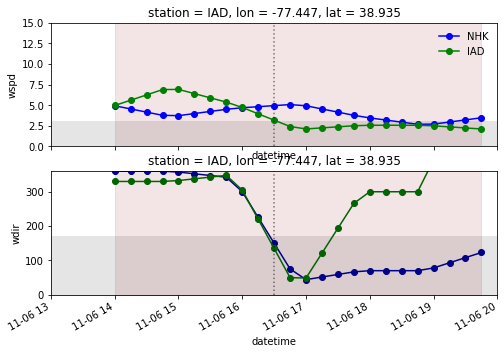

bay breeze validated for 11/11/2019


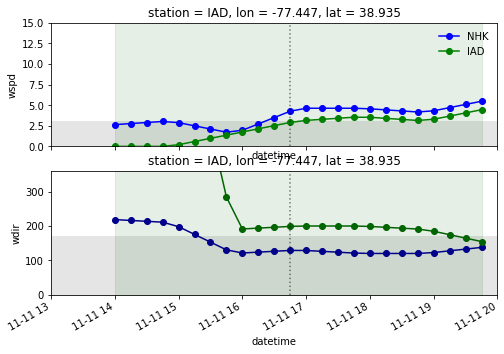

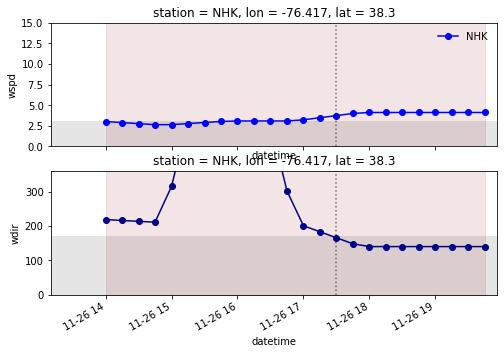

starting station: NUI
Year: 2019


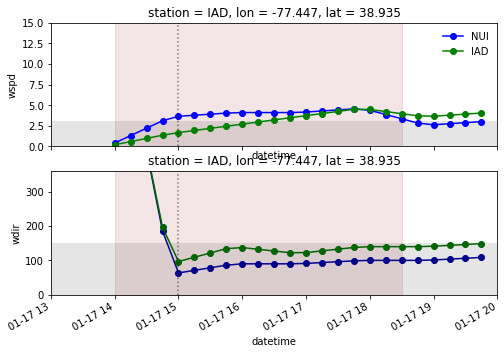

bay breeze validated for 2/26/2019


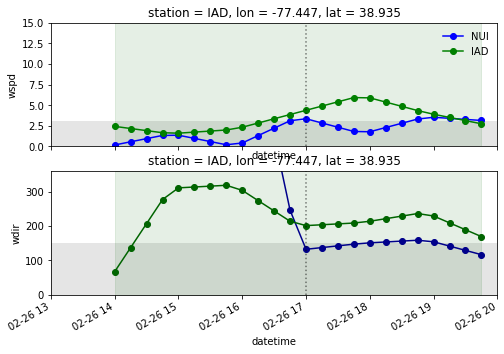

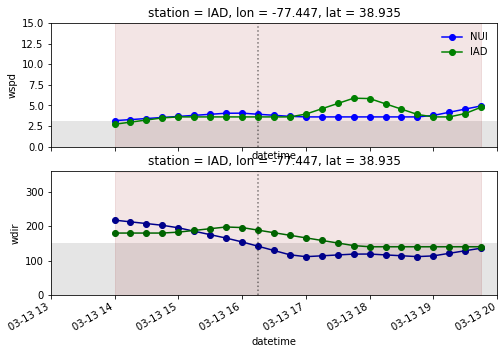

bay breeze validated for 3/28/2019


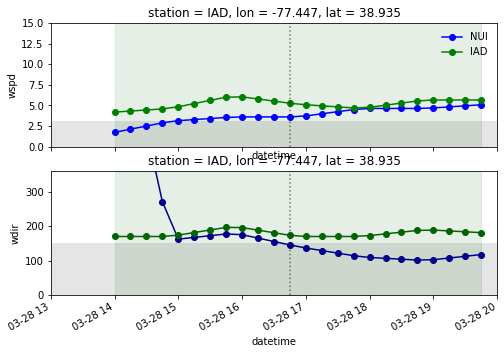

bay breeze validated for 4/7/2019


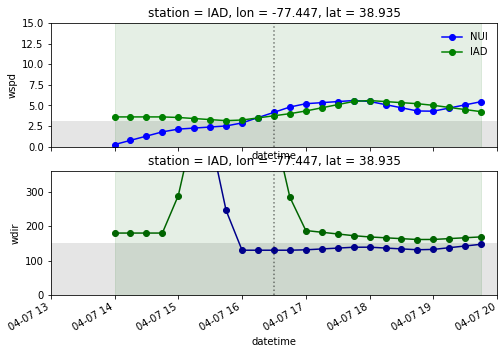

bay breeze validated for 4/17/2019


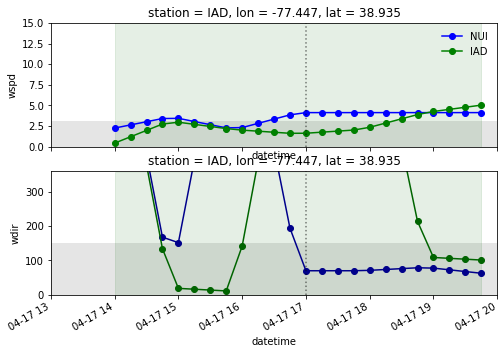

bay breeze validated for 5/4/2019


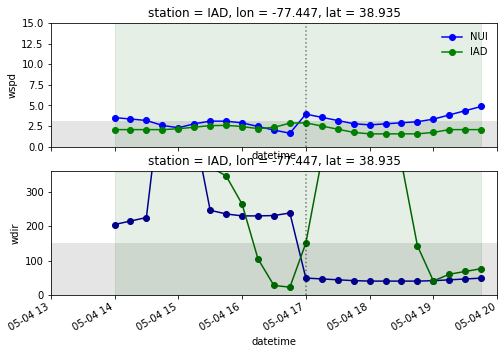

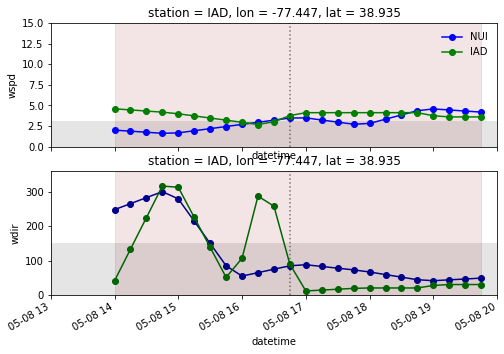

bay breeze validated for 7/10/2019


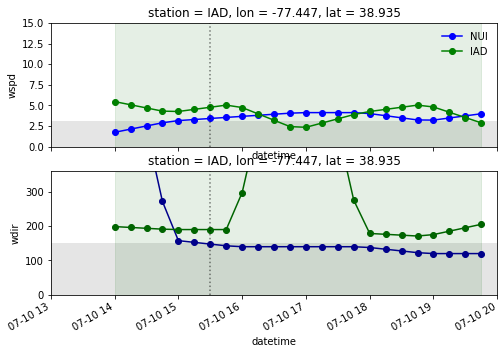

bay breeze validated for 7/24/2019


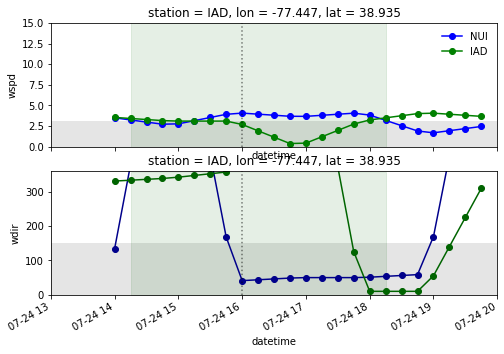

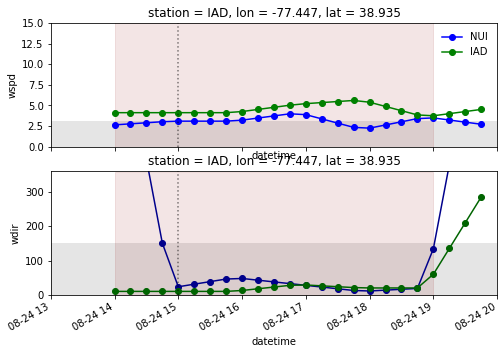

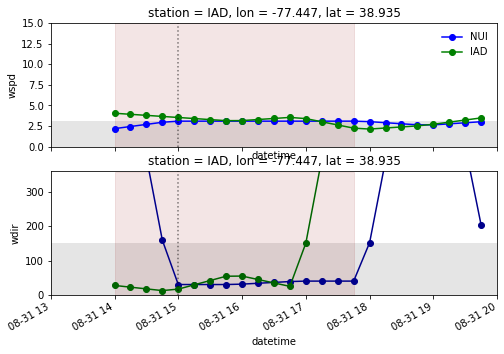

bay breeze validated for 9/8/2019


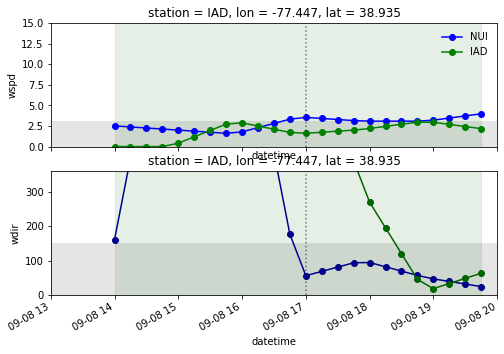

bay breeze validated for 10/7/2019


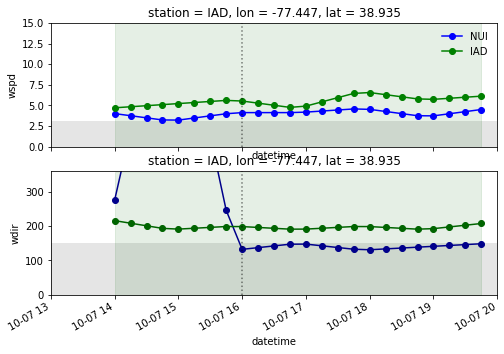

bay breeze validated for 11/4/2019


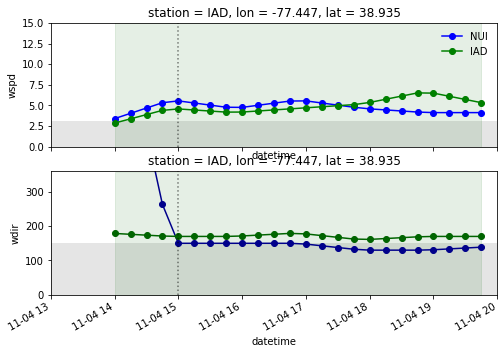

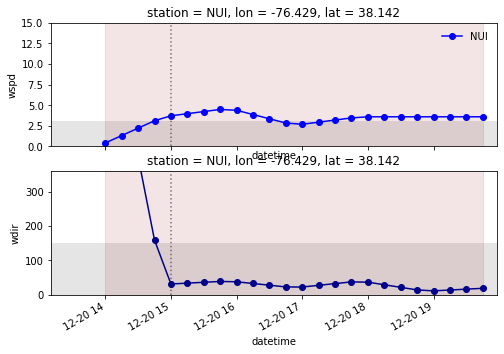

starting station: APG
Year: 2019
Unable to fill...
Unable to draw line...


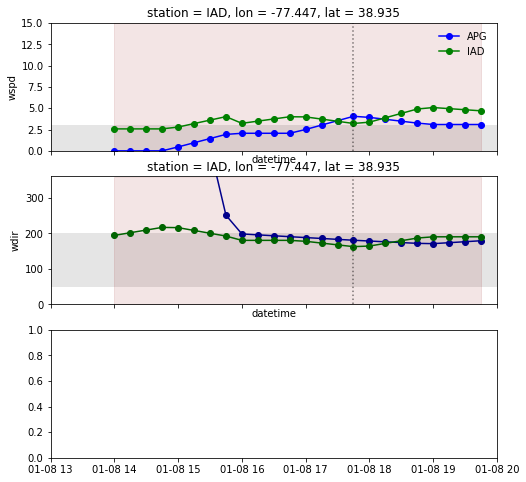

Unable to fill...
Unable to draw line...


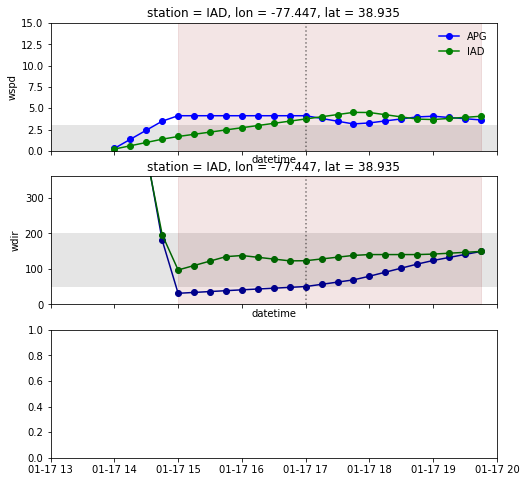

Unable to fill...
Unable to draw line...


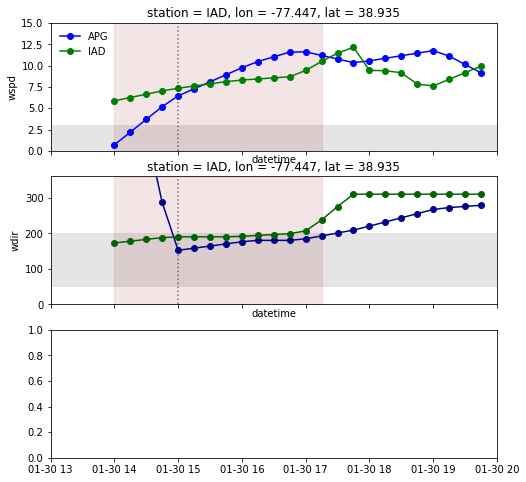

Unable to fill...
Unable to draw line...


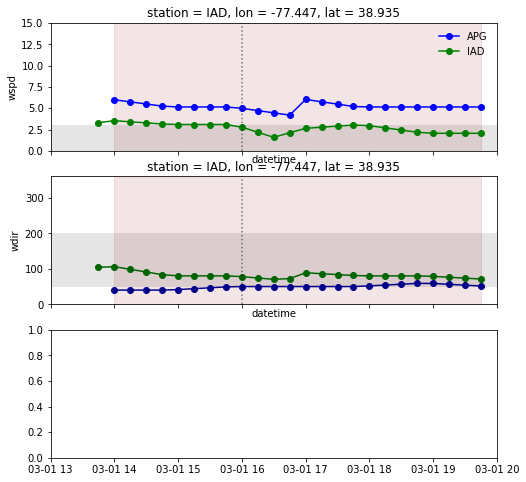

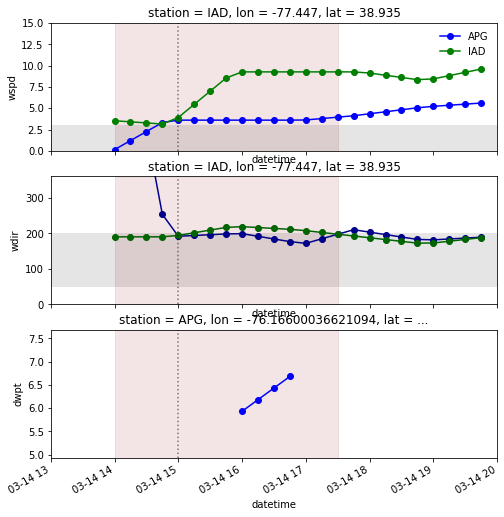

Unable to fill...
Unable to draw line...


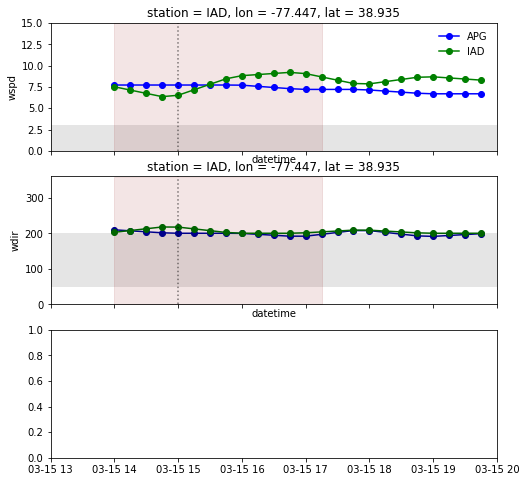

Unable to fill...
Unable to draw line...


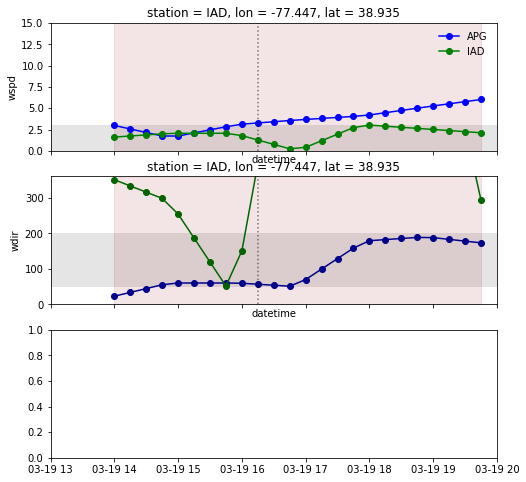

Unable to fill...
Unable to draw line...


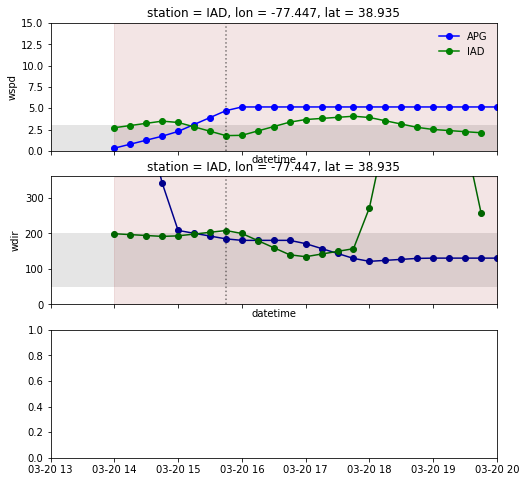

Unable to fill...
Unable to draw line...


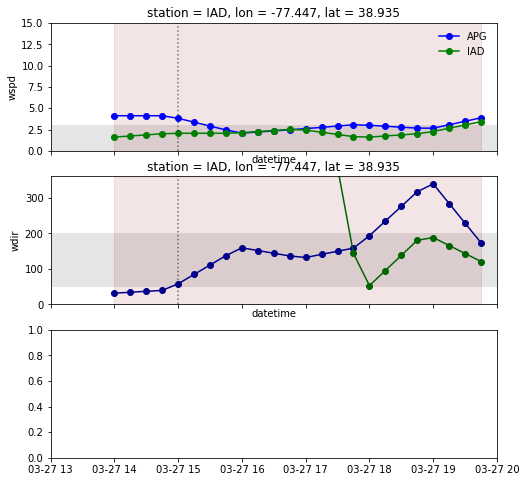

Unable to fill...
Unable to draw line...


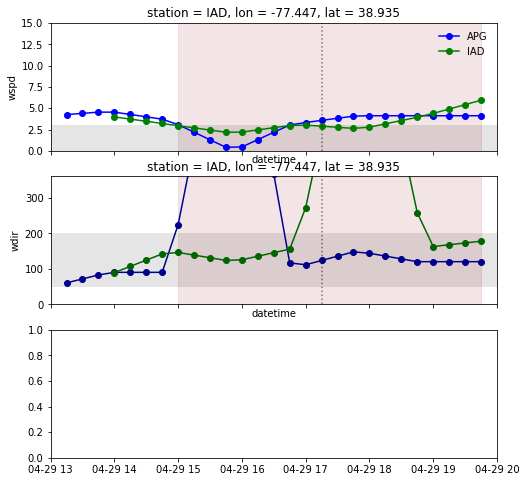

Unable to fill...
Unable to draw line...


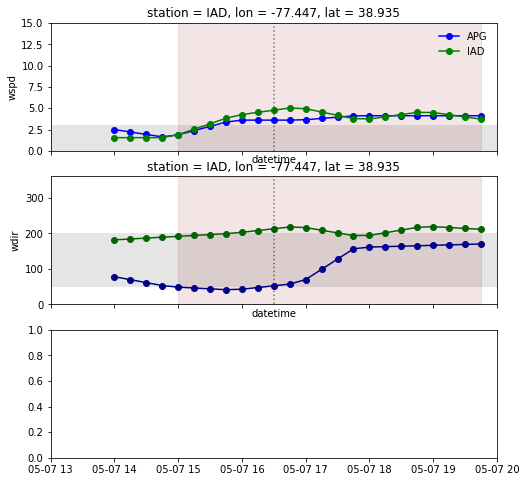

Unable to fill...
Unable to draw line...


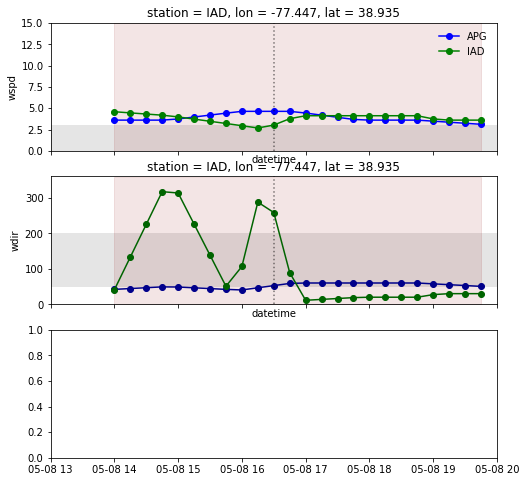

Unable to fill...
Unable to draw line...


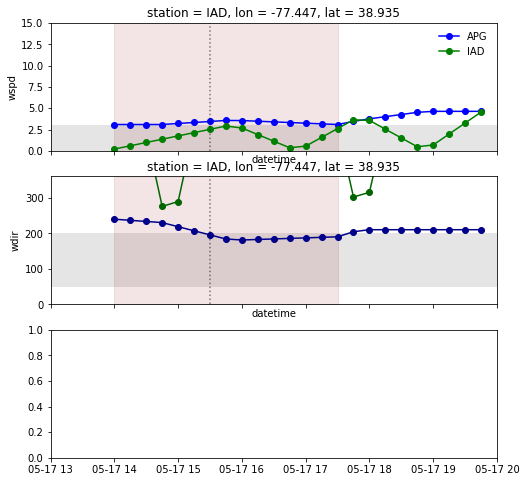

Unable to fill...
Unable to draw line...


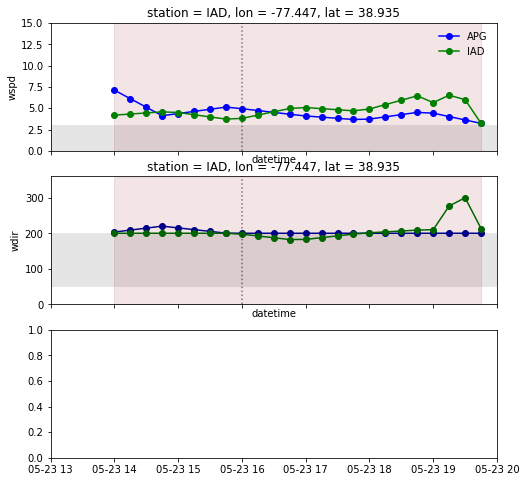

Unable to fill...
Unable to draw line...


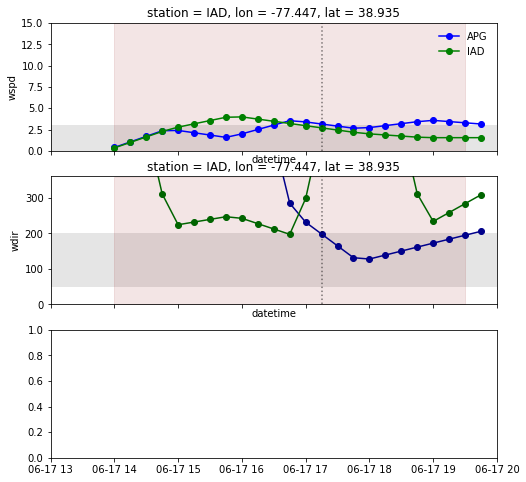

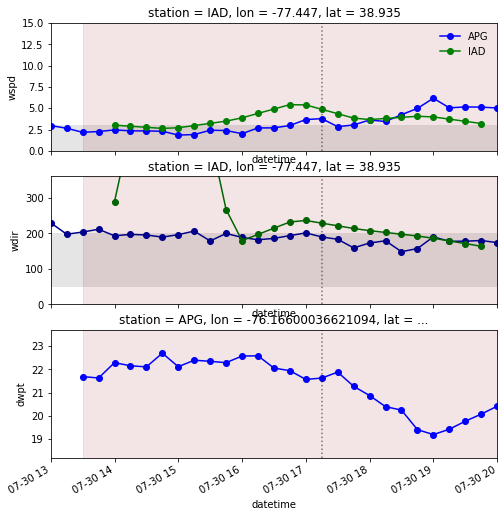

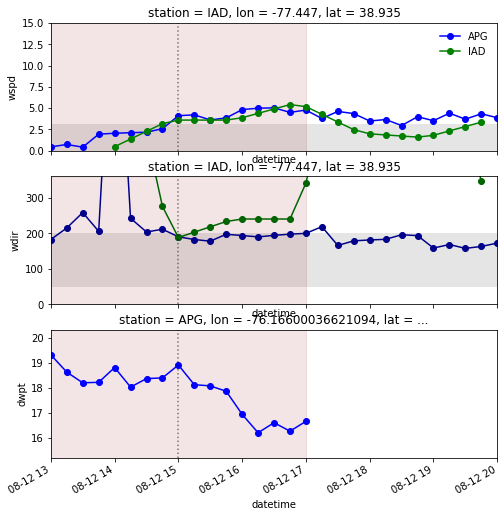

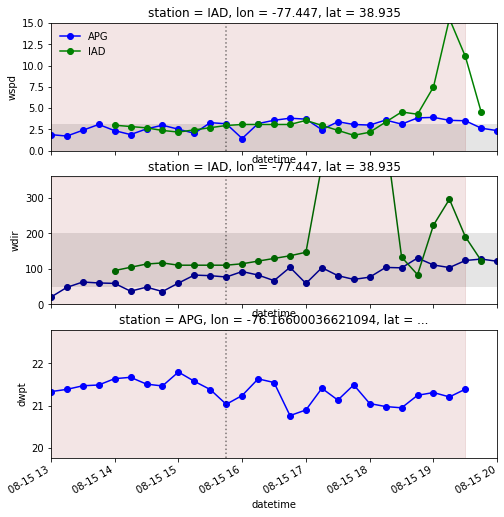

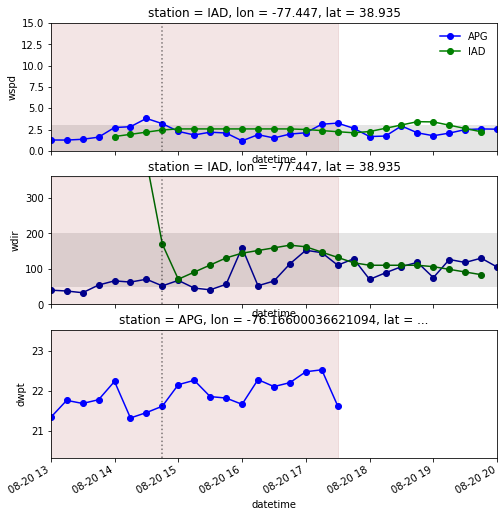

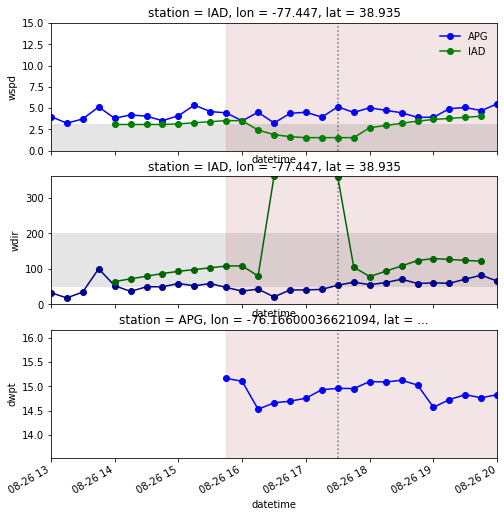

Unable to fill...
Unable to draw line...


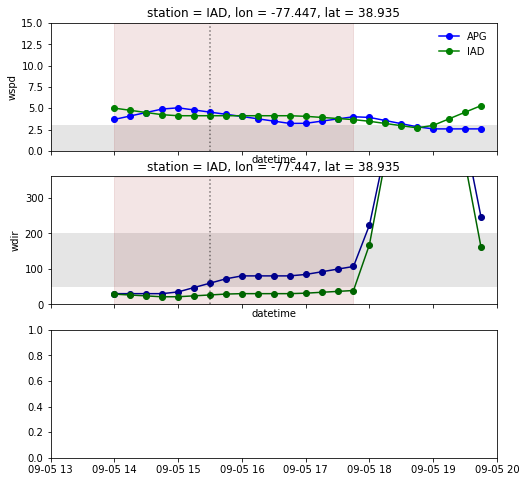

Unable to fill...
Unable to draw line...


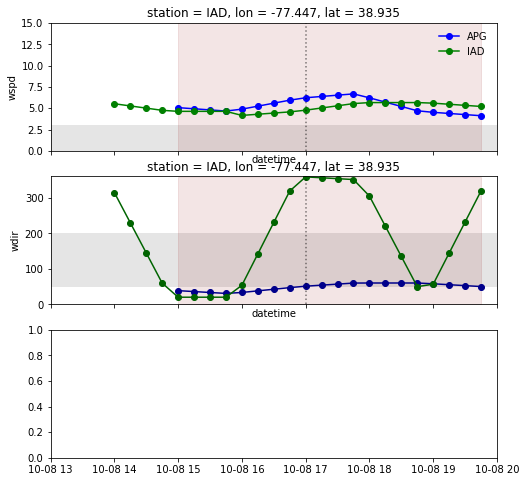

Unable to fill...
Unable to draw line...


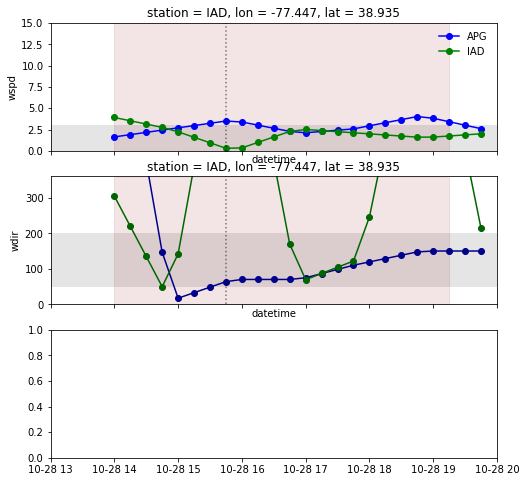

Unable to fill...
Unable to draw line...


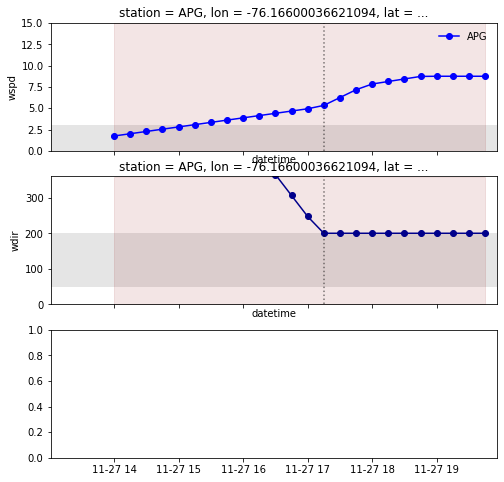

starting station: BWI
Year: 2019


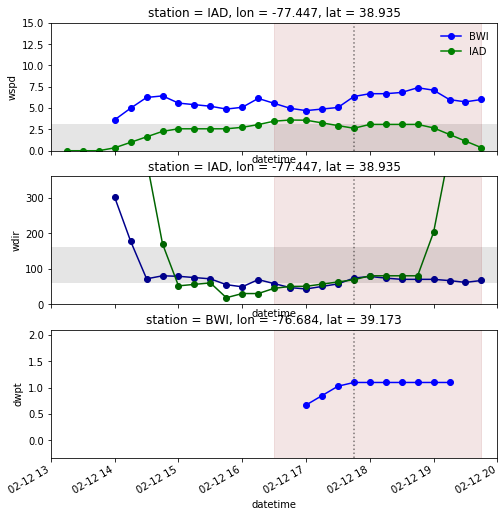

bay breeze validated for 3/13/2019


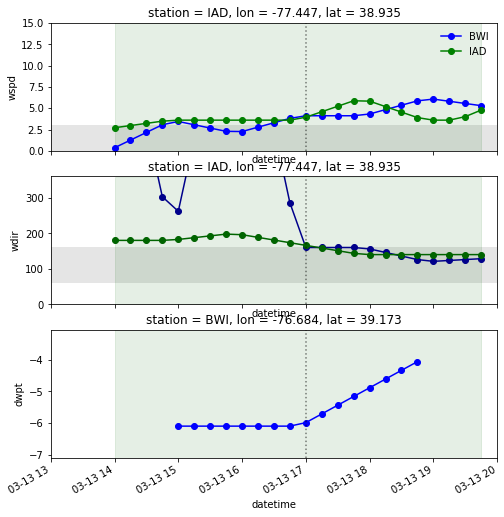

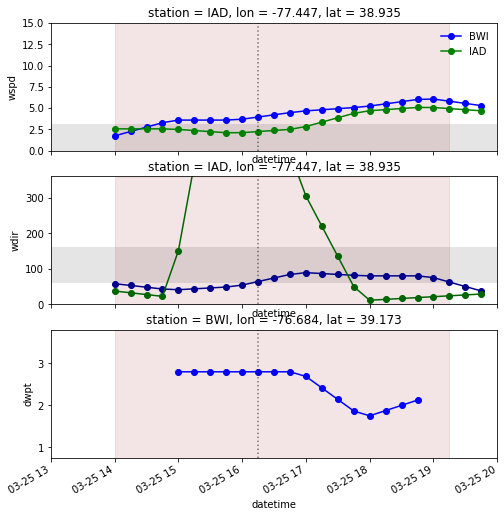

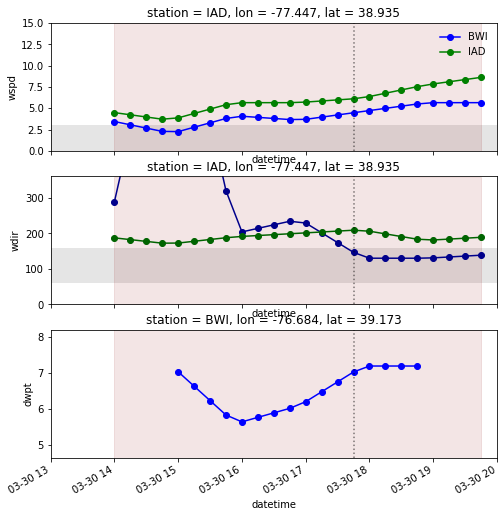

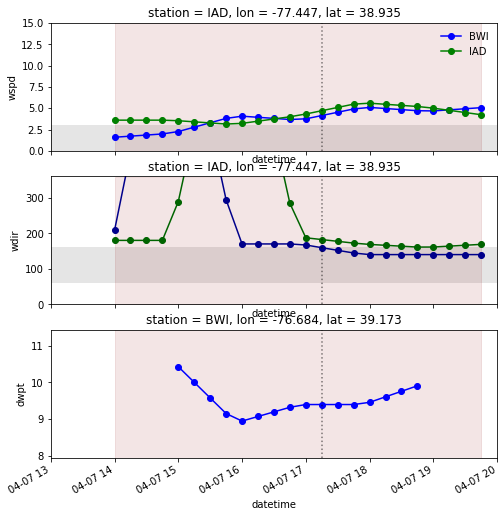

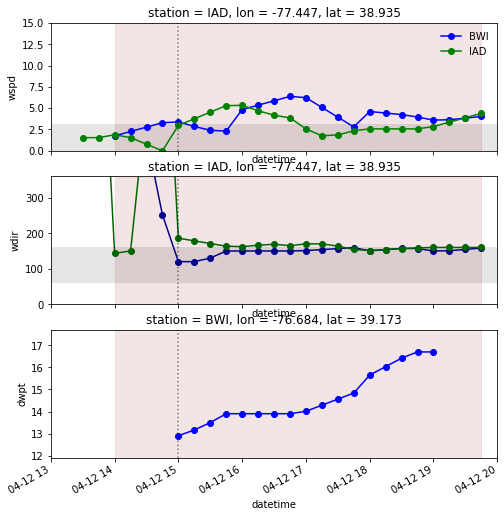

...

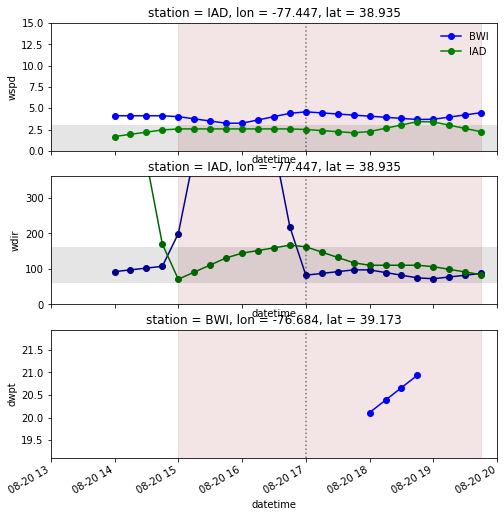

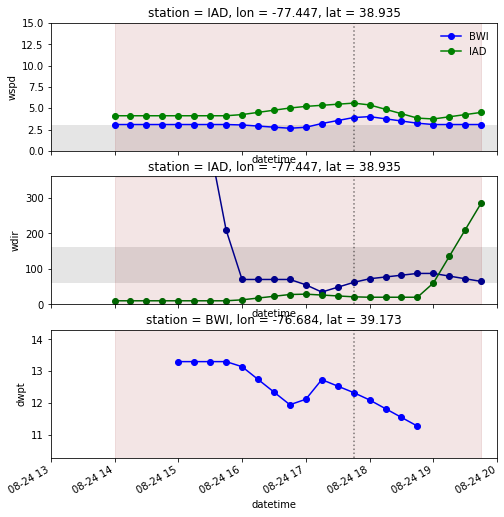

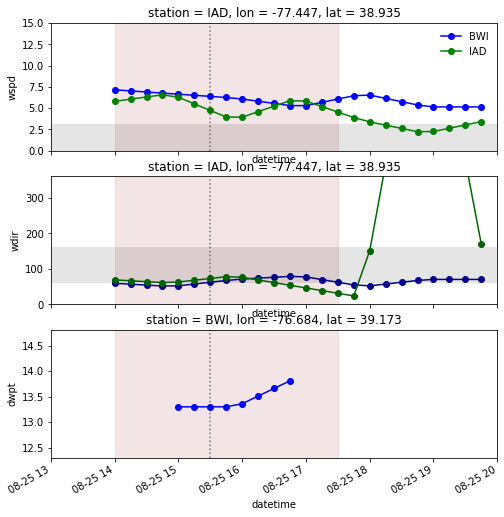

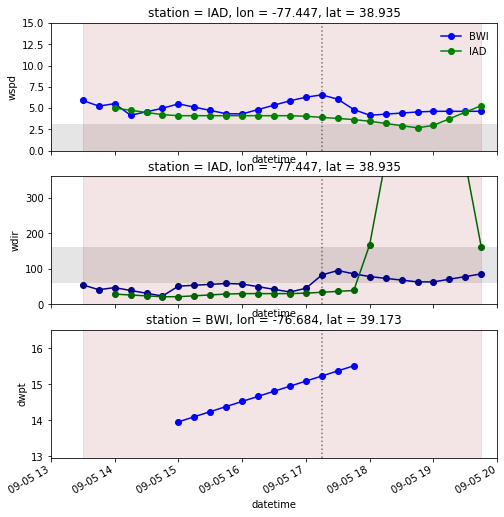

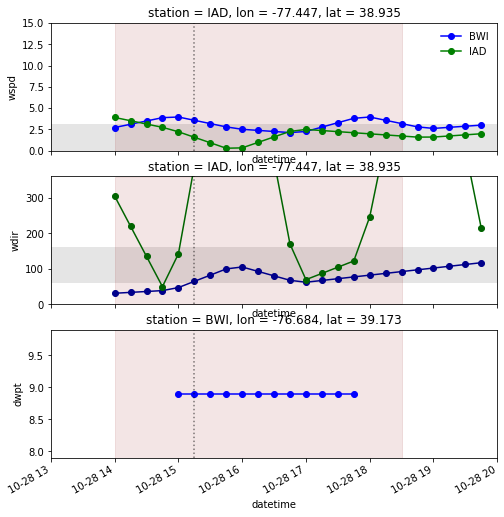

starting station: MTN
Year: 2019
Unable to fill...
Unable to draw line...


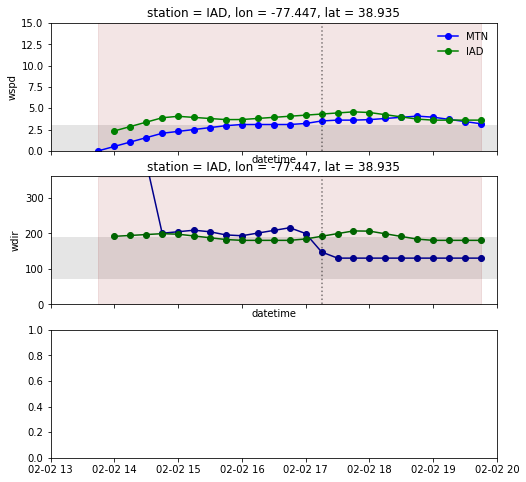

Unable to fill...
Unable to draw line...


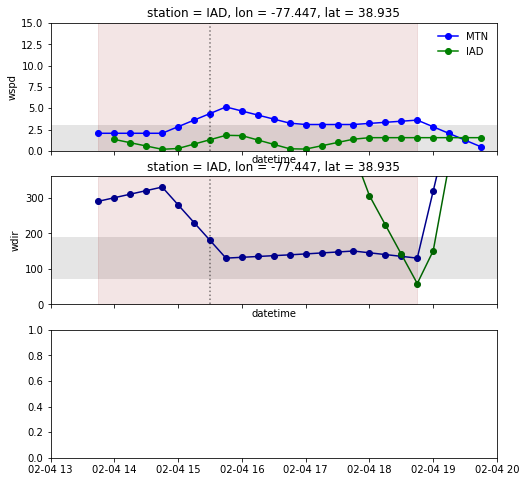

Unable to fill...
Unable to draw line...


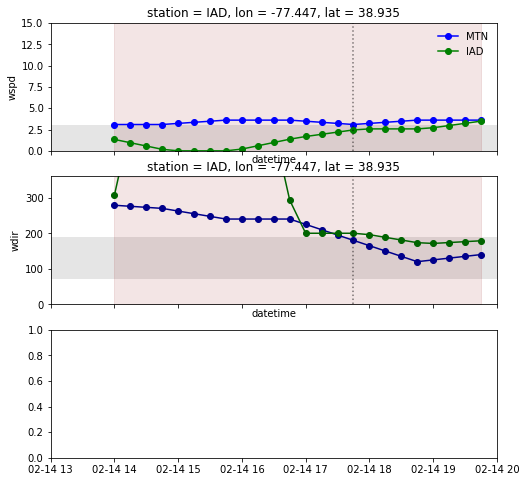

Unable to fill...
Unable to draw line...


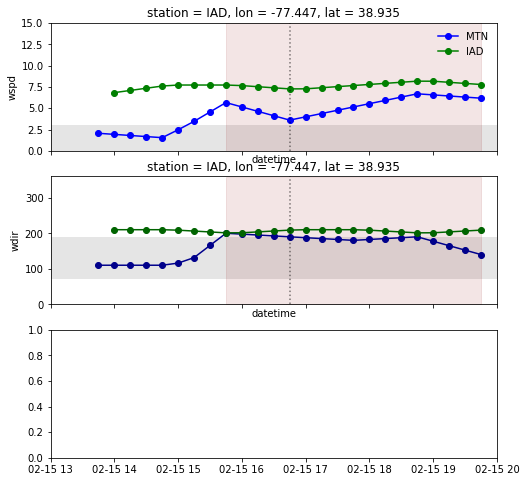

Unable to fill...
Unable to draw line...


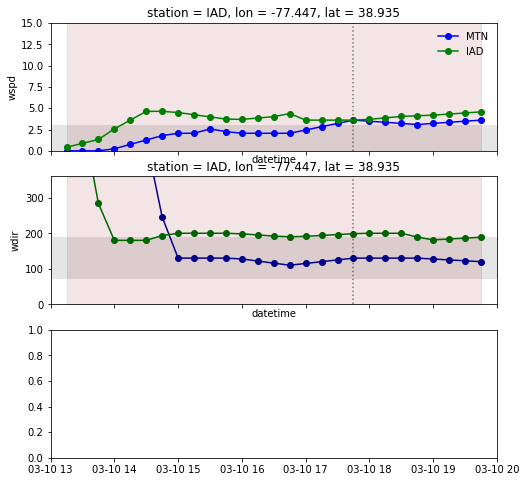

Unable to fill...
Unable to draw line...


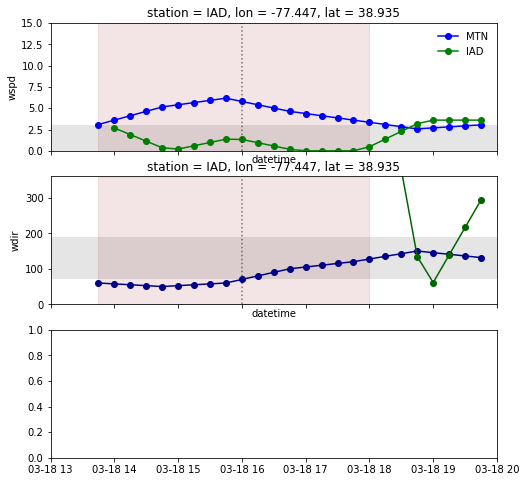

Unable to fill...
Unable to draw line...


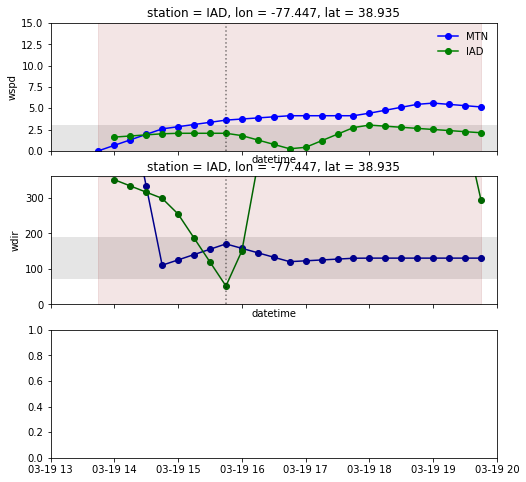

Unable to fill...
Unable to draw line...


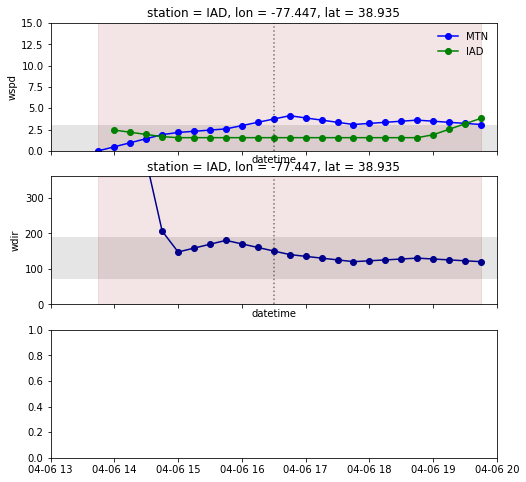

Unable to fill...
Unable to draw line...


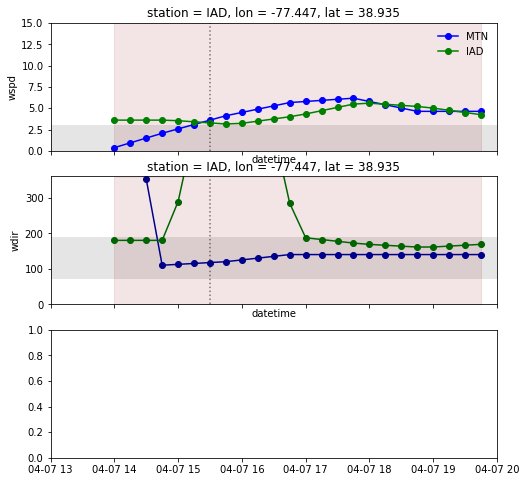

Unable to fill...
Unable to draw line...


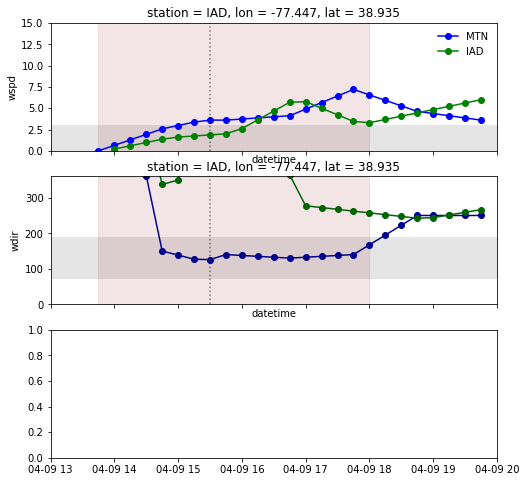

Unable to fill...
Unable to draw line...


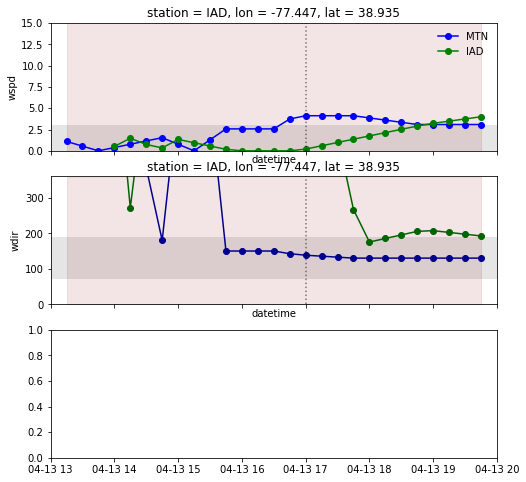

Unable to fill...
Unable to draw line...


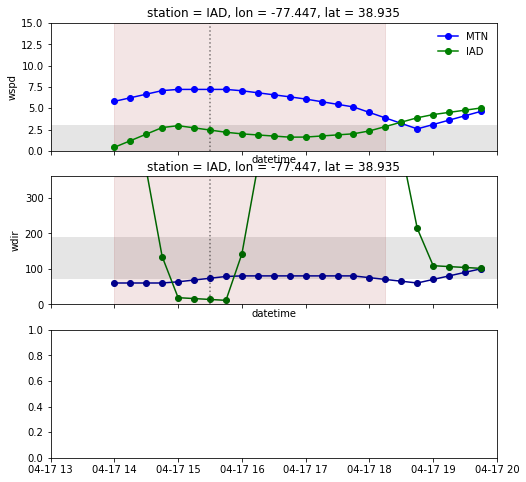

Unable to fill...
Unable to draw line...


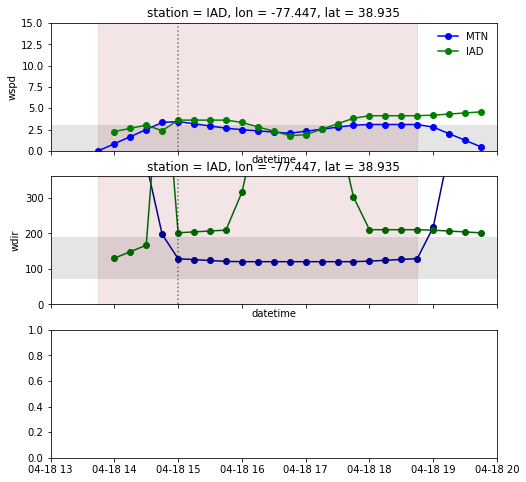

Unable to fill...
Unable to draw line...


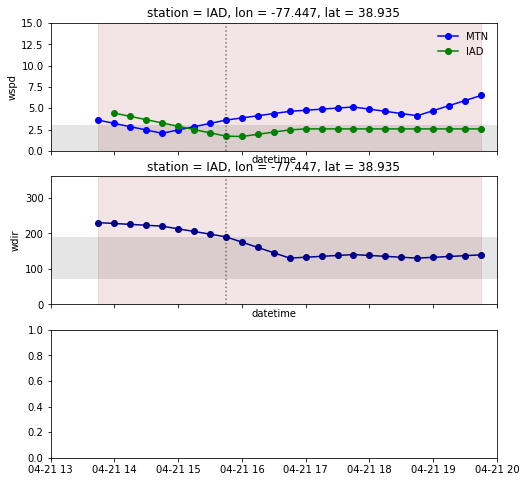

Unable to fill...
Unable to draw line...


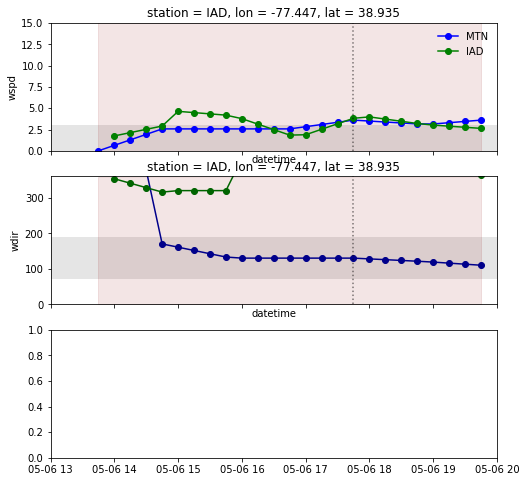

Unable to fill...
Unable to draw line...


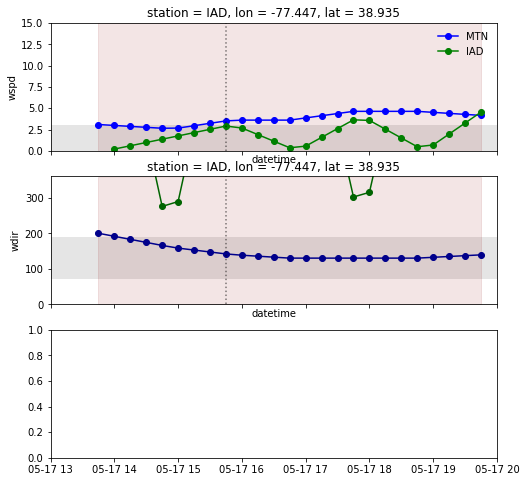

Unable to fill...
Unable to draw line...


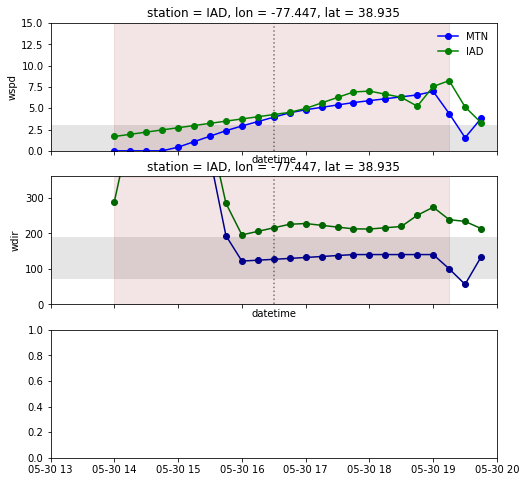

Unable to fill...
Unable to draw line...


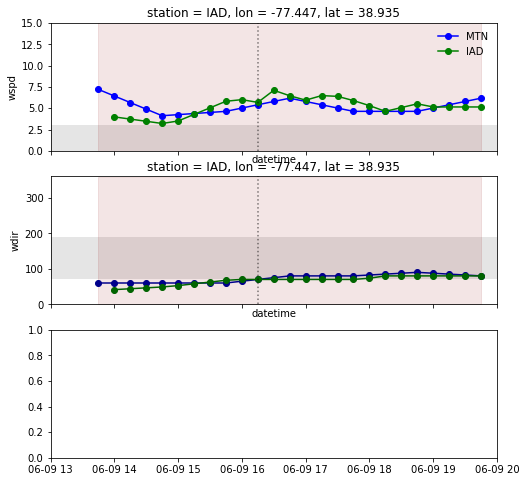

Unable to fill...
Unable to draw line...


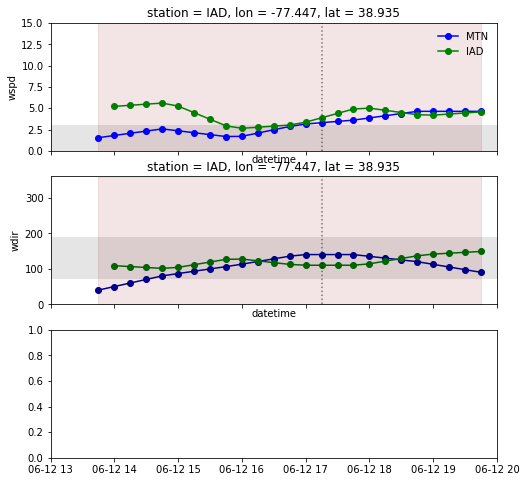

Unable to fill...
Unable to draw line...


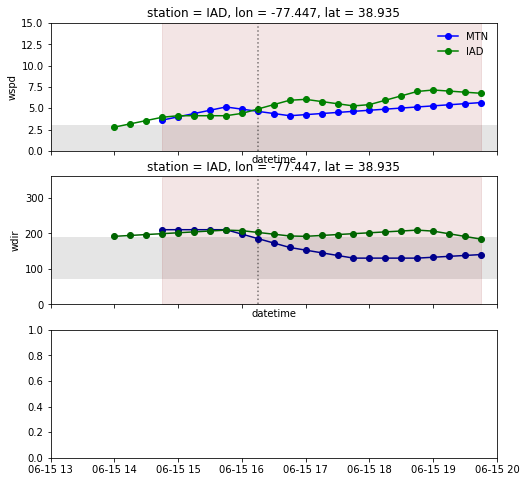

Unable to fill...
Unable to draw line...


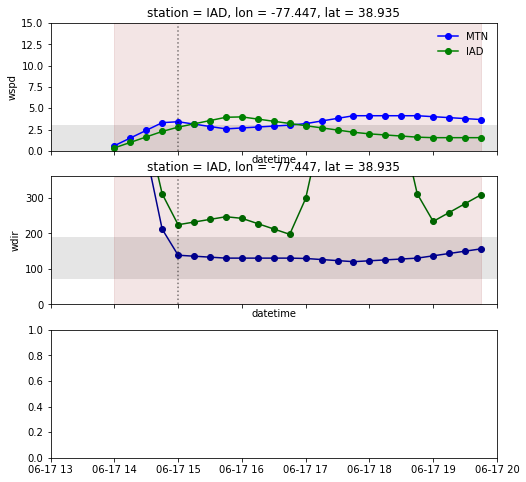

Unable to fill...
Unable to draw line...


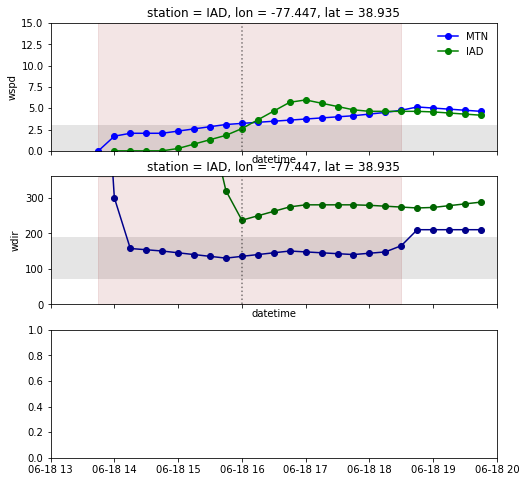

Unable to fill...
Unable to draw line...


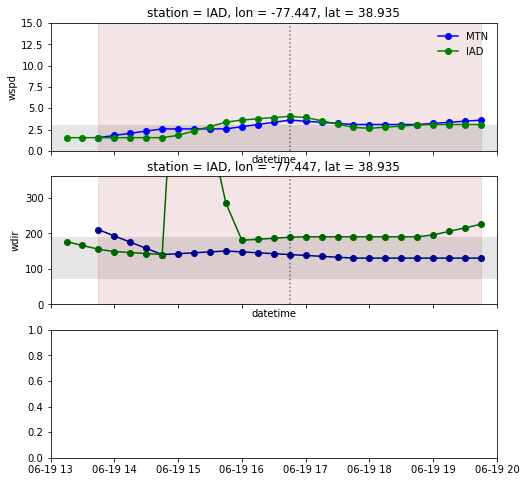

Unable to fill...
Unable to draw line...


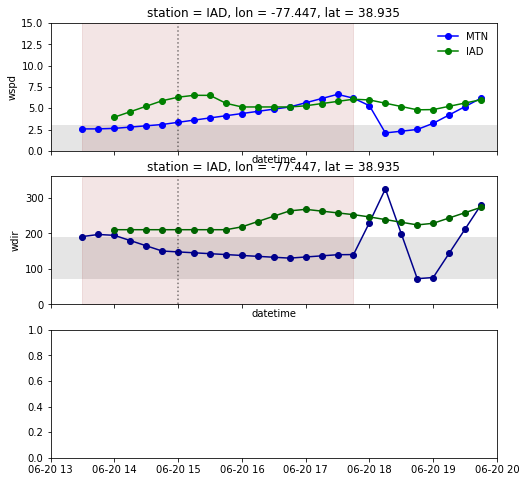

Unable to fill...
Unable to draw line...


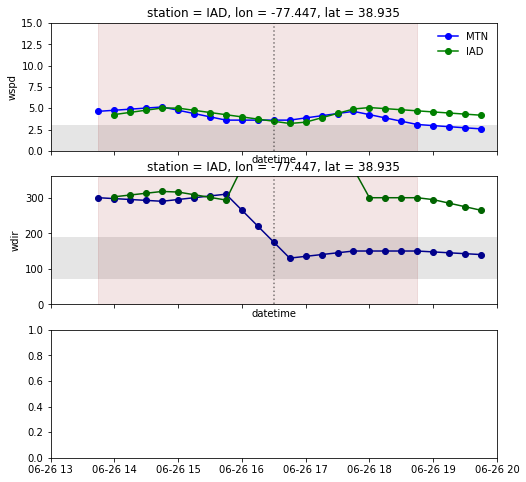

Unable to fill...
Unable to draw line...


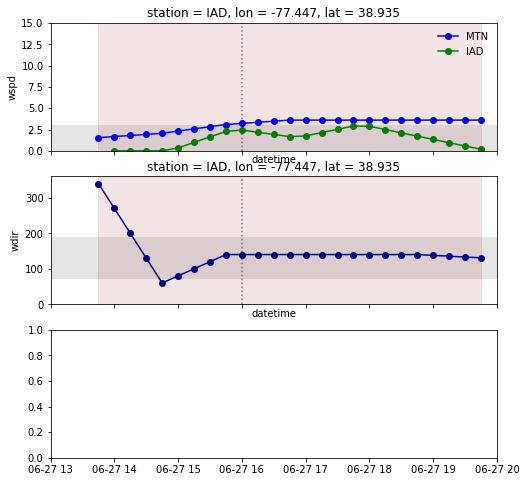

Unable to fill...
Unable to draw line...


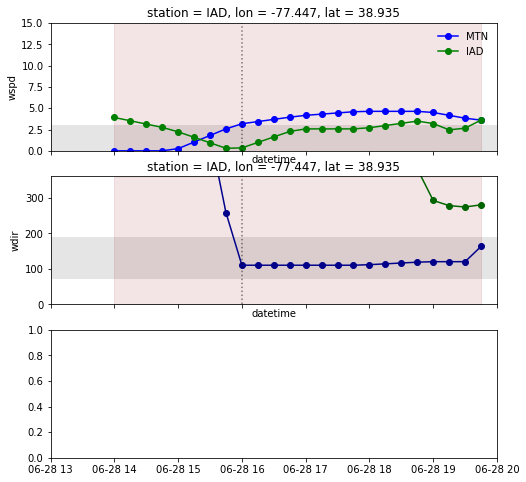

Unable to fill...
Unable to draw line...


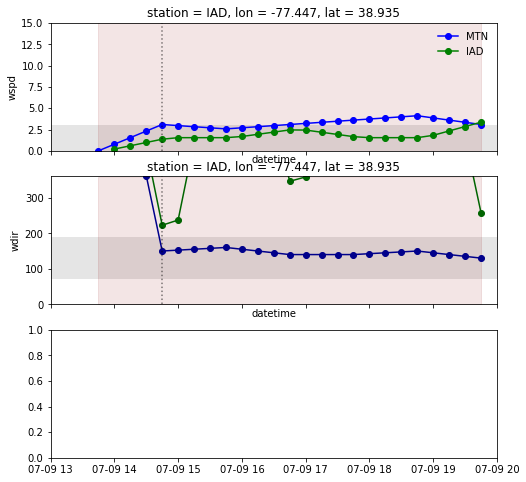

Unable to fill...
Unable to draw line...


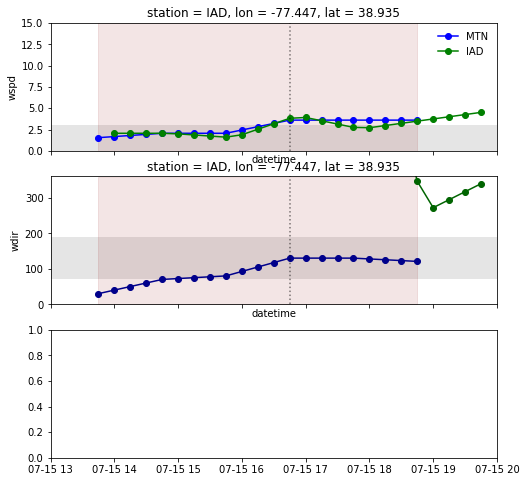

Unable to fill...
Unable to draw line...


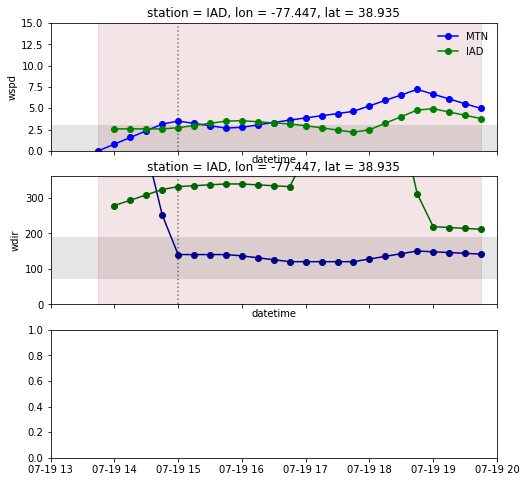

Unable to fill...
Unable to draw line...


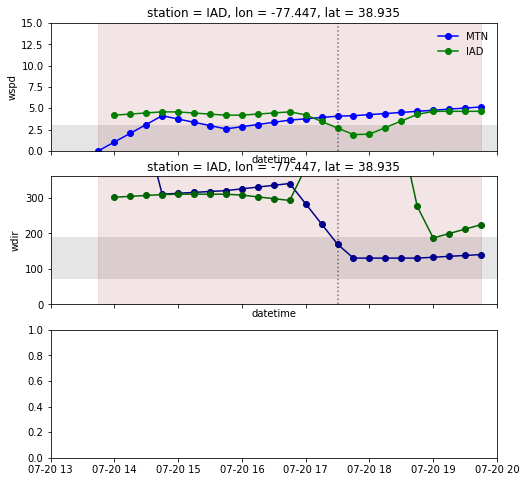

Unable to fill...
Unable to draw line...


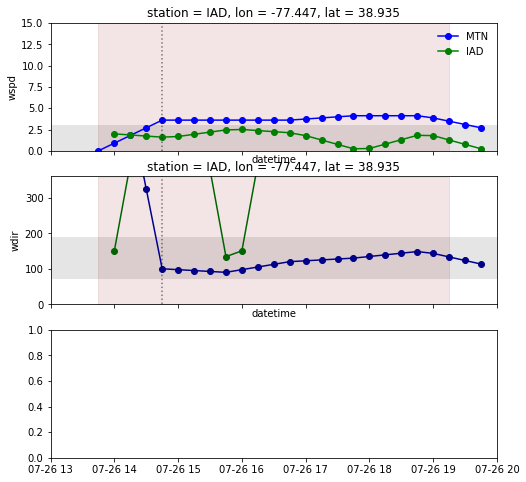

Unable to fill...
Unable to draw line...


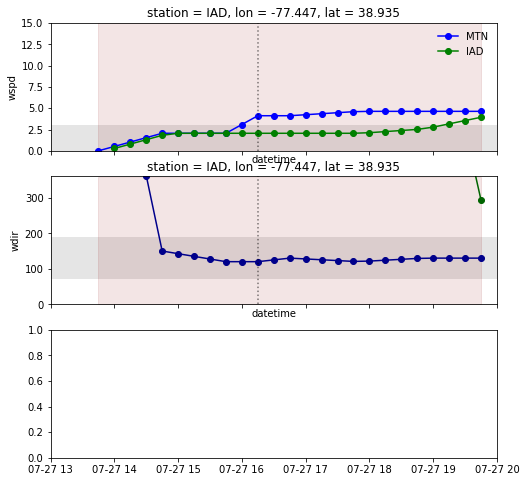

Unable to fill...
Unable to draw line...


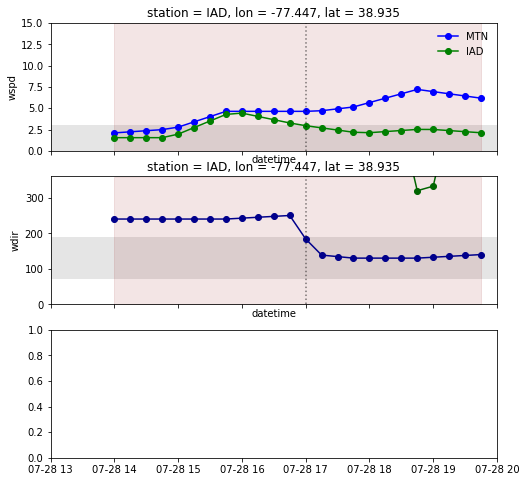

Unable to fill...
Unable to draw line...


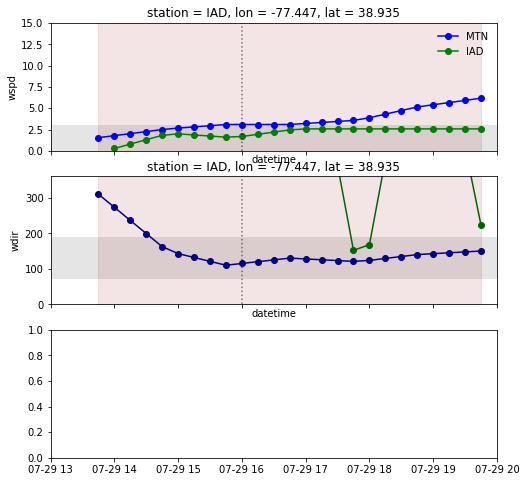

Unable to fill...
Unable to draw line...


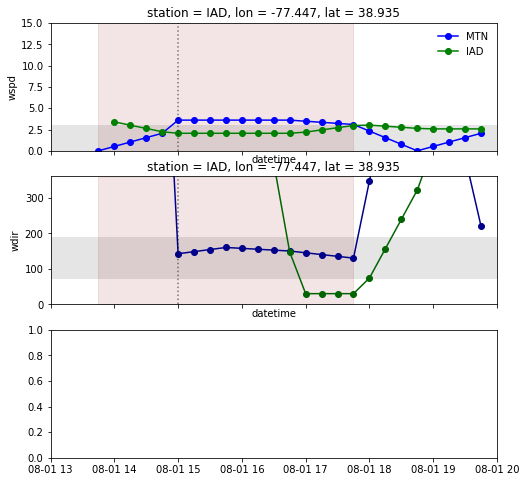

Unable to fill...
Unable to draw line...


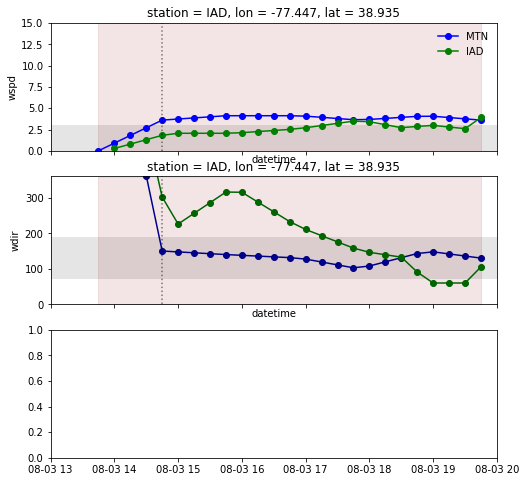

Unable to fill...
Unable to draw line...


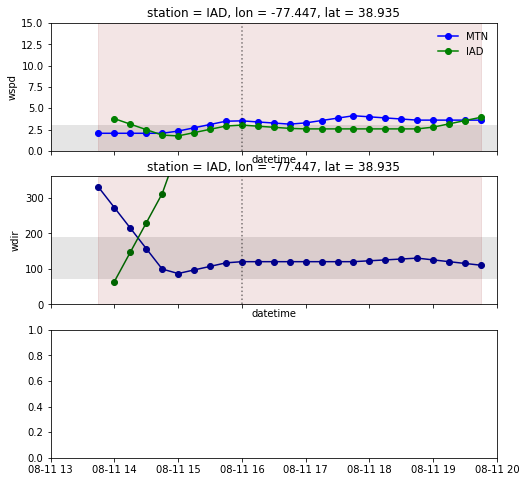

Unable to fill...
Unable to draw line...


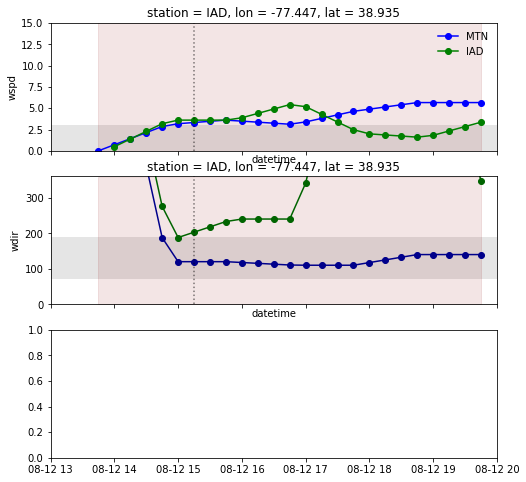

Unable to fill...
Unable to draw line...


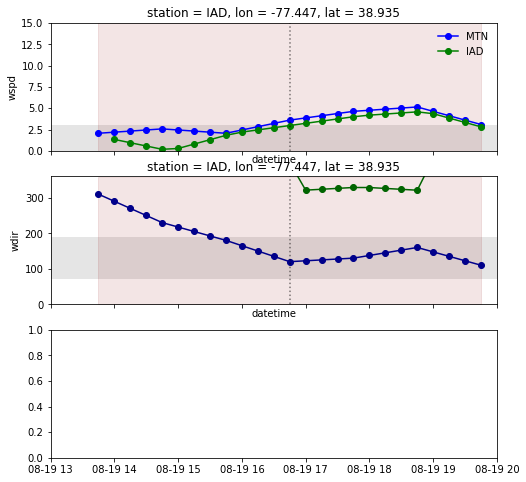

Unable to fill...
Unable to draw line...


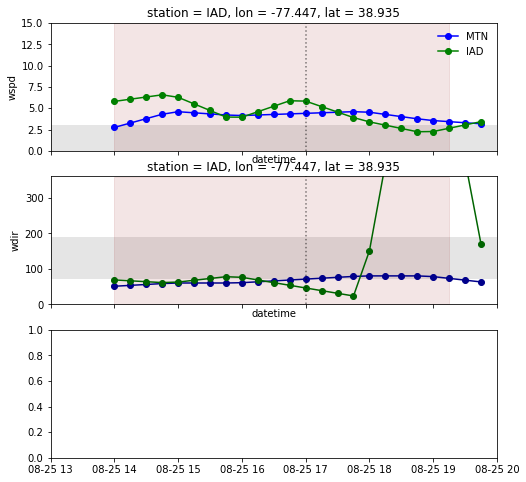

Unable to fill...
Unable to draw line...


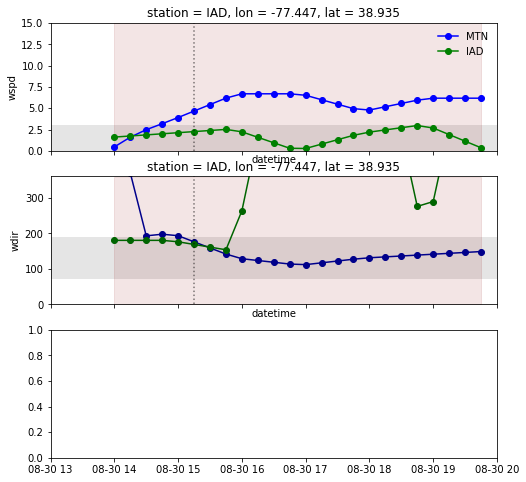

Unable to fill...
Unable to draw line...


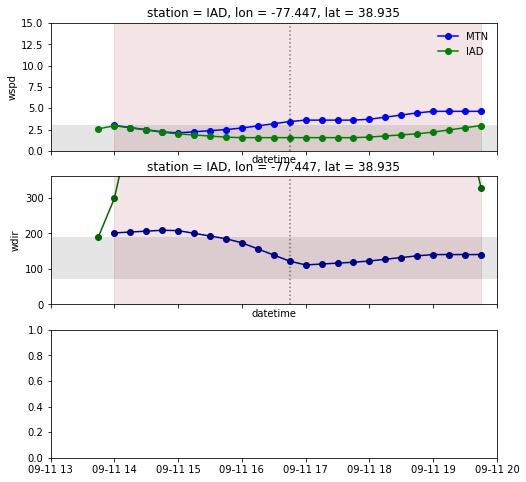

Unable to fill...
Unable to draw line...


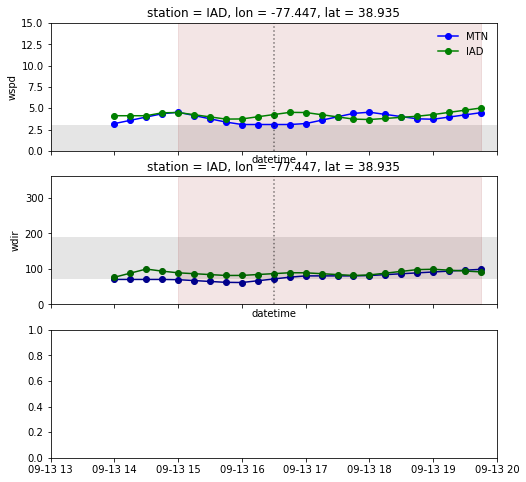

Unable to fill...
Unable to draw line...


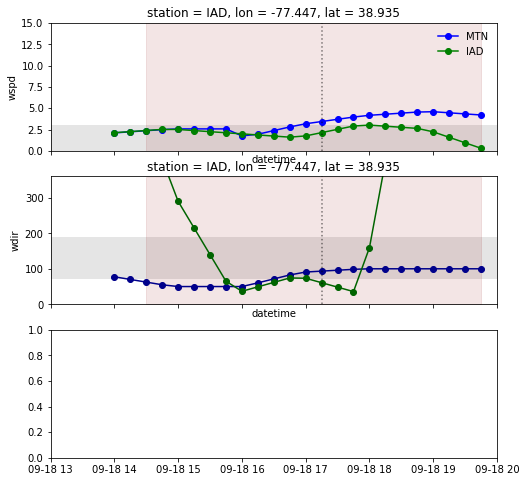

Unable to fill...
Unable to draw line...


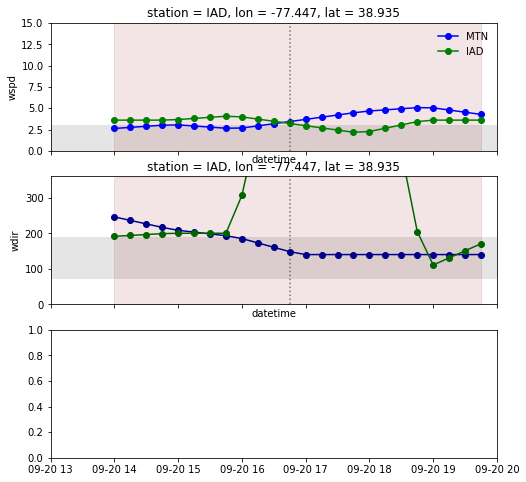

Unable to fill...
Unable to draw line...


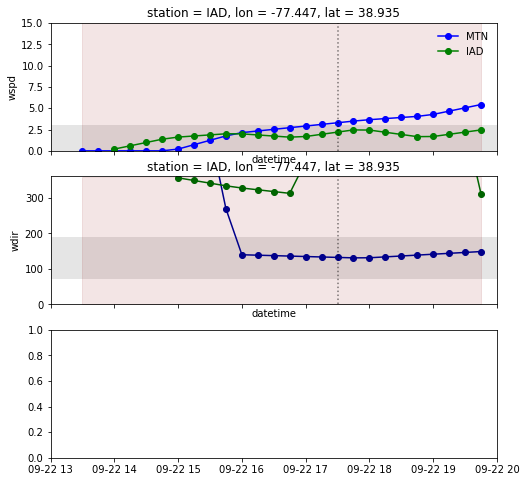

Unable to fill...
Unable to draw line...


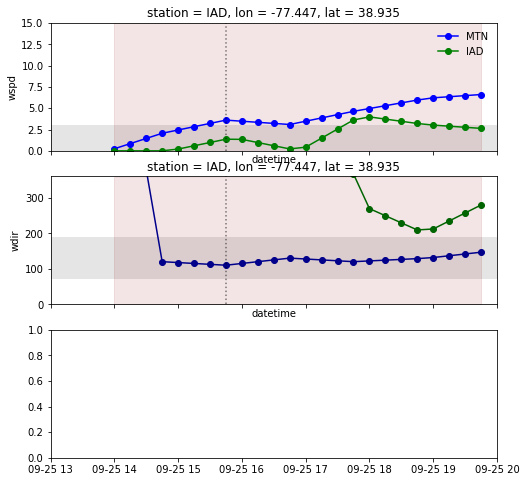

Unable to fill...
Unable to draw line...


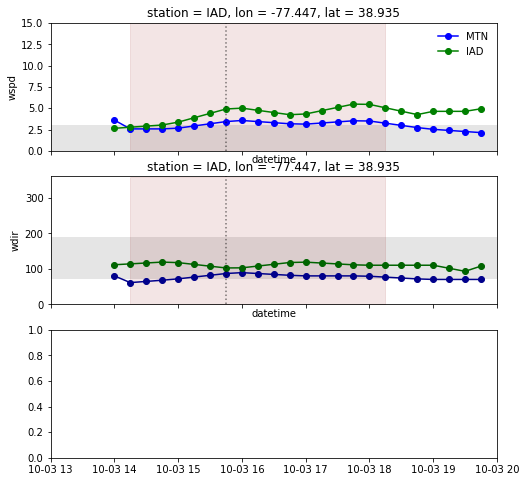

Unable to fill...
Unable to draw line...


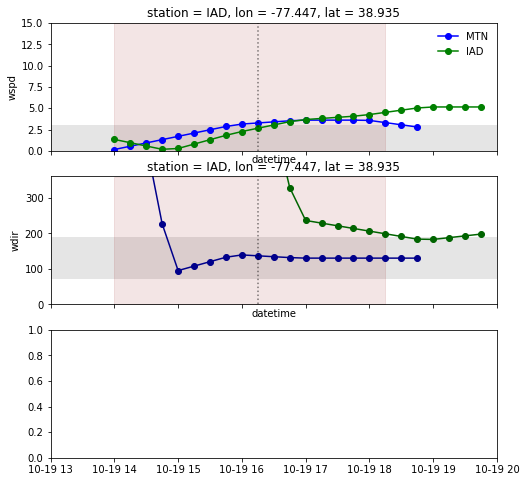

Unable to fill...
Unable to draw line...


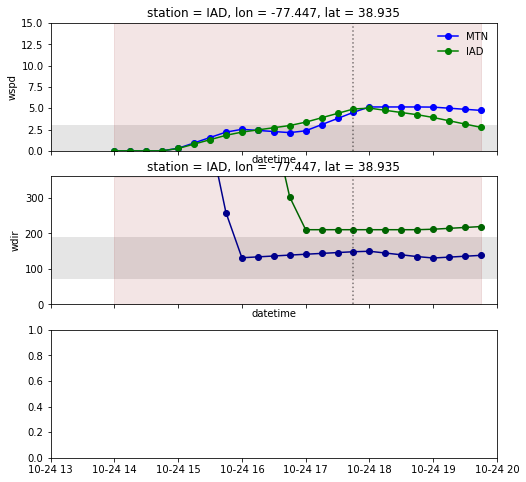

Unable to fill...
Unable to draw line...


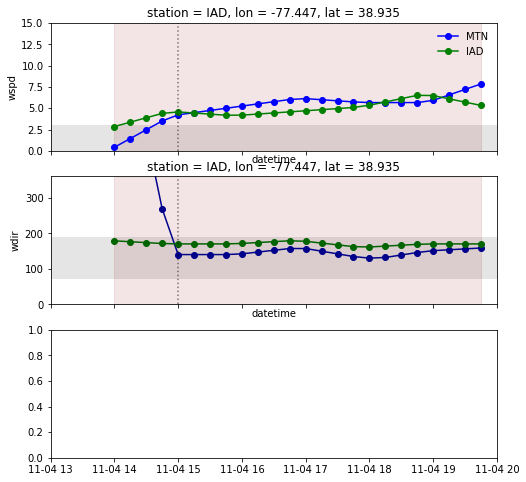

Unable to fill...
Unable to draw line...


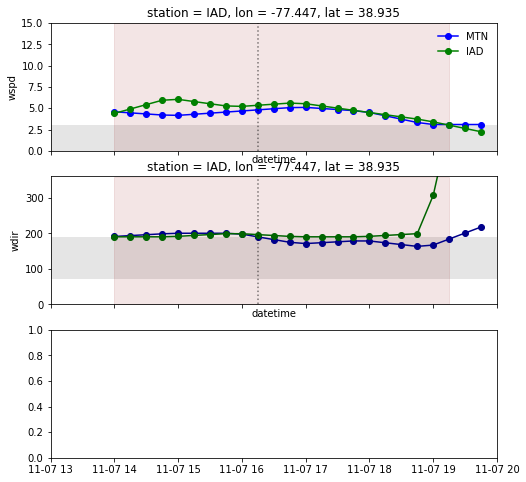

Unable to fill...
Unable to draw line...


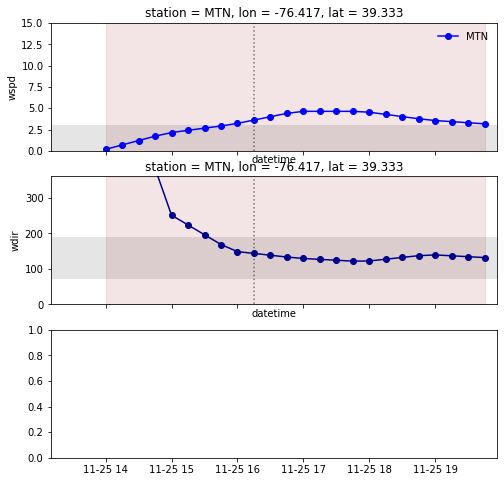

Unable to fill...
Unable to draw line...


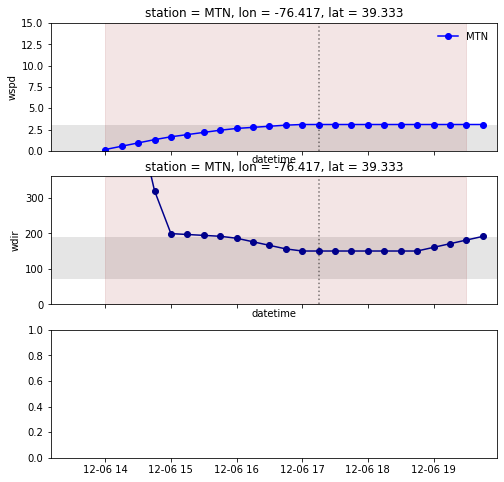

Unable to fill...
Unable to draw line...


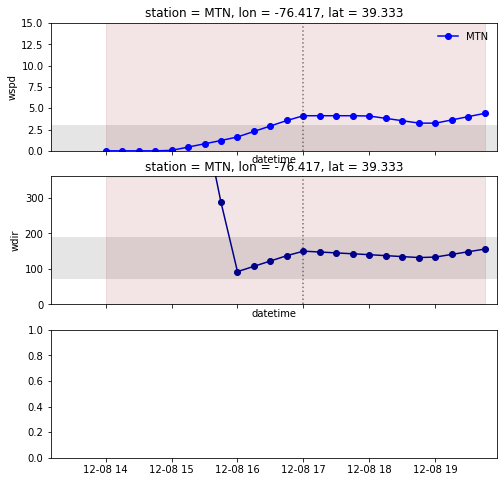

starting station: NAK
Year: 2019


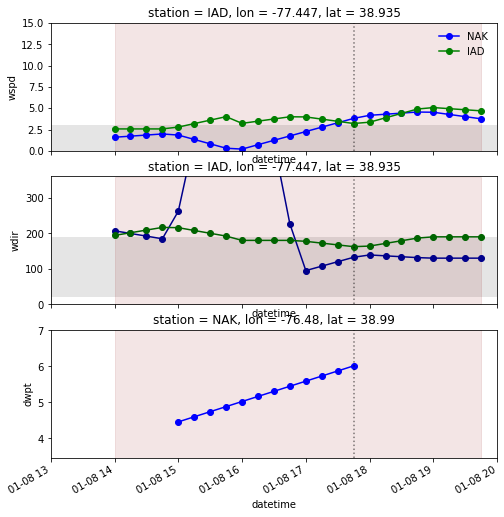

bay breeze validated for 1/23/2019


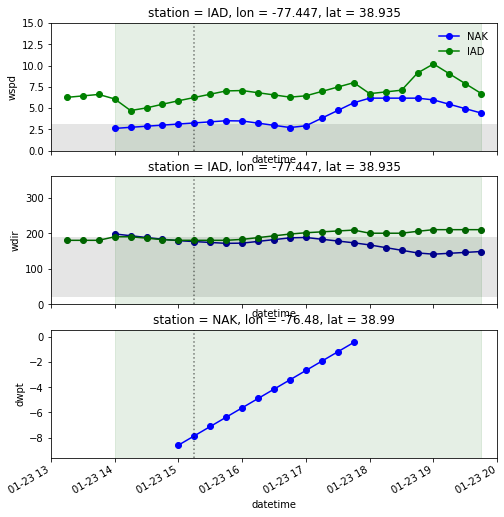

Unable to fill...
Unable to draw line...


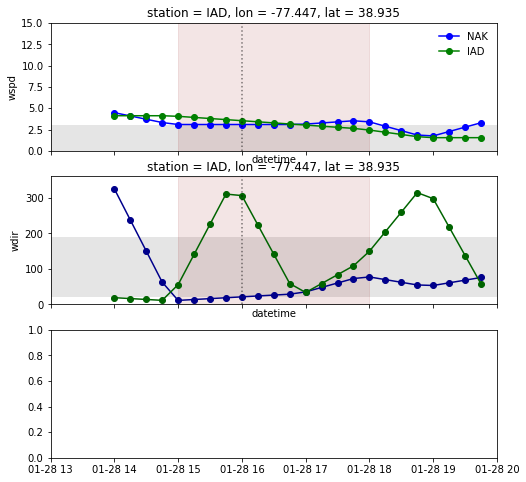

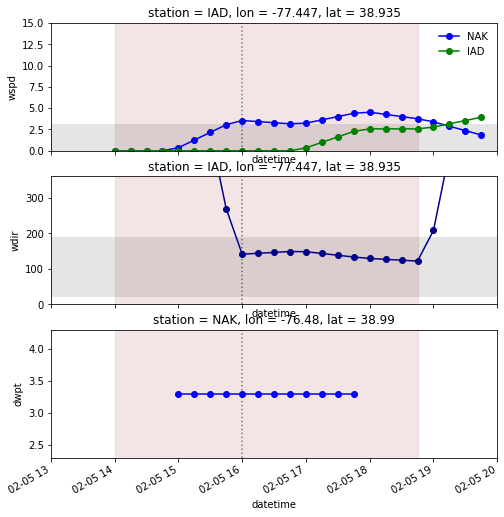

bay breeze validated for 2/10/2019


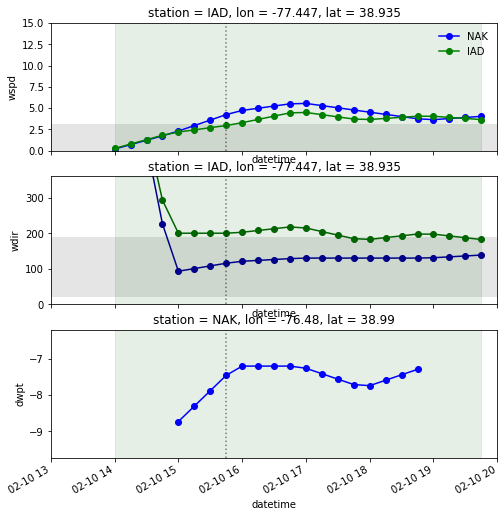

bay breeze validated for 2/14/2019


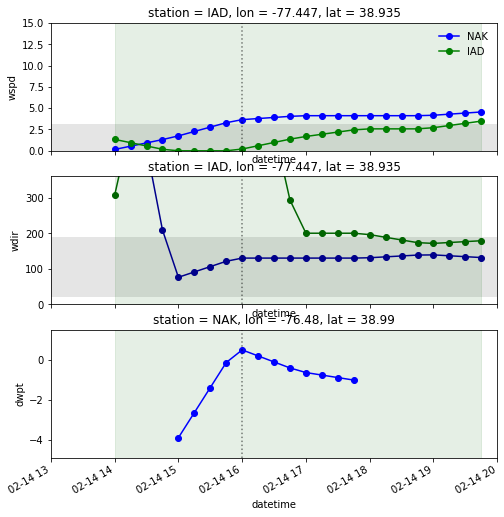

Unable to fill...
Unable to draw line...


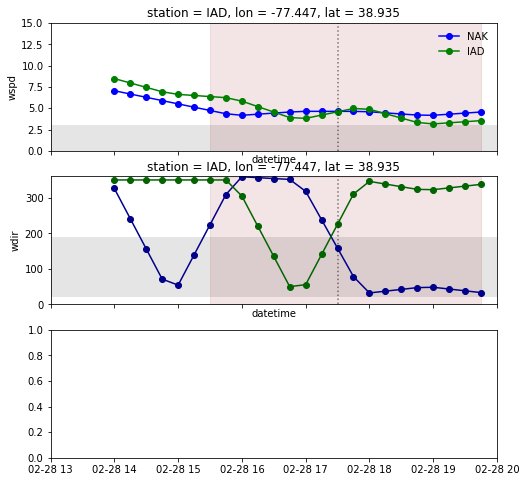

bay breeze validated for 3/5/2019


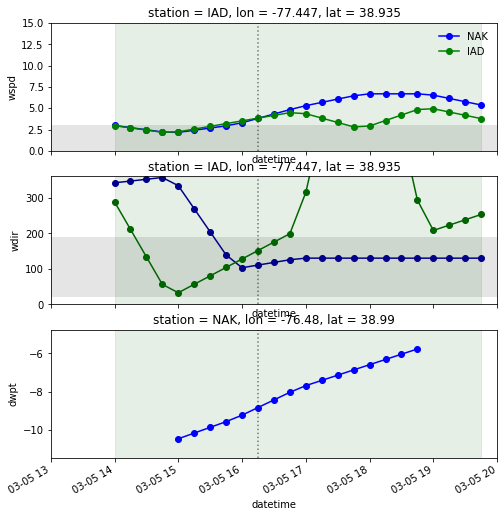

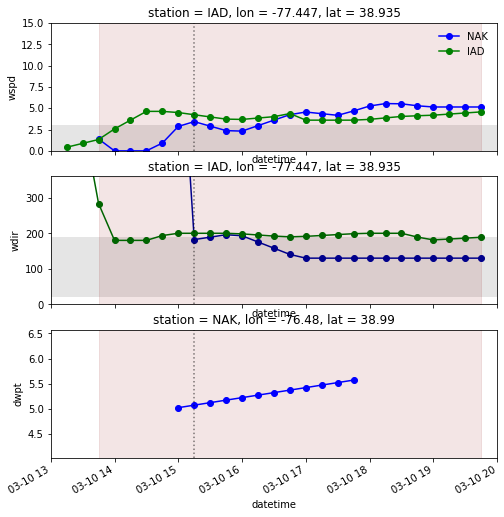

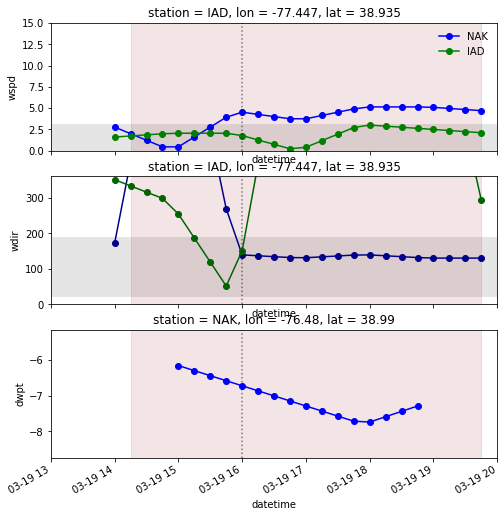

bay breeze validated for 3/24/2019


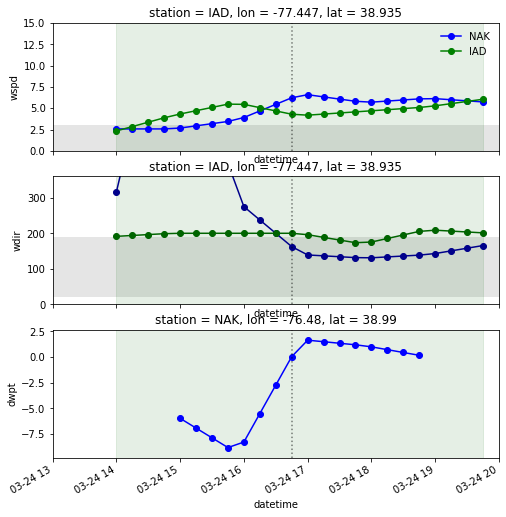

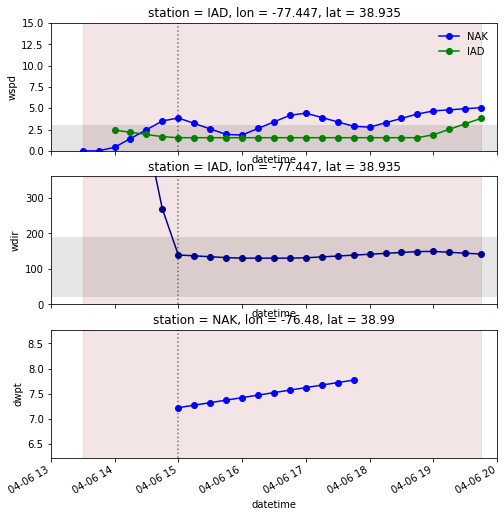

bay breeze validated for 4/13/2019


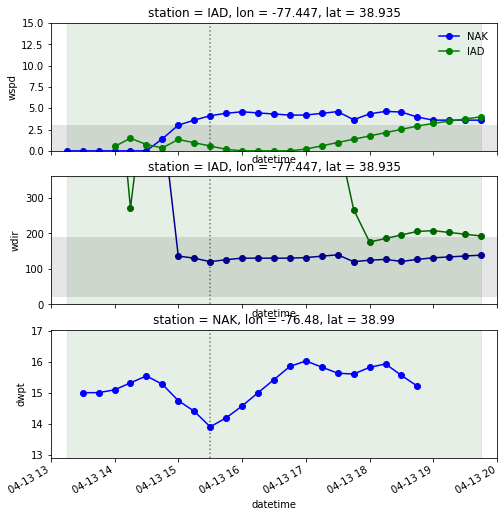

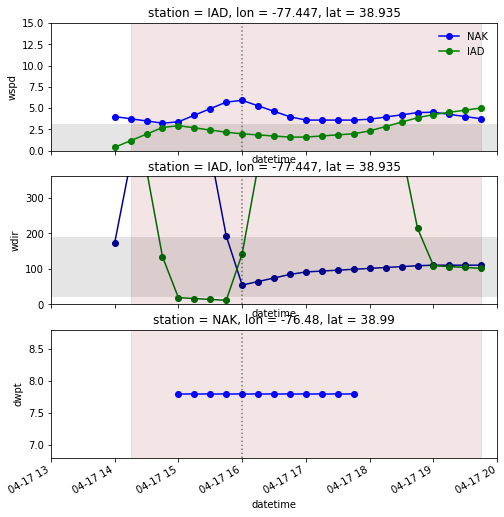

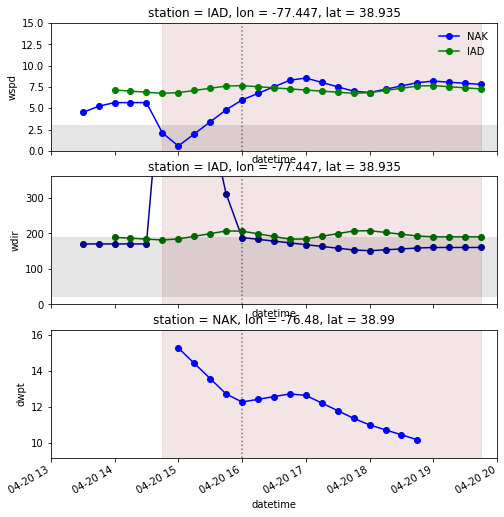

bay breeze validated for 4/21/2019


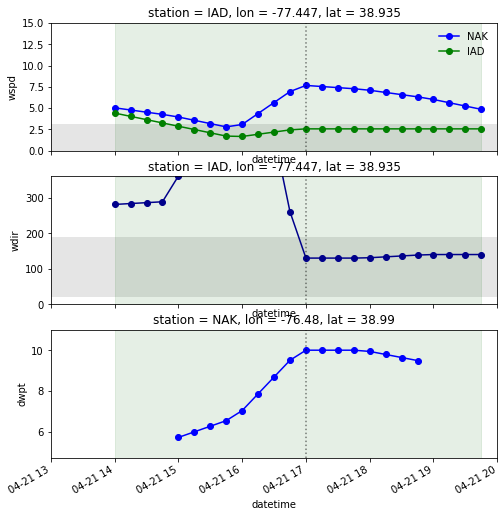

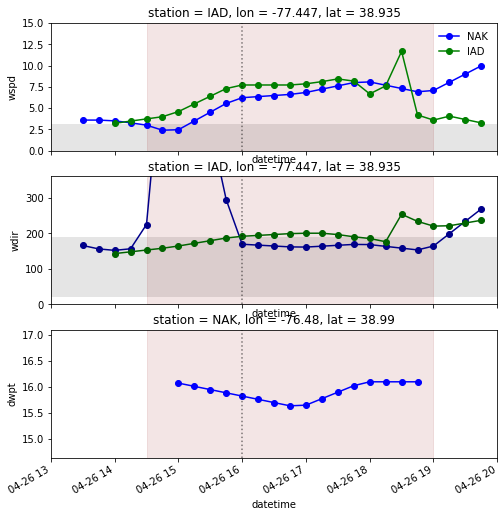

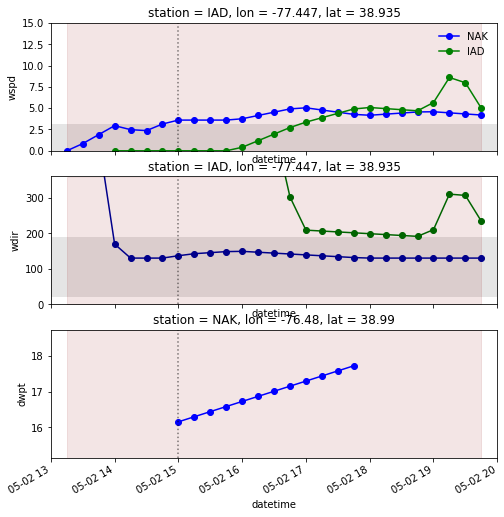

bay breeze validated for 5/6/2019


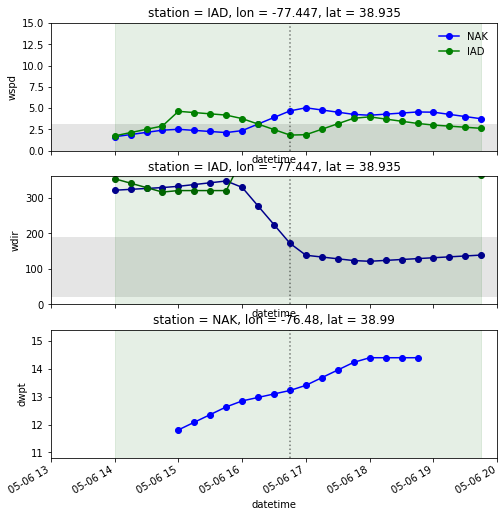

bay breeze validated for 5/23/2019


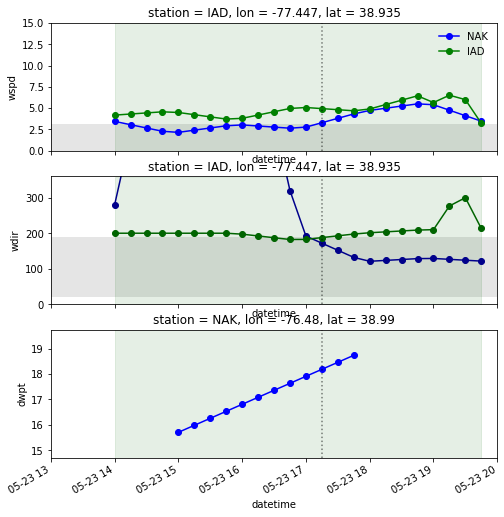

bay breeze validated for 5/30/2019


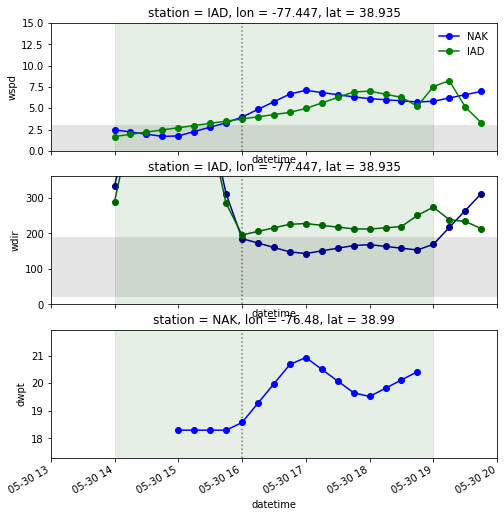

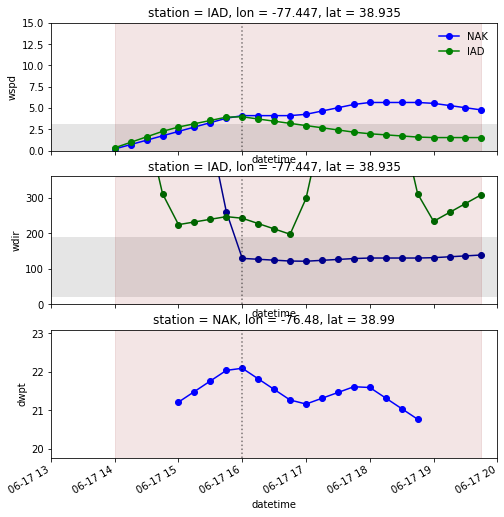

bay breeze validated for 6/19/2019


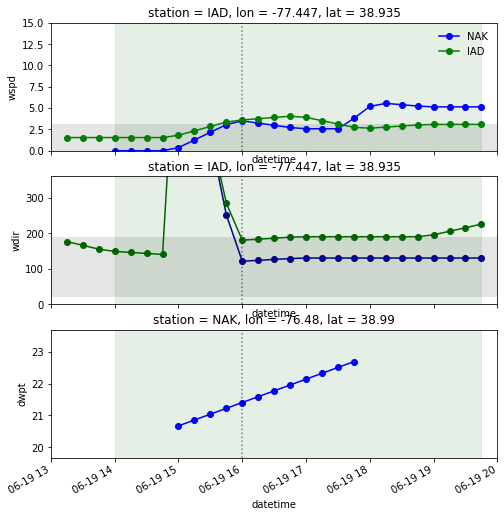

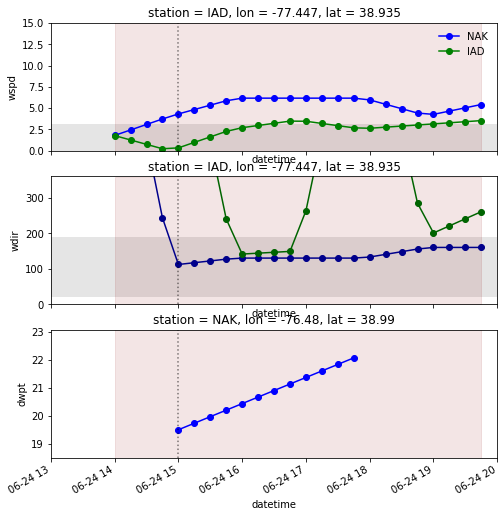

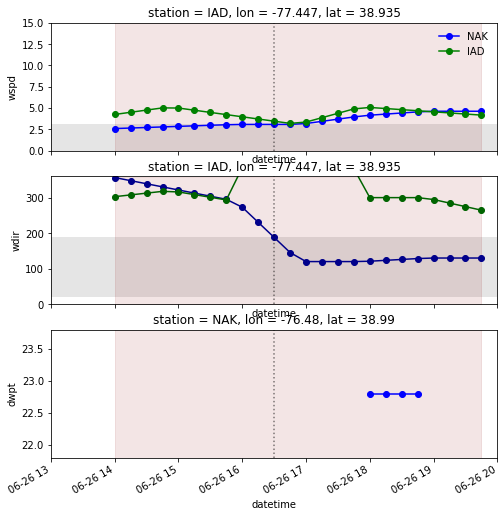

bay breeze validated for 6/27/2019


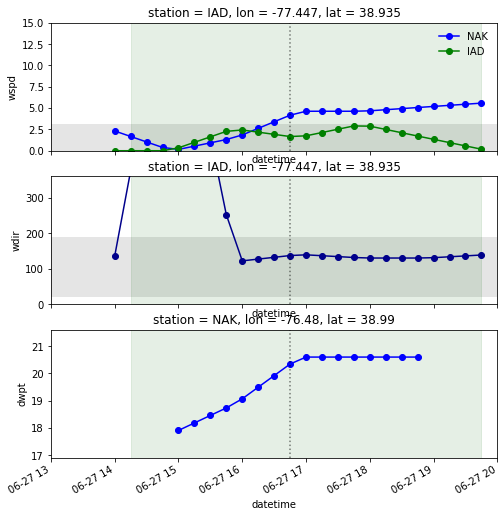

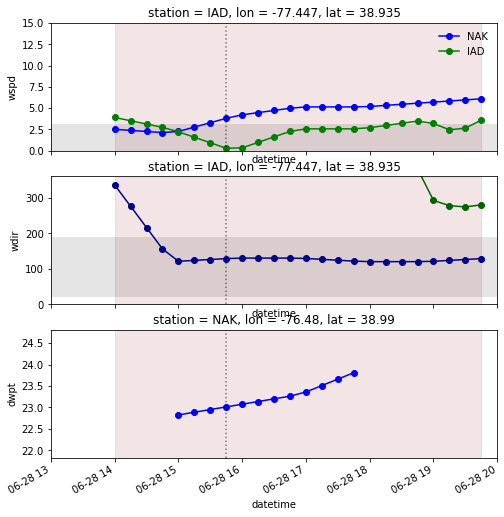

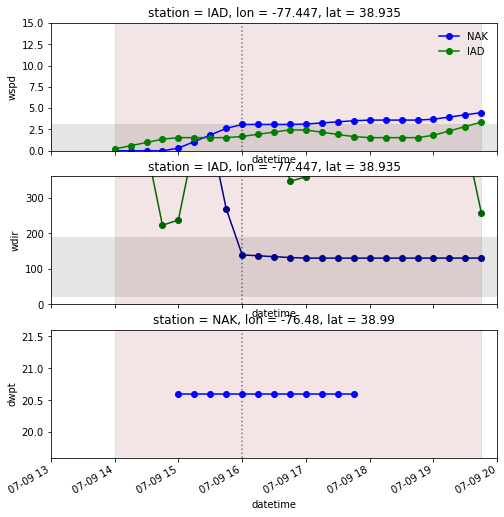

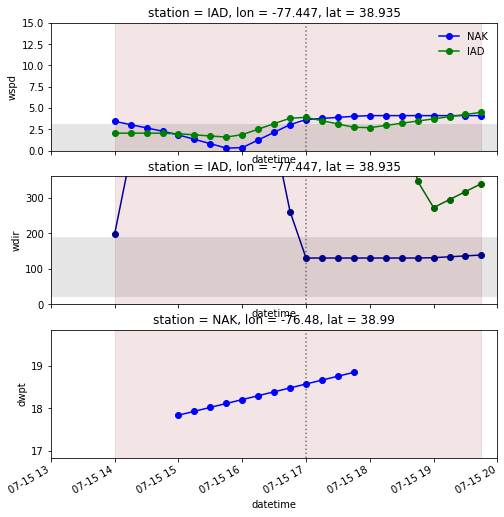

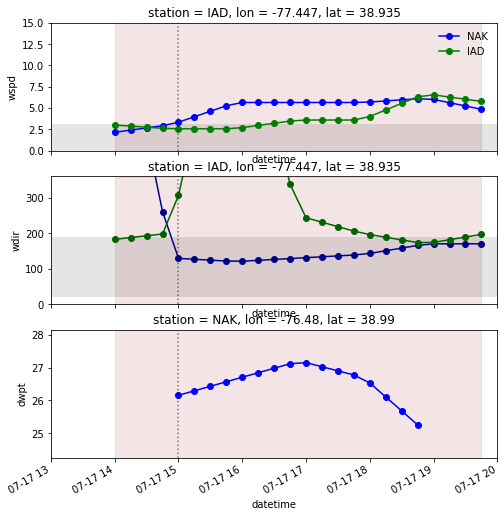

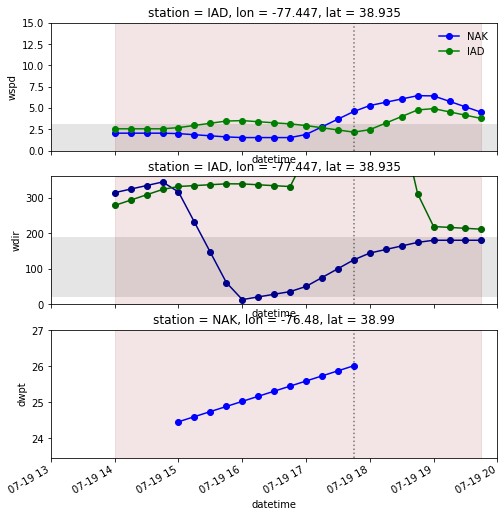

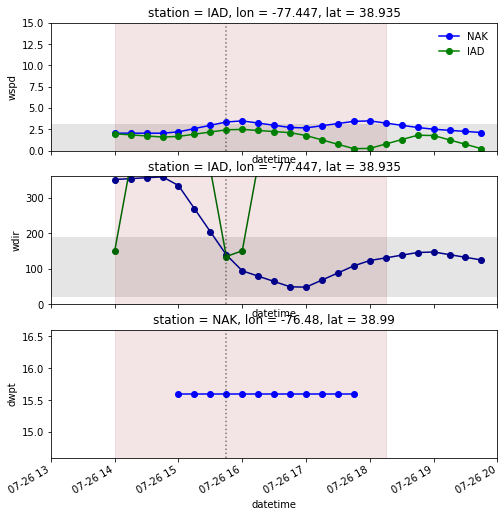

bay breeze validated for 7/28/2019


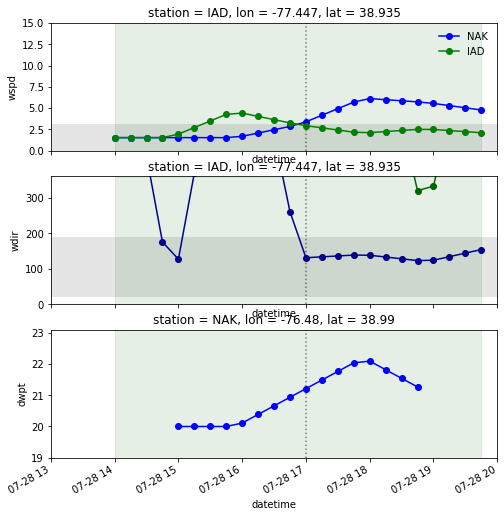

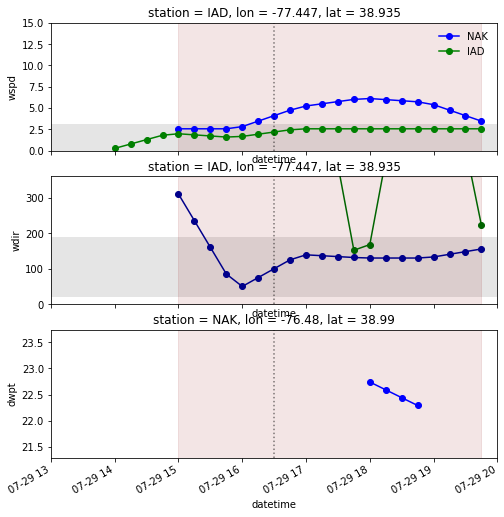

Unable to fill...
Unable to draw line...


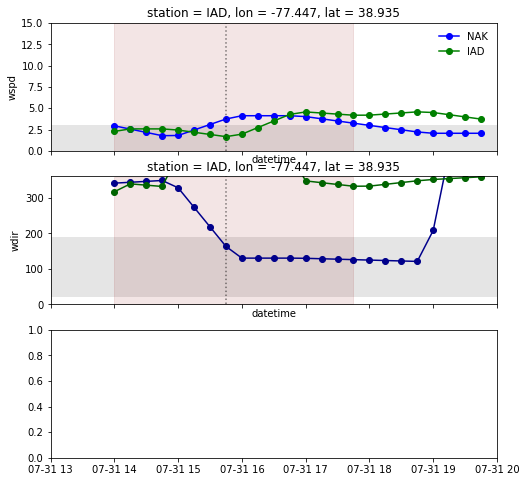

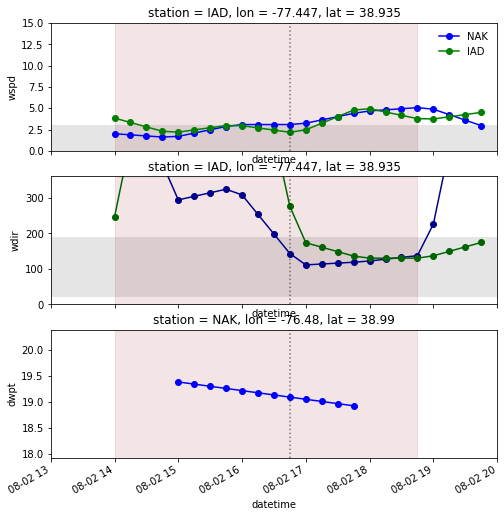

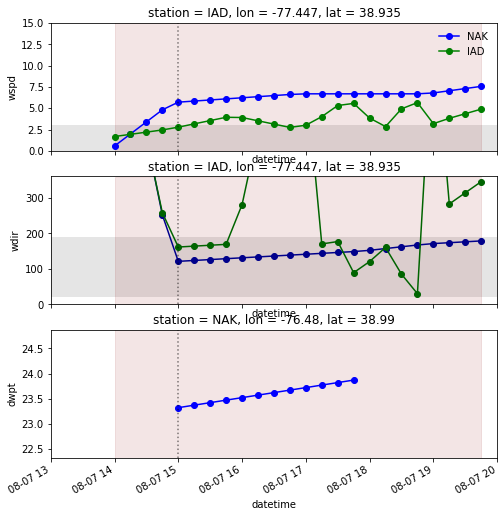

bay breeze validated for 8/11/2019


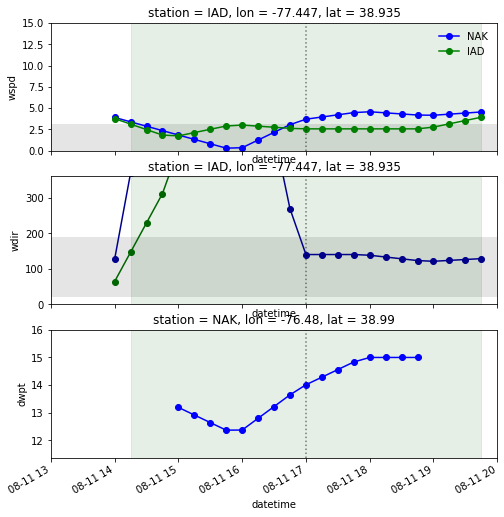

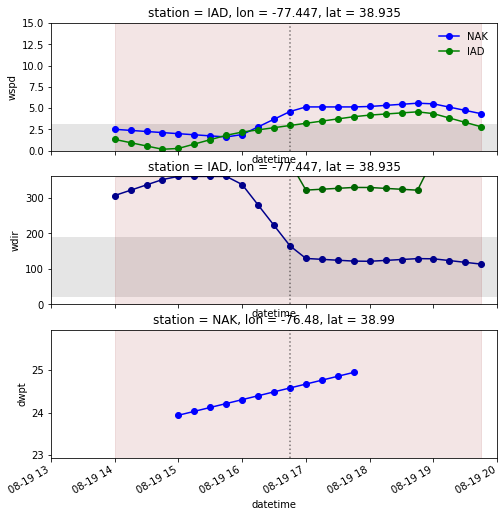

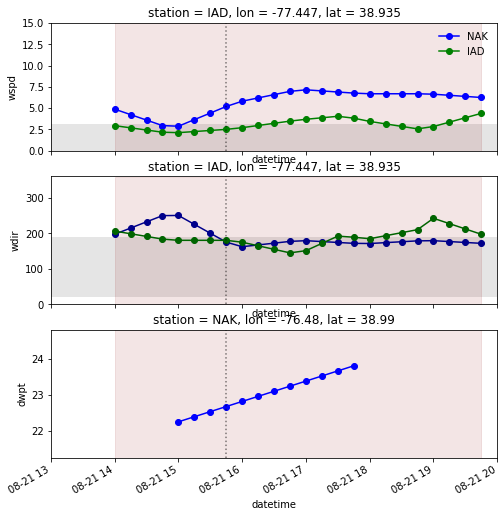

bay breeze validated for 9/7/2019


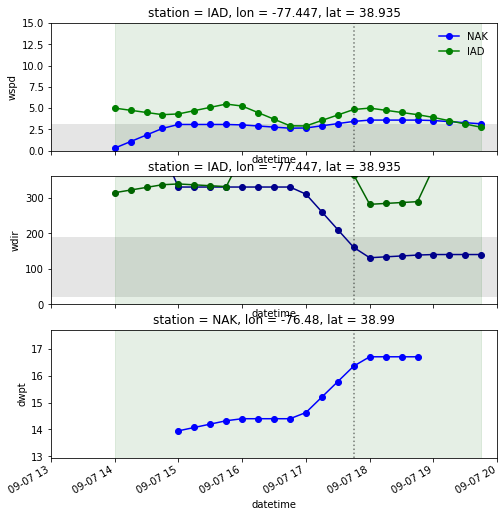

bay breeze validated for 9/8/2019


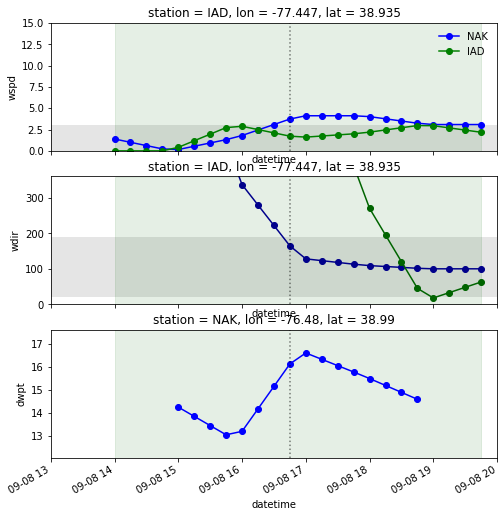

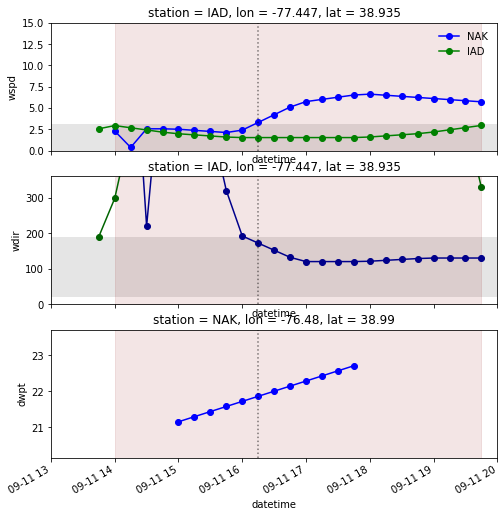

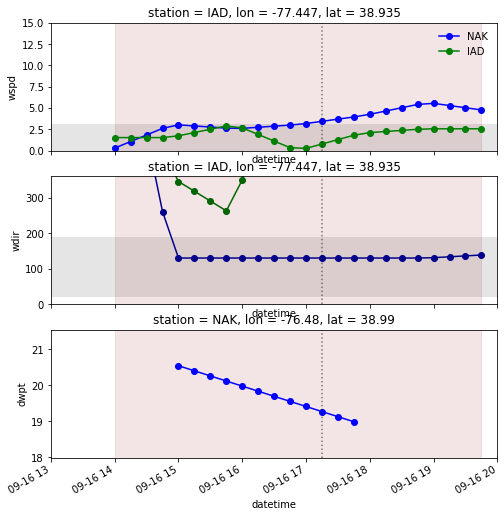

Unable to fill...
Unable to draw line...


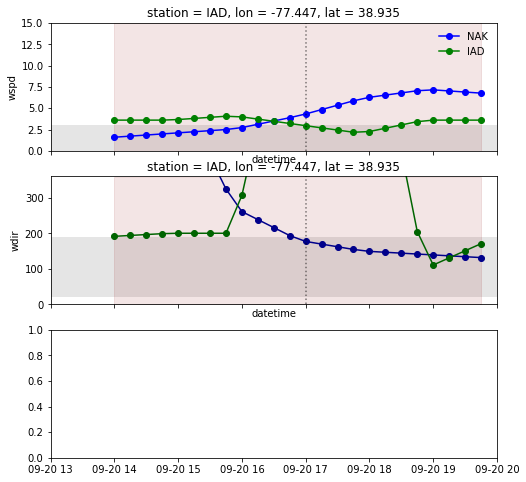

bay breeze validated for 9/21/2019


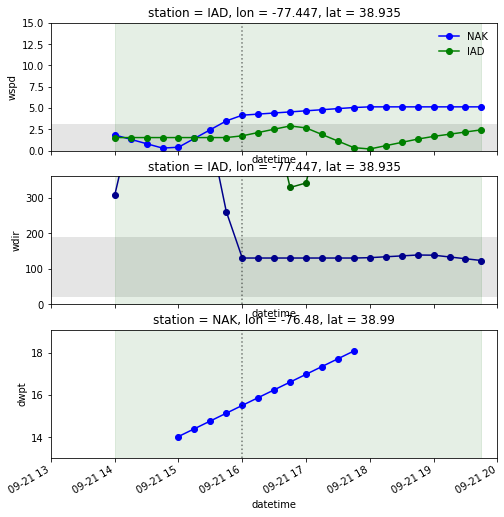

bay breeze validated for 9/23/2019


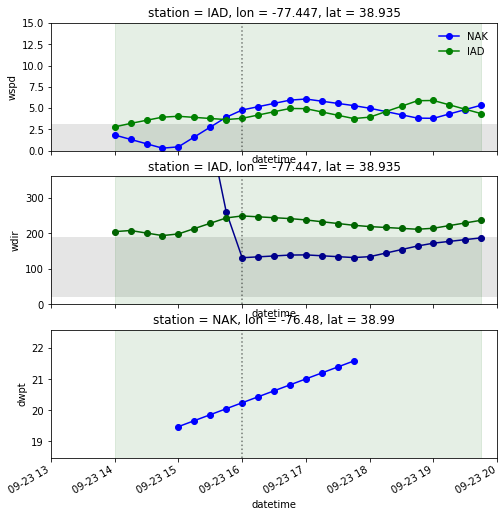

bay breeze validated for 9/25/2019


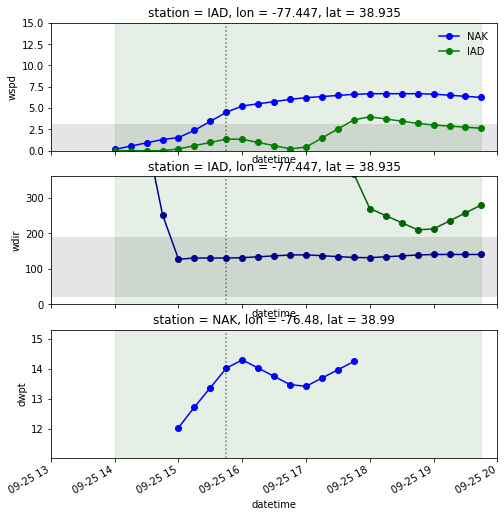

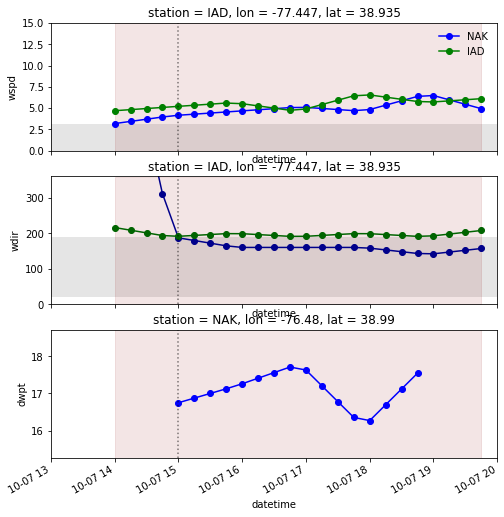

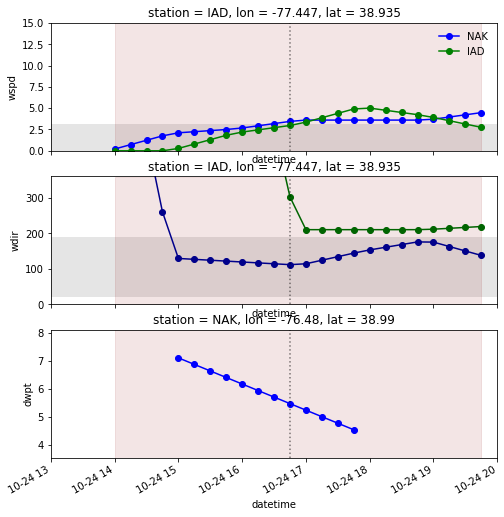

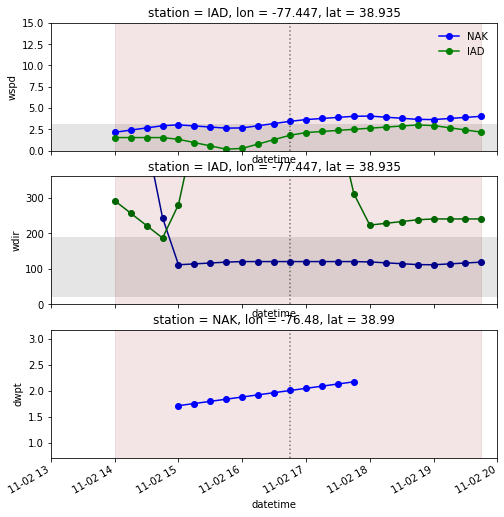

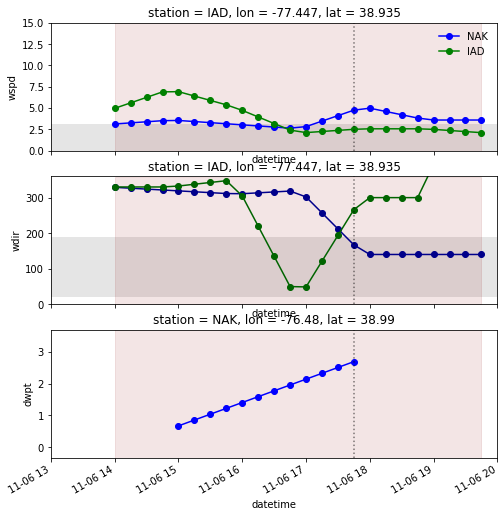

bay breeze validated for 11/10/2019


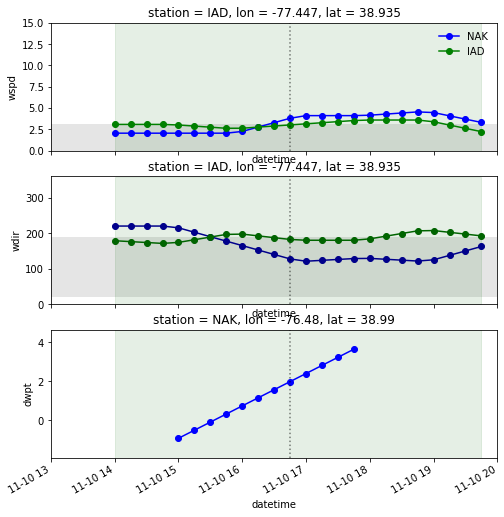

bay breeze validated for 11/11/2019


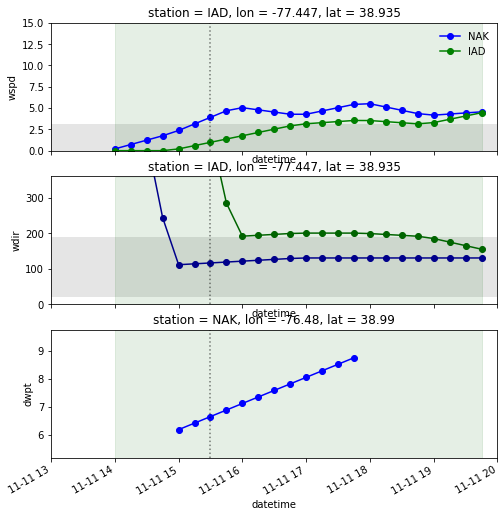

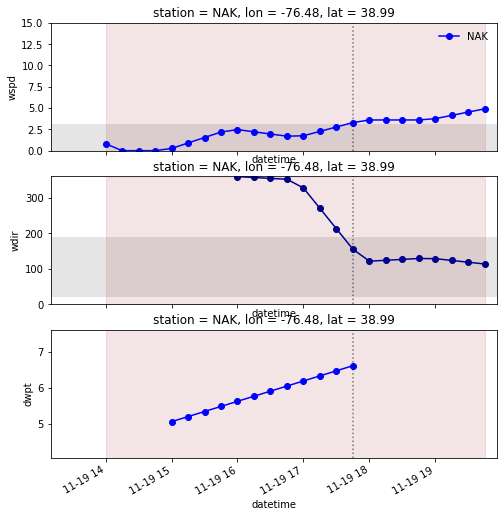

bay breeze validated for 11/25/2019


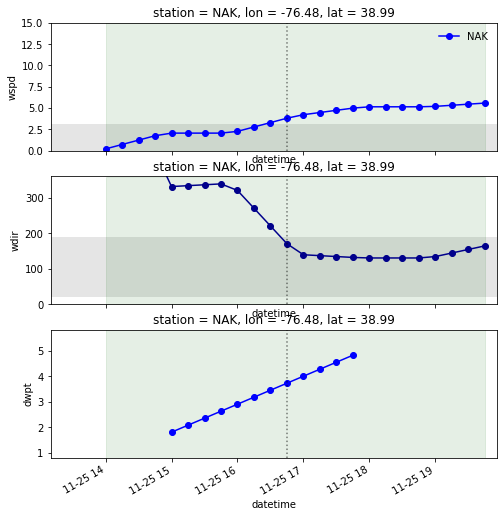

bay breeze validated for 11/26/2019


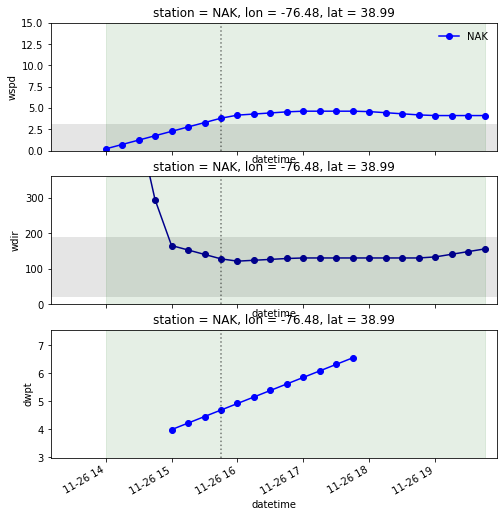

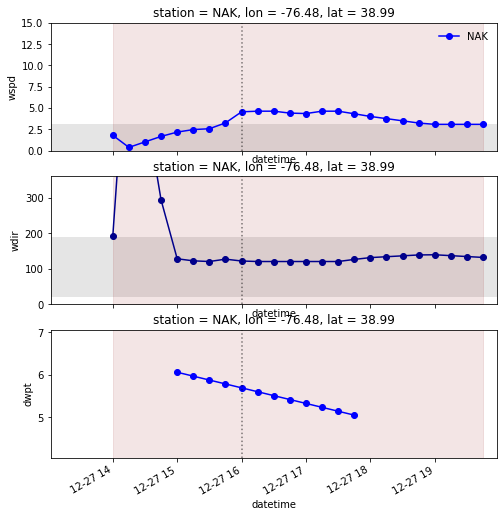

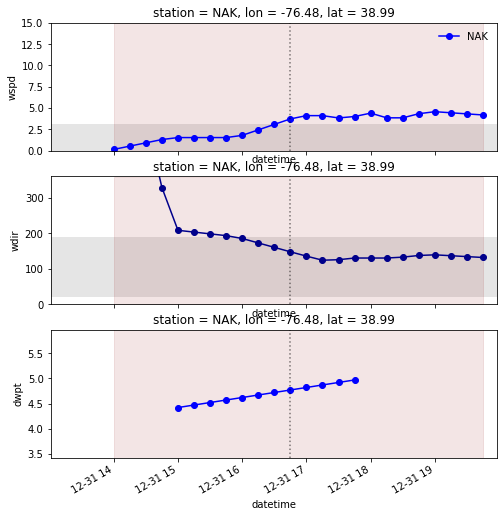

starting station: NHK
Year: 2019


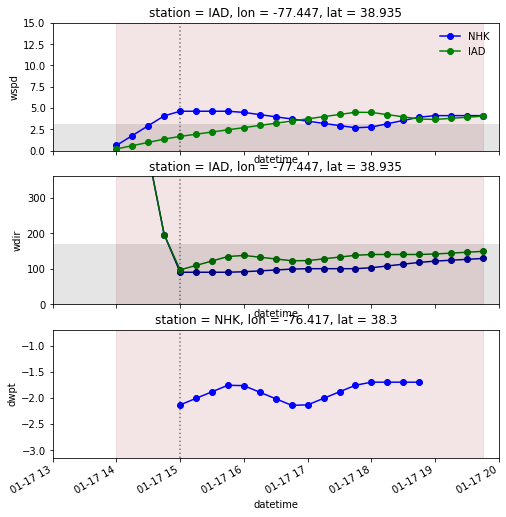

bay breeze validated for 2/2/2019


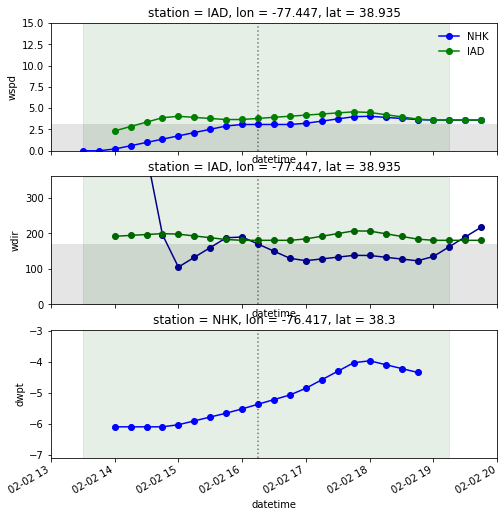

bay breeze validated for 2/10/2019


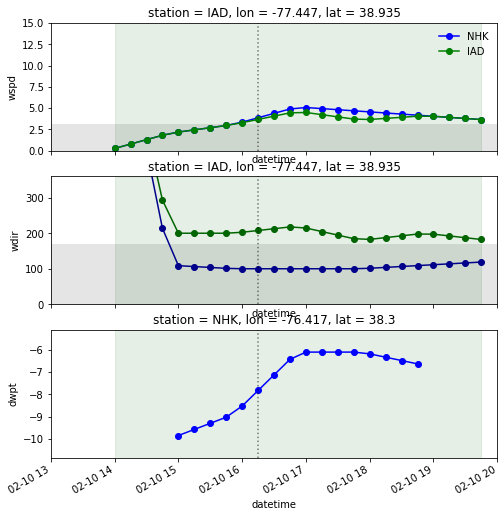

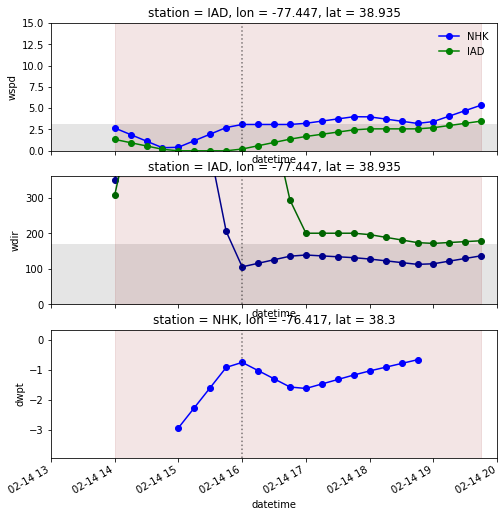

bay breeze validated for 2/16/2019


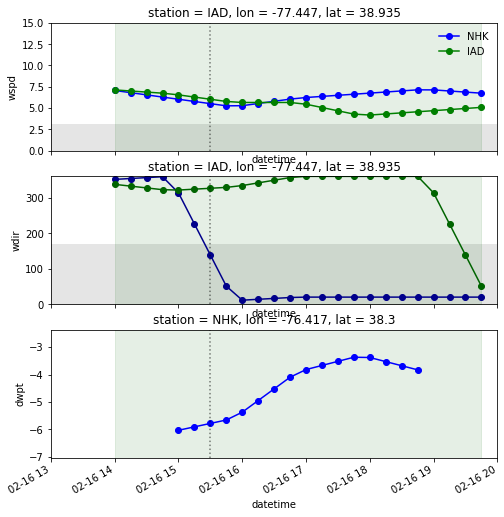

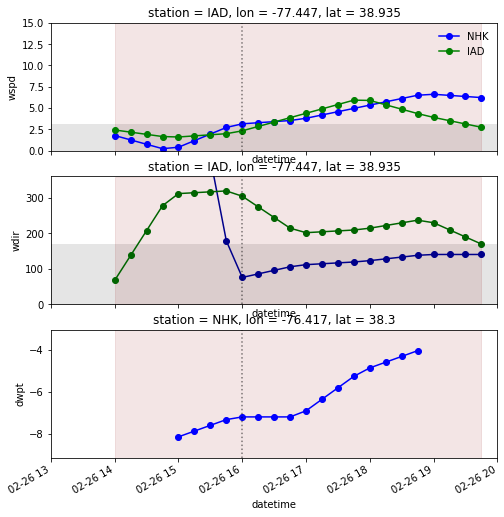

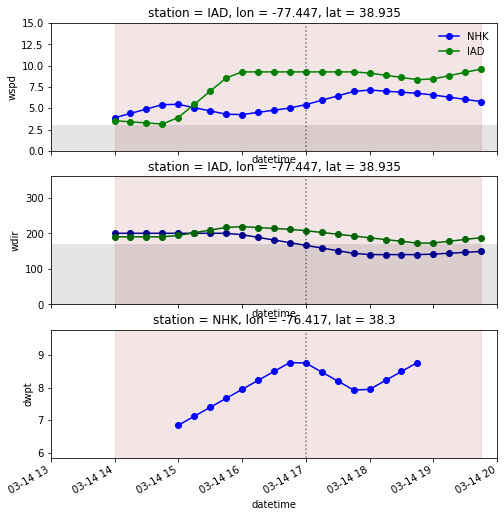

bay breeze validated for 3/17/2019


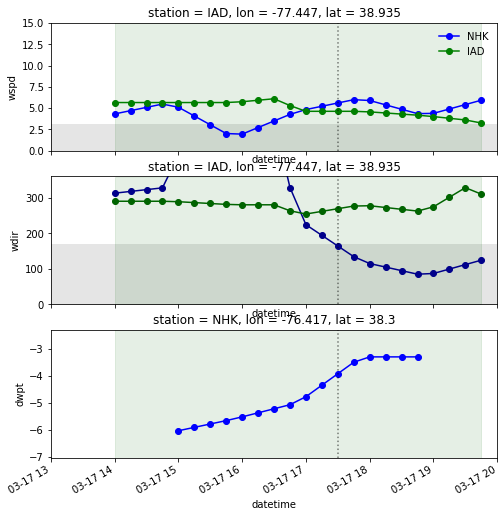

bay breeze validated for 3/24/2019


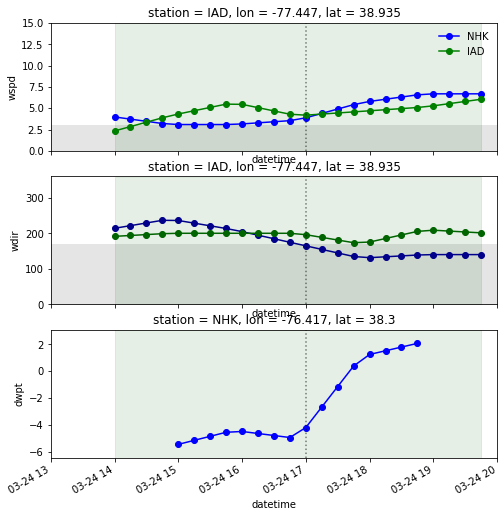

bay breeze validated for 3/29/2019


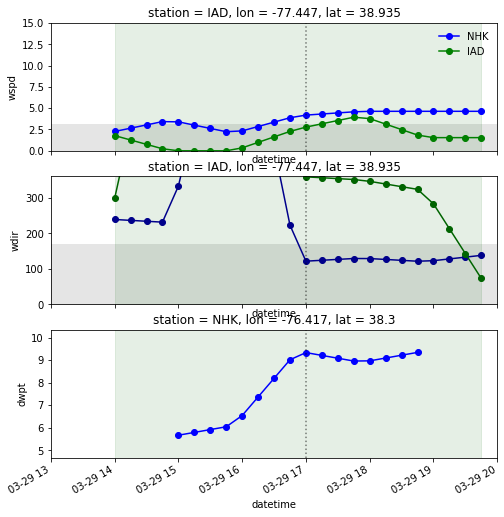

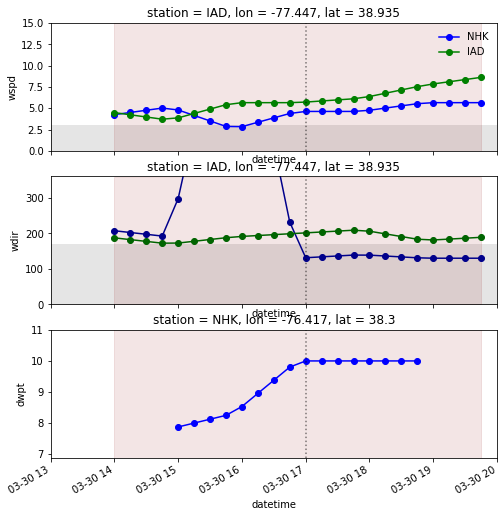

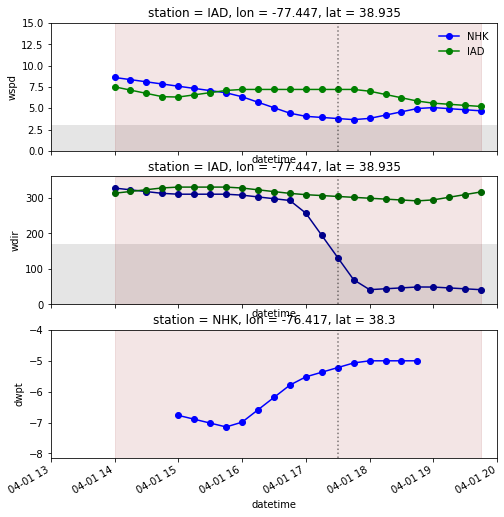

bay breeze validated for 4/10/2019


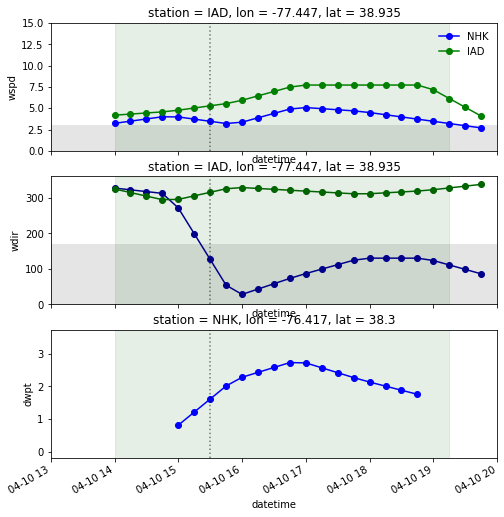

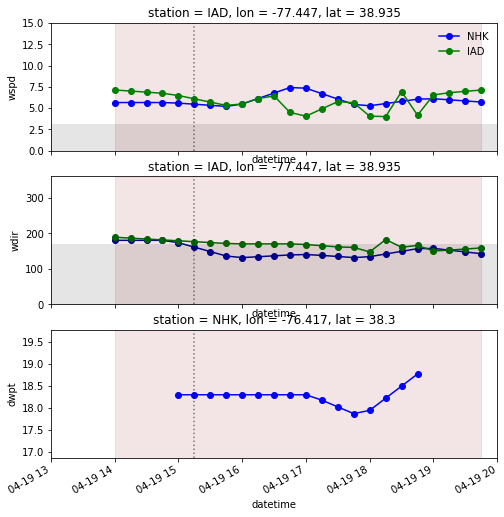

bay breeze validated for 4/21/2019


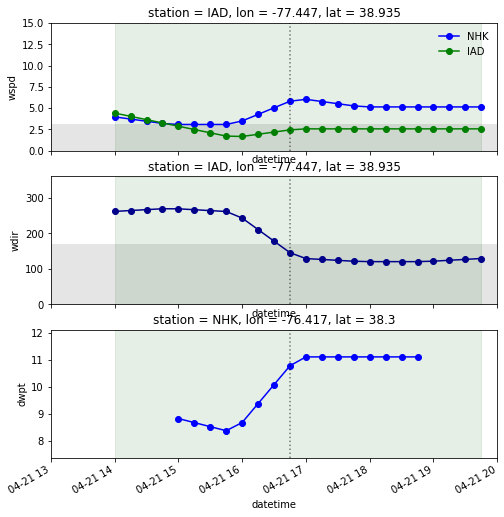

bay breeze validated for 4/26/2019


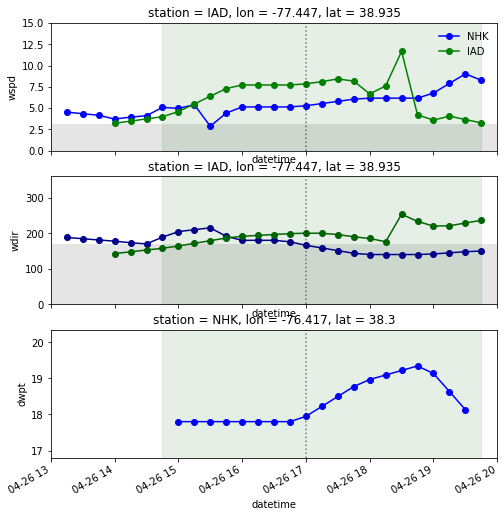

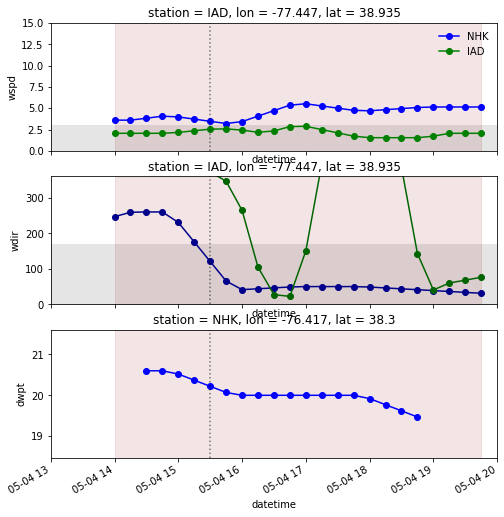

bay breeze validated for 5/7/2019


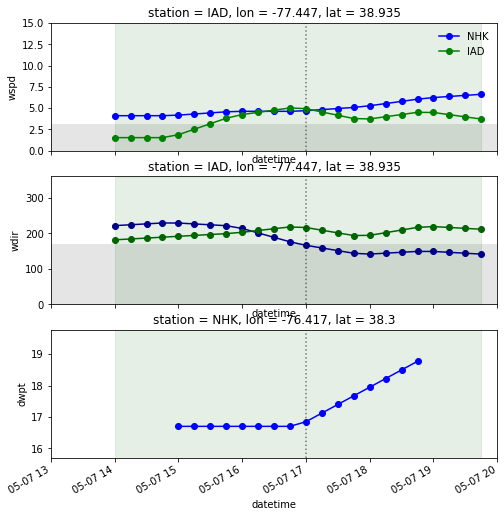

bay breeze validated for 5/16/2019


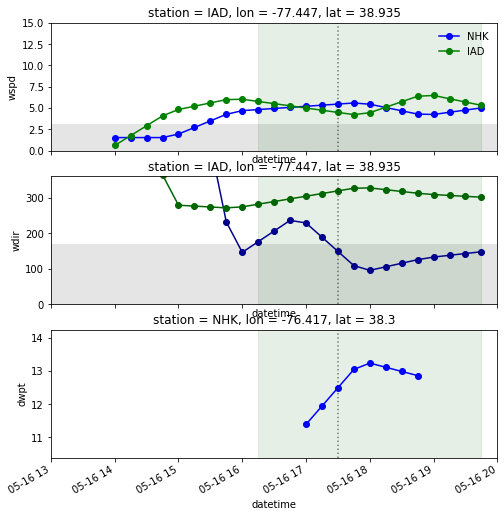

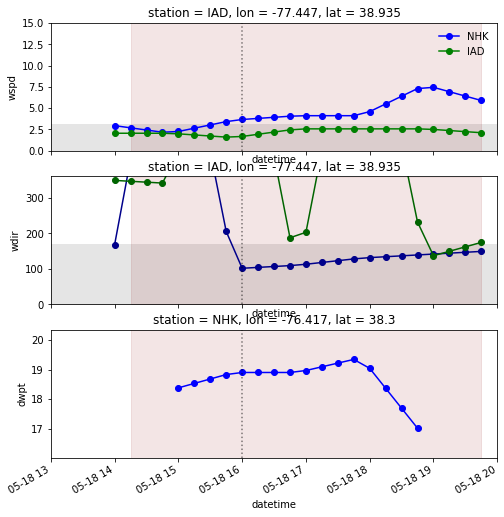

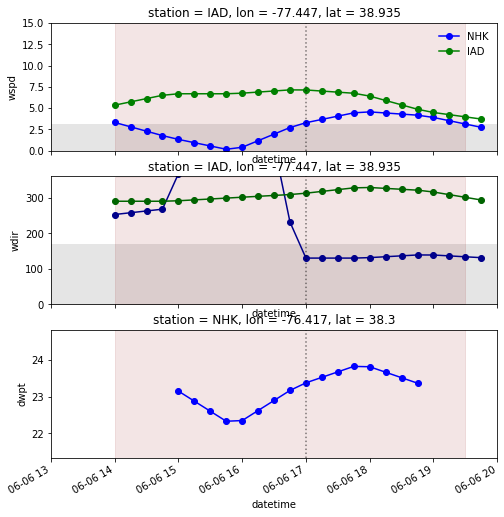

bay breeze validated for 6/17/2019


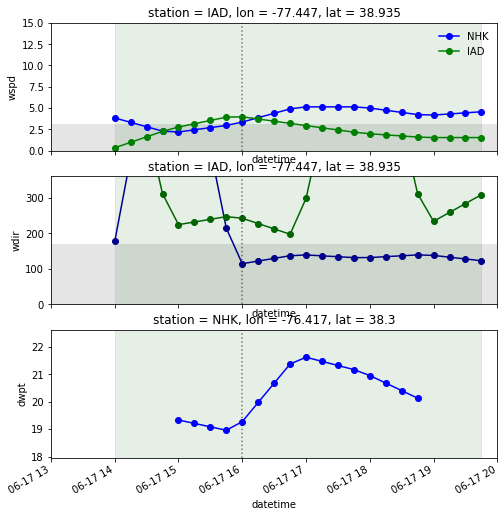

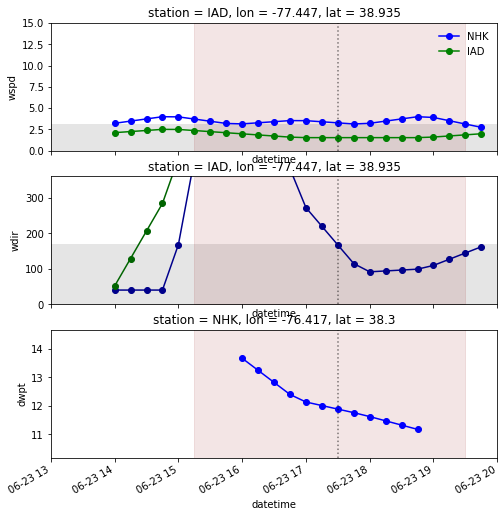

bay breeze validated for 6/24/2019


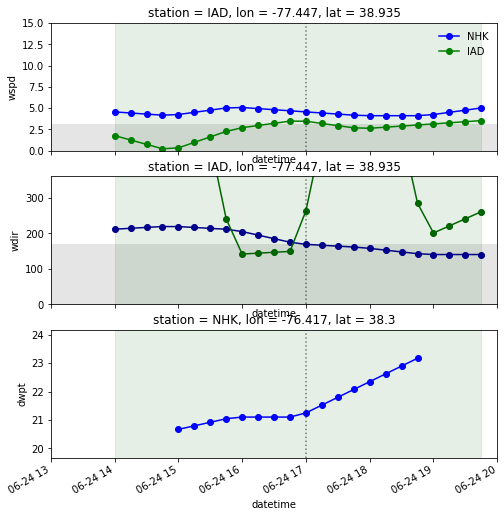

bay breeze validated for 6/28/2019


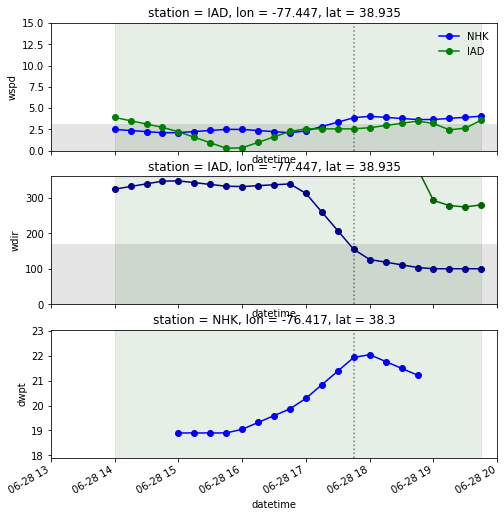

bay breeze validated for 7/10/2019


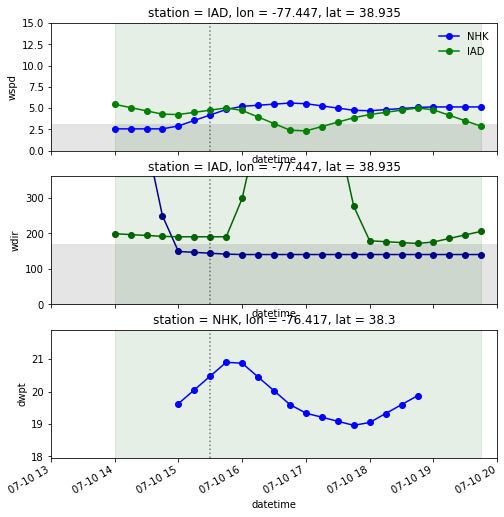

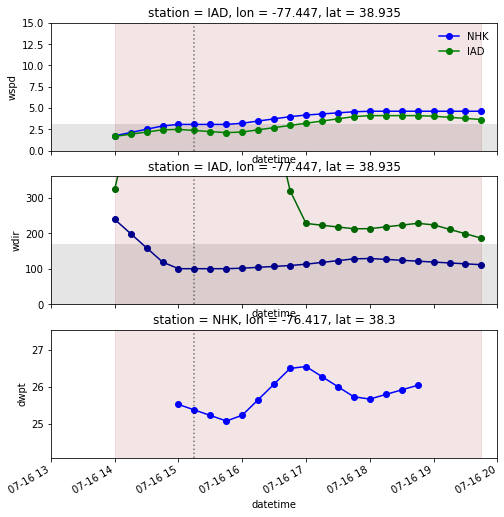

bay breeze validated for 7/19/2019


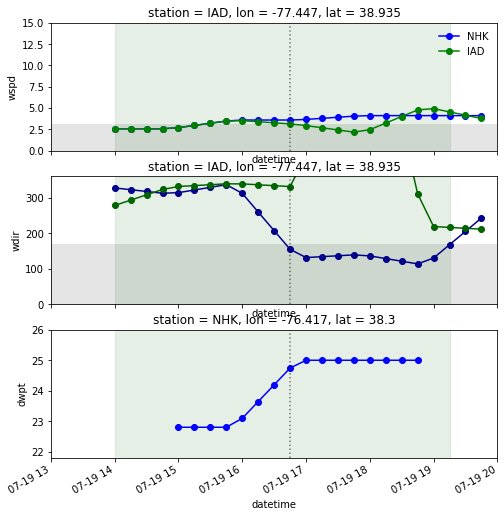

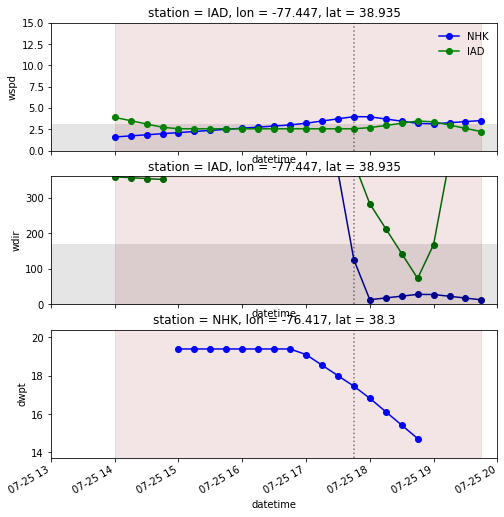

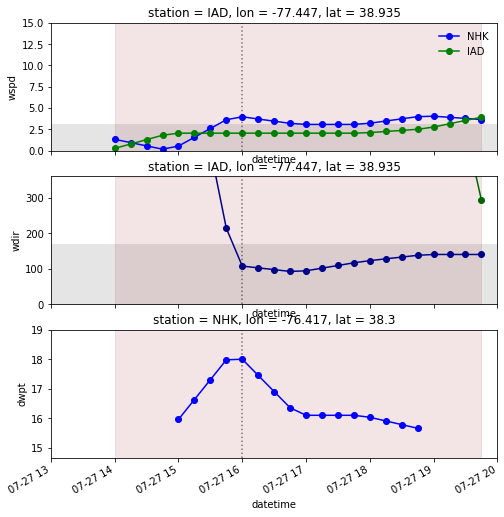

bay breeze validated for 7/28/2019


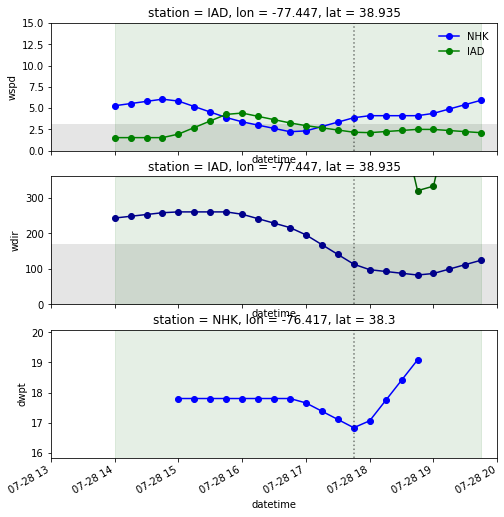

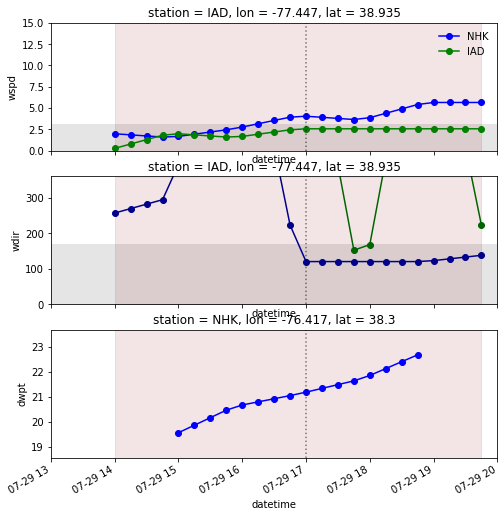

bay breeze validated for 7/30/2019


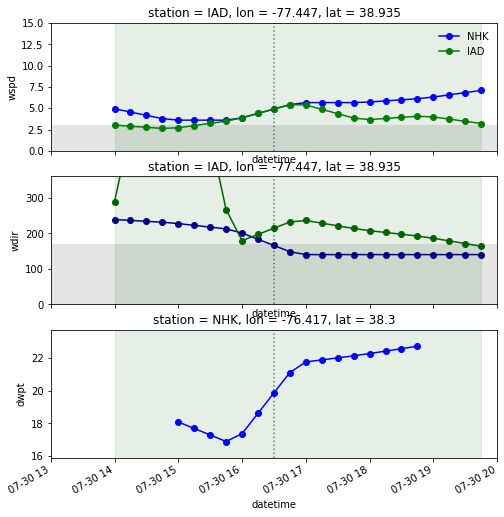

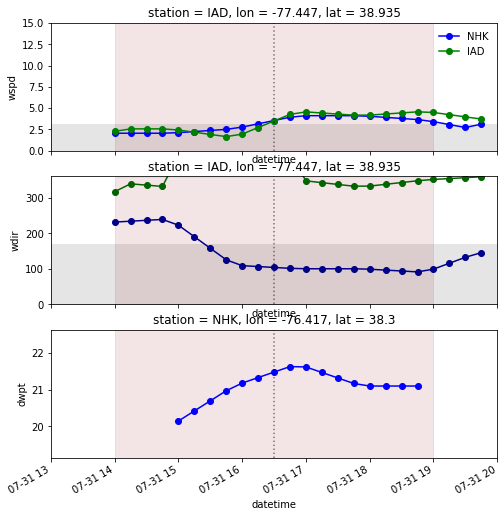

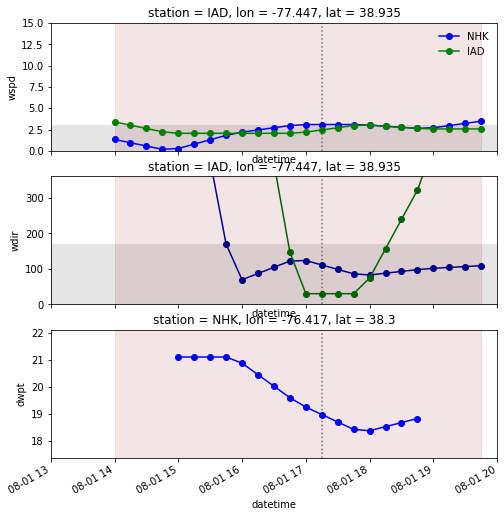

bay breeze validated for 8/2/2019


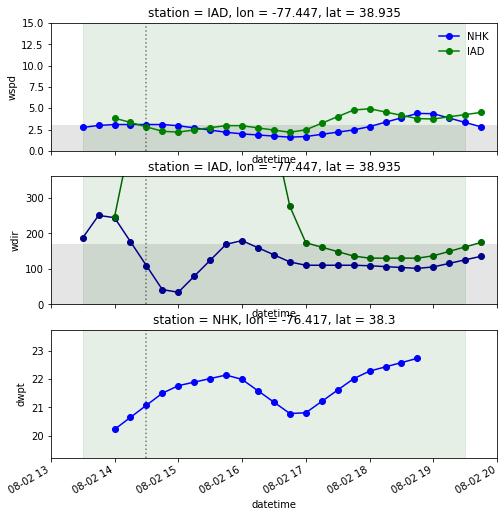

bay breeze validated for 8/14/2019


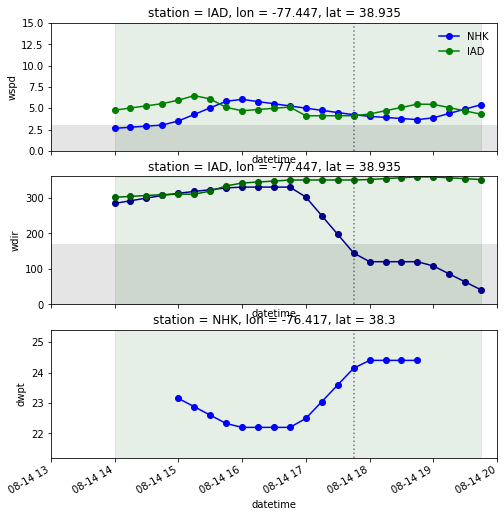

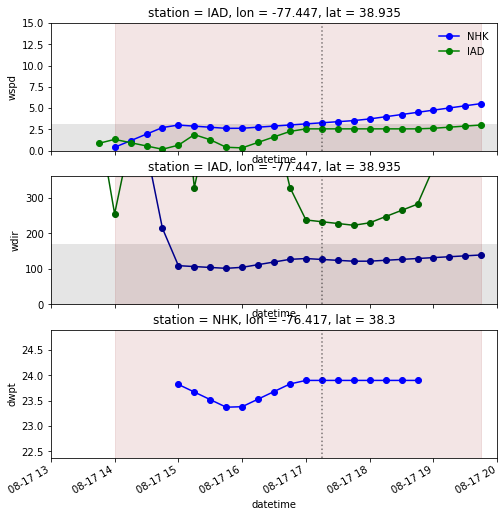

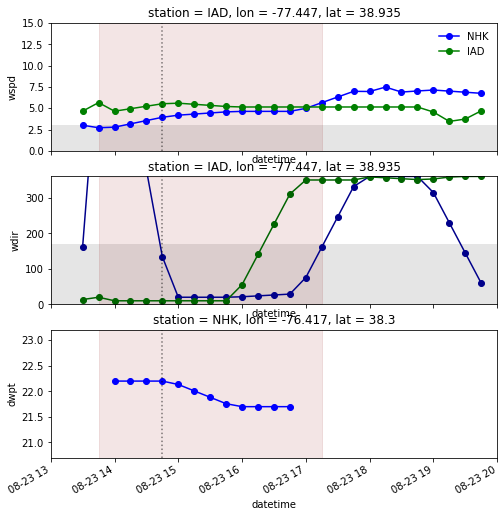

bay breeze validated for 9/16/2019


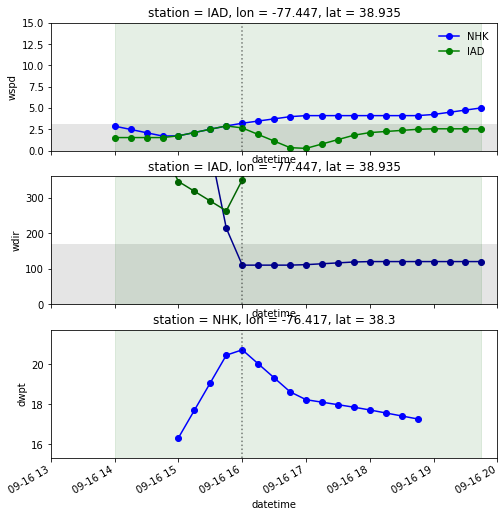

bay breeze validated for 9/20/2019


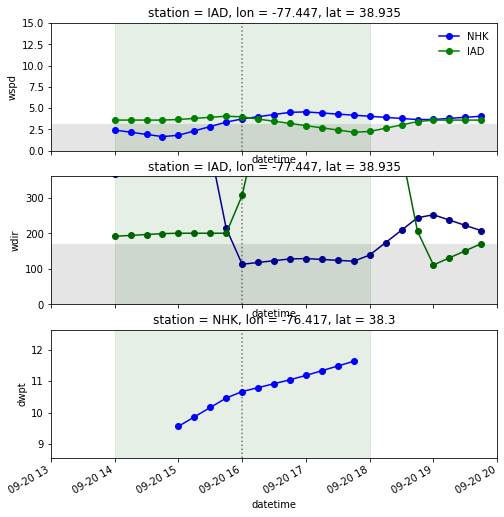

bay breeze validated for 9/21/2019


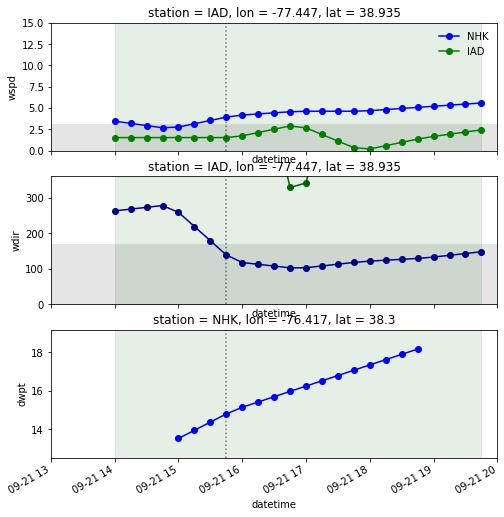

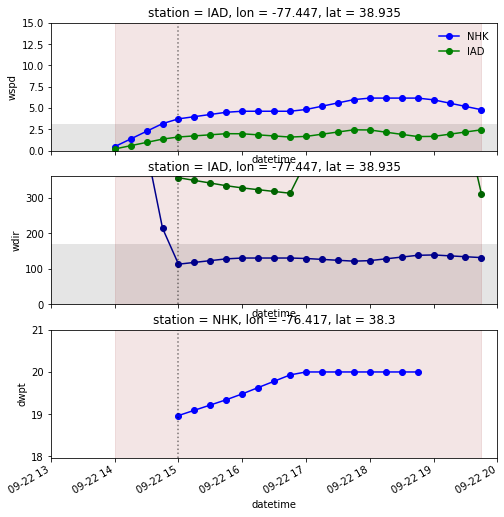

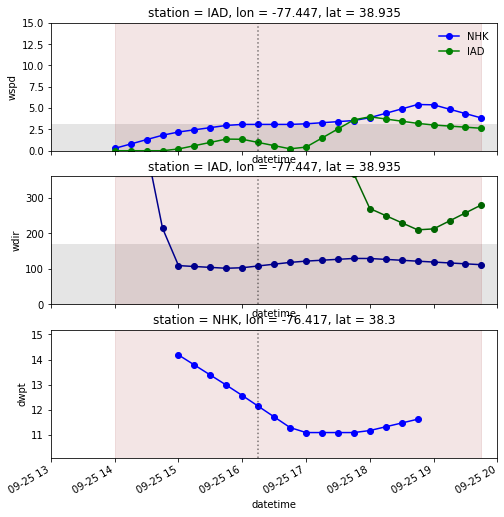

bay breeze validated for 10/1/2019


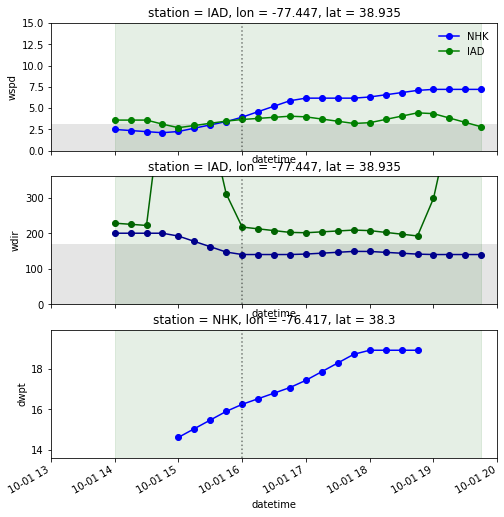

bay breeze validated for 10/7/2019


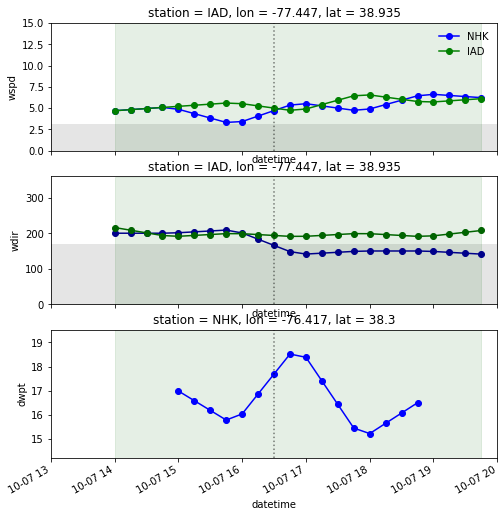

bay breeze validated for 10/11/2019


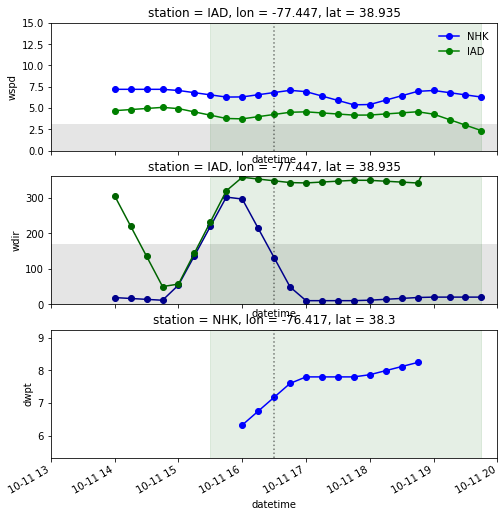

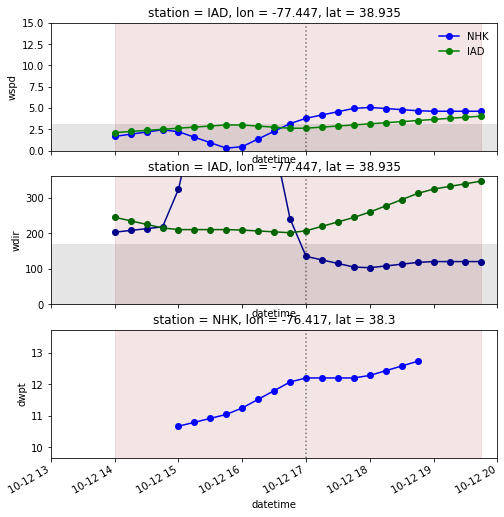

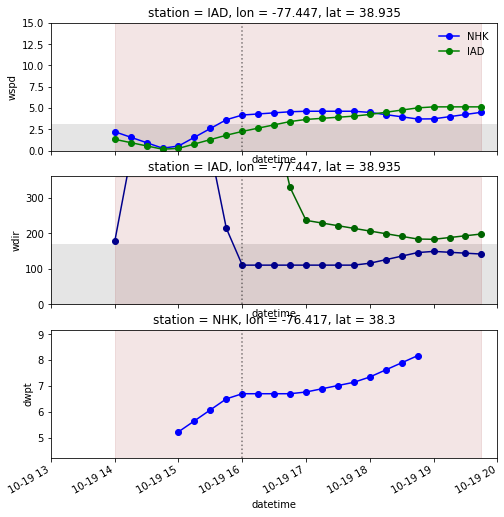

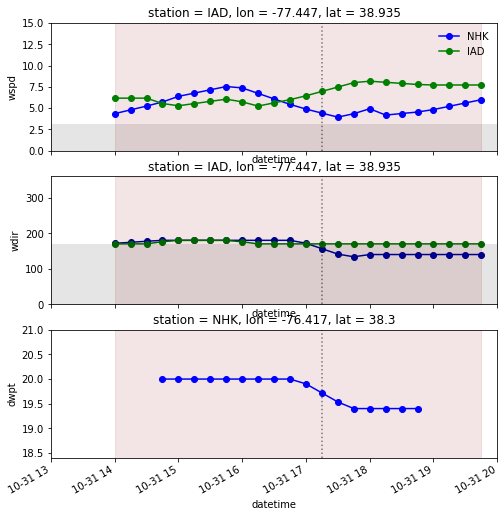

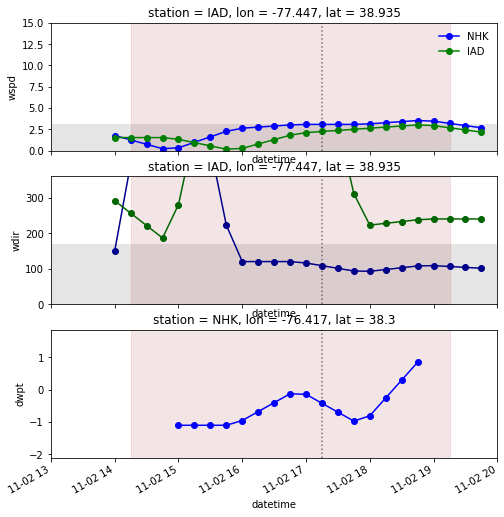

bay breeze validated for 11/6/2019


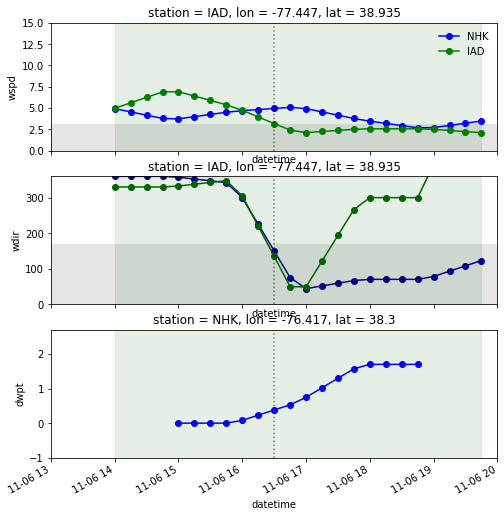

bay breeze validated for 11/11/2019


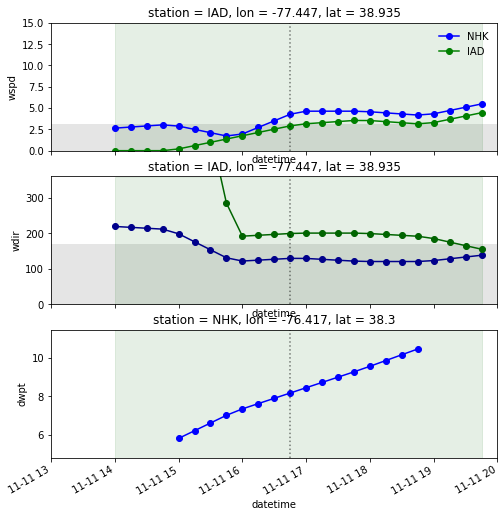

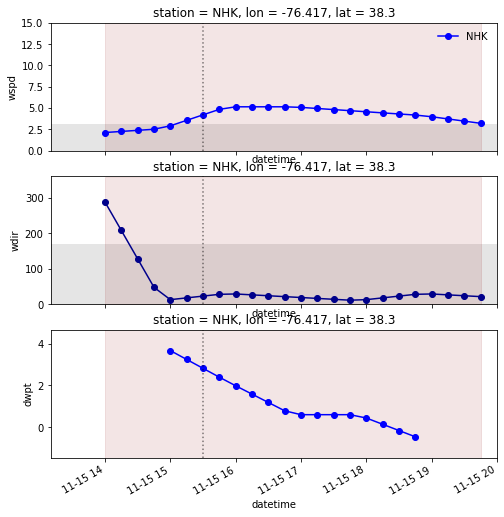

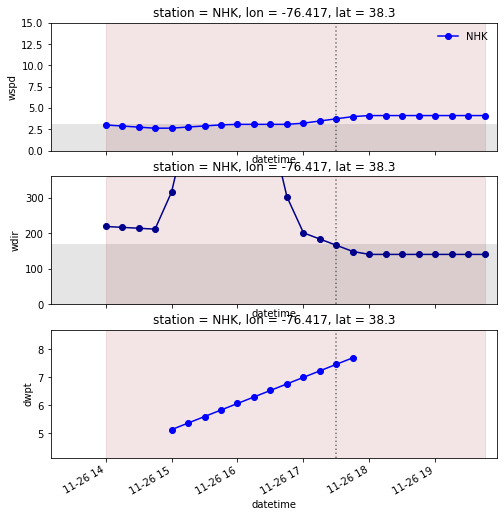

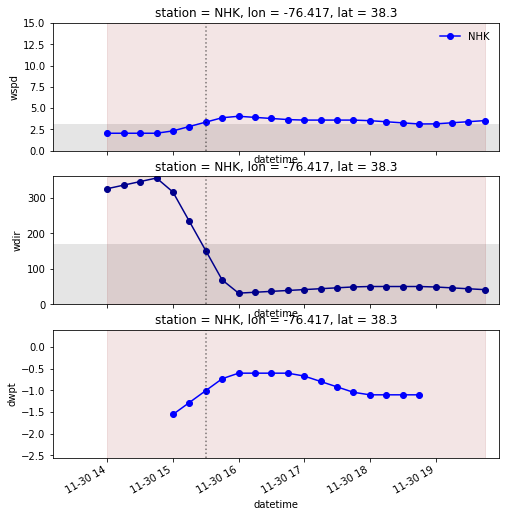

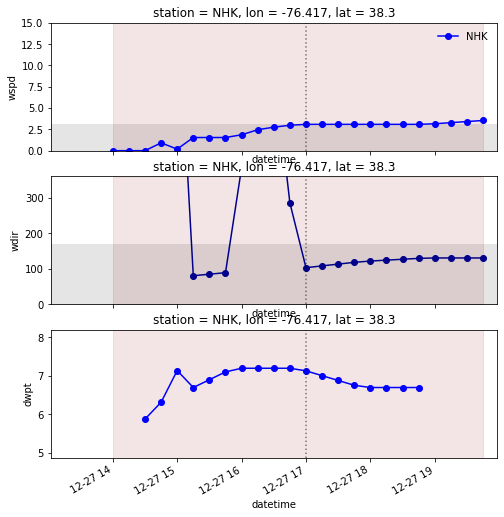

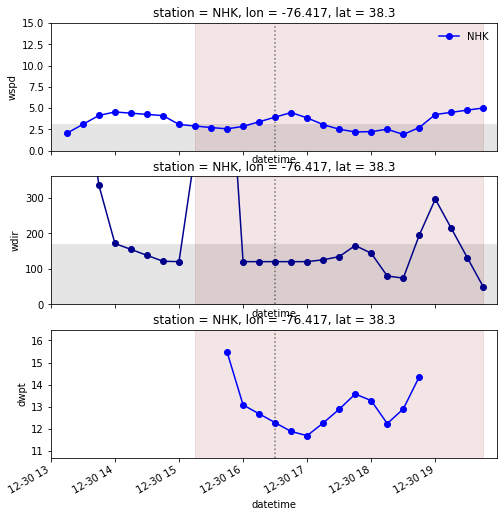

starting station: NUI
Year: 2019


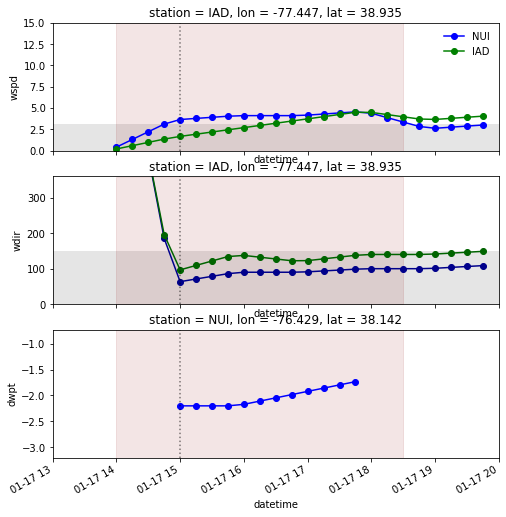

bay breeze validated for 2/16/2019


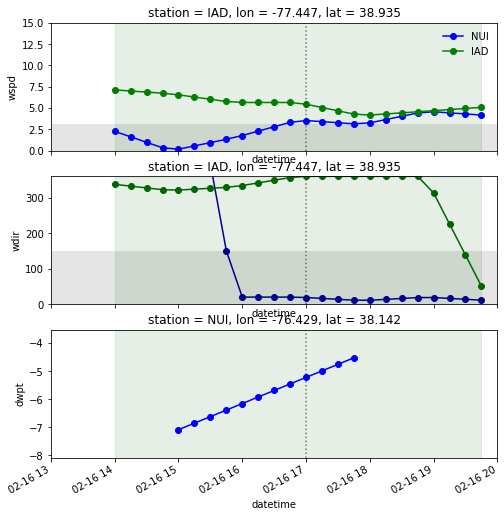

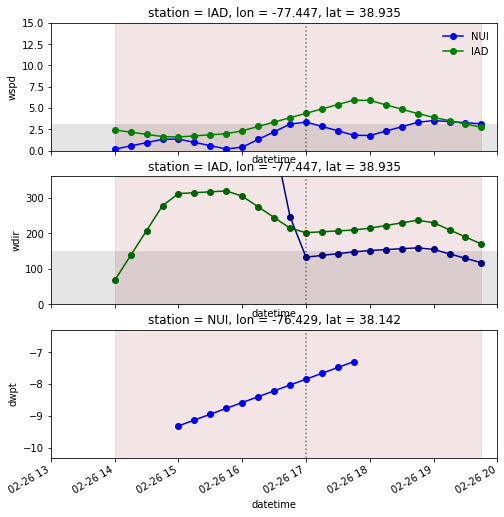

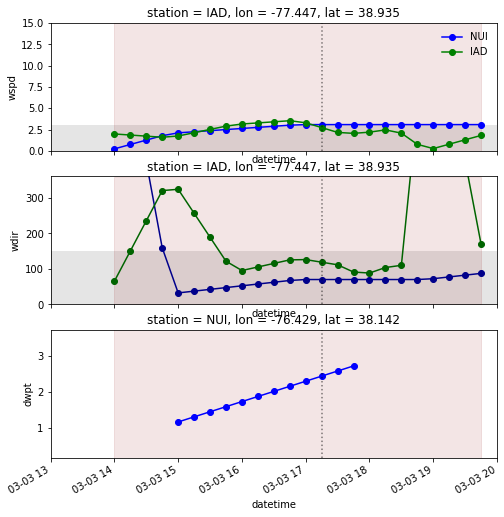

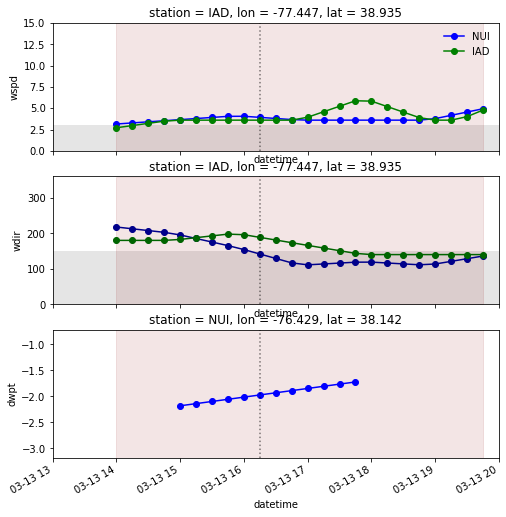

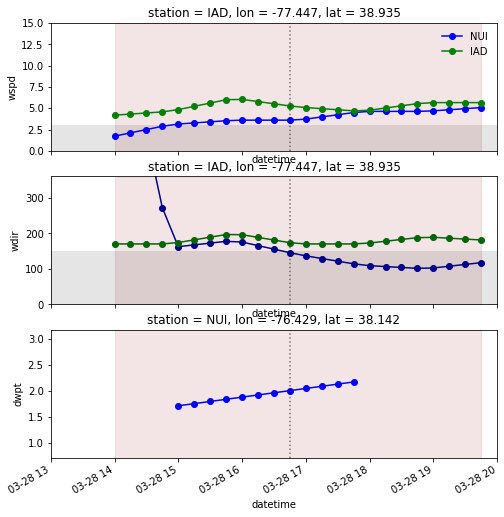

Unable to fill...
Unable to draw line...


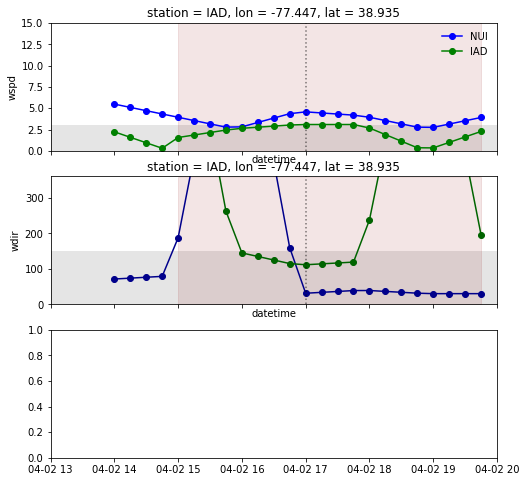

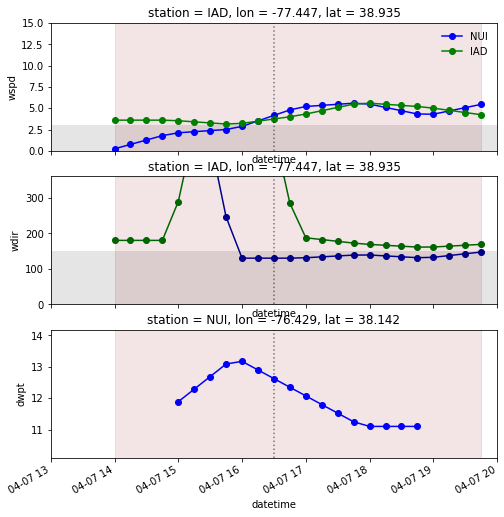

Unable to fill...
Unable to draw line...


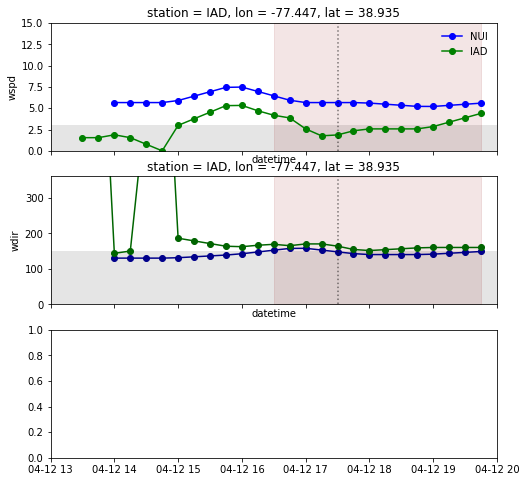

bay breeze validated for 4/17/2019


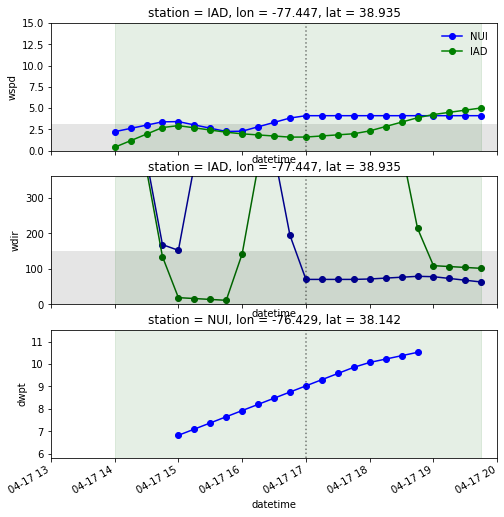

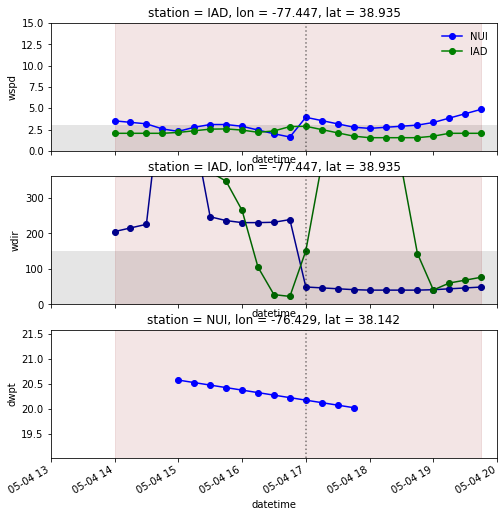

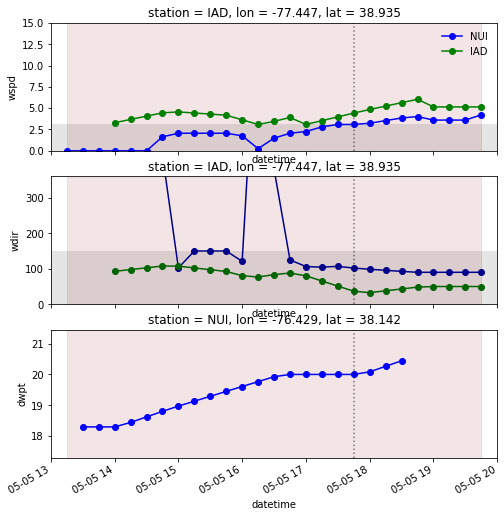

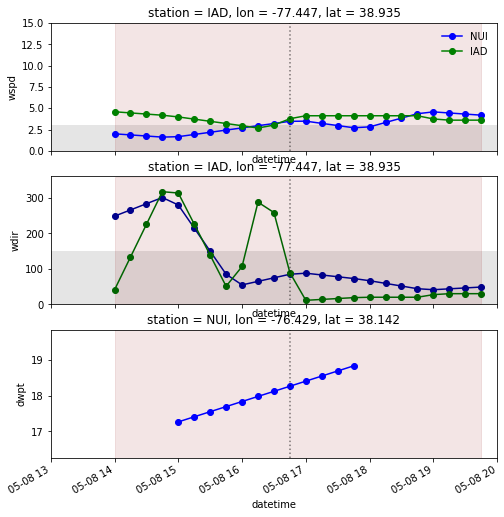

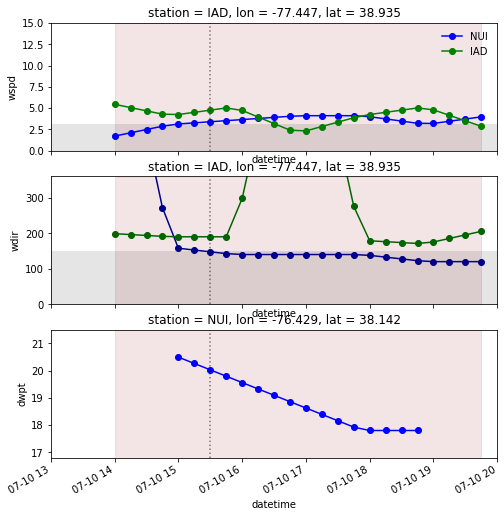

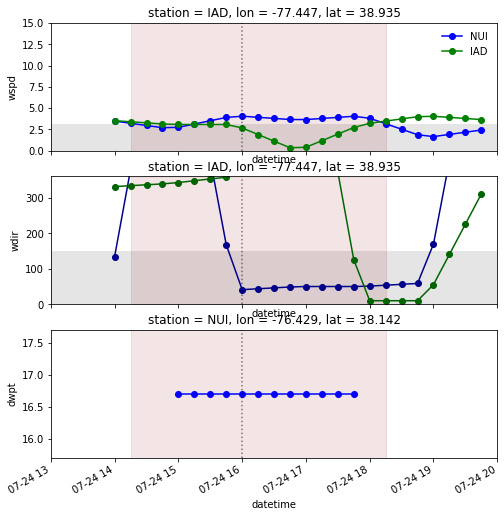

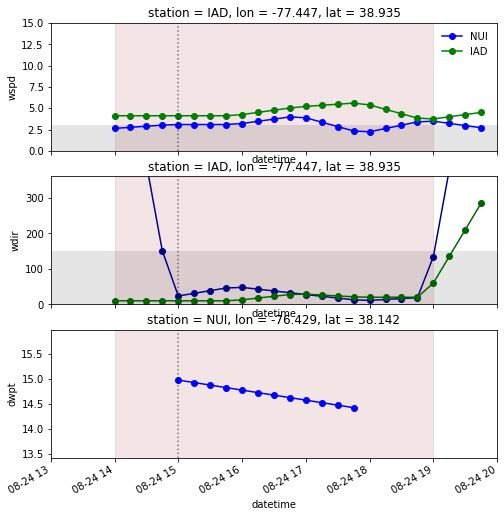

Unable to fill...
Unable to draw line...


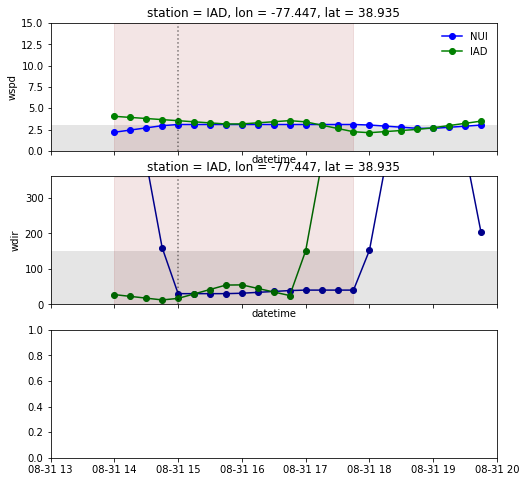

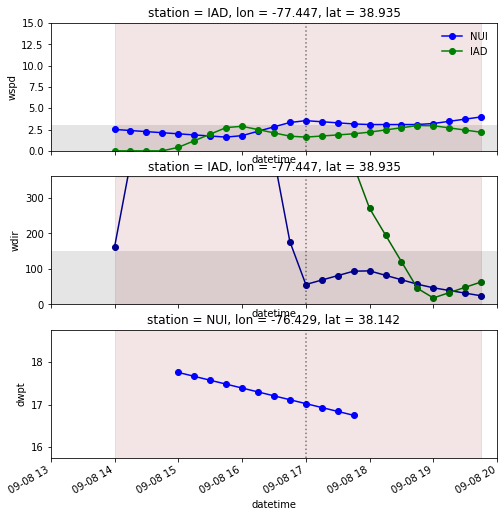

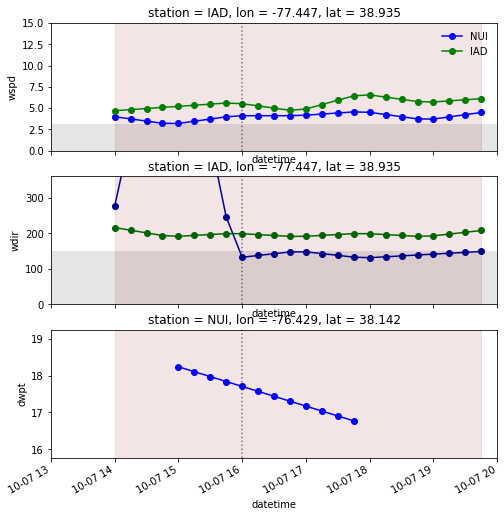

Unable to fill...
Unable to draw line...


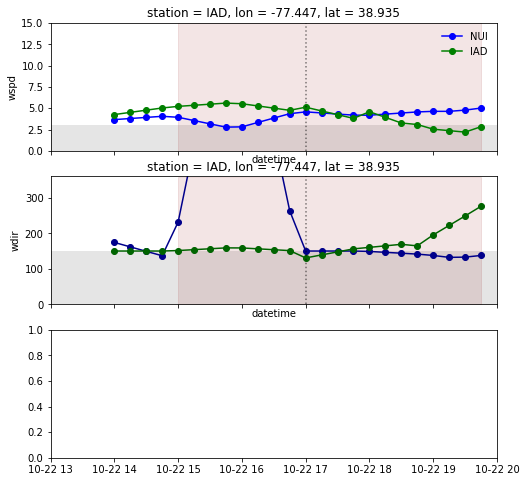

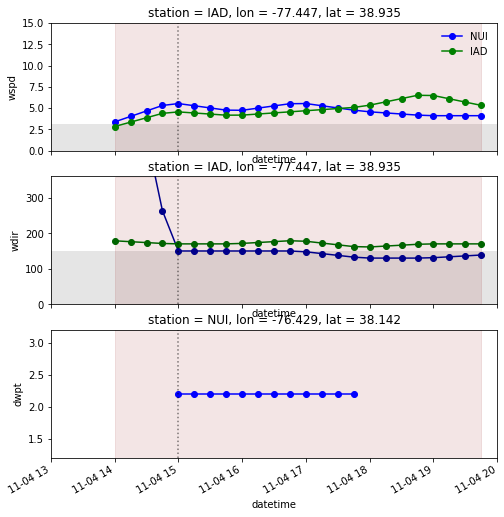

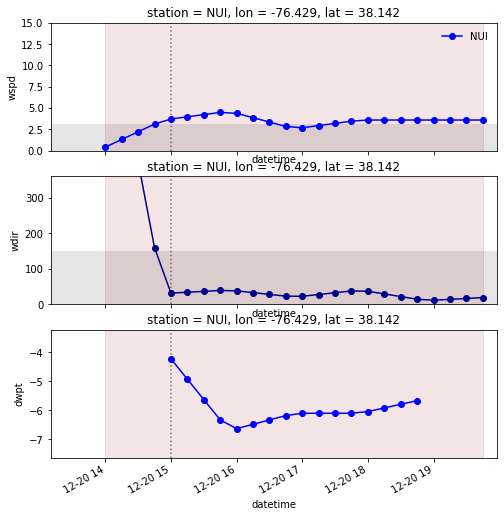

bay breeze validated for 12/29/2019


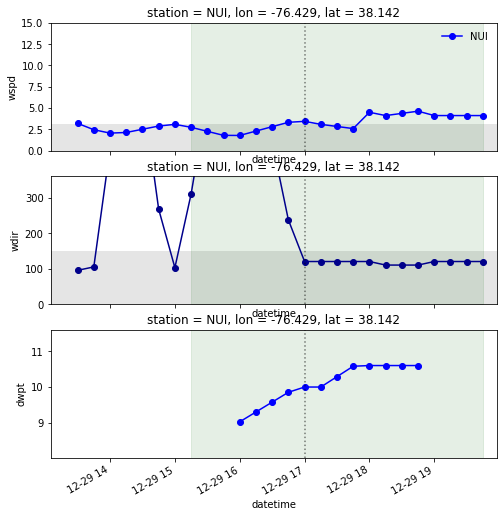

starting station: APG
Year: 2019
starting station: BWI
Year: 2019
onshore inland: True


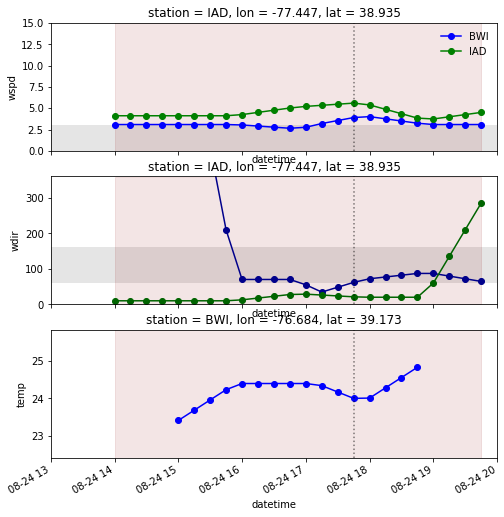

starting station: MTN
Year: 2019
starting station: NAK
Year: 2019
onshore inland: False
bay breeze validated for 2/5/2019


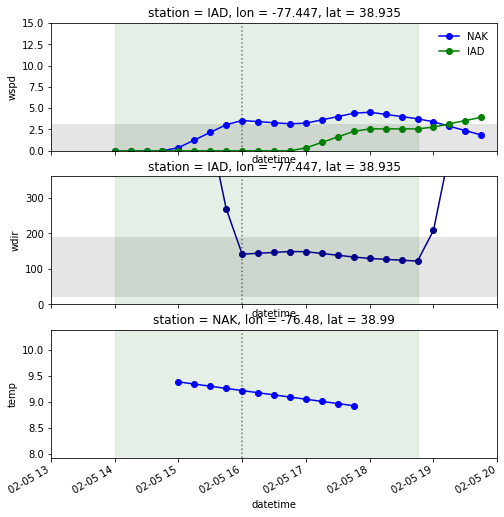

onshore inland: False
bay breeze validated for 2/14/2019


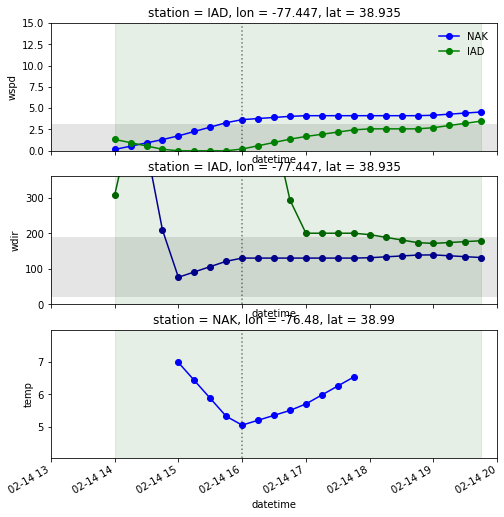

onshore inland: True


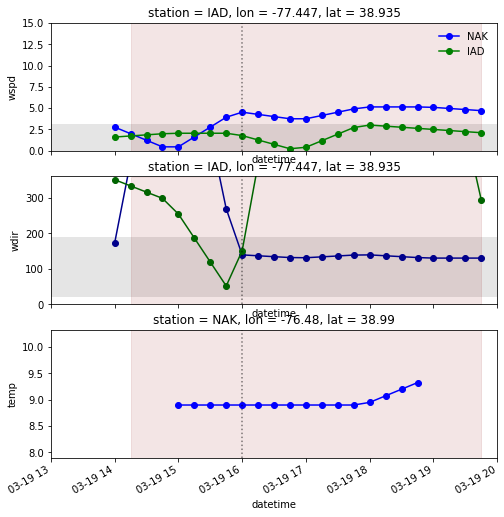

onshore inland: True


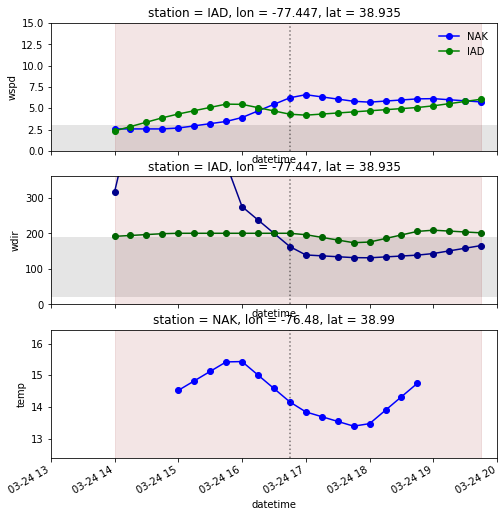

onshore inland: False
bay breeze validated for 5/6/2019


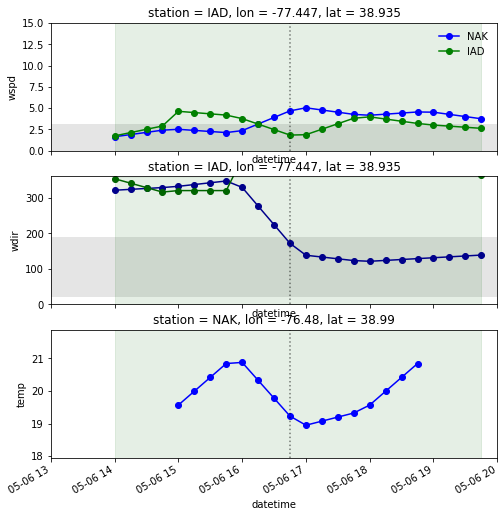

onshore inland: True


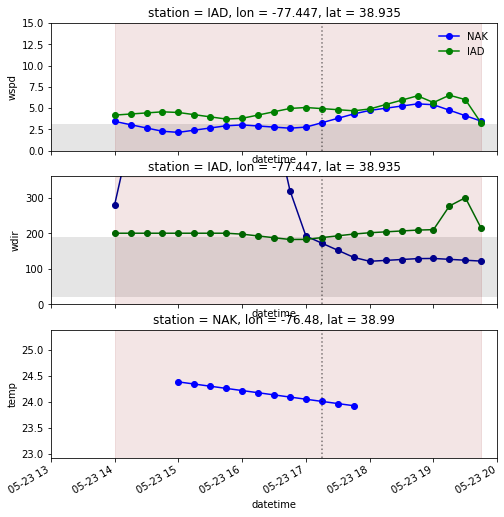

onshore inland: False
bay breeze validated for 5/30/2019


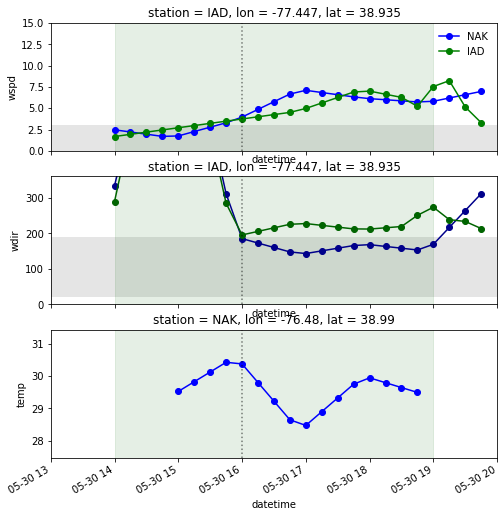

onshore inland: False
bay breeze validated for 6/17/2019


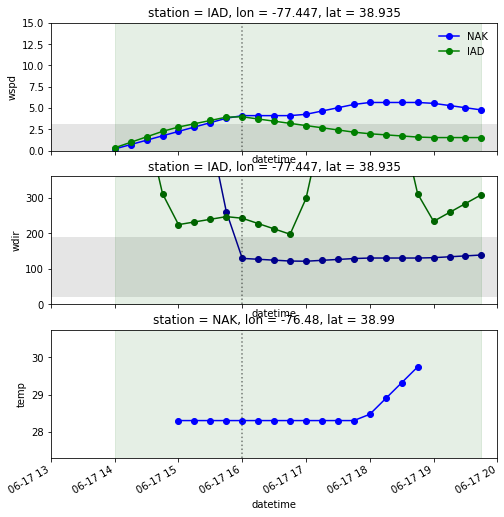

onshore inland: False
bay breeze validated for 6/27/2019


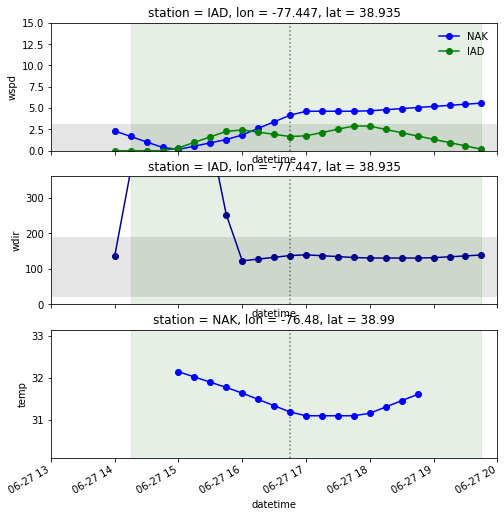

onshore inland: False
bay breeze validated for 7/28/2019


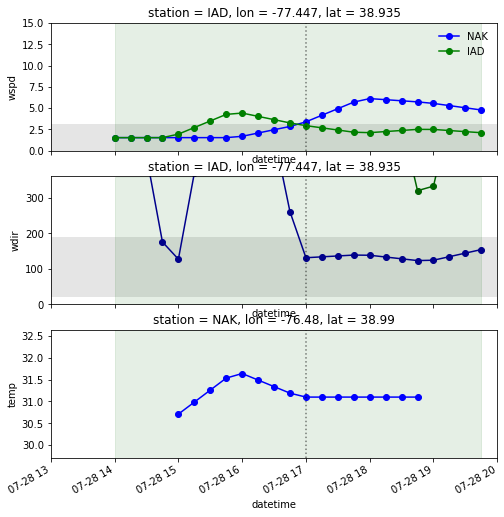

onshore inland: False
bay breeze validated for 8/11/2019


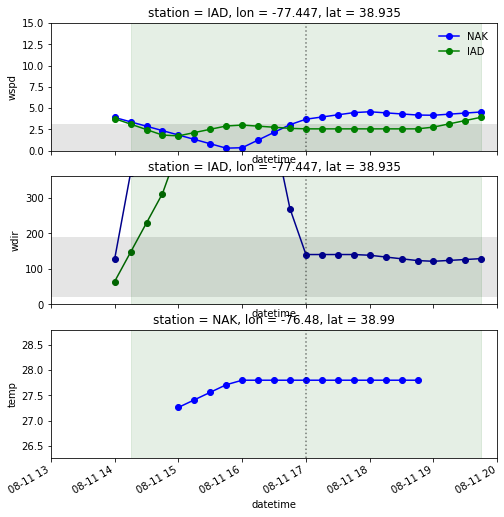

onshore inland: False
bay breeze validated for 9/7/2019


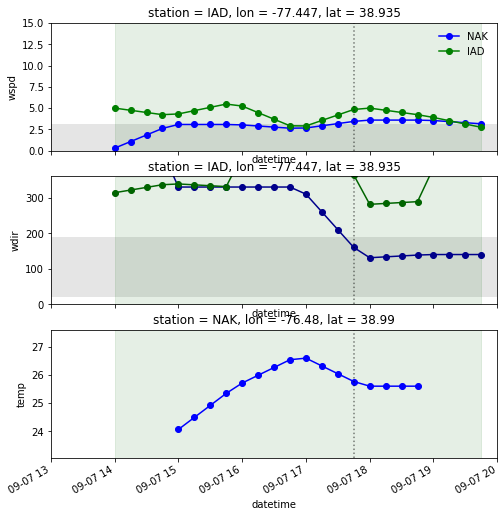

onshore inland: False
bay breeze validated for 9/8/2019


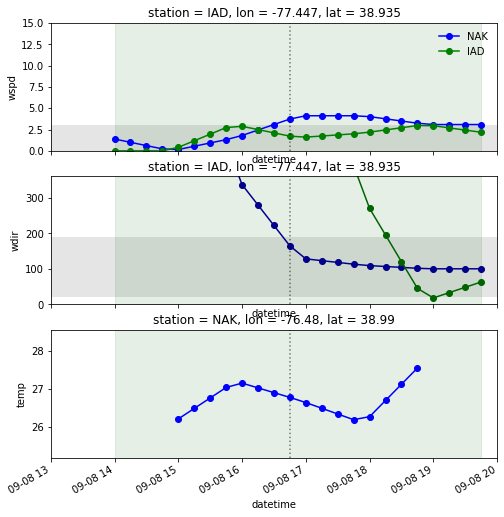

onshore inland: False
bay breeze validated for 9/23/2019


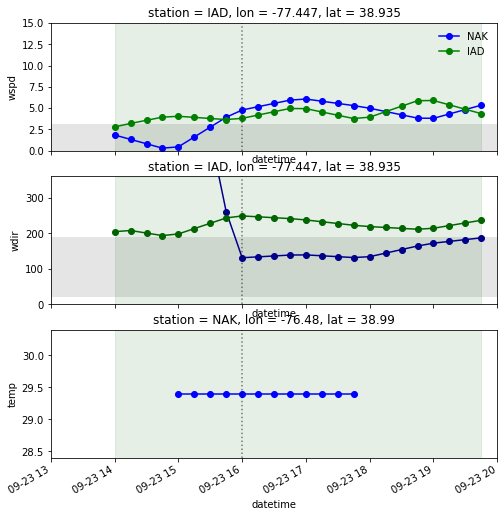

onshore inland: False
bay breeze validated for 9/25/2019


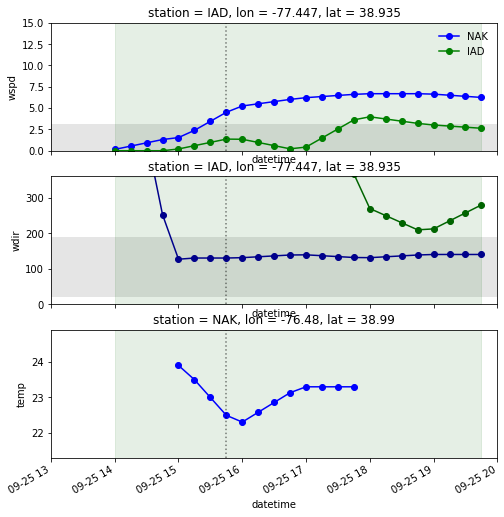

starting station: NHK
Year: 2019
onshore inland: False
bay breeze validated for 2/14/2019


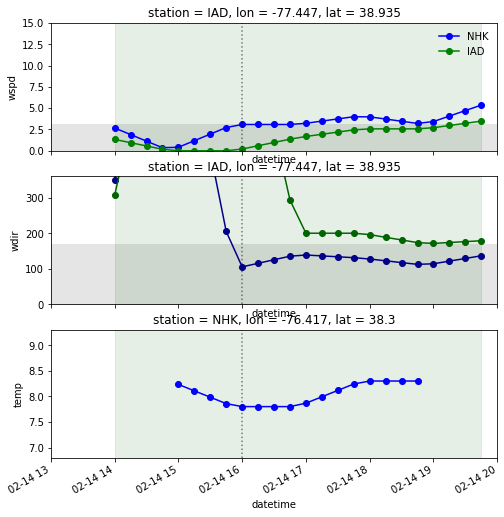

onshore inland: False
bay breeze validated for 2/26/2019


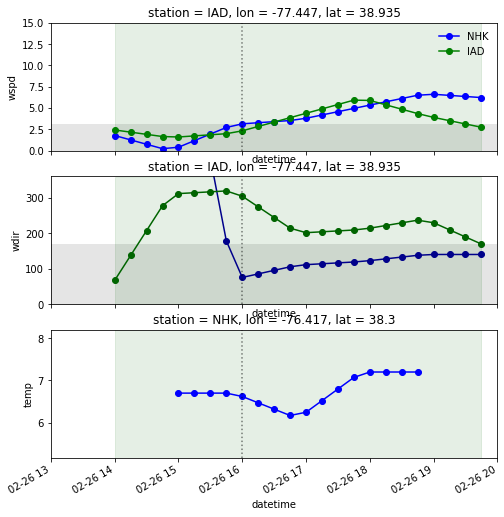

onshore inland: False
bay breeze validated for 3/14/2019


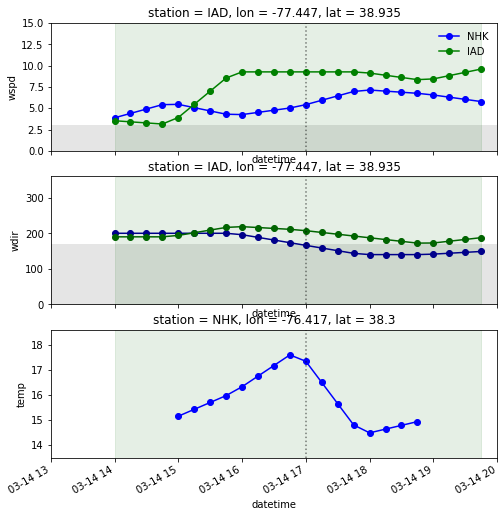

onshore inland: False
bay breeze validated for 3/17/2019


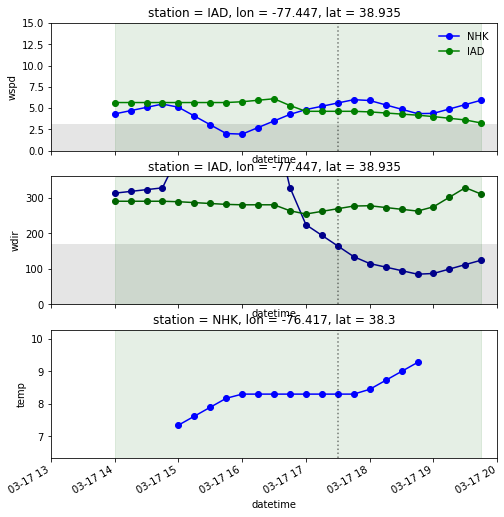

onshore inland: False
bay breeze validated for 4/21/2019


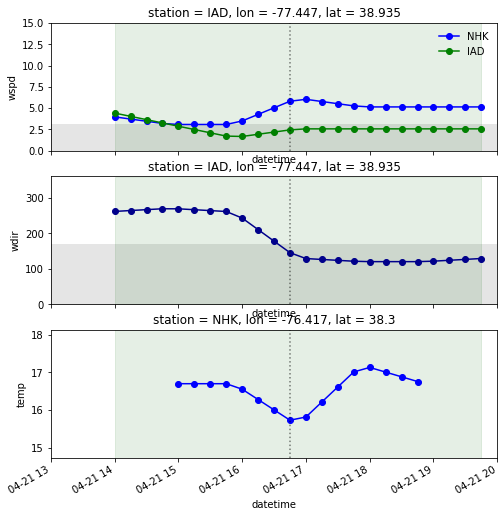

onshore inland: False
bay breeze validated for 5/7/2019


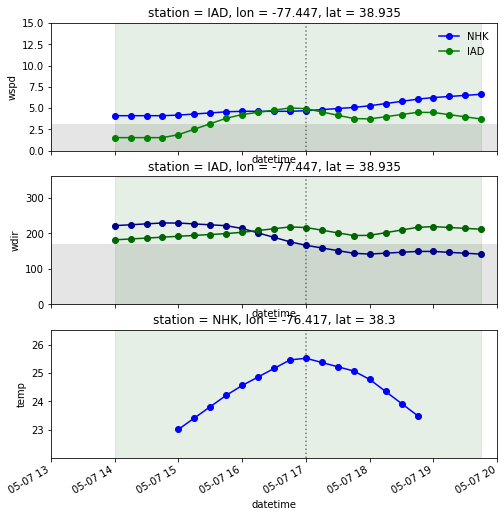

onshore inland: False
bay breeze validated for 6/28/2019


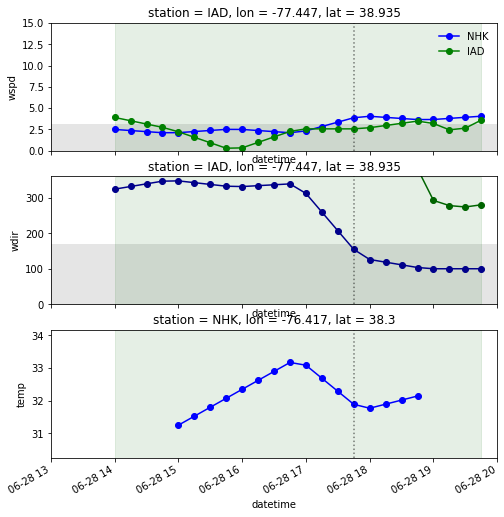

onshore inland: False
bay breeze validated for 7/10/2019


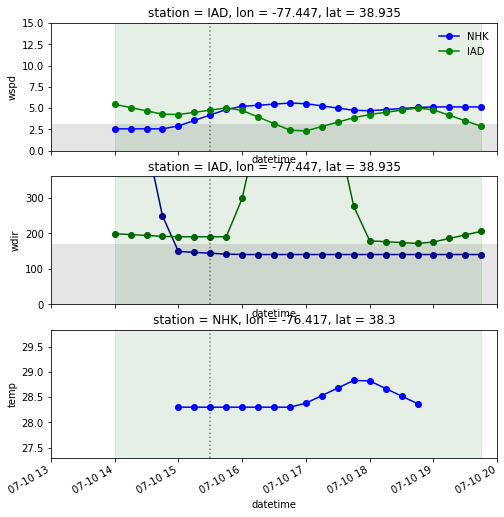

onshore inland: False
bay breeze validated for 7/16/2019


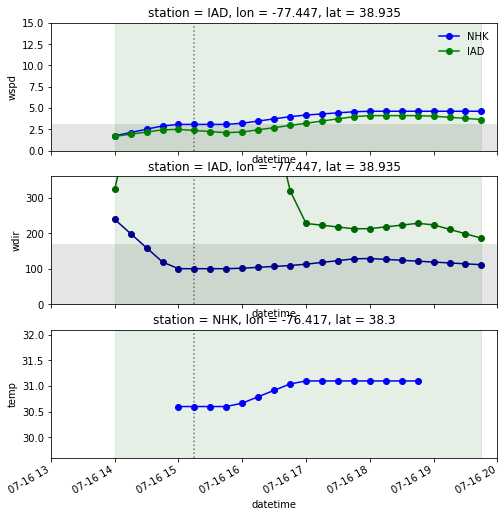

onshore inland: False
bay breeze validated for 7/19/2019


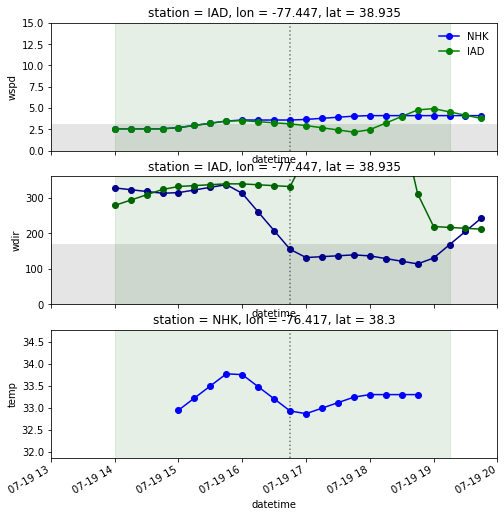

onshore inland: False
bay breeze validated for 7/27/2019


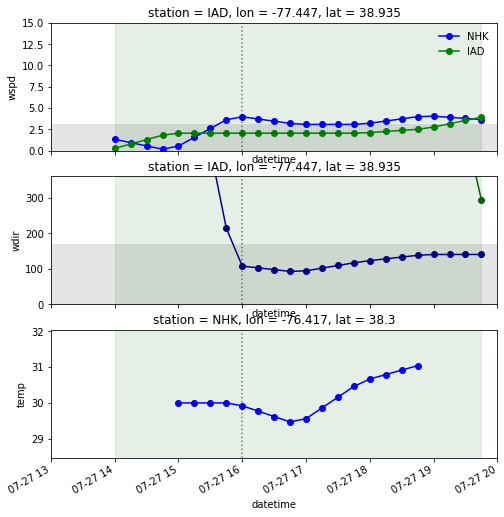

onshore inland: False
bay breeze validated for 7/30/2019


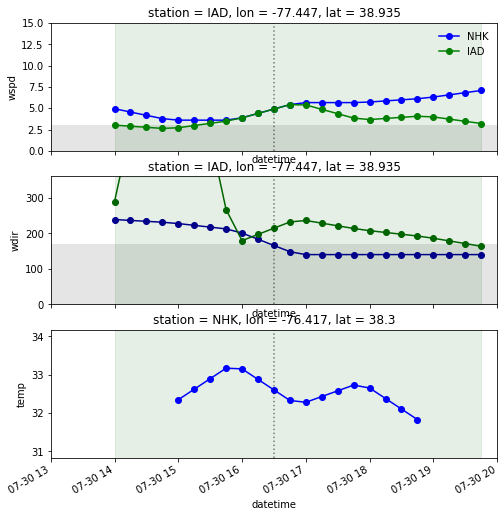

onshore inland: False
bay breeze validated for 7/31/2019


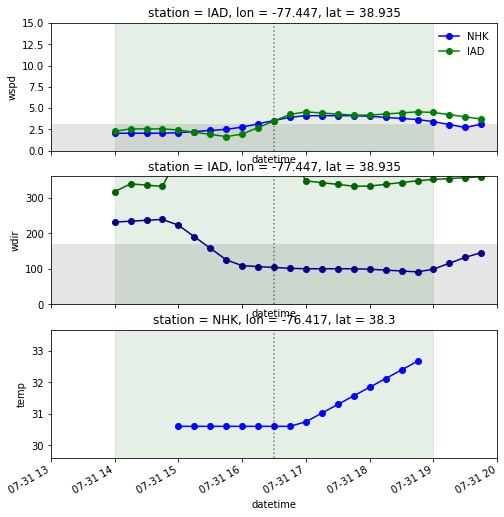

onshore inland: False
bay breeze validated for 10/1/2019


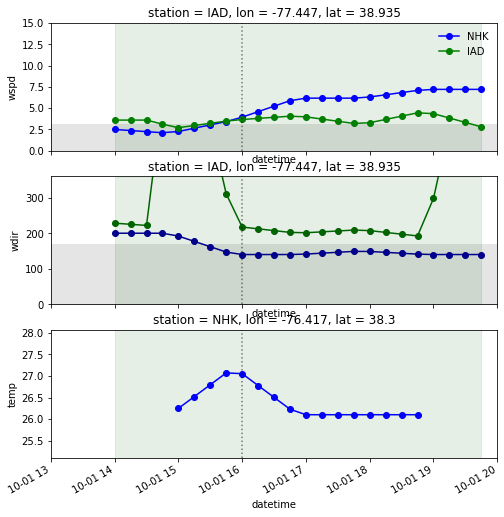

onshore inland: True


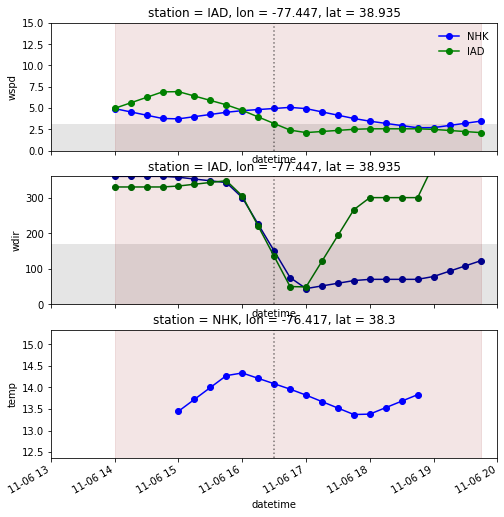

onshore inland: False
bay breeze validated for 11/11/2019


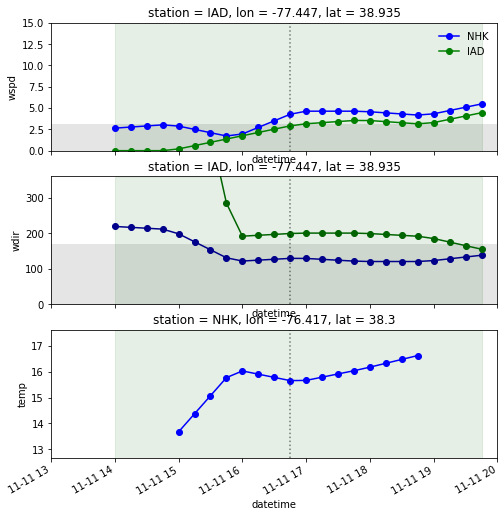

starting station: NUI
Year: 2019
onshore inland: False
bay breeze validated for 5/4/2019


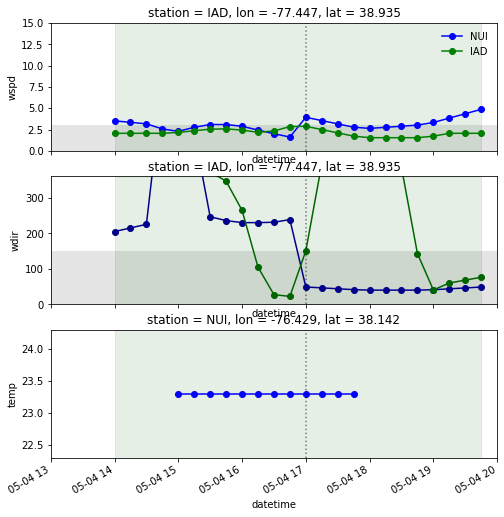

starting station: APG
Year: 2019


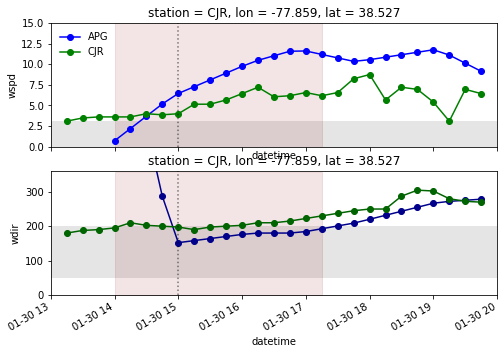

bay breeze validated for 3/19/2019


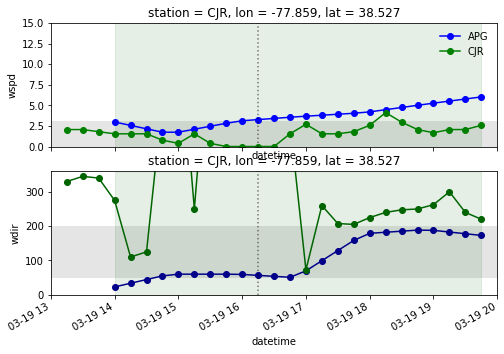

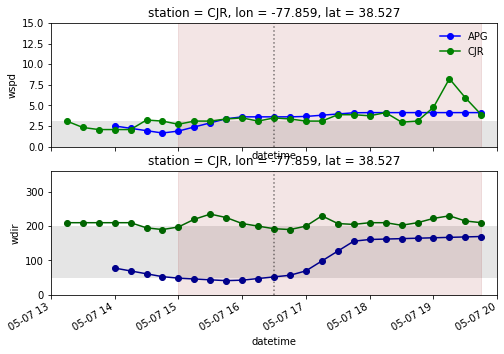

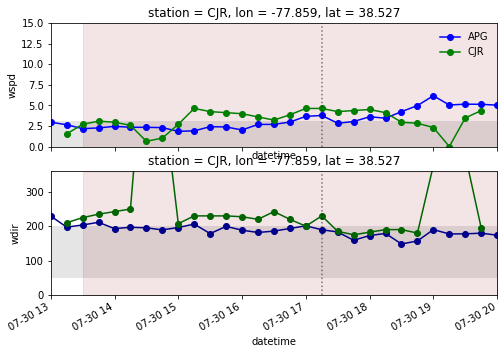

bay breeze validated for 8/12/2019


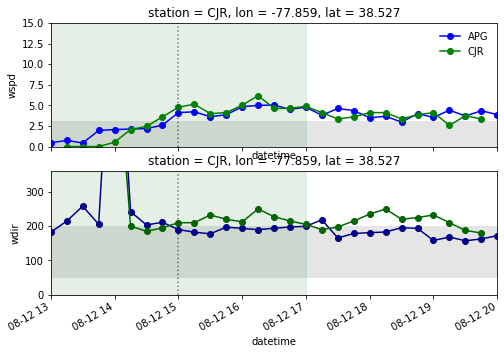

bay breeze validated for 8/20/2019


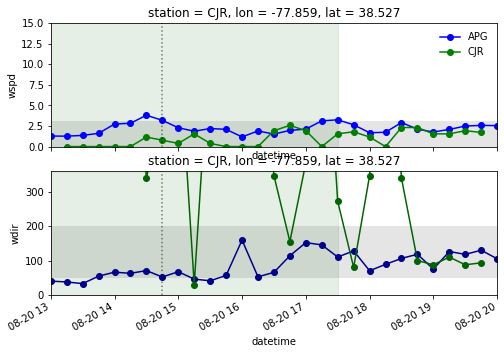

bay breeze validated for 10/28/2019


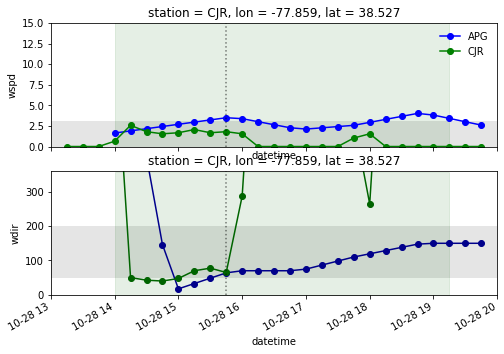

starting station: BWI
Year: 2019
bay breeze validated for 7/26/2019


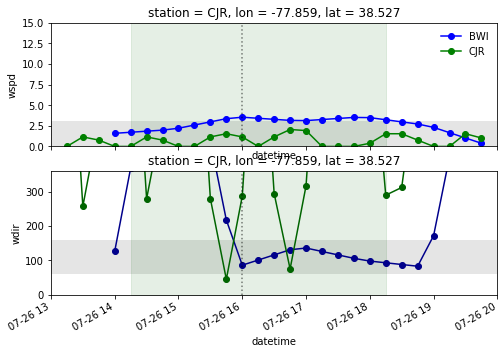

bay breeze validated for 8/20/2019


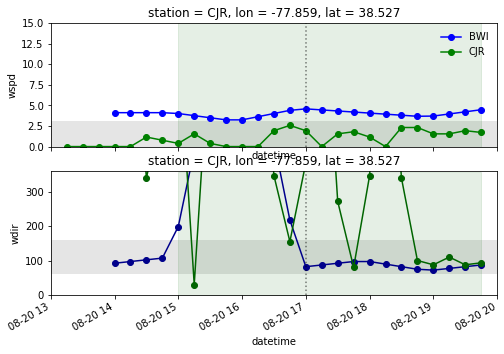

bay breeze validated for 8/24/2019


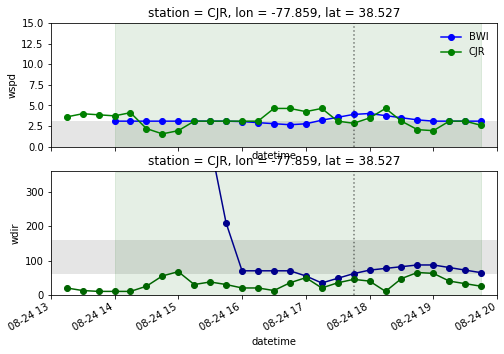

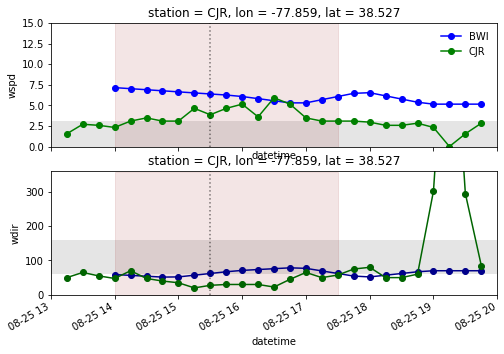

bay breeze validated for 10/28/2019


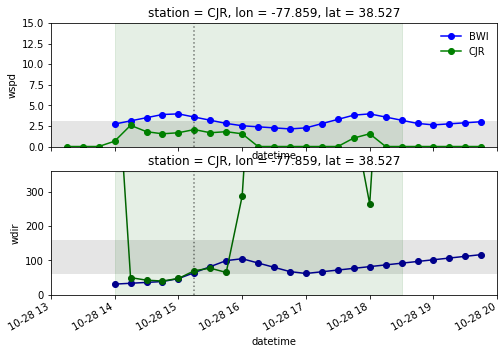

starting station: MTN
Year: 2019
bay breeze validated for 2/2/2019


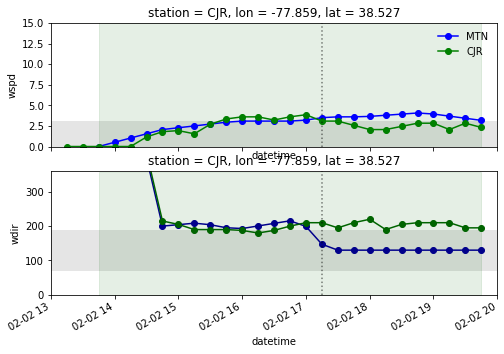

bay breeze validated for 2/4/2019


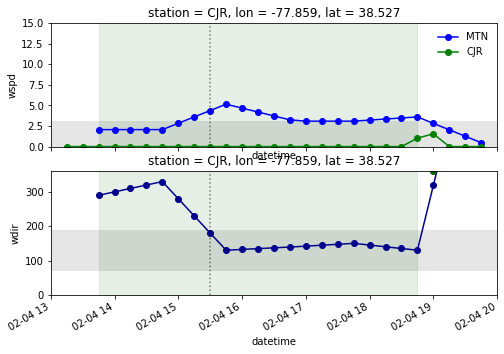

bay breeze validated for 3/19/2019


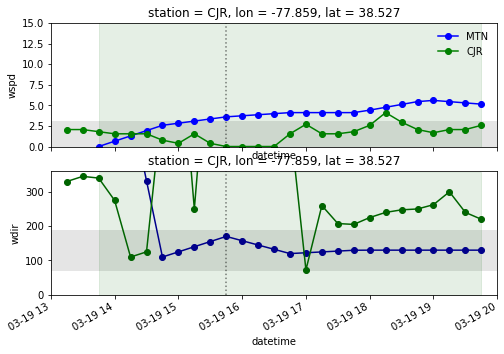

bay breeze validated for 4/6/2019


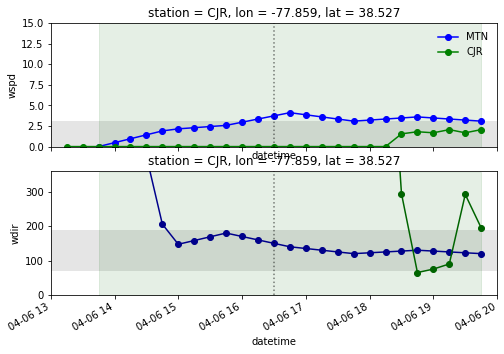

bay breeze validated for 6/17/2019


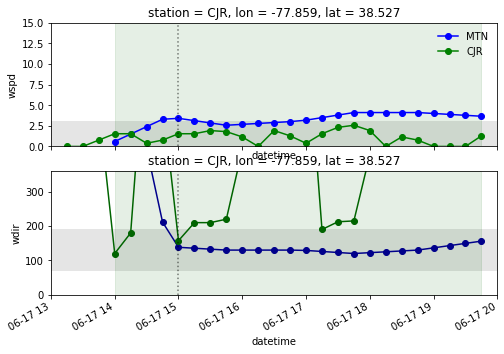

bay breeze validated for 6/26/2019


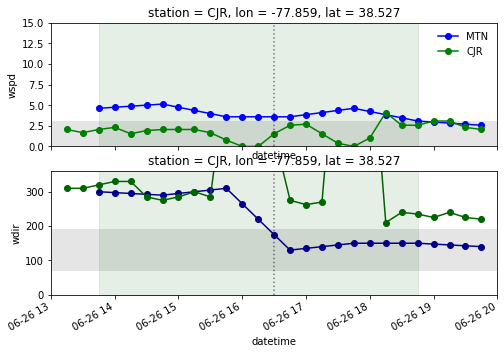

bay breeze validated for 6/27/2019


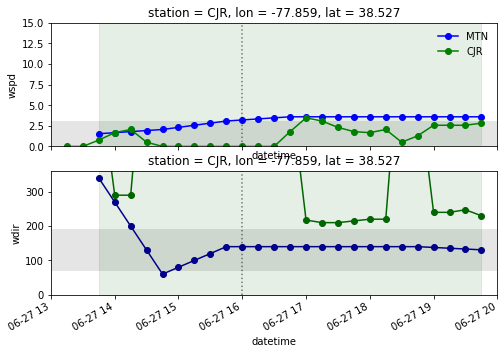

bay breeze validated for 6/28/2019


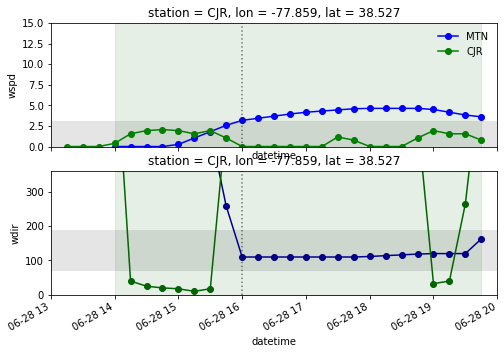

bay breeze validated for 7/9/2019


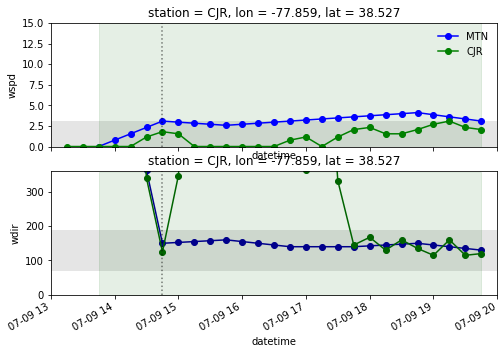

bay breeze validated for 7/15/2019


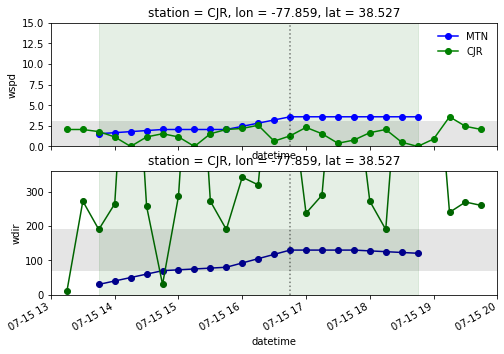

bay breeze validated for 7/19/2019


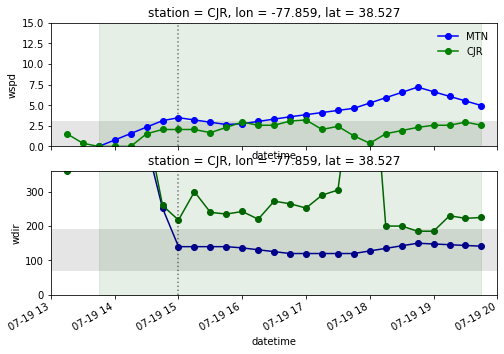

bay breeze validated for 7/20/2019


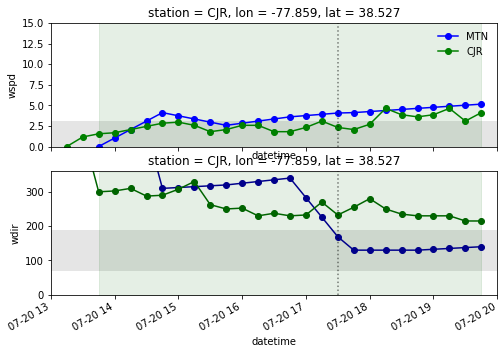

bay breeze validated for 7/26/2019


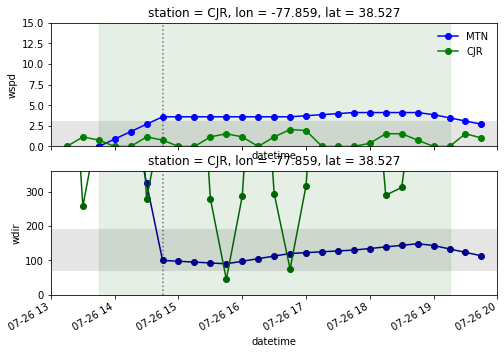

bay breeze validated for 7/27/2019


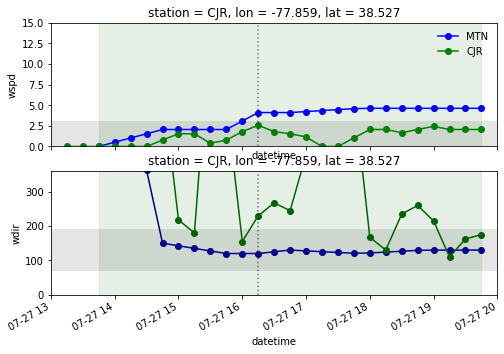

bay breeze validated for 7/29/2019


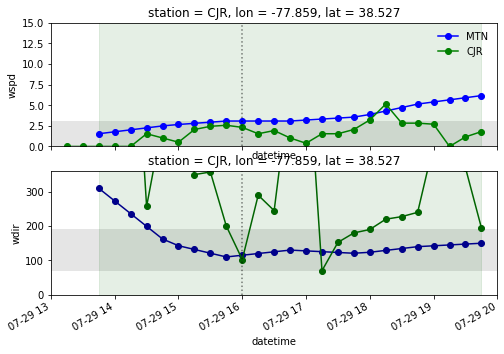

bay breeze validated for 8/1/2019


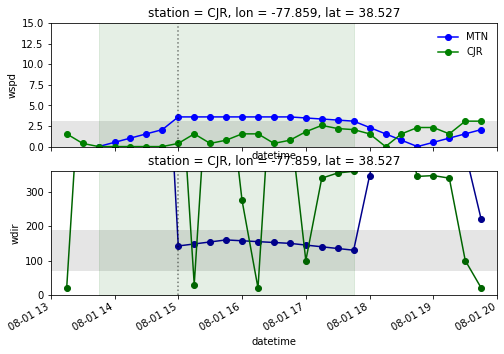

bay breeze validated for 8/3/2019


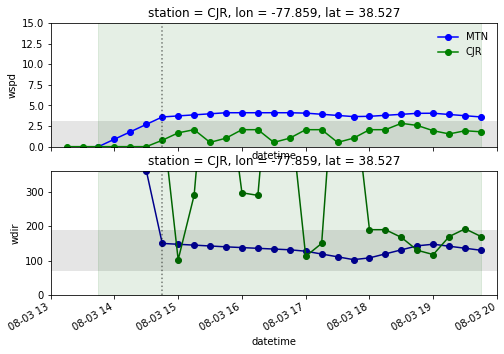

bay breeze validated for 8/11/2019


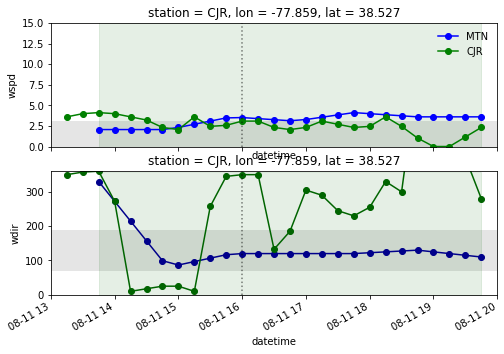

bay breeze validated for 8/12/2019


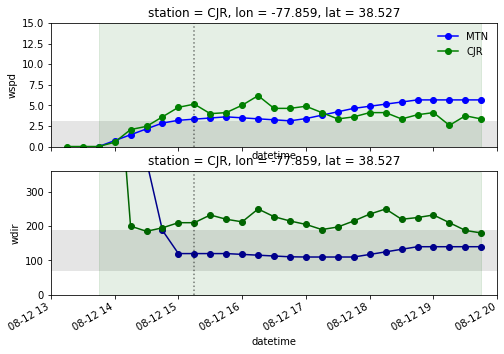

bay breeze validated for 8/19/2019


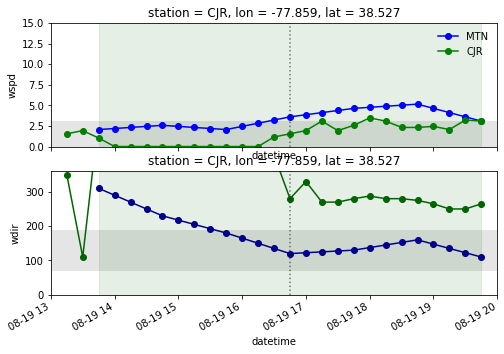

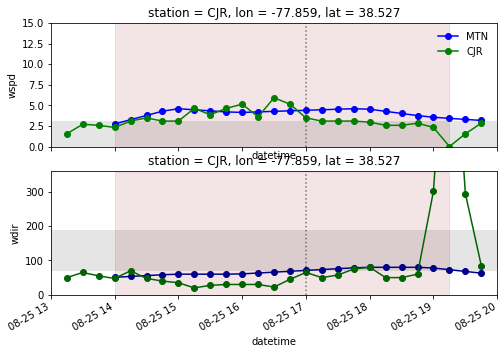

bay breeze validated for 8/30/2019


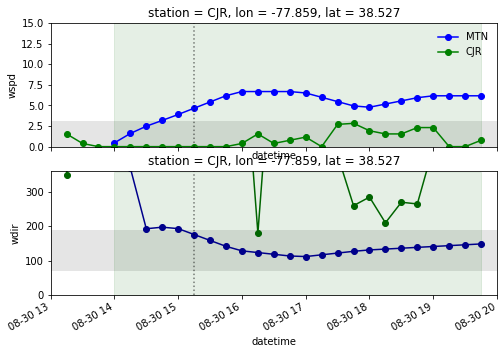

bay breeze validated for 9/11/2019


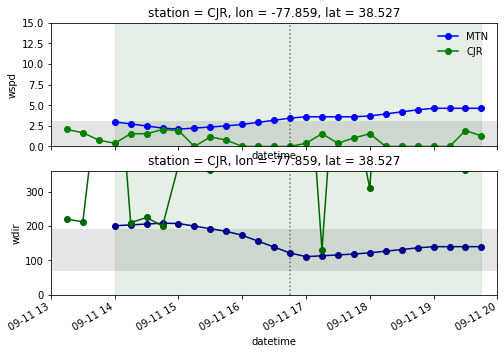

bay breeze validated for 9/18/2019


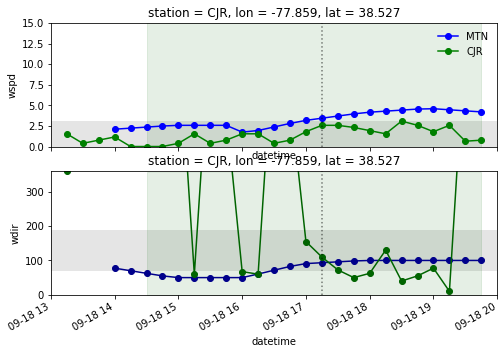

bay breeze validated for 9/20/2019


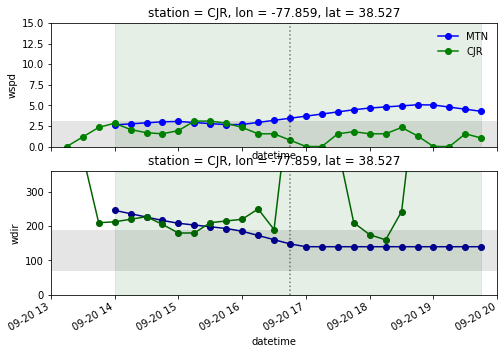

bay breeze validated for 9/22/2019


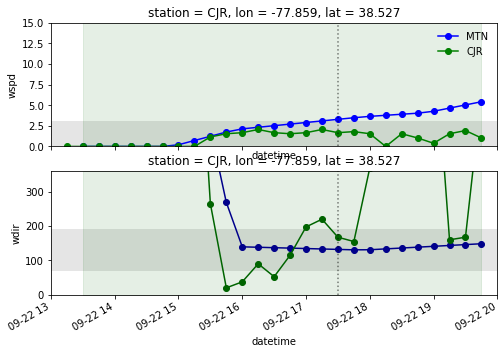

bay breeze validated for 9/25/2019


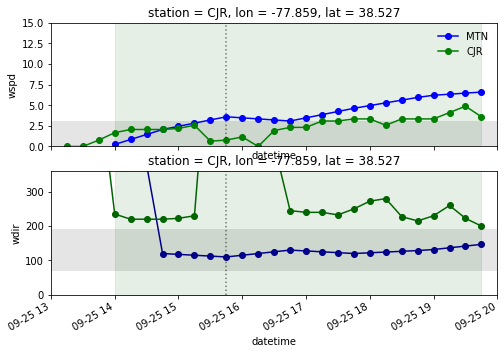

bay breeze validated for 10/19/2019


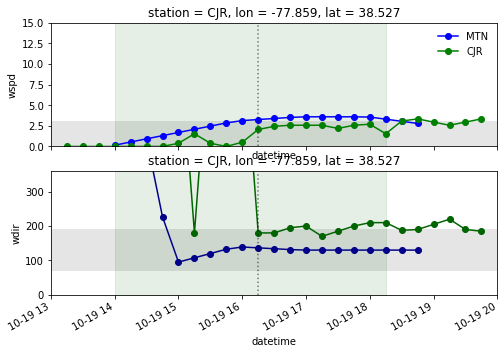

bay breeze validated for 11/4/2019


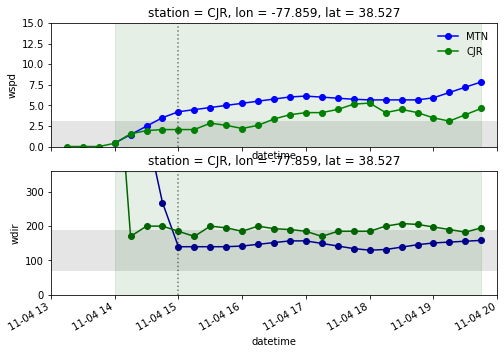

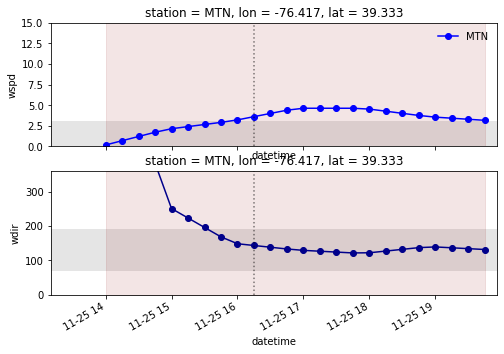

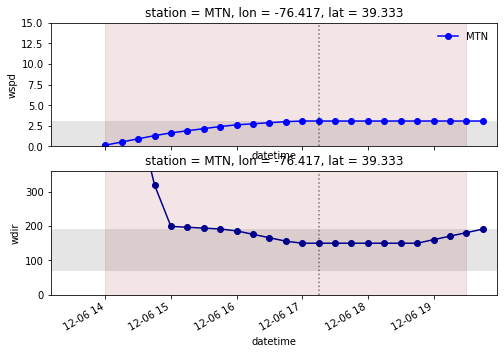

starting station: NAK
Year: 2019
bay breeze validated for 1/23/2019


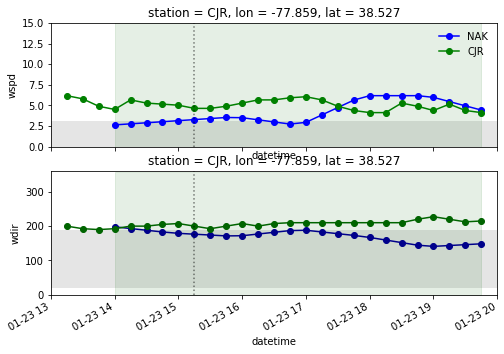

bay breeze validated for 1/28/2019


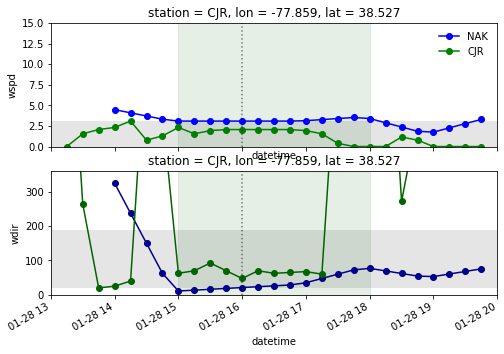

bay breeze validated for 2/5/2019


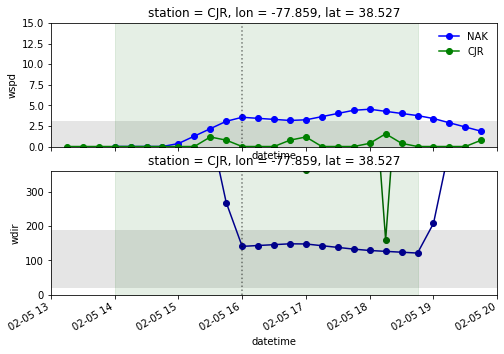

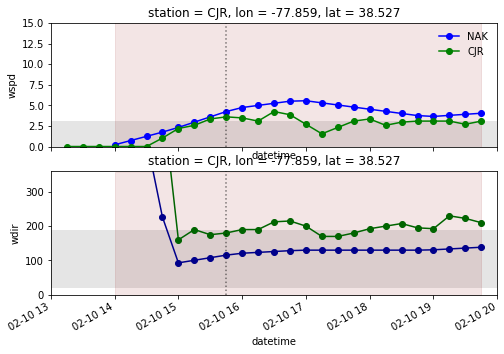

bay breeze validated for 2/14/2019


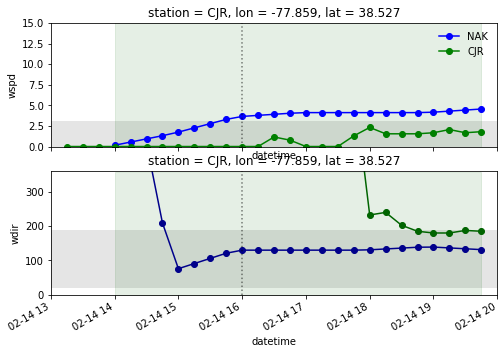

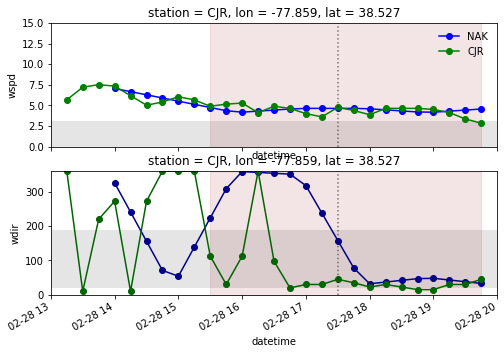

bay breeze validated for 3/5/2019


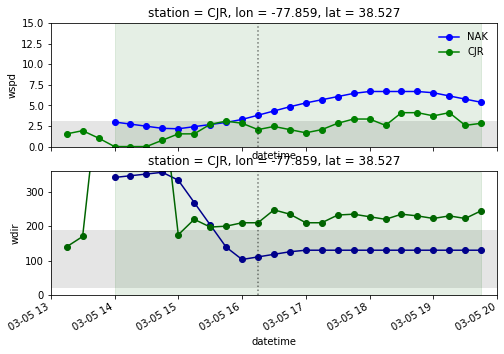

bay breeze validated for 3/19/2019


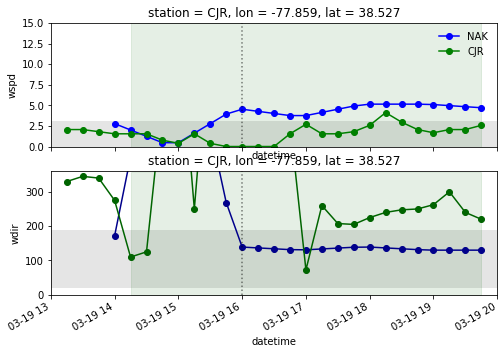

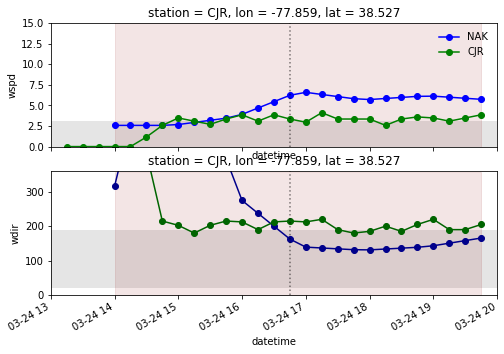

bay breeze validated for 4/6/2019


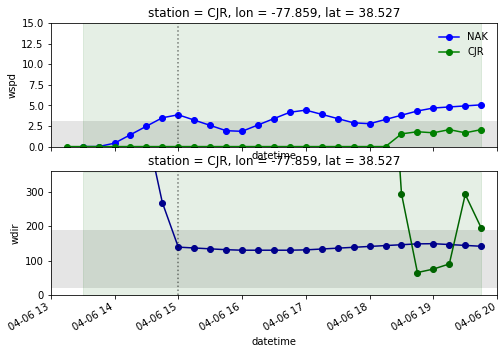

bay breeze validated for 4/17/2019


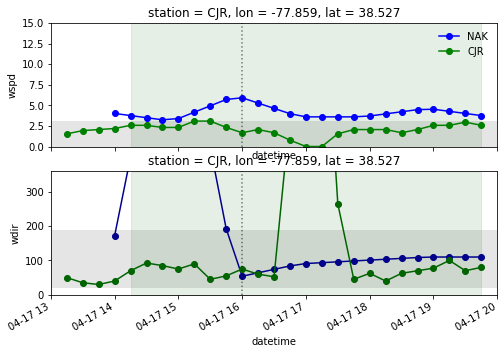

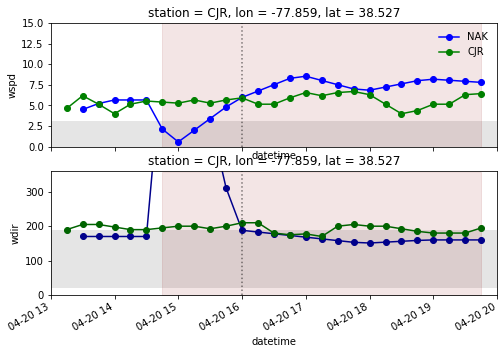

bay breeze validated for 4/21/2019


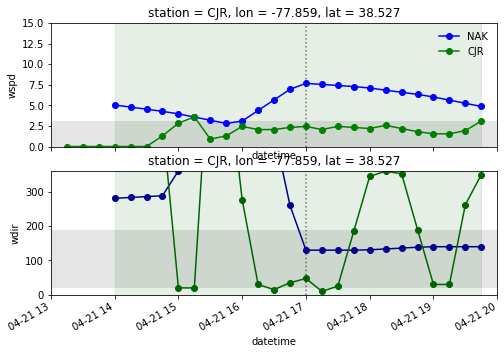

bay breeze validated for 5/2/2019


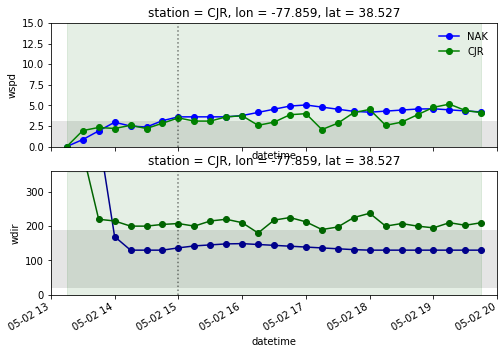

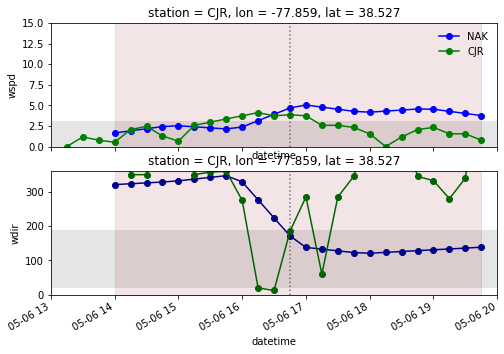

bay breeze validated for 5/23/2019


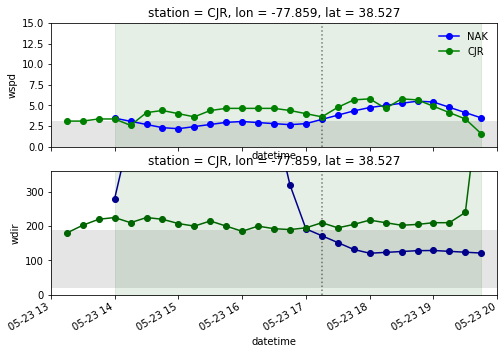

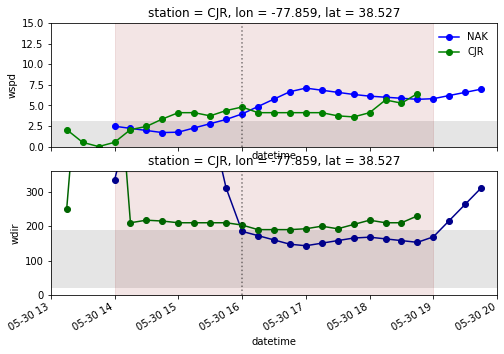

bay breeze validated for 6/17/2019


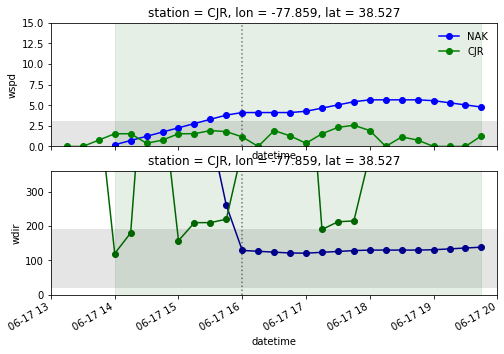

bay breeze validated for 6/24/2019


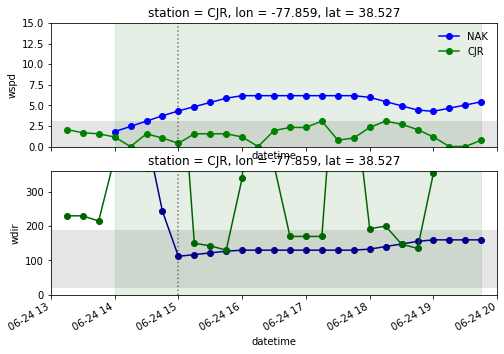

bay breeze validated for 6/26/2019


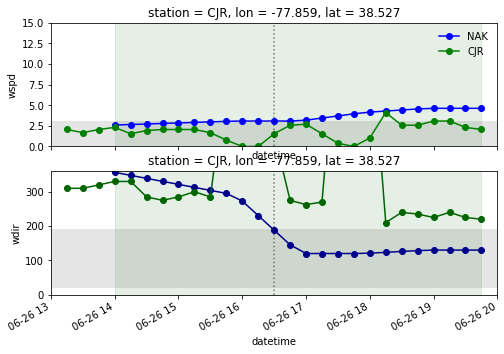

bay breeze validated for 6/27/2019


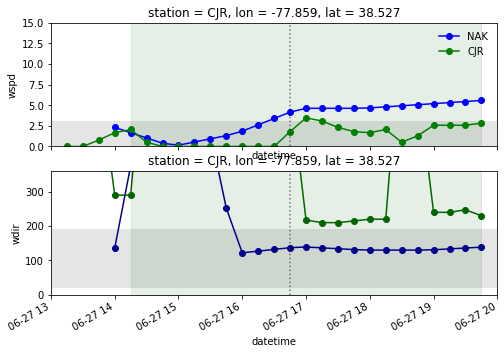

bay breeze validated for 6/28/2019


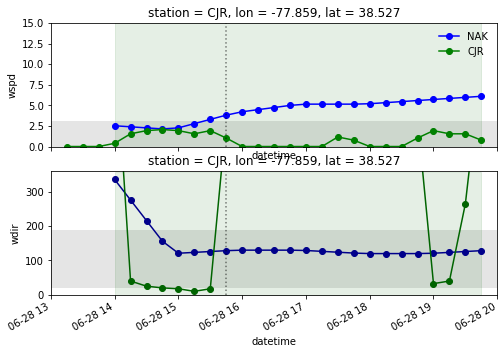

bay breeze validated for 7/9/2019


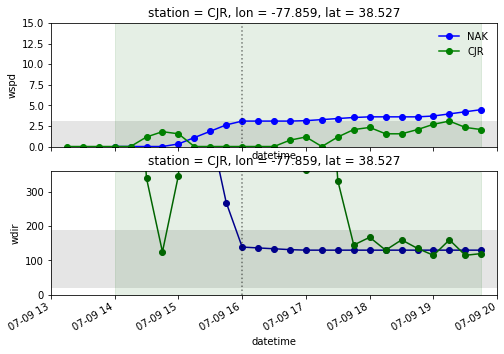

bay breeze validated for 7/15/2019


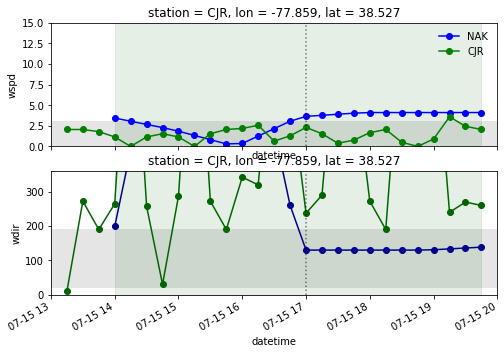

bay breeze validated for 7/17/2019


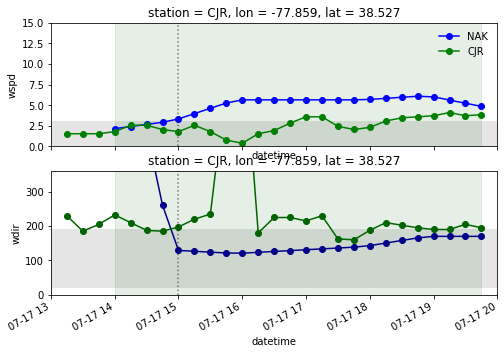

bay breeze validated for 7/19/2019


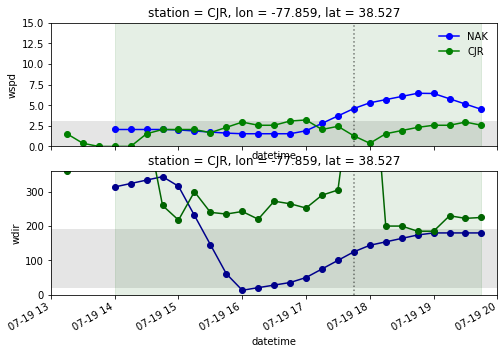

bay breeze validated for 7/26/2019


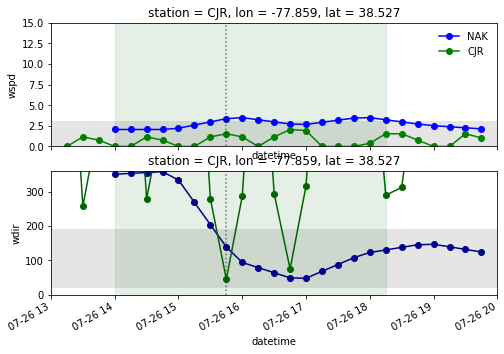

bay breeze validated for 7/28/2019


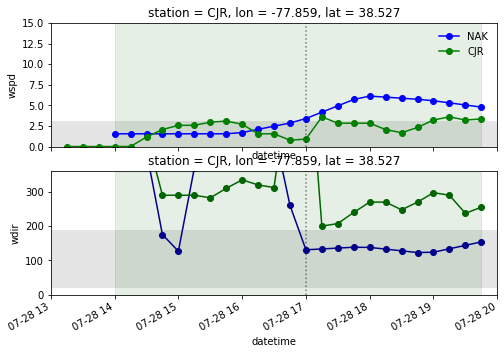

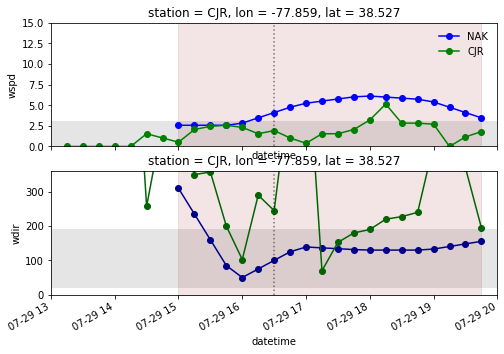

bay breeze validated for 7/31/2019


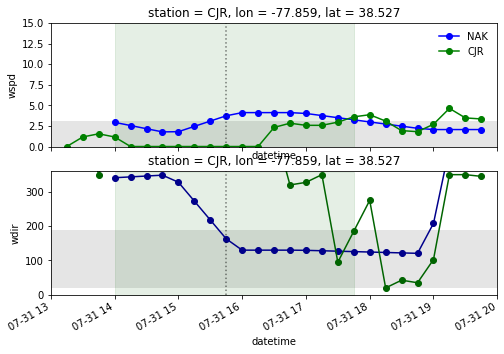

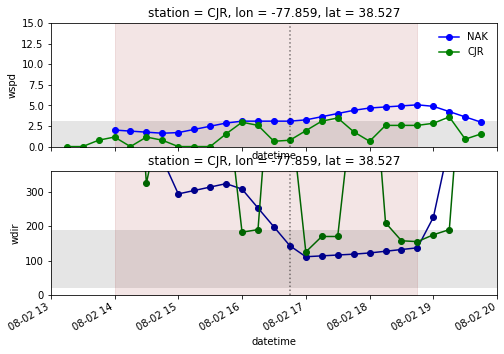

bay breeze validated for 8/7/2019


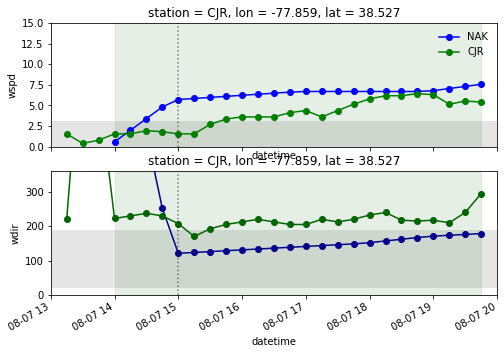

bay breeze validated for 8/11/2019


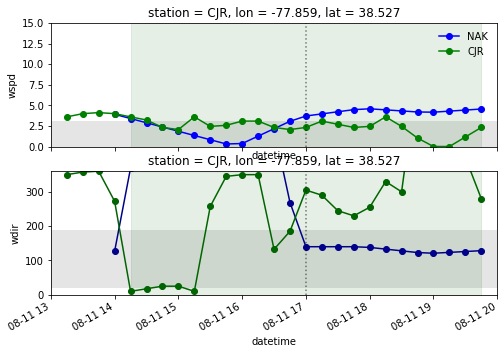

bay breeze validated for 8/19/2019


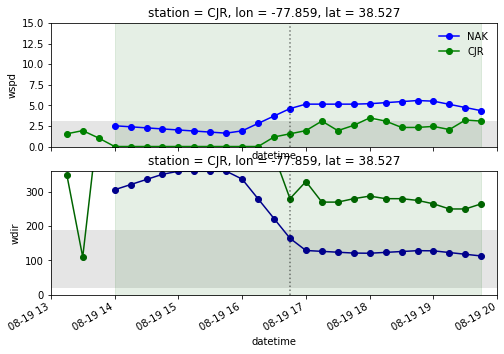

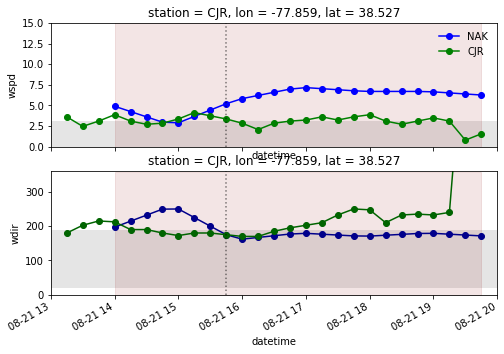

bay breeze validated for 9/7/2019


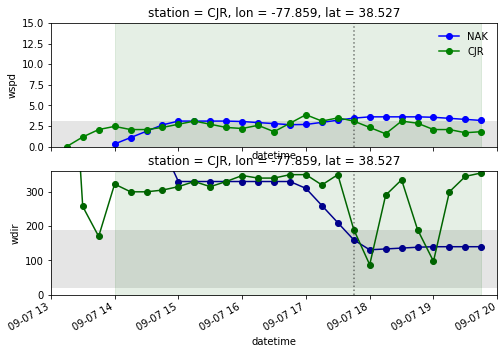

bay breeze validated for 9/8/2019


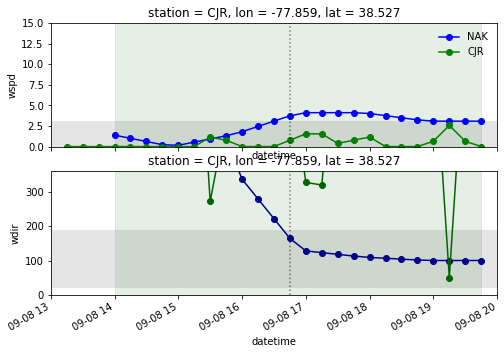

bay breeze validated for 9/11/2019


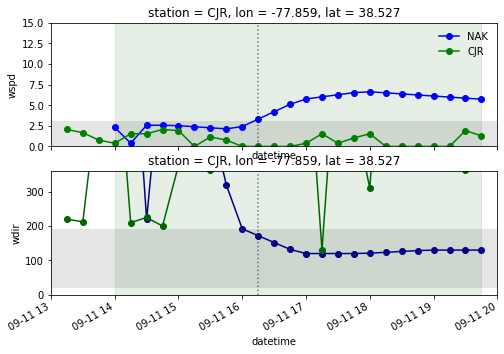

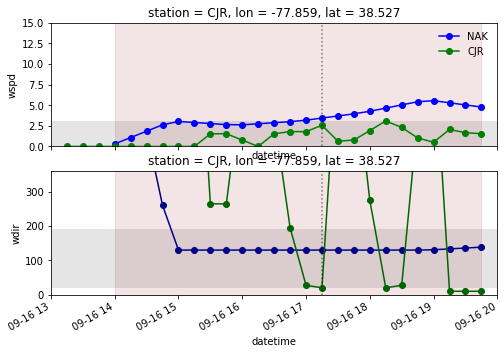

bay breeze validated for 9/20/2019


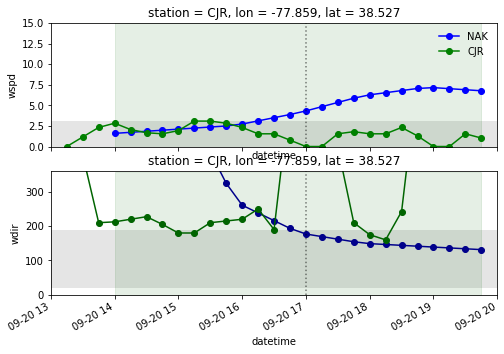

bay breeze validated for 9/21/2019


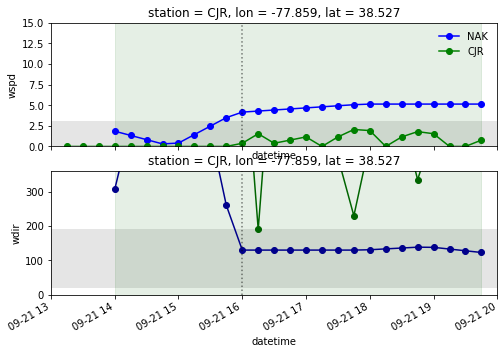

bay breeze validated for 9/23/2019


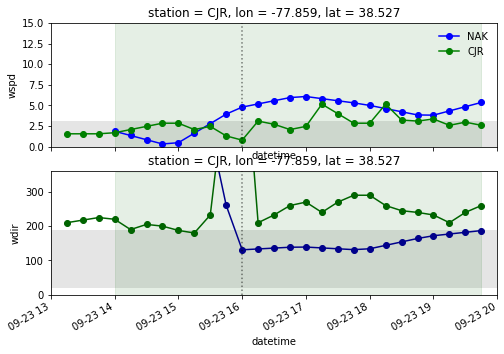

bay breeze validated for 9/25/2019


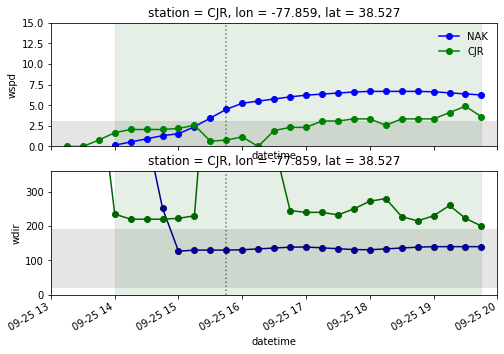

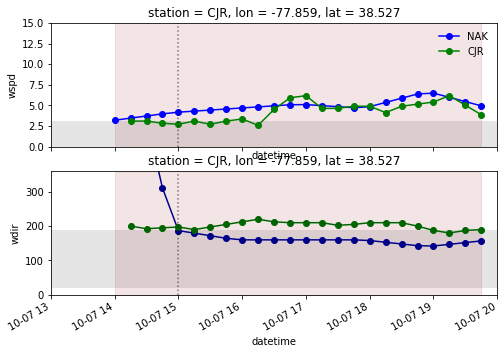

bay breeze validated for 10/24/2019


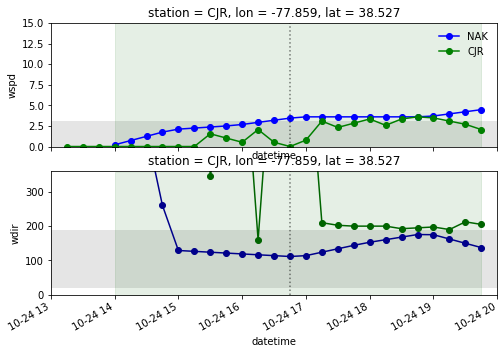

bay breeze validated for 11/2/2019


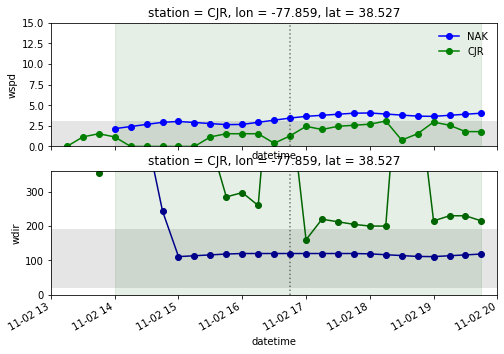

bay breeze validated for 11/6/2019


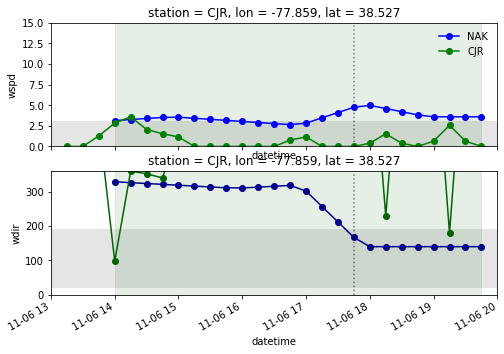

bay breeze validated for 11/10/2019


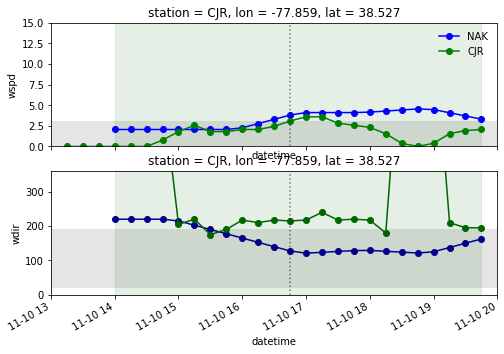

bay breeze validated for 11/11/2019


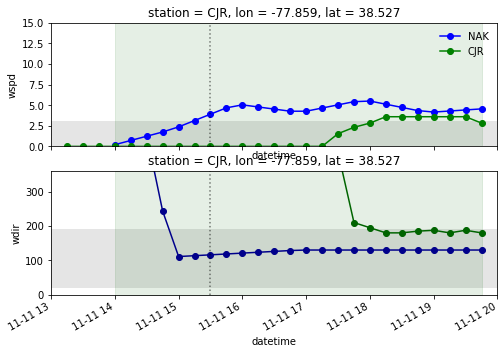

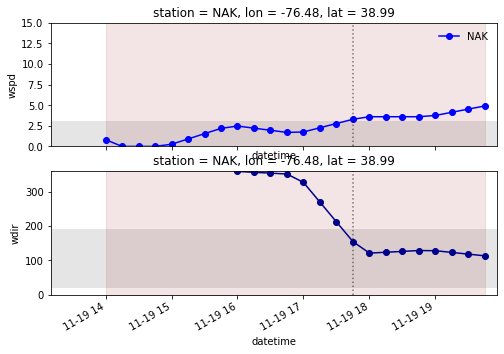

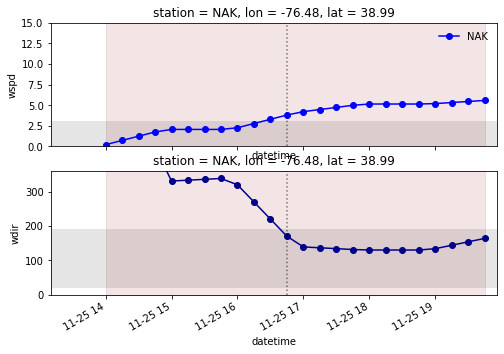

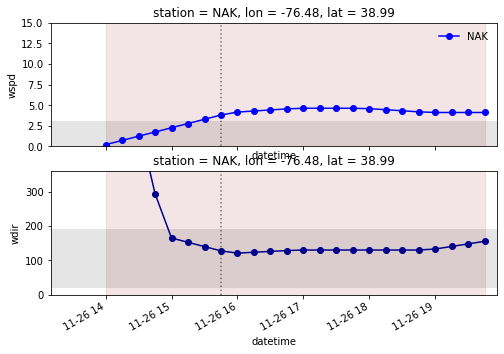

starting station: NHK
Year: 2019
bay breeze validated for 2/2/2019


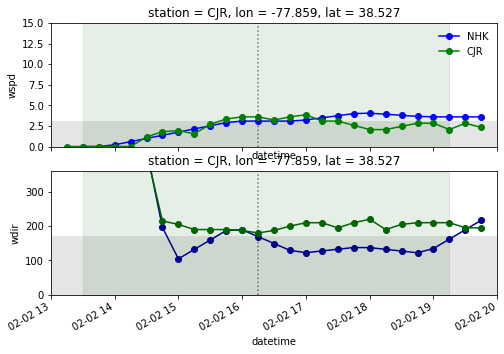

bay breeze validated for 2/10/2019


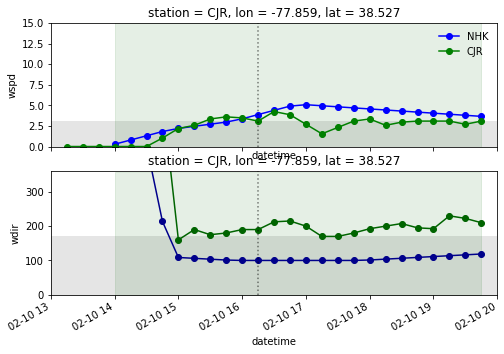

bay breeze validated for 2/14/2019


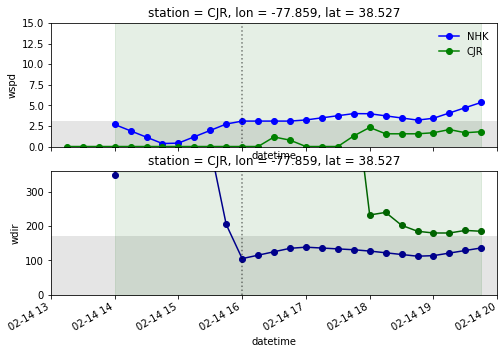

bay breeze validated for 2/26/2019


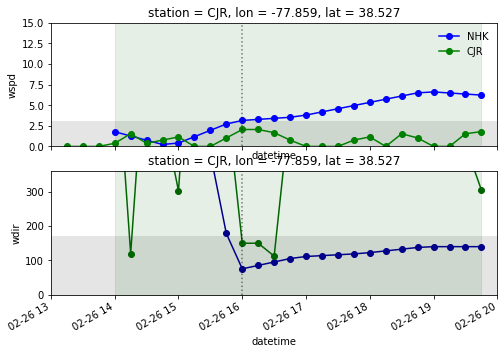

bay breeze validated for 3/14/2019


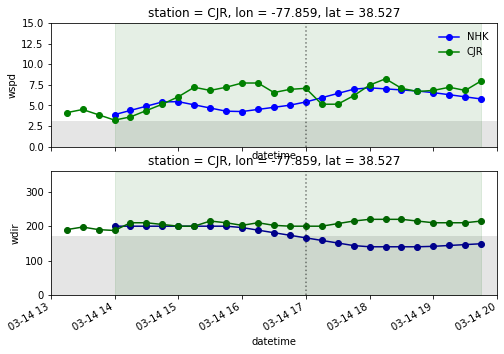

bay breeze validated for 3/17/2019


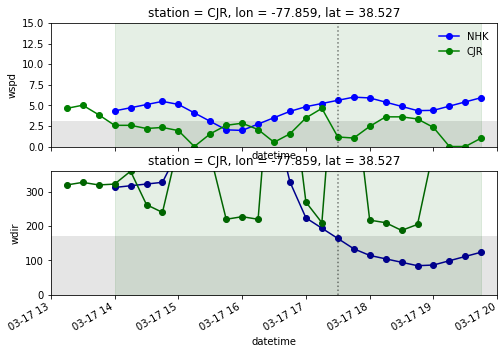

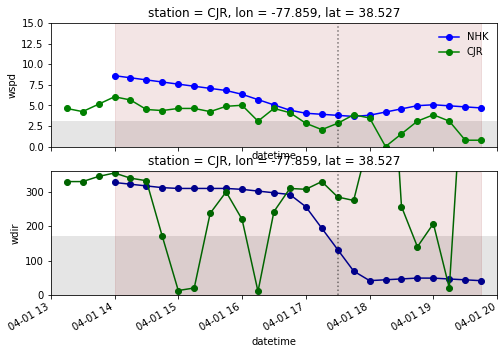

bay breeze validated for 4/10/2019


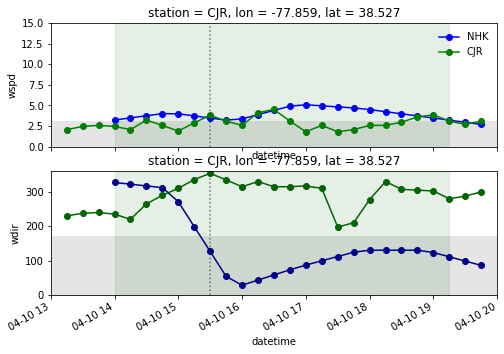

bay breeze validated for 4/21/2019


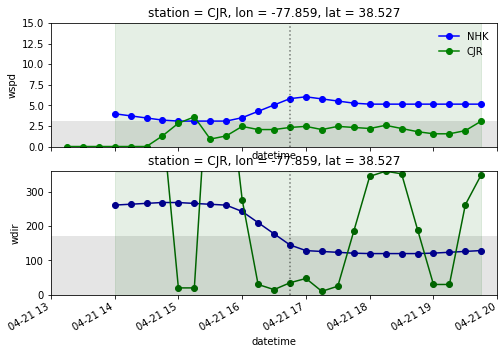

bay breeze validated for 5/7/2019


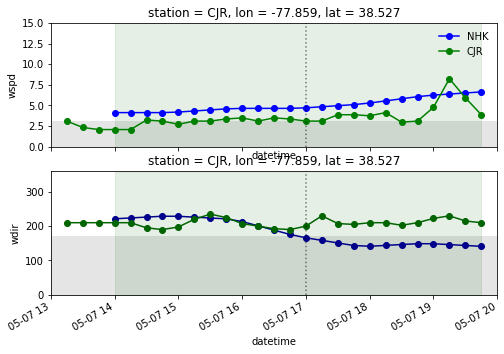

bay breeze validated for 5/16/2019


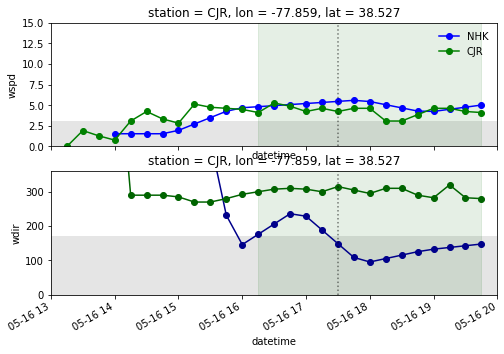

bay breeze validated for 6/17/2019


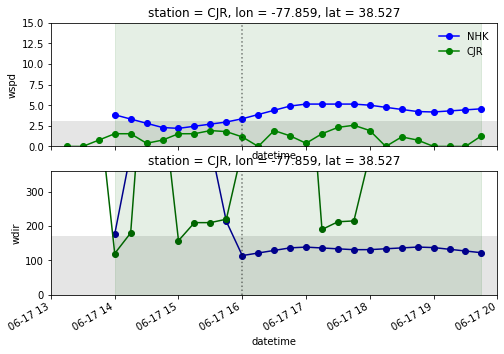

bay breeze validated for 6/23/2019


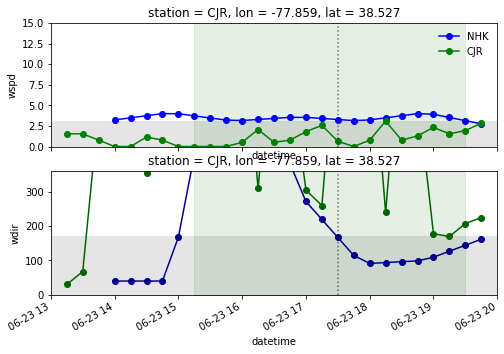

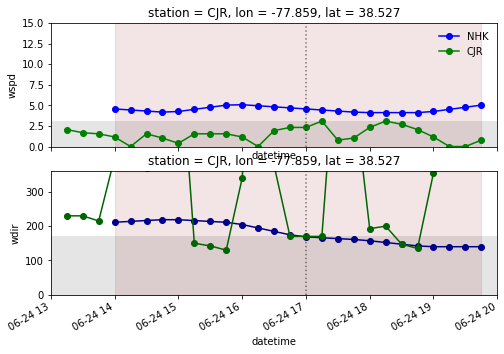

bay breeze validated for 6/28/2019


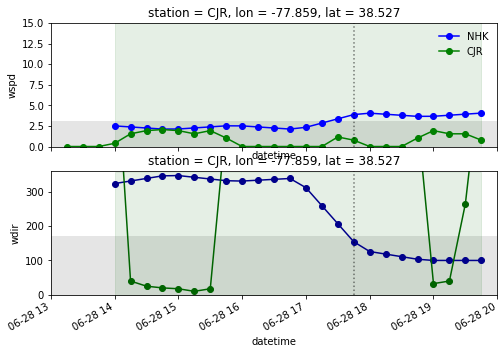

bay breeze validated for 7/10/2019


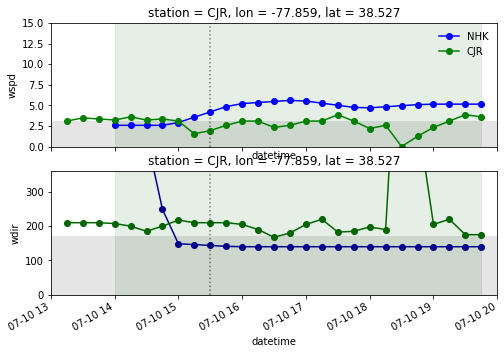

bay breeze validated for 7/16/2019


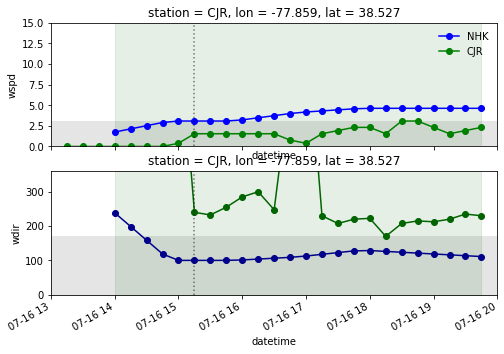

bay breeze validated for 7/19/2019


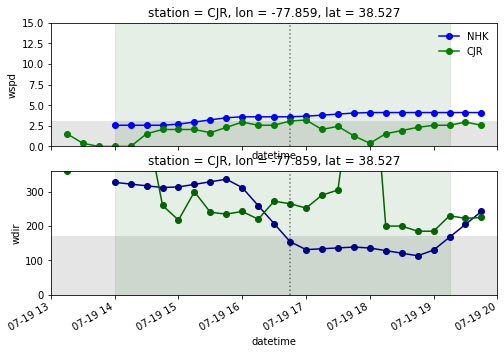

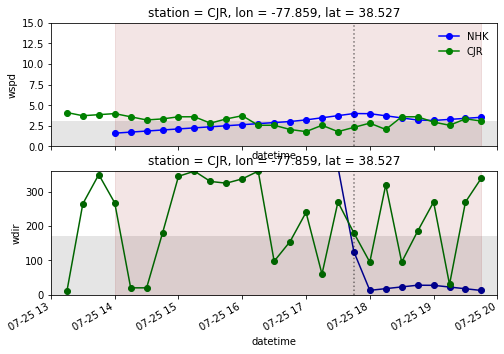

bay breeze validated for 7/27/2019


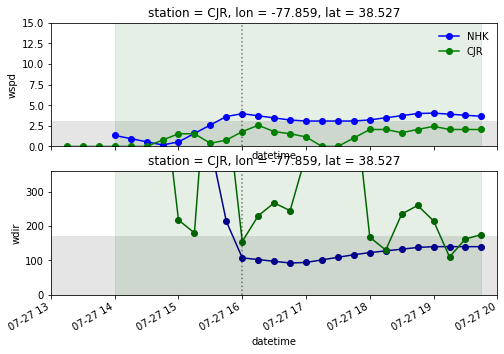

bay breeze validated for 7/28/2019


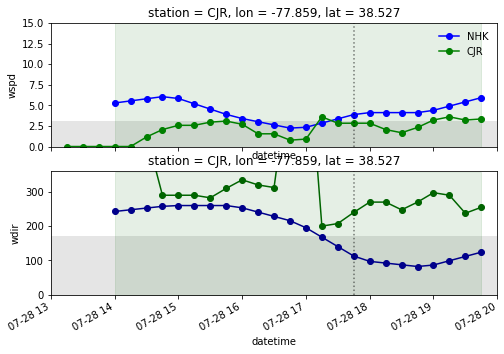

bay breeze validated for 7/29/2019


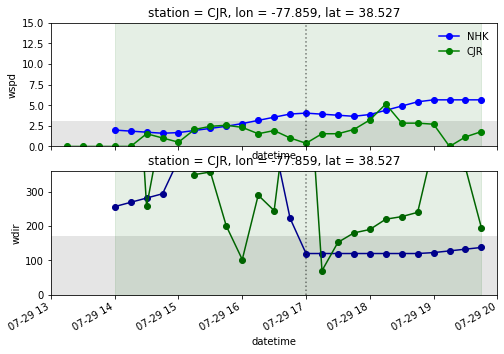

bay breeze validated for 7/30/2019


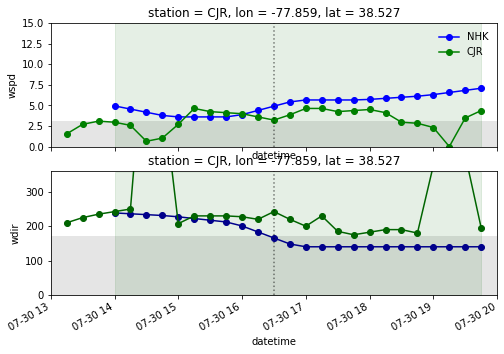

bay breeze validated for 7/31/2019


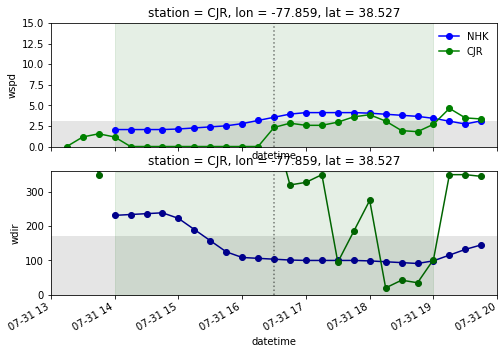

bay breeze validated for 8/1/2019


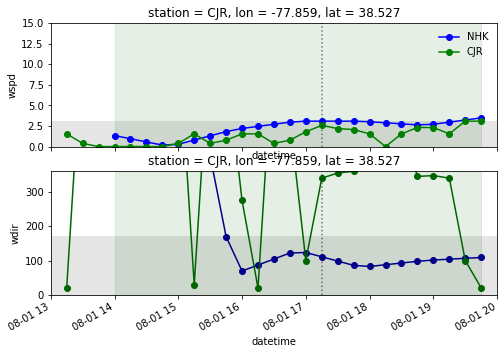

bay breeze validated for 8/17/2019


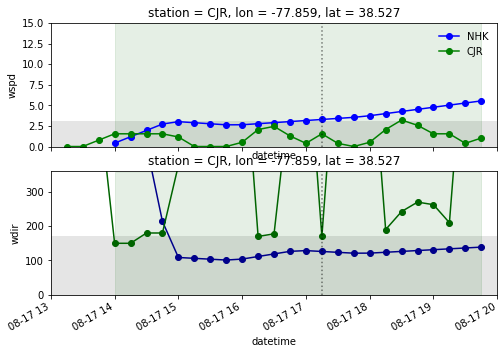

bay breeze validated for 9/16/2019


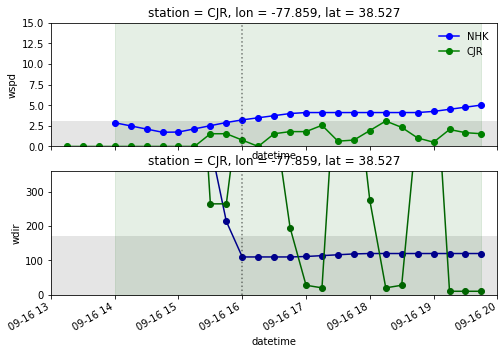

bay breeze validated for 9/20/2019


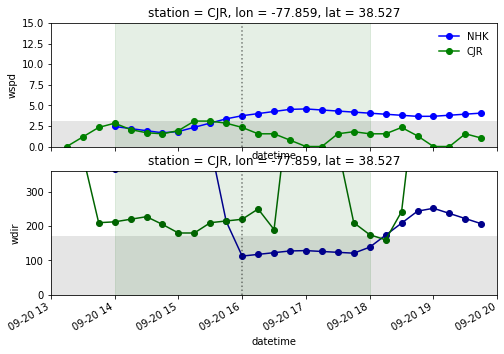

bay breeze validated for 9/21/2019


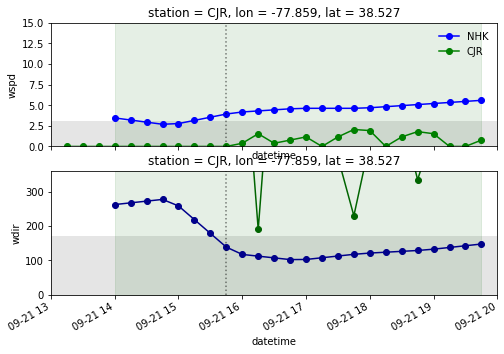

bay breeze validated for 9/22/2019


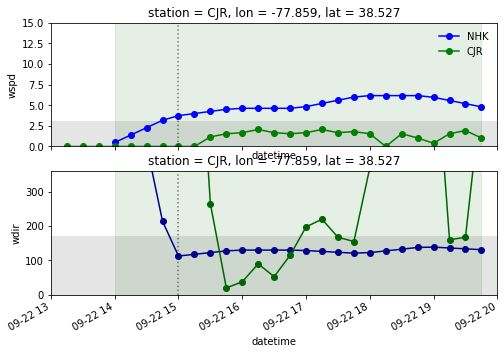

bay breeze validated for 9/25/2019


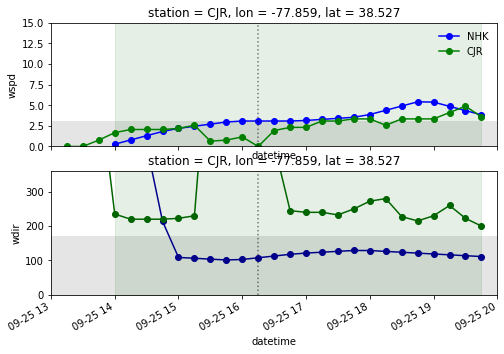

bay breeze validated for 10/1/2019


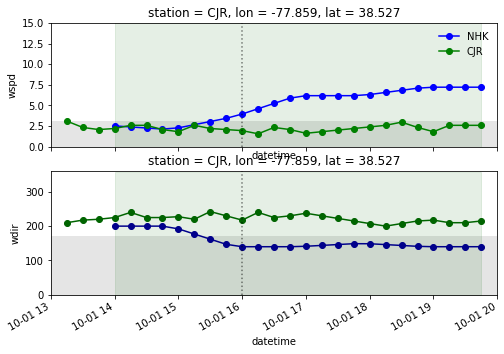

bay breeze validated for 10/11/2019


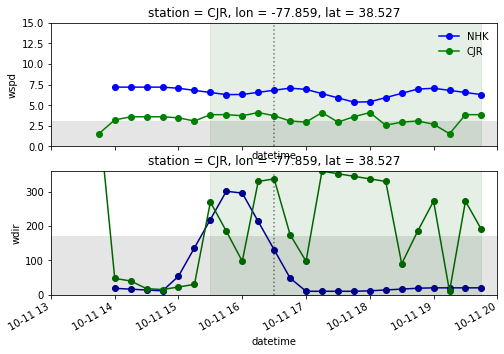

bay breeze validated for 10/12/2019


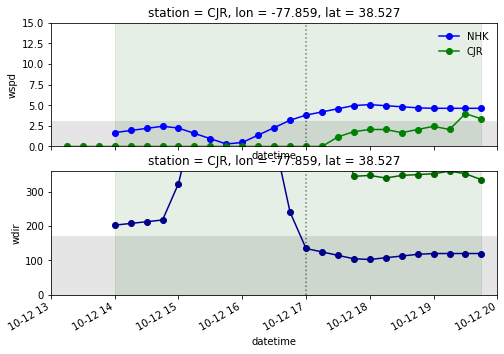

bay breeze validated for 10/19/2019


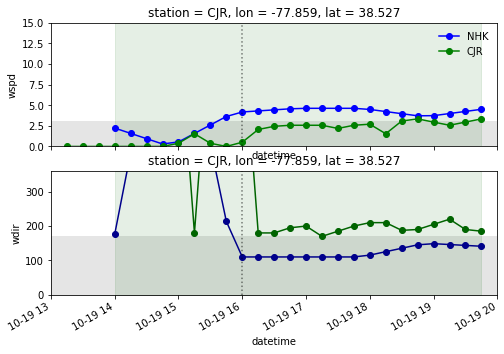

bay breeze validated for 11/2/2019


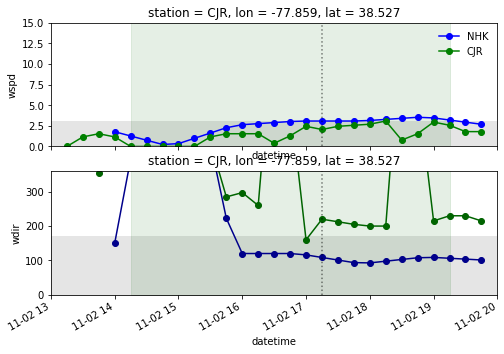

bay breeze validated for 11/6/2019


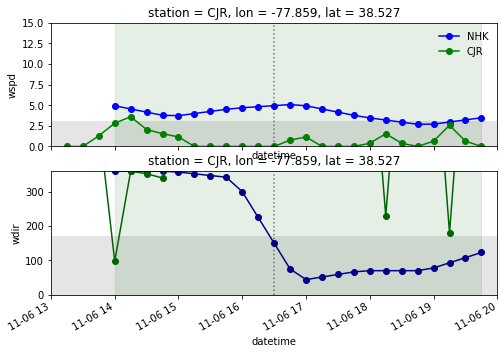

bay breeze validated for 11/11/2019


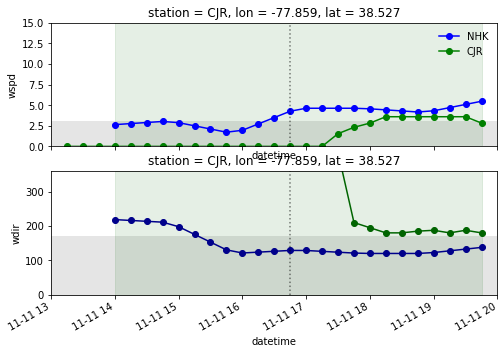

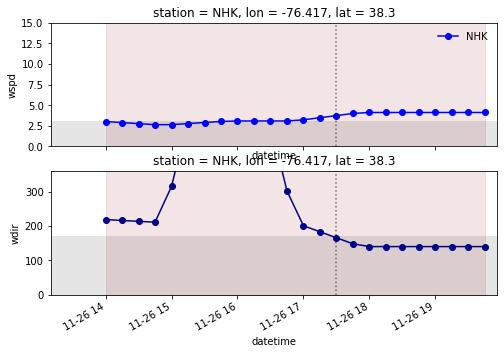

starting station: NUI
Year: 2019
bay breeze validated for 1/17/2019


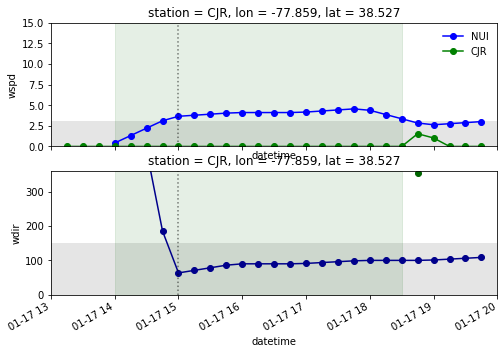

bay breeze validated for 2/26/2019


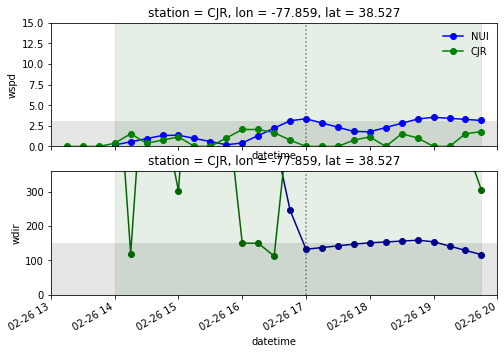

bay breeze validated for 3/13/2019


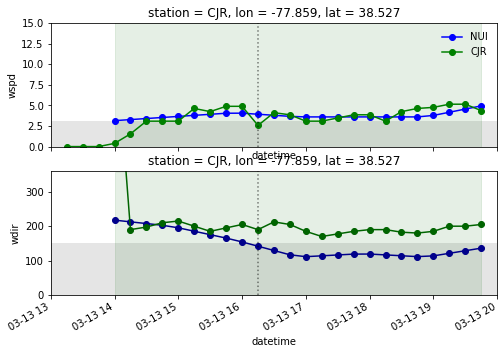

bay breeze validated for 3/28/2019


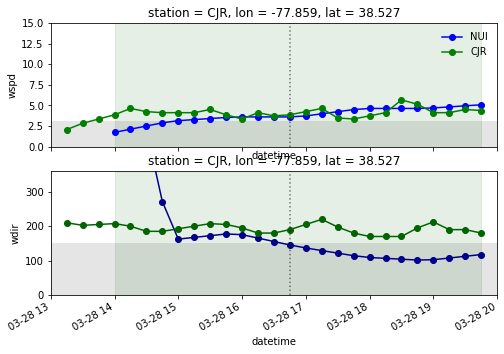

bay breeze validated for 4/7/2019


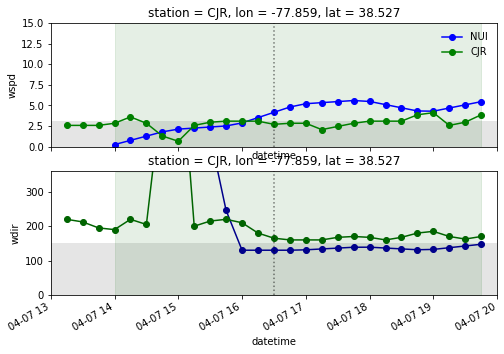

bay breeze validated for 4/17/2019


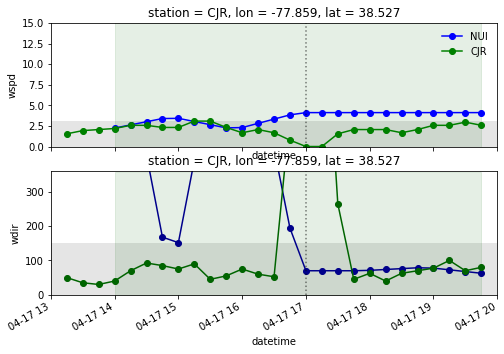

bay breeze validated for 5/4/2019


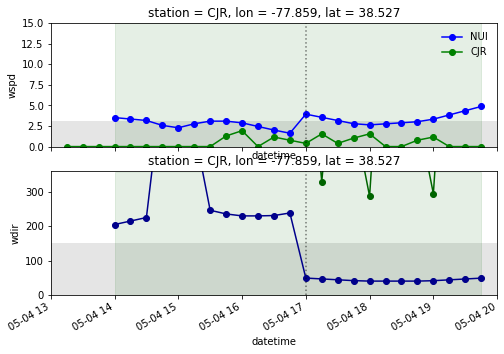

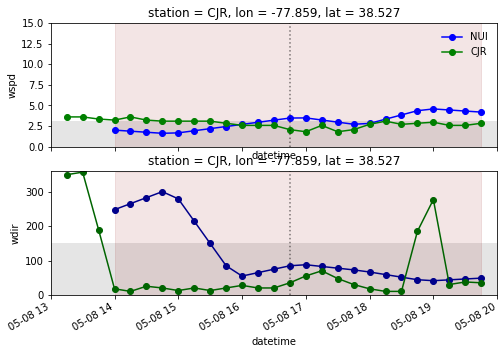

bay breeze validated for 7/10/2019


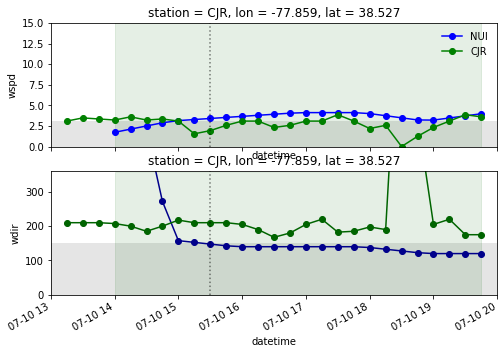

bay breeze validated for 7/24/2019


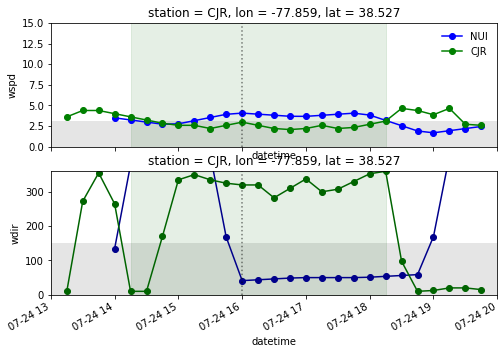

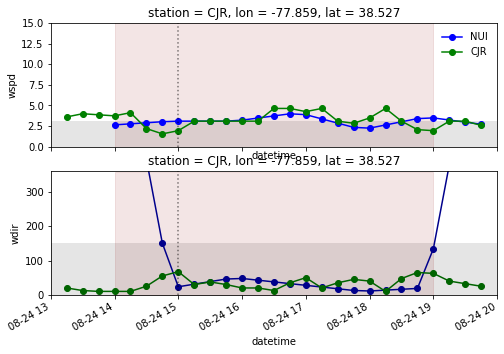

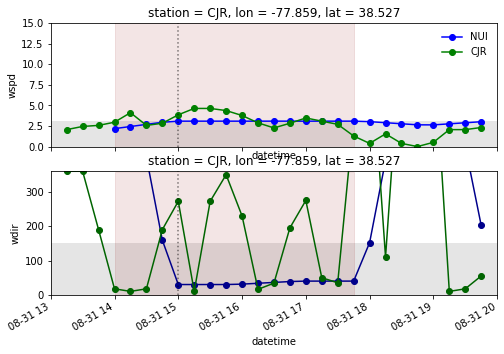

bay breeze validated for 9/8/2019


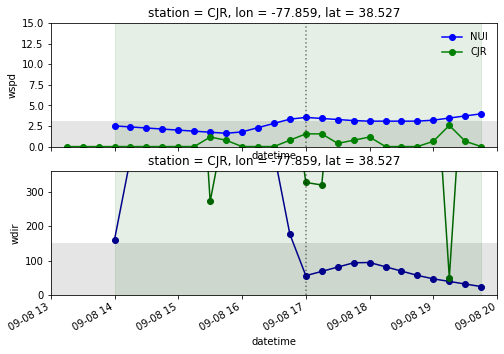

bay breeze validated for 10/7/2019


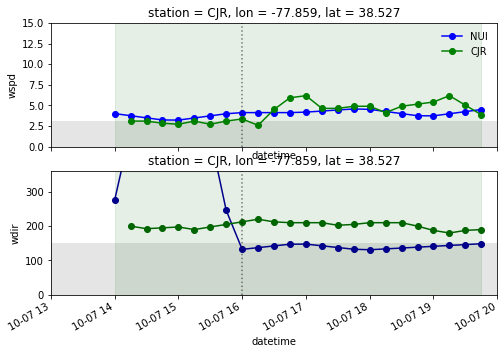

bay breeze validated for 11/4/2019


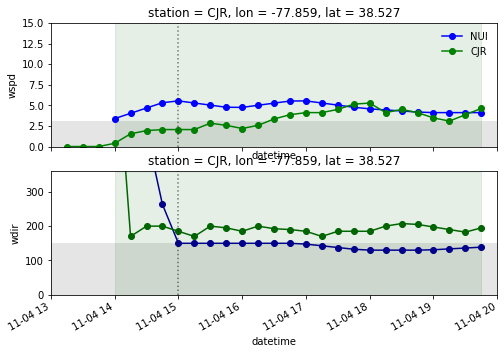

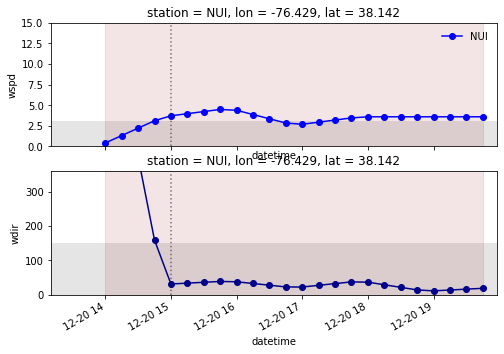

starting station: APG
Year: 2019
Unable to fill...
Unable to draw line...


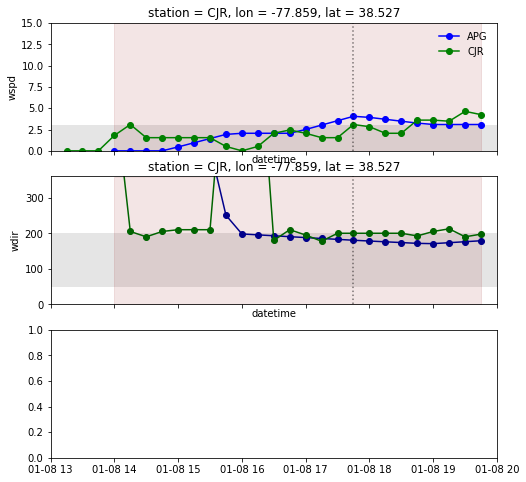

Unable to fill...
Unable to draw line...


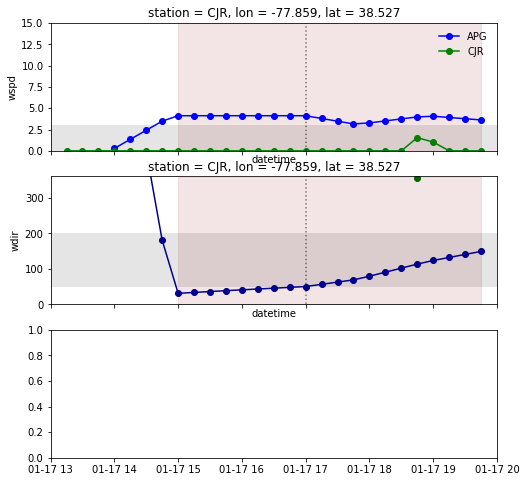

Unable to fill...
Unable to draw line...


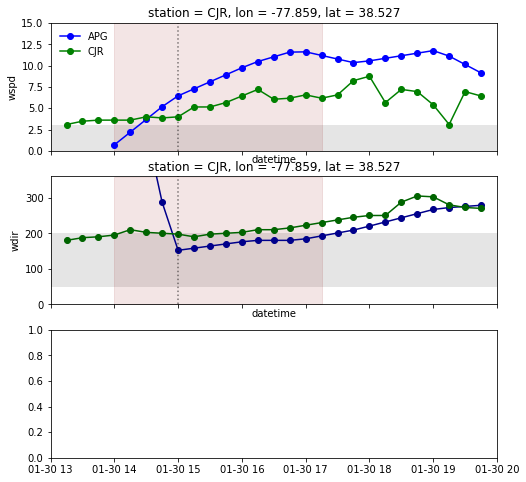

Unable to fill...
Unable to draw line...


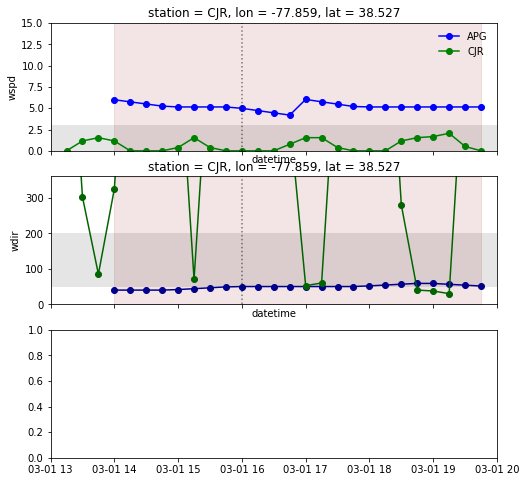

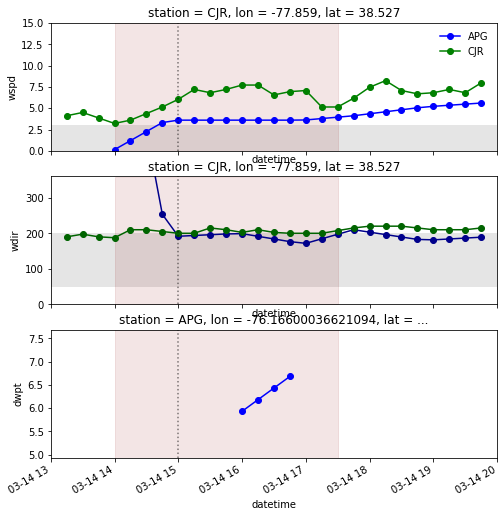

Unable to fill...
Unable to draw line...


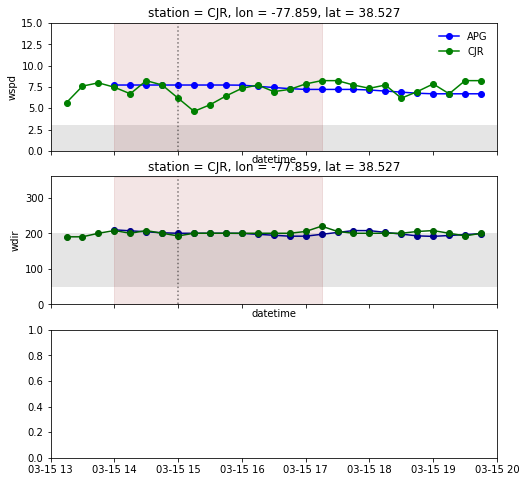

Unable to fill...
Unable to draw line...


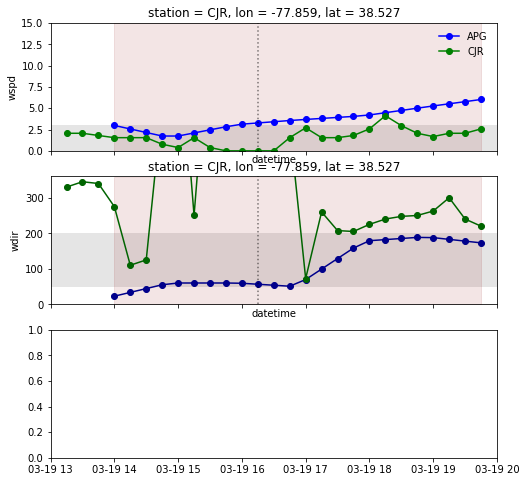

Unable to fill...
Unable to draw line...


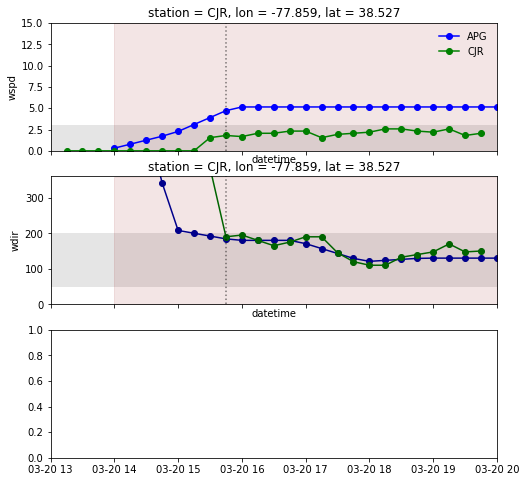

Unable to fill...
Unable to draw line...


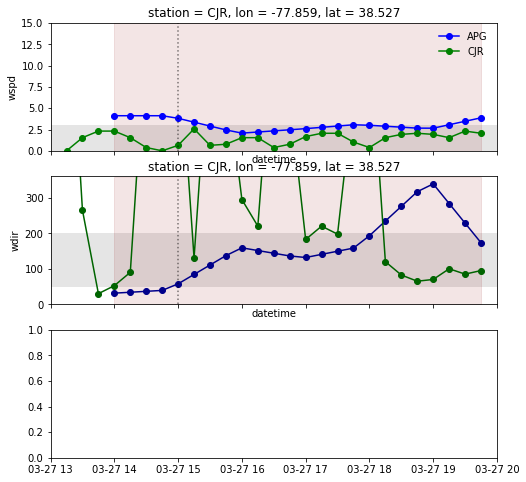

Unable to fill...
Unable to draw line...


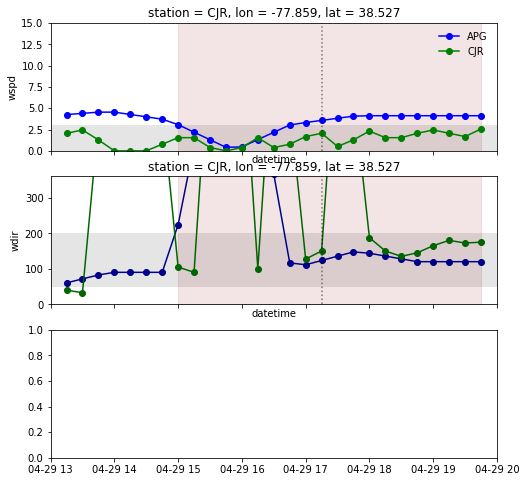

Unable to fill...
Unable to draw line...


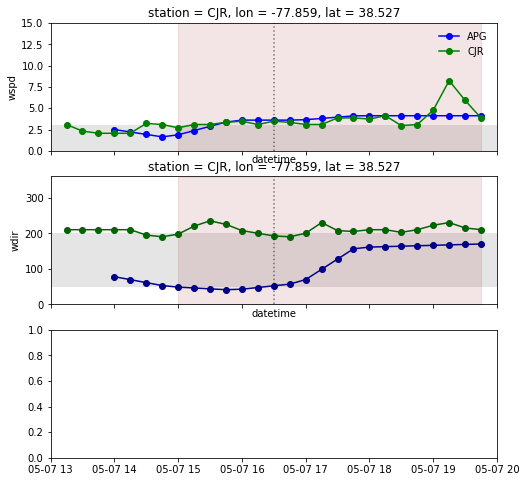

Unable to fill...
Unable to draw line...


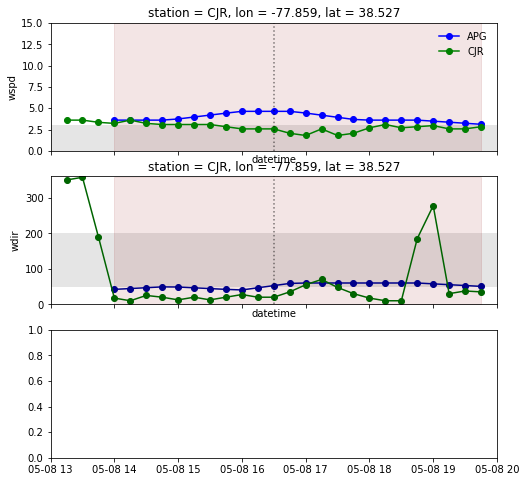

Unable to fill...
Unable to draw line...


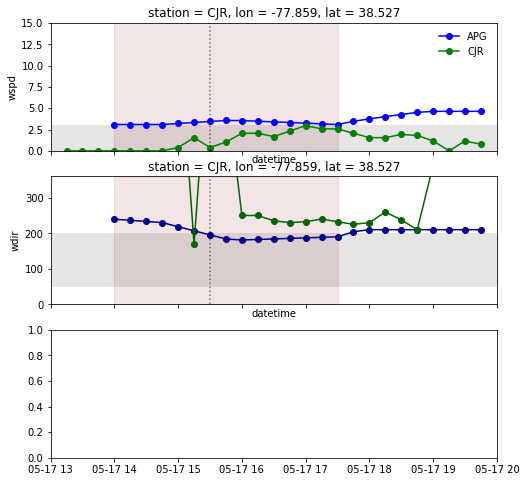

Unable to fill...
Unable to draw line...


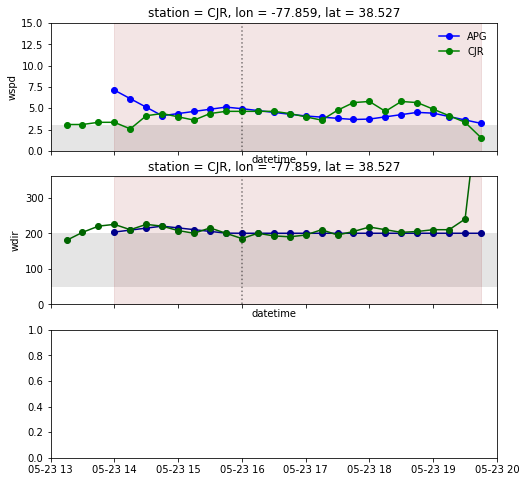

Unable to fill...
Unable to draw line...


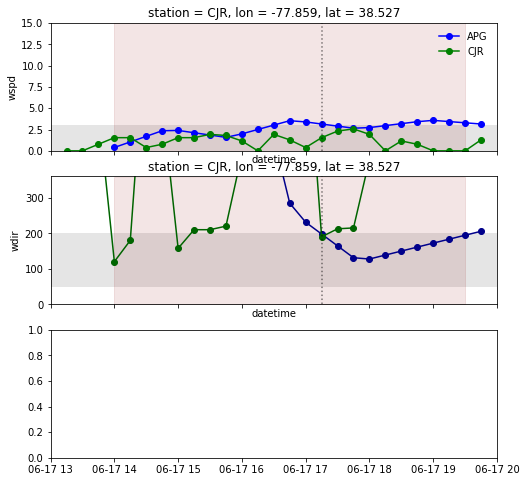

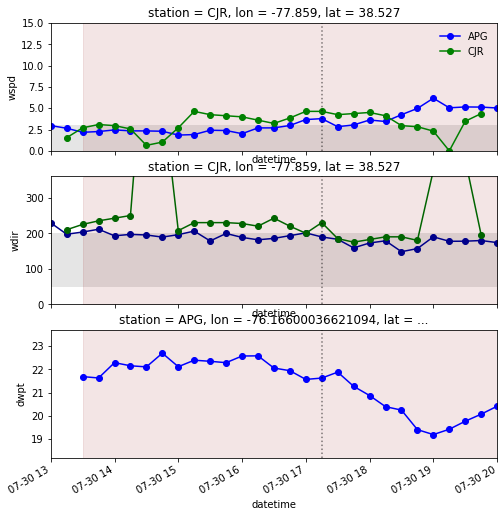

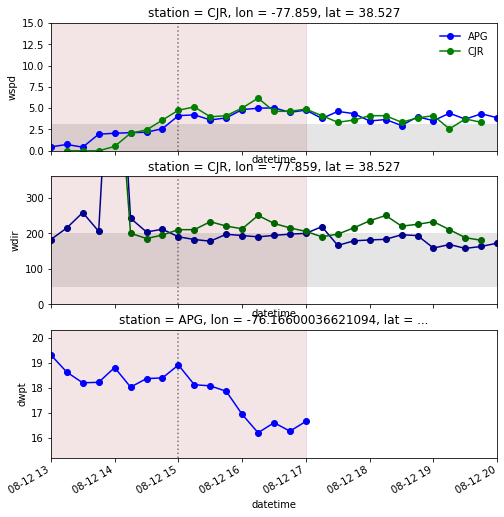

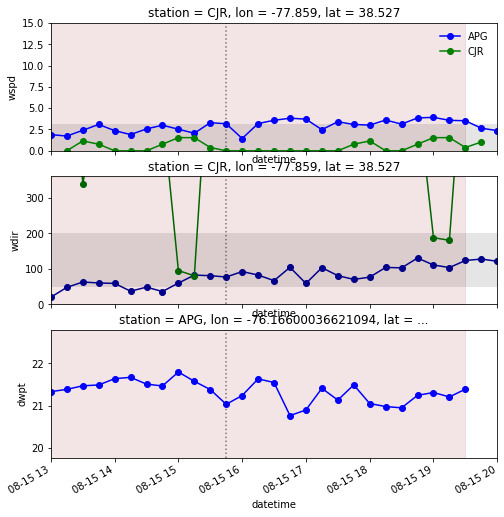

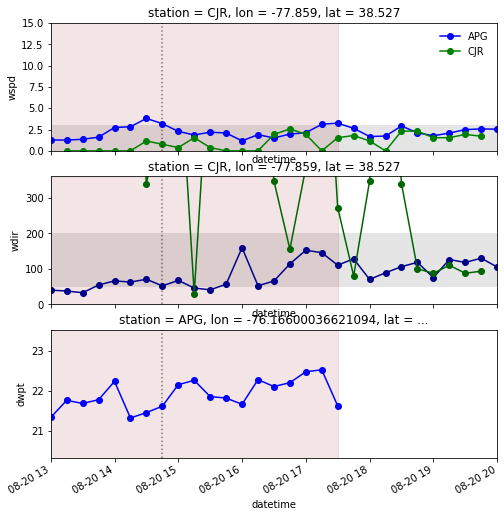

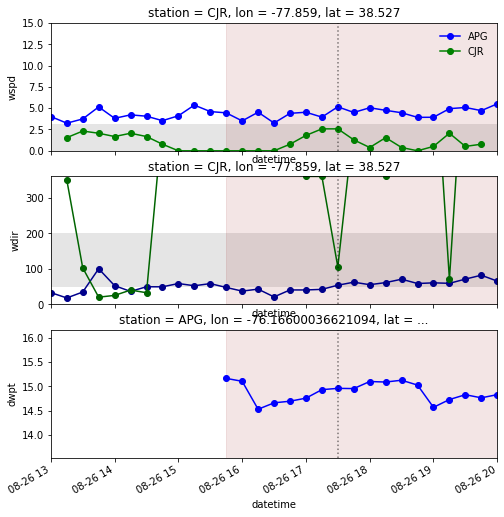

Unable to fill...
Unable to draw line...


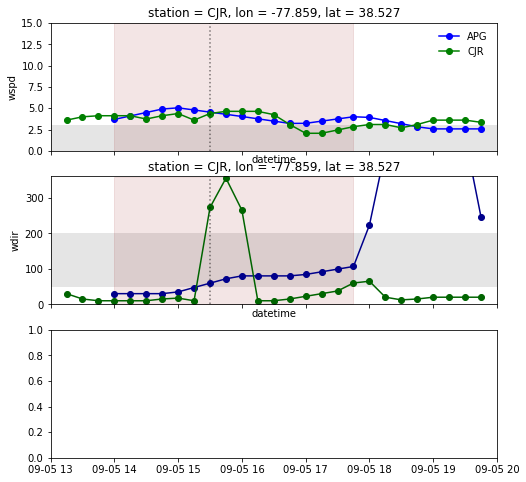

Unable to fill...
Unable to draw line...


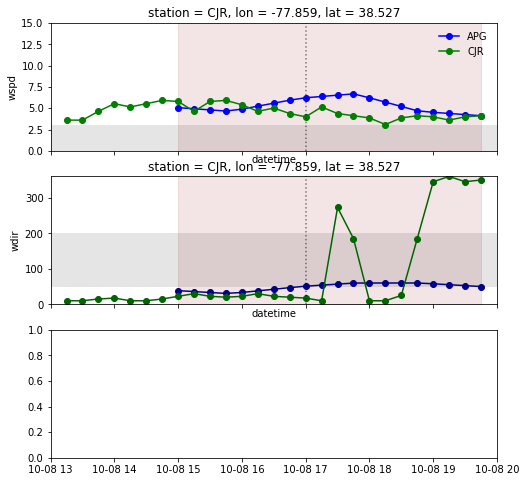

Unable to fill...
Unable to draw line...


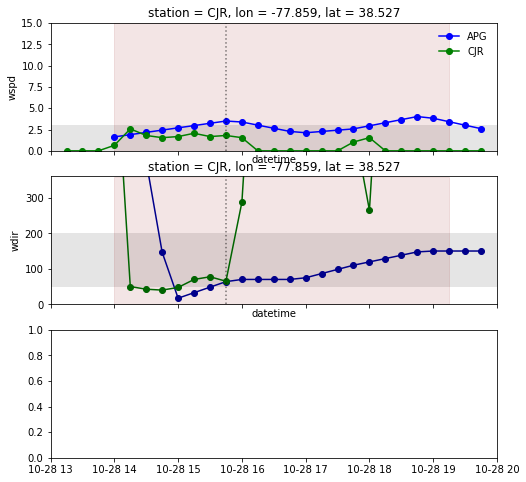

Unable to fill...
Unable to draw line...


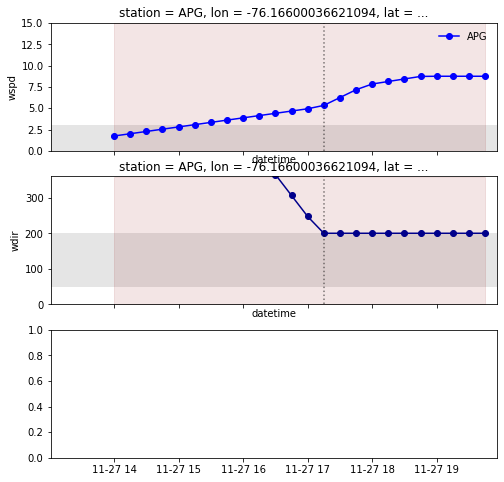

starting station: BWI
Year: 2019


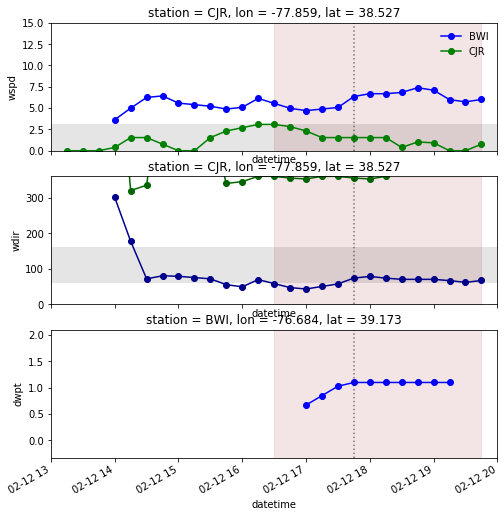

bay breeze validated for 3/13/2019


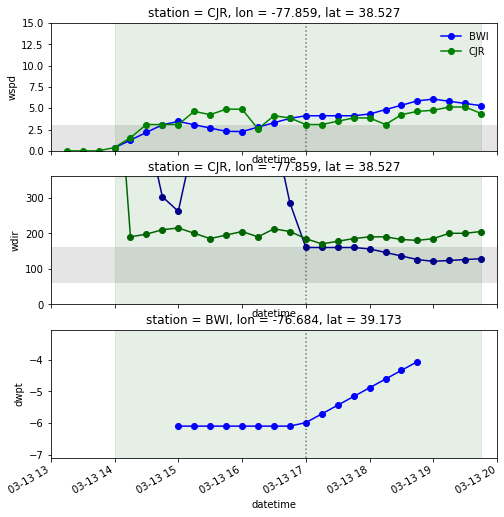

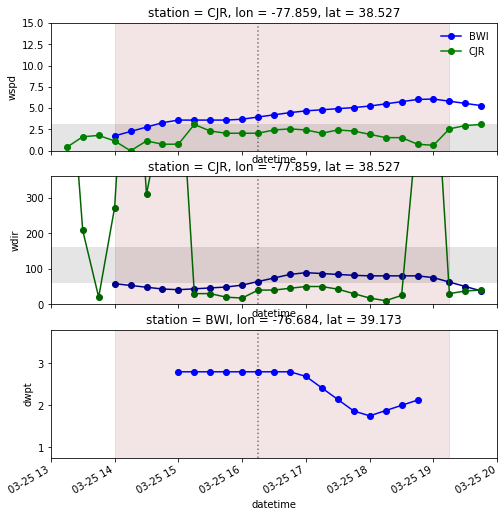

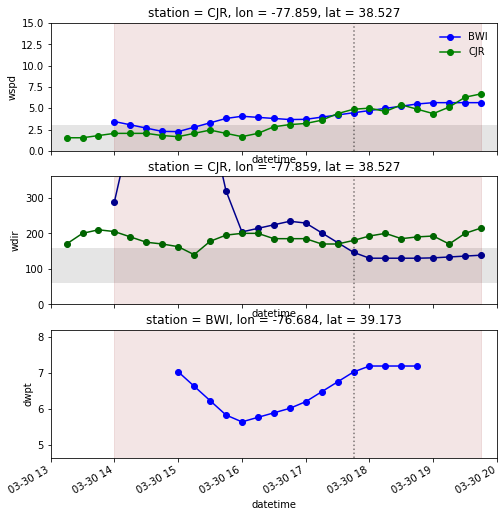

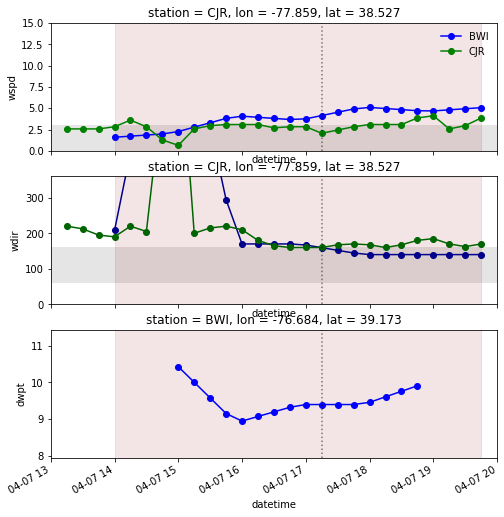

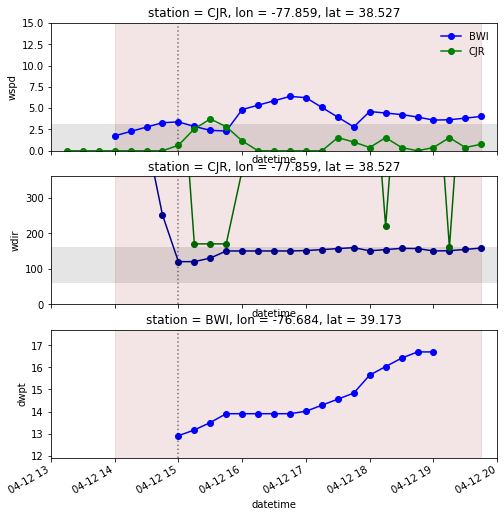

...

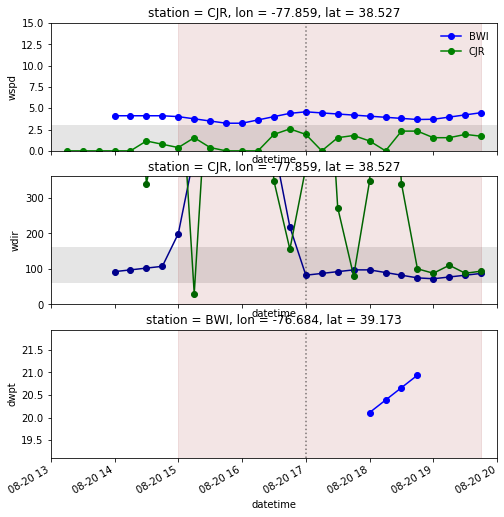

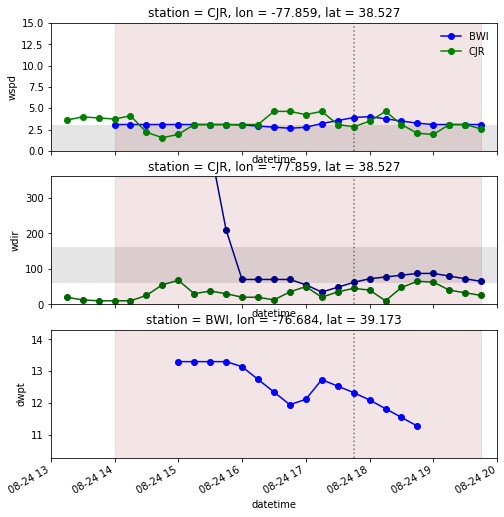

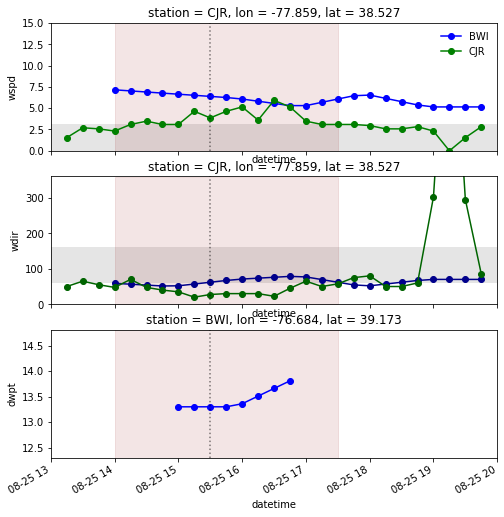

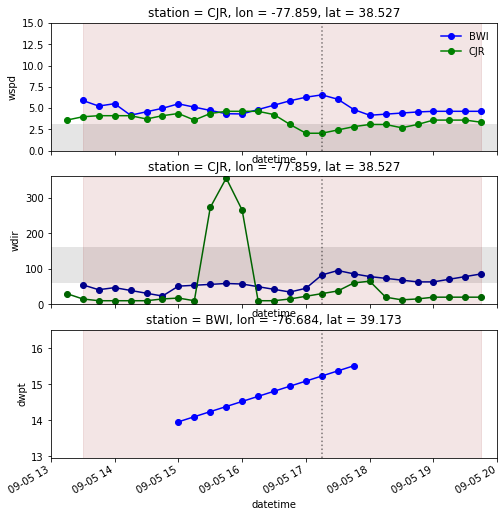

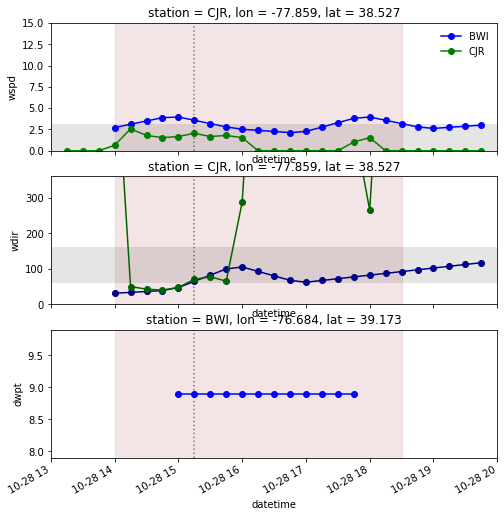

starting station: MTN
Year: 2019
Unable to fill...
Unable to draw line...


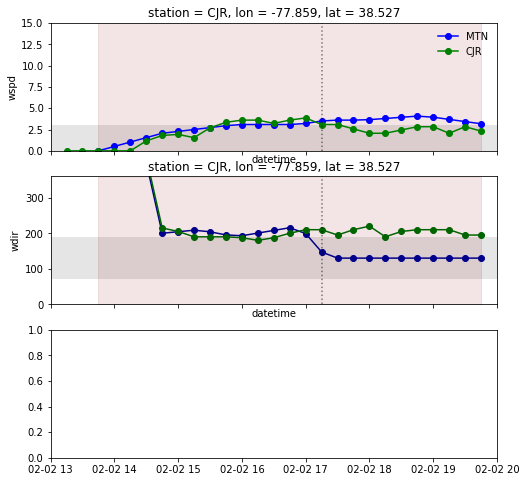

Unable to fill...
Unable to draw line...


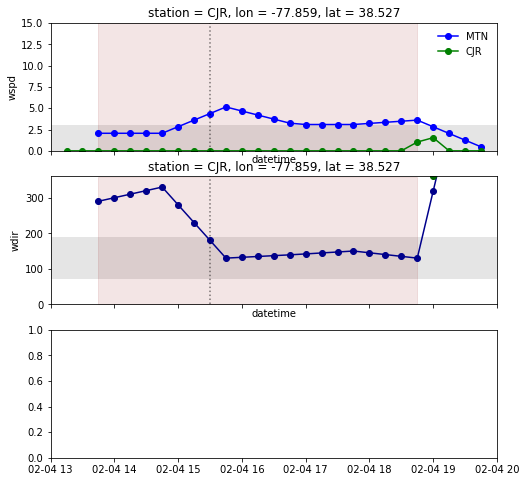

Unable to fill...
Unable to draw line...


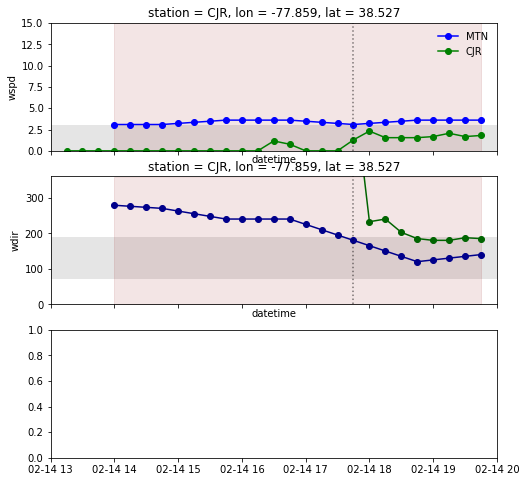

Unable to fill...
Unable to draw line...


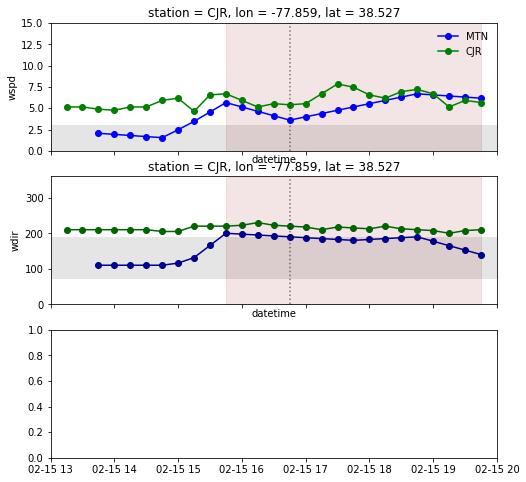

Unable to fill...
Unable to draw line...


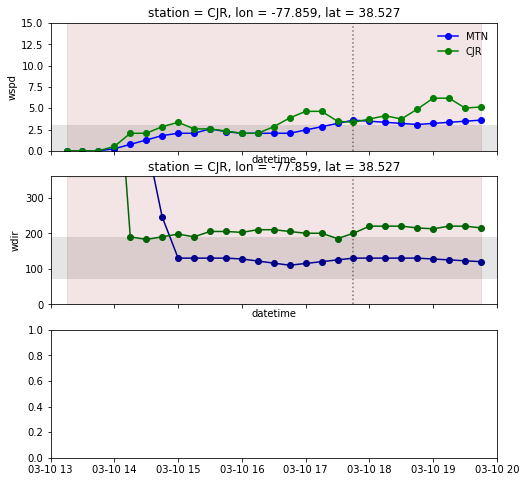

Unable to fill...
Unable to draw line...


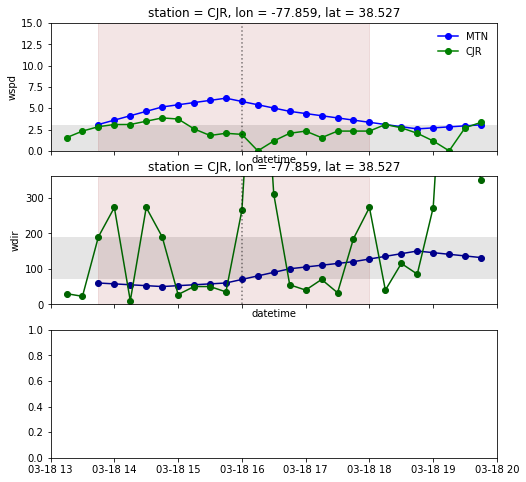

Unable to fill...
Unable to draw line...


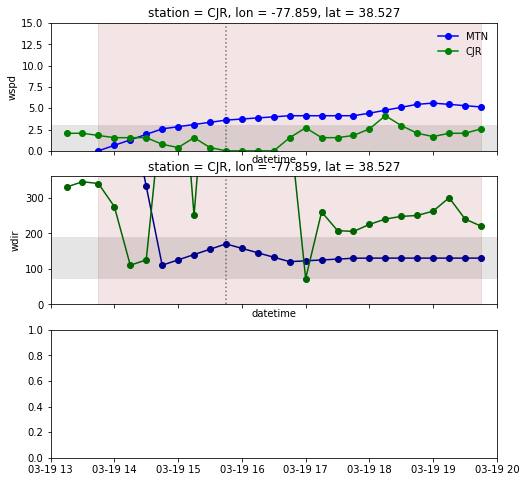

Unable to fill...
Unable to draw line...


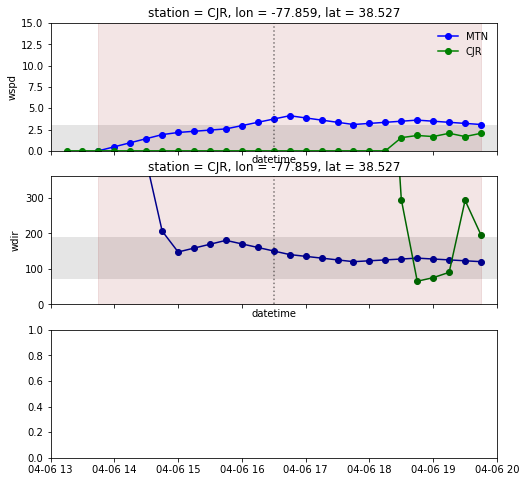

Unable to fill...
Unable to draw line...


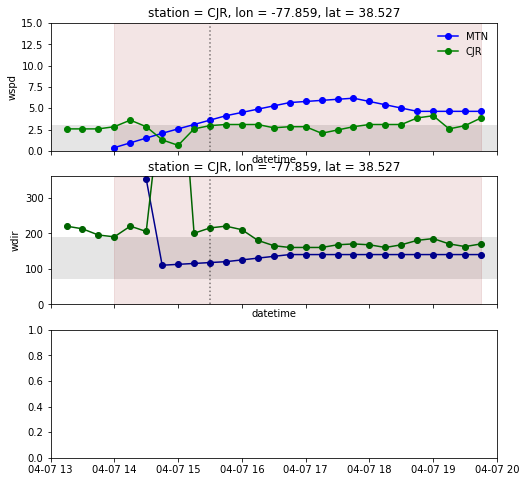

Unable to fill...
Unable to draw line...


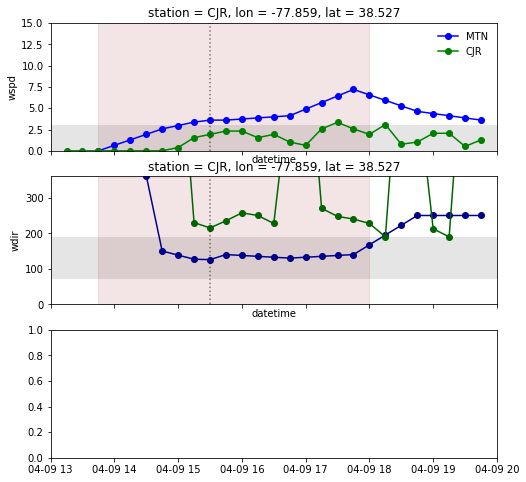

Unable to fill...
Unable to draw line...


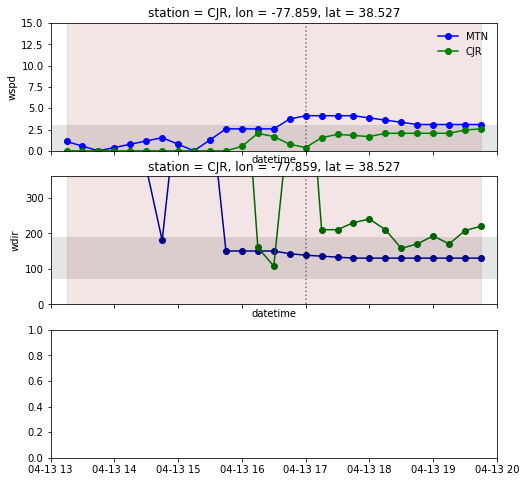

Unable to fill...
Unable to draw line...


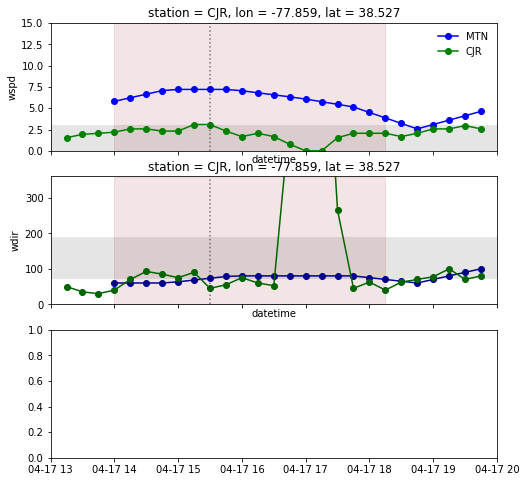

Unable to fill...
Unable to draw line...


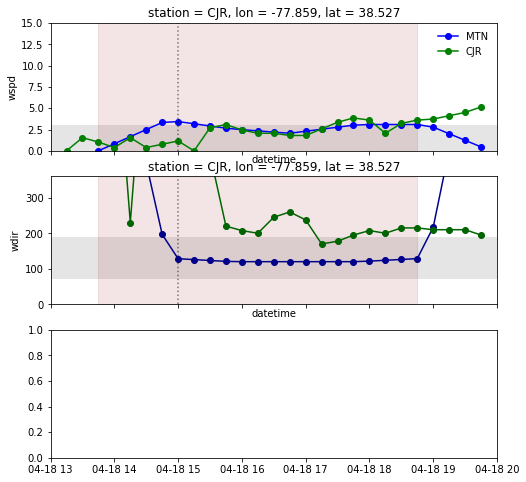

Unable to fill...
Unable to draw line...


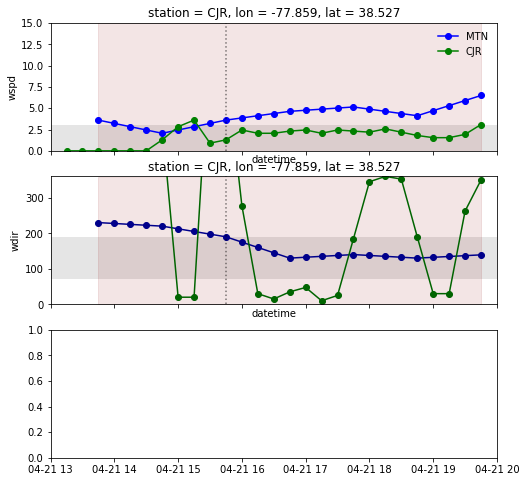

Unable to fill...
Unable to draw line...


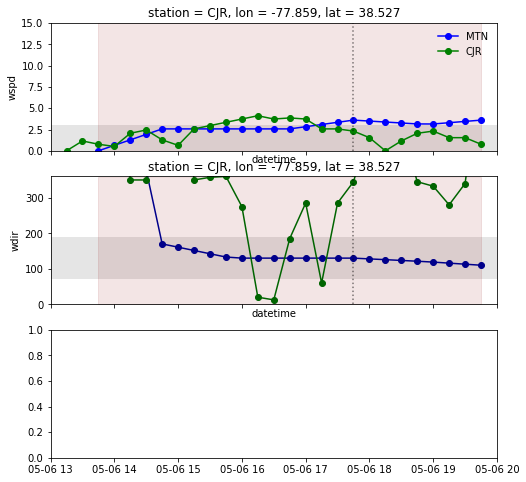

Unable to fill...
Unable to draw line...


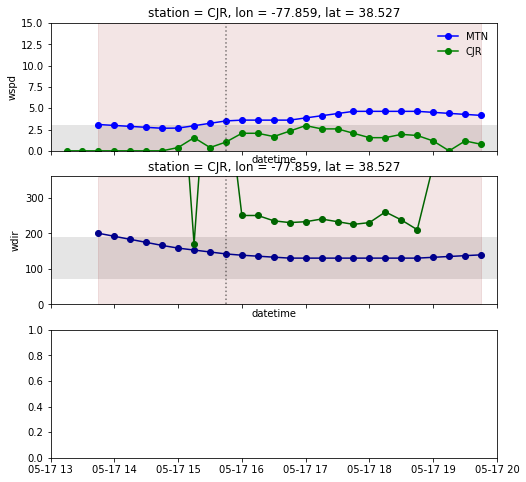

Unable to fill...
Unable to draw line...


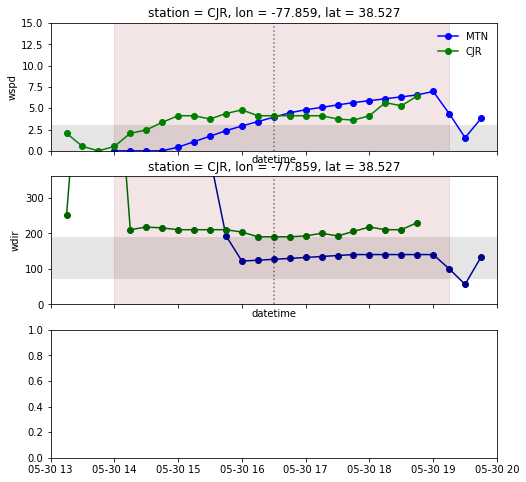

Unable to fill...
Unable to draw line...


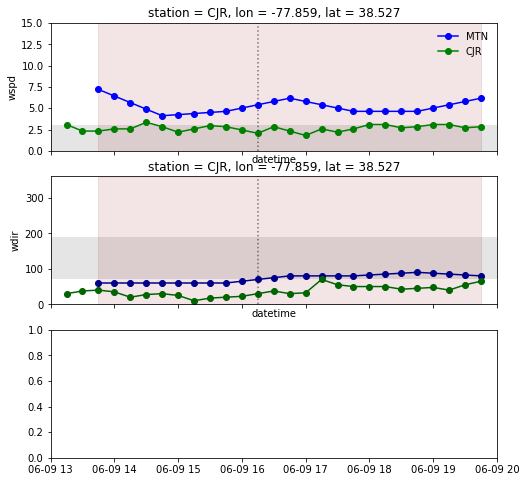

Unable to fill...
Unable to draw line...


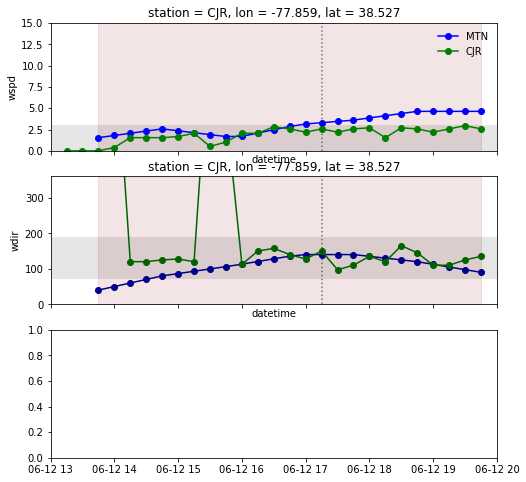

Unable to fill...
Unable to draw line...


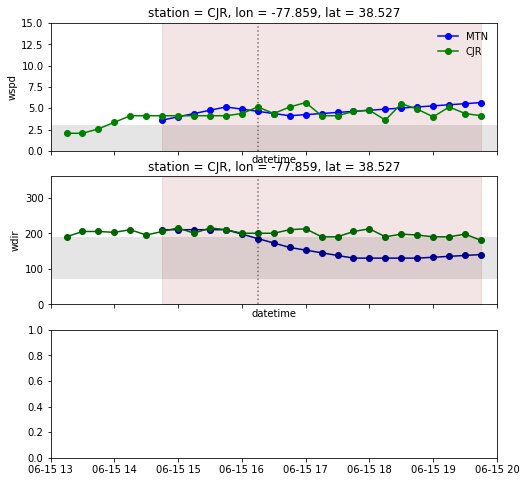

Unable to fill...
Unable to draw line...


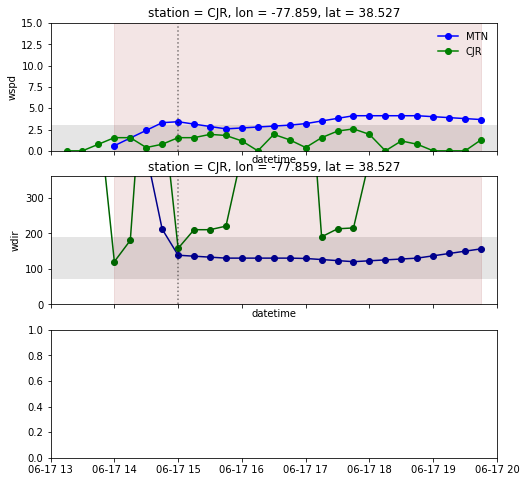

Unable to fill...
Unable to draw line...


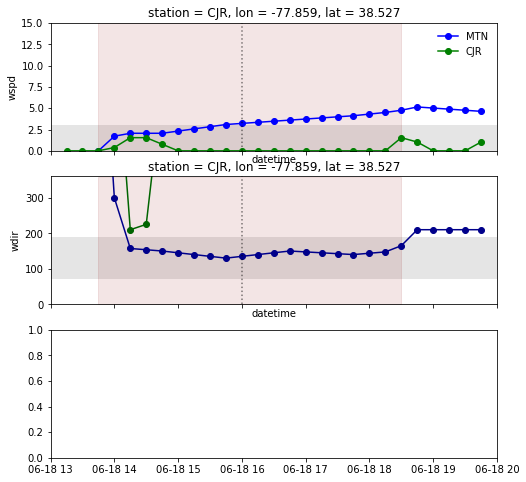

Unable to fill...
Unable to draw line...


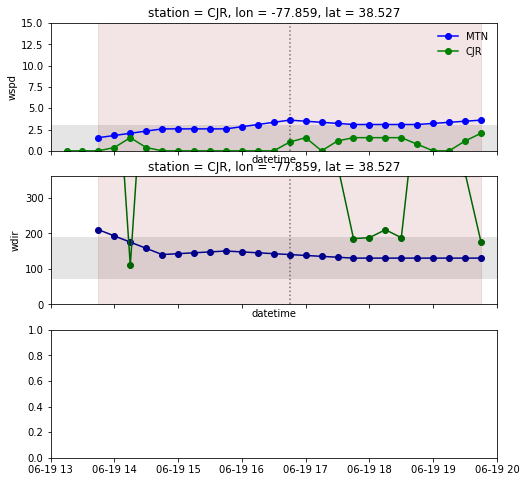

Unable to fill...
Unable to draw line...


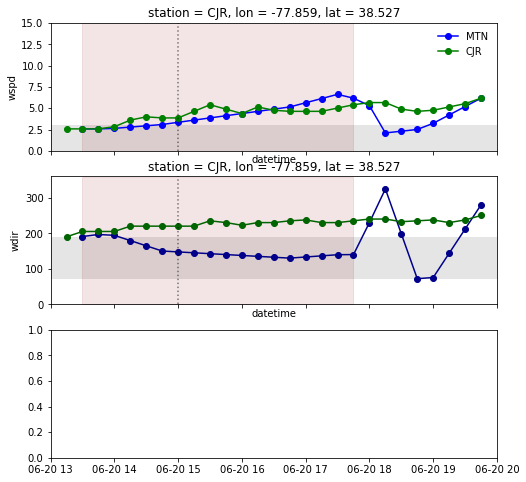

Unable to fill...
Unable to draw line...


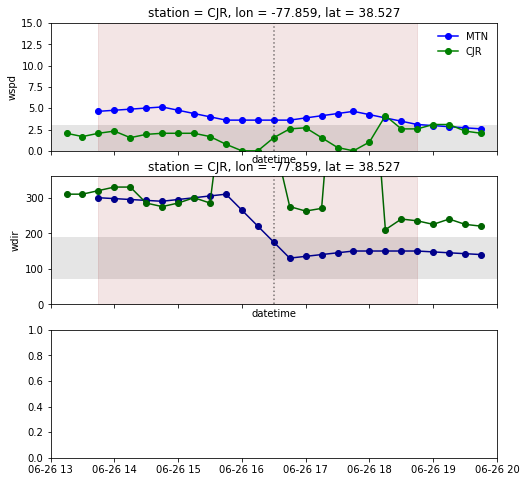

Unable to fill...
Unable to draw line...


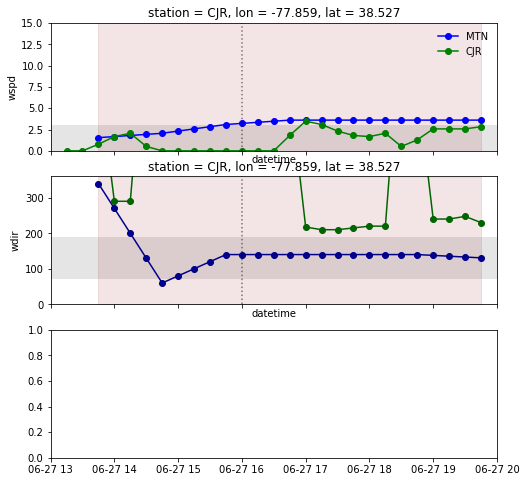

Unable to fill...
Unable to draw line...


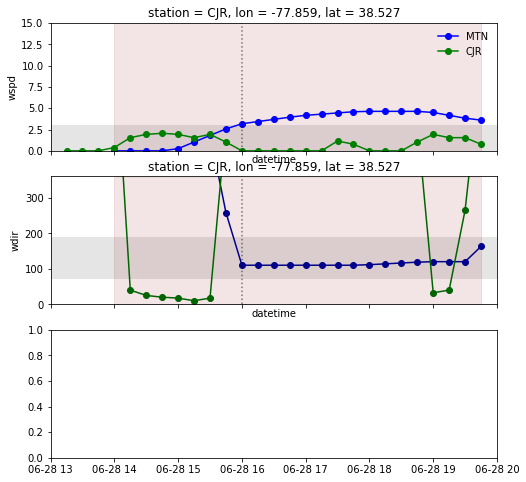

Unable to fill...
Unable to draw line...


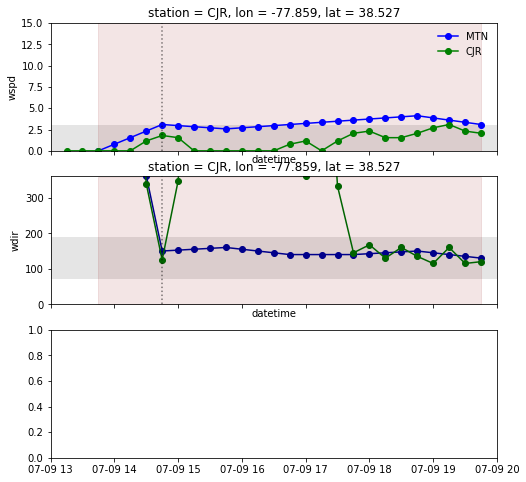

Unable to fill...
Unable to draw line...


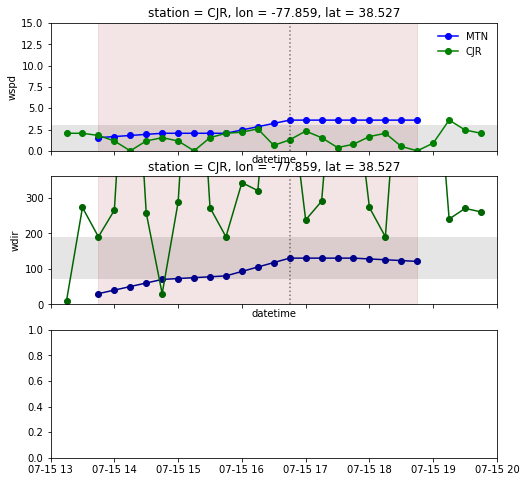

Unable to fill...
Unable to draw line...


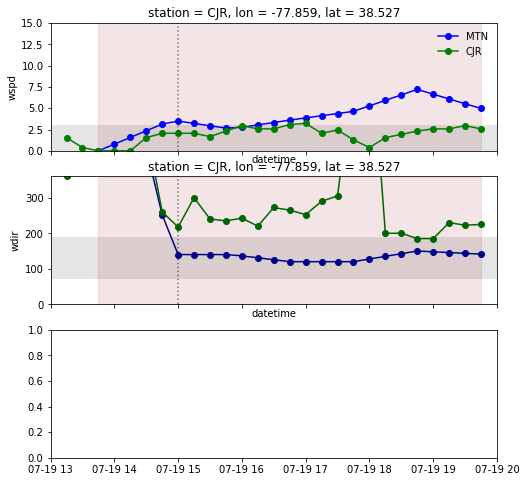

Unable to fill...
Unable to draw line...


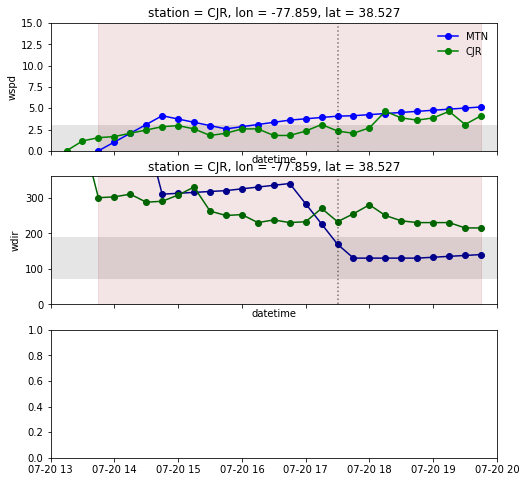

Unable to fill...
Unable to draw line...


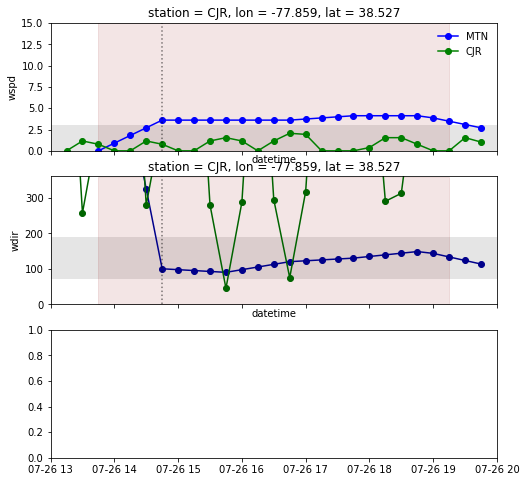

Unable to fill...
Unable to draw line...


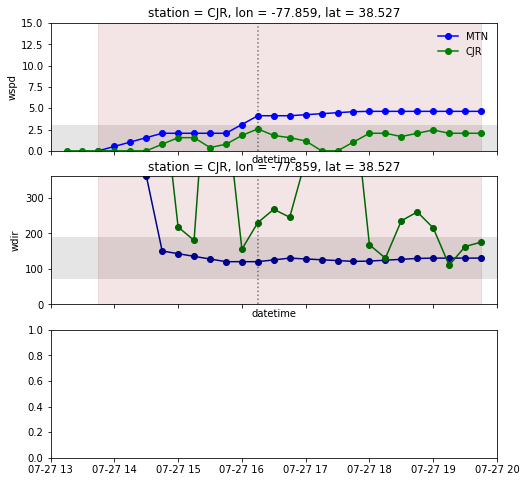

Unable to fill...
Unable to draw line...


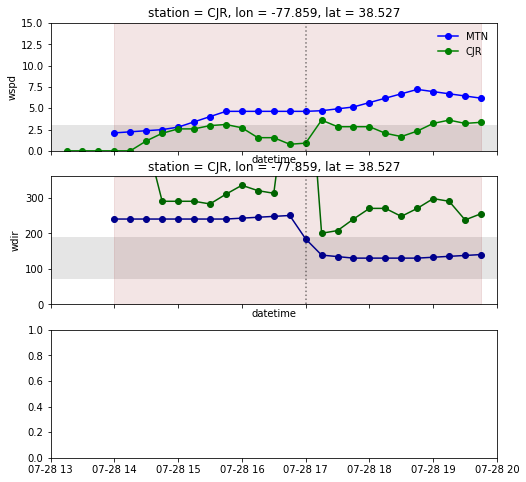

Unable to fill...
Unable to draw line...


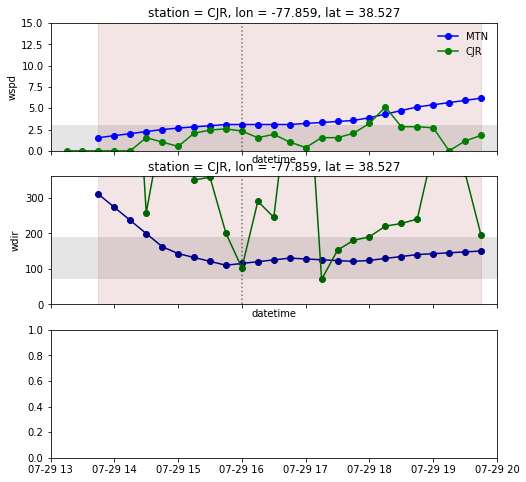

Unable to fill...
Unable to draw line...


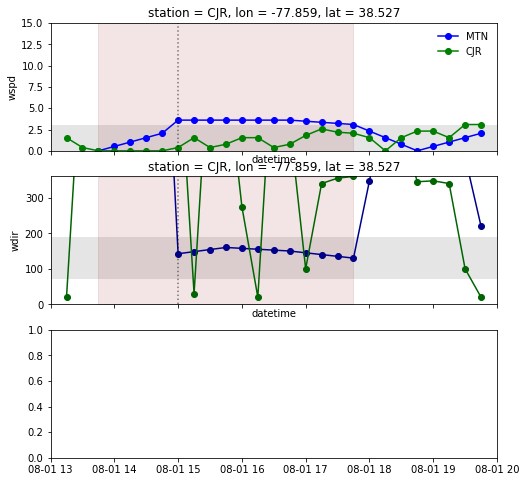

Unable to fill...
Unable to draw line...


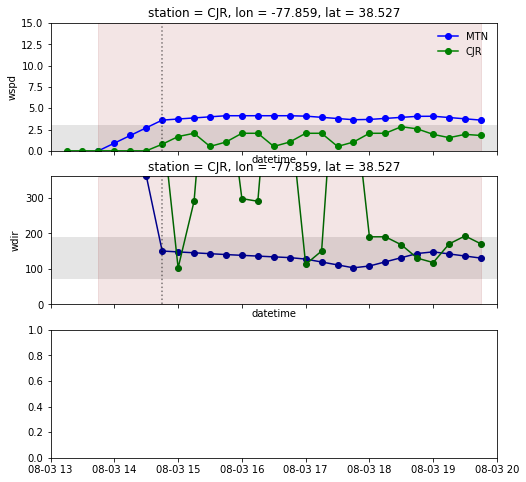

Unable to fill...
Unable to draw line...


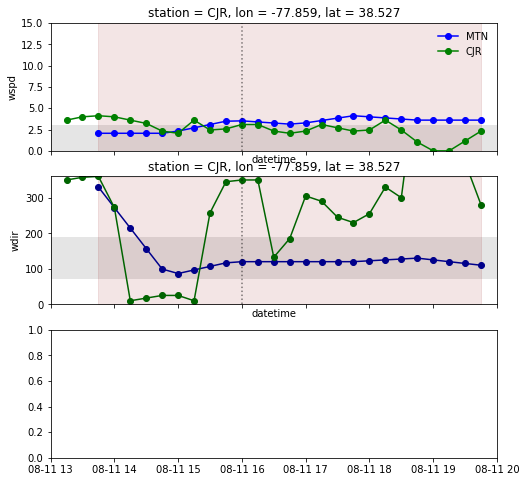

Unable to fill...
Unable to draw line...


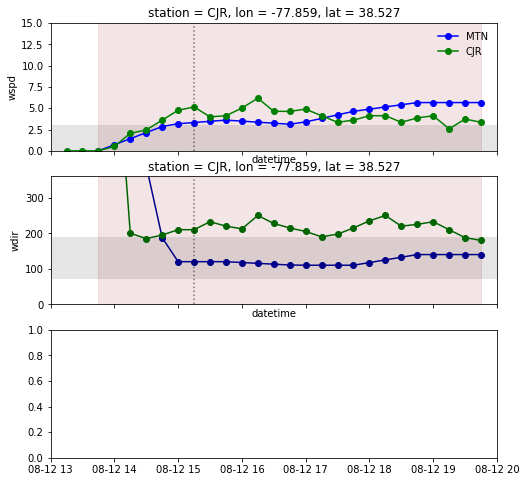

Unable to fill...
Unable to draw line...


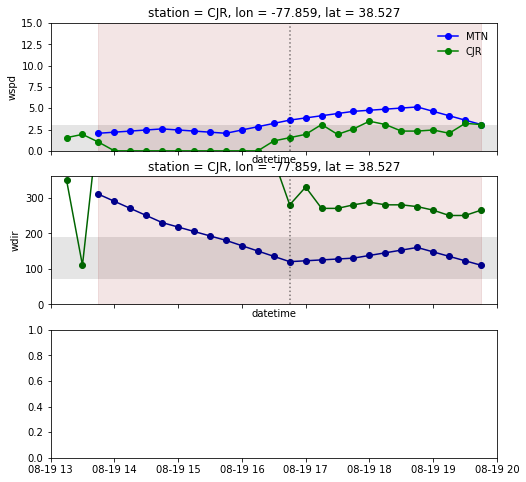

Unable to fill...
Unable to draw line...


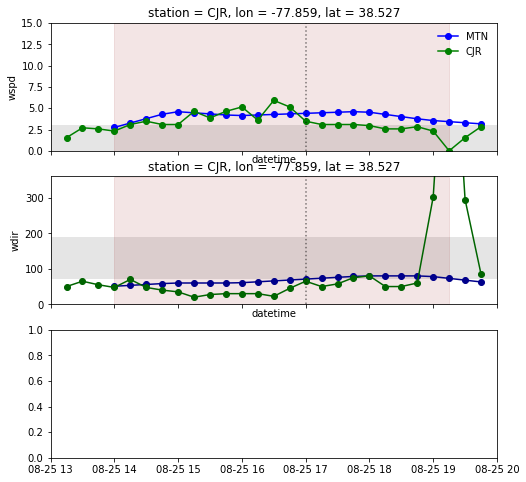

Unable to fill...
Unable to draw line...


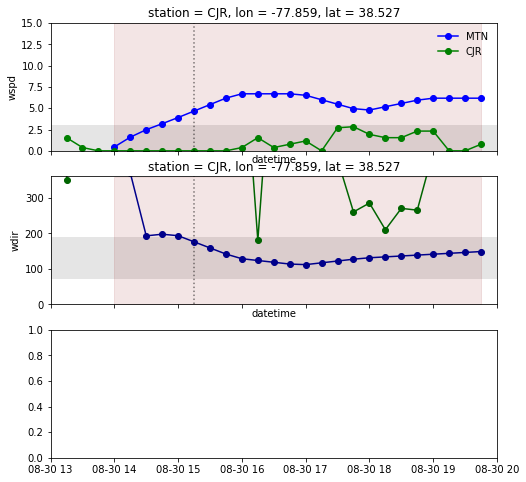

Unable to fill...
Unable to draw line...


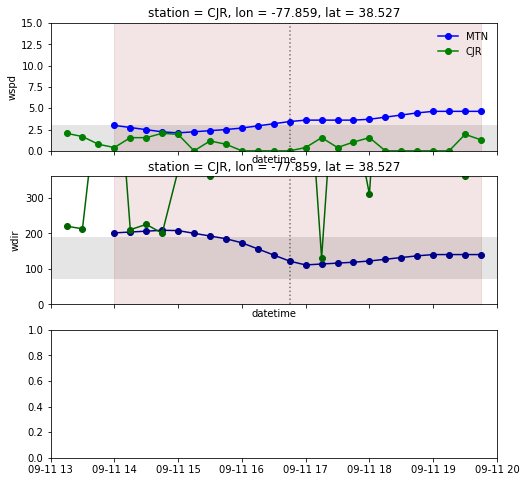

Unable to fill...
Unable to draw line...


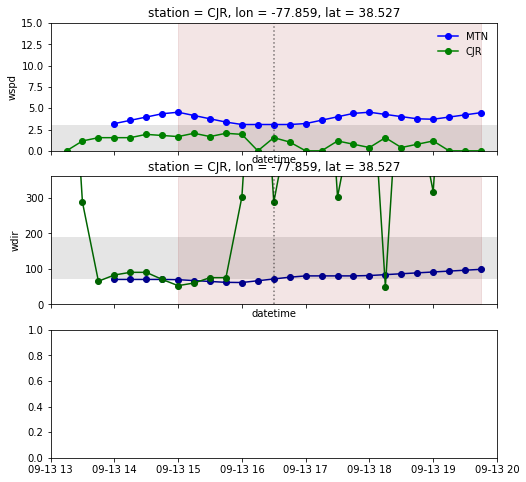

Unable to fill...
Unable to draw line...


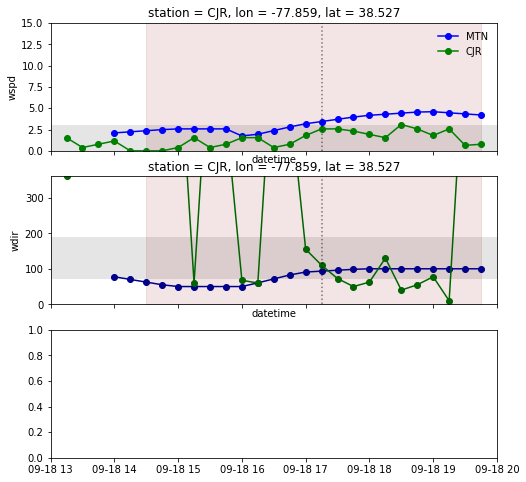

Unable to fill...
Unable to draw line...


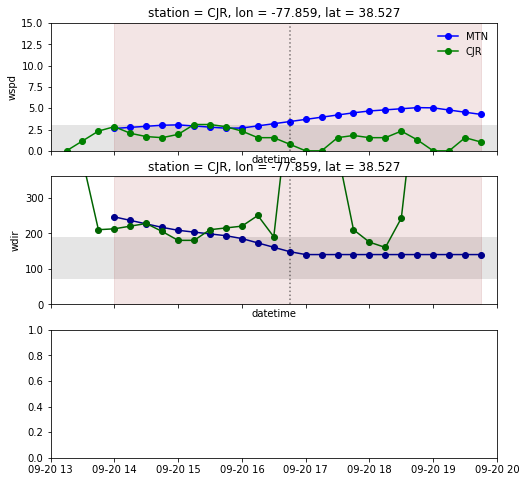

Unable to fill...
Unable to draw line...


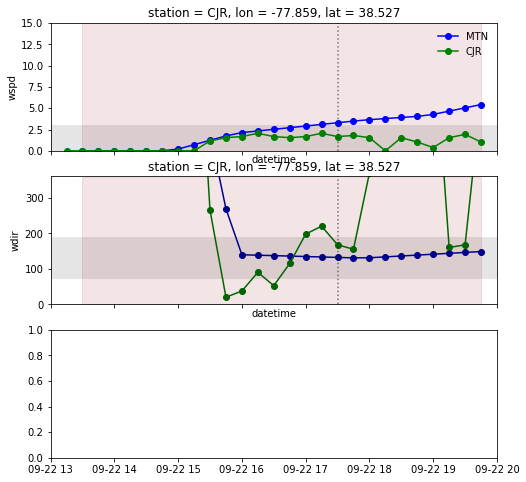

Unable to fill...
Unable to draw line...


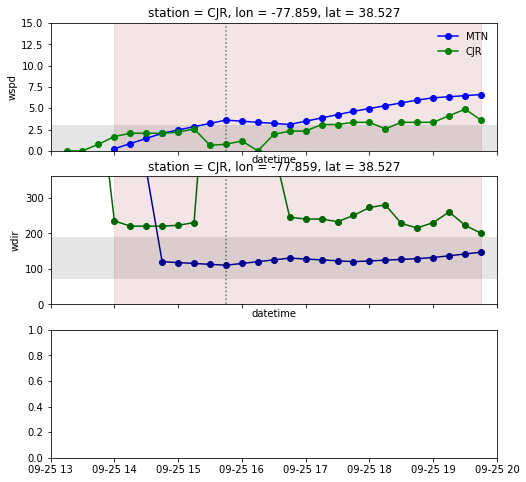

Unable to fill...
Unable to draw line...


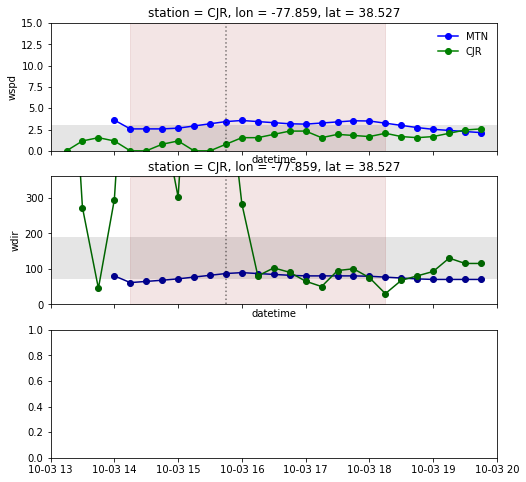

Unable to fill...
Unable to draw line...


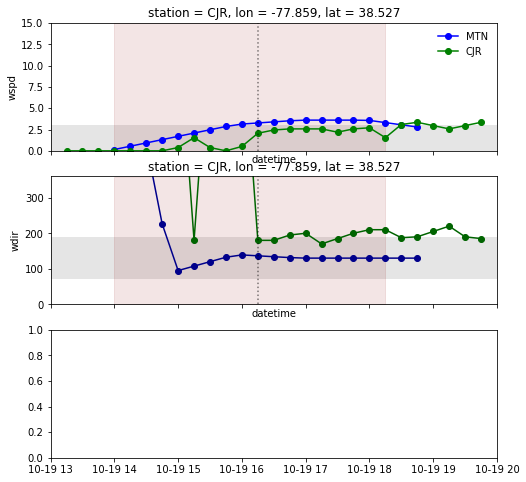

Unable to fill...
Unable to draw line...


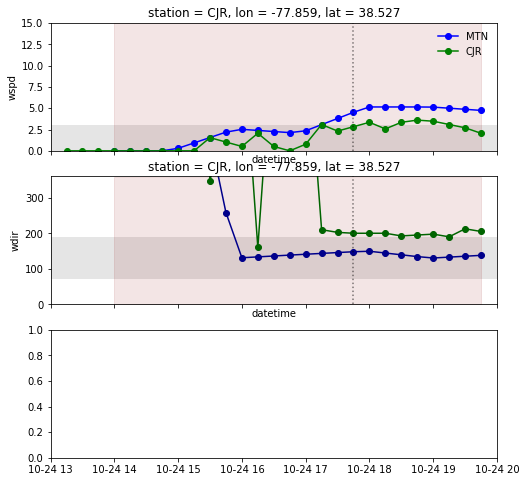

Unable to fill...
Unable to draw line...


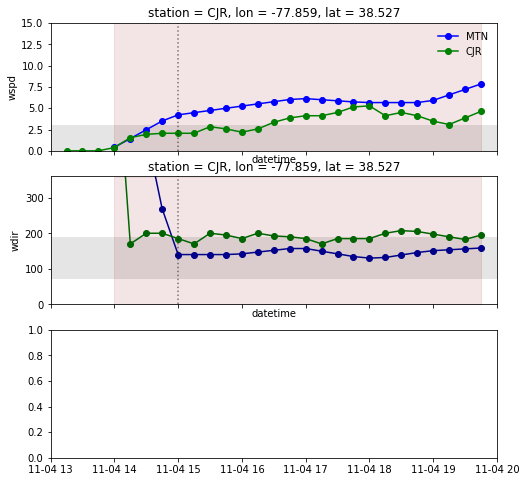

Unable to fill...
Unable to draw line...


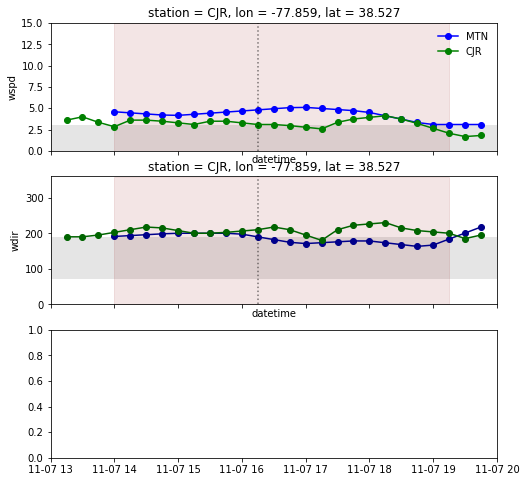

Unable to fill...
Unable to draw line...


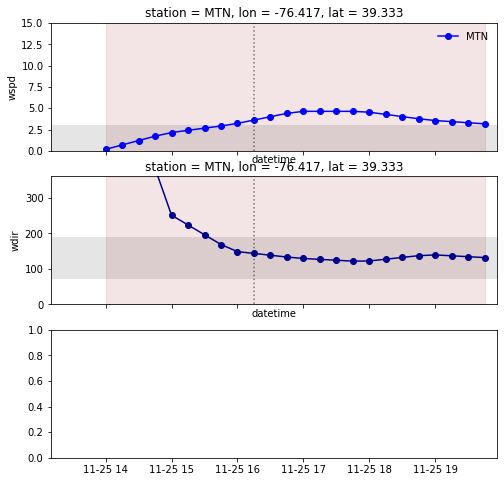

Unable to fill...
Unable to draw line...


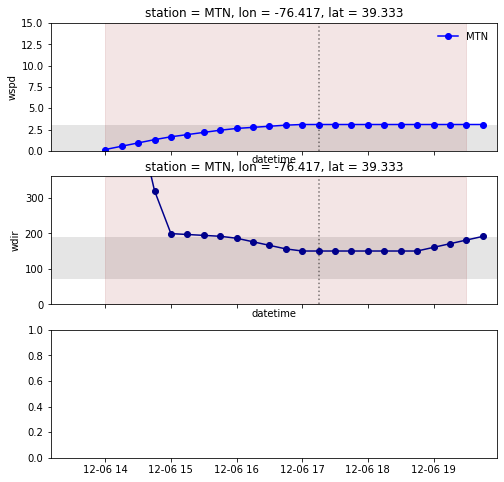

Unable to fill...
Unable to draw line...


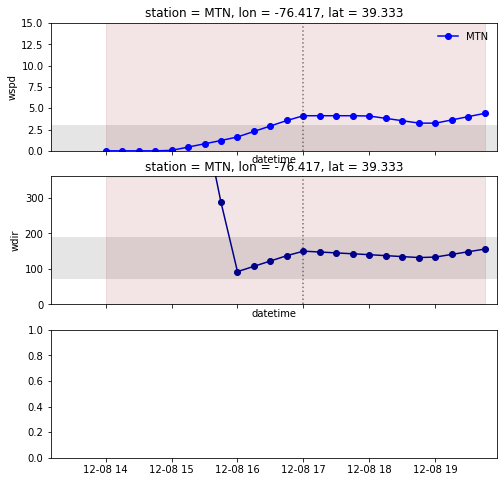

starting station: NAK
Year: 2019


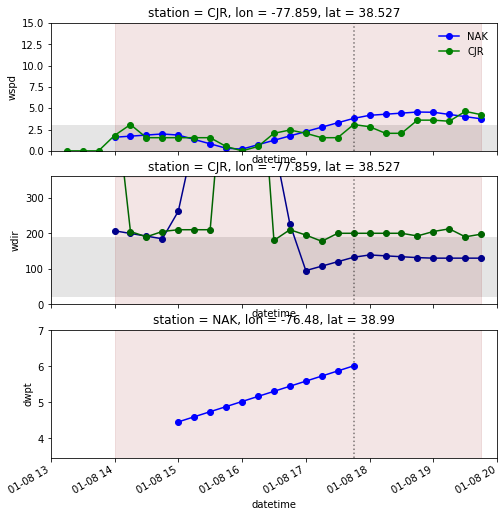

bay breeze validated for 1/23/2019


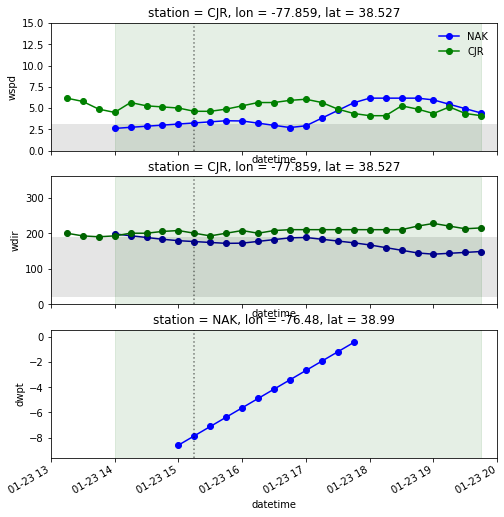

Unable to fill...
Unable to draw line...


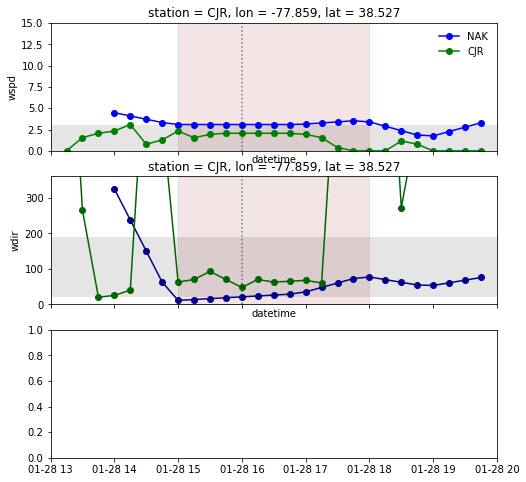

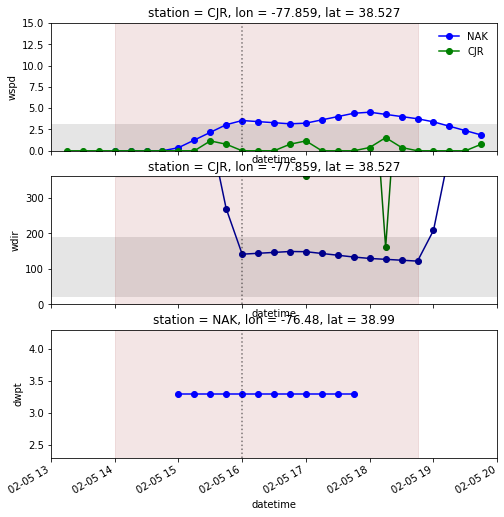

bay breeze validated for 2/10/2019


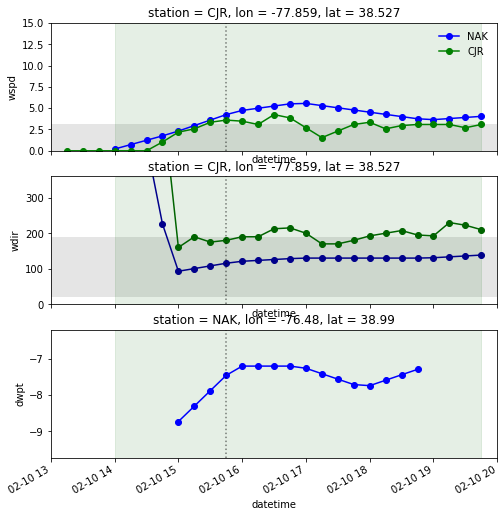

bay breeze validated for 2/14/2019


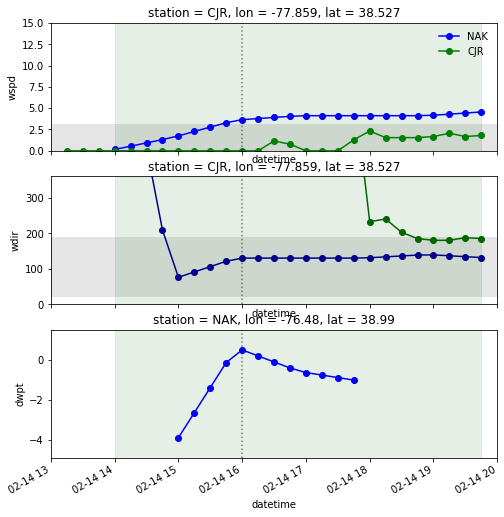

Unable to fill...
Unable to draw line...


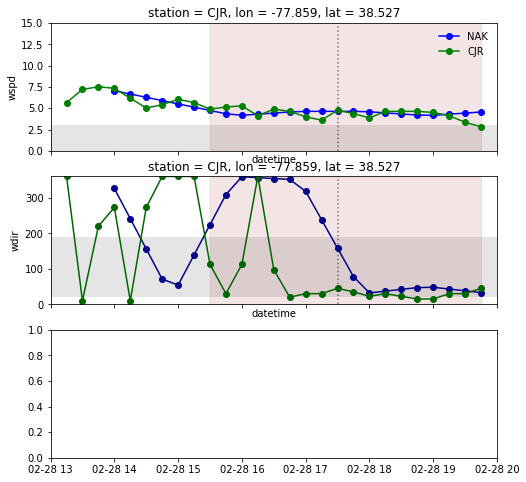

bay breeze validated for 3/5/2019


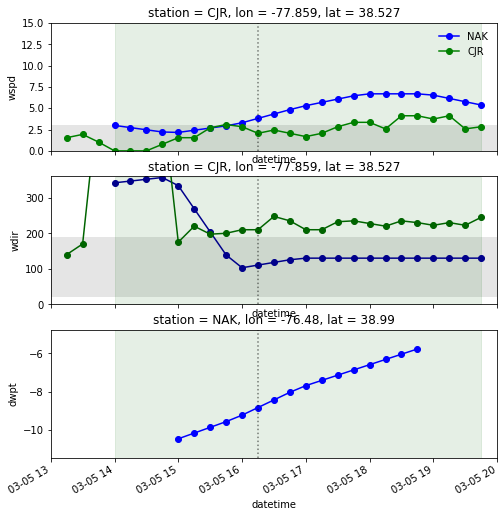

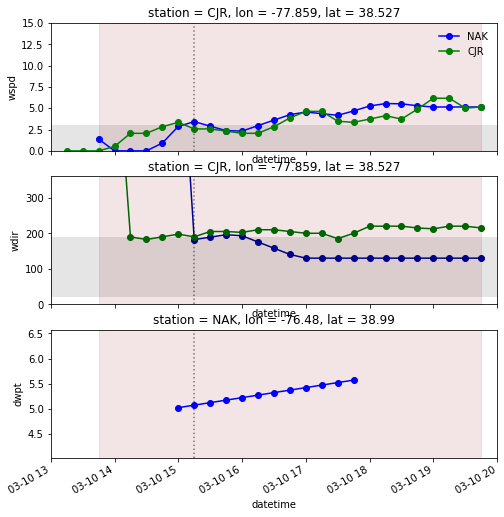

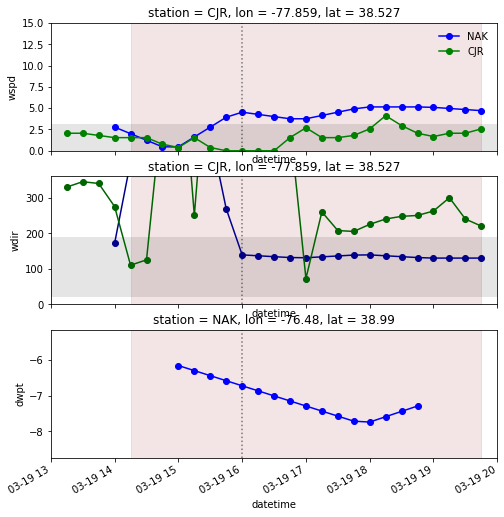

bay breeze validated for 3/24/2019


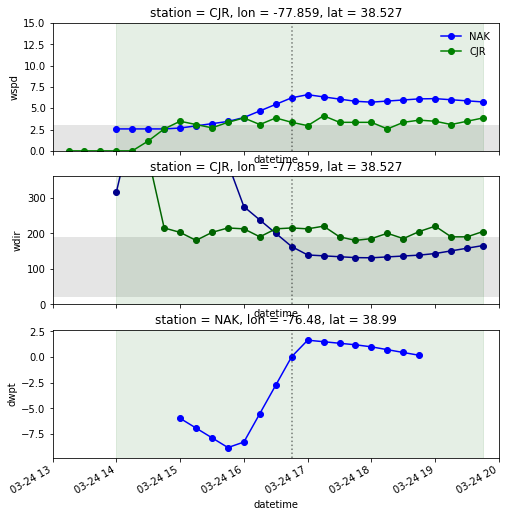

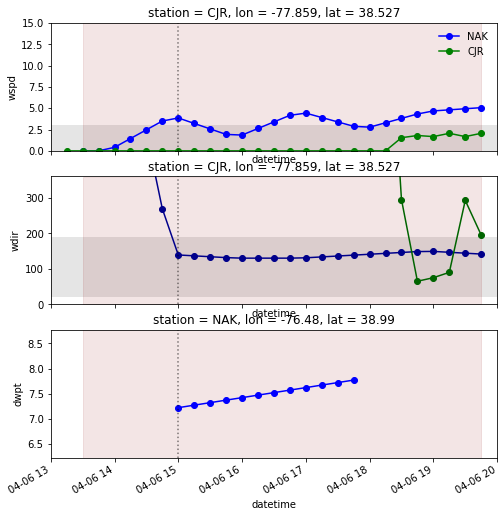

bay breeze validated for 4/13/2019


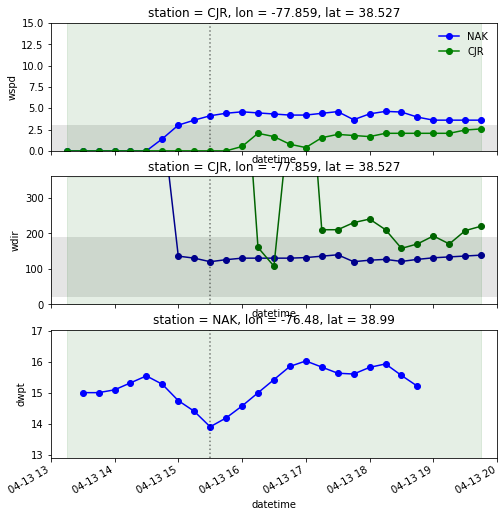

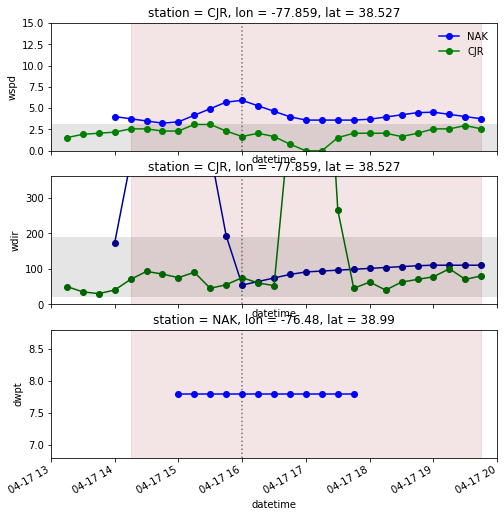

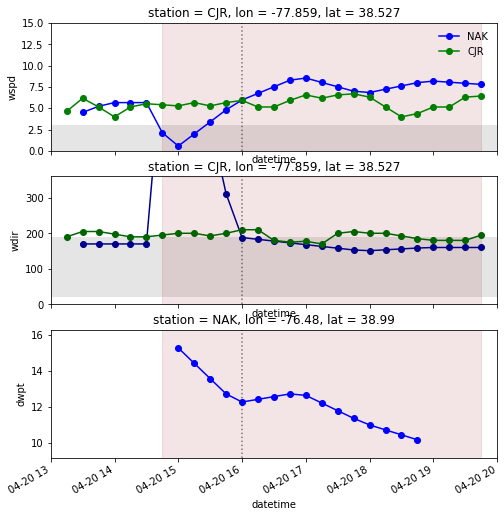

bay breeze validated for 4/21/2019


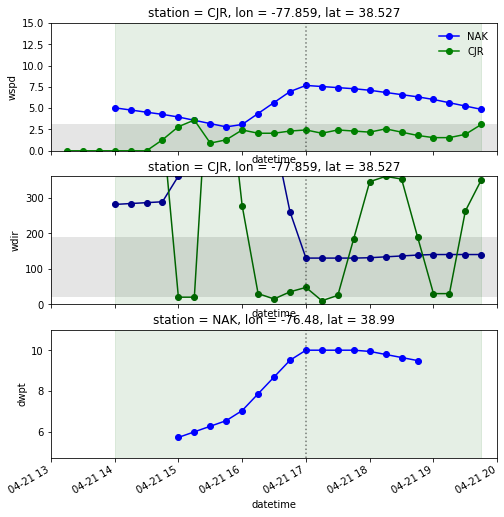

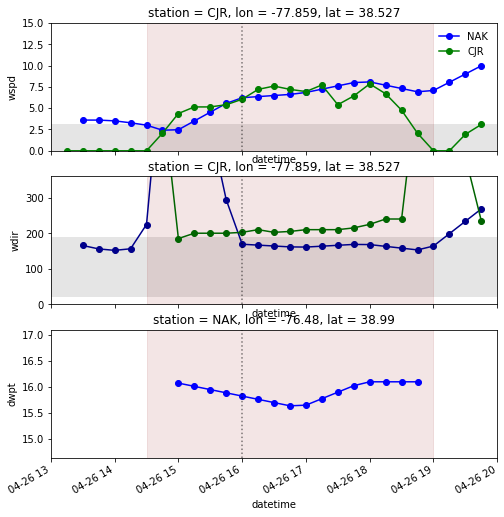

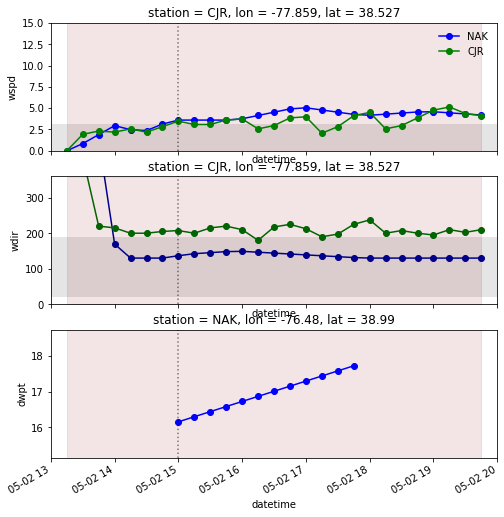

bay breeze validated for 5/6/2019


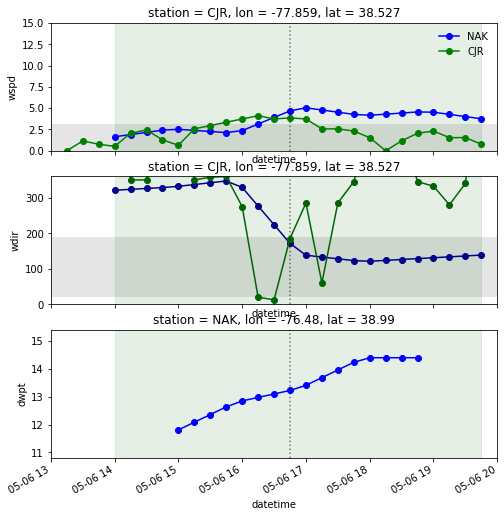

bay breeze validated for 5/23/2019


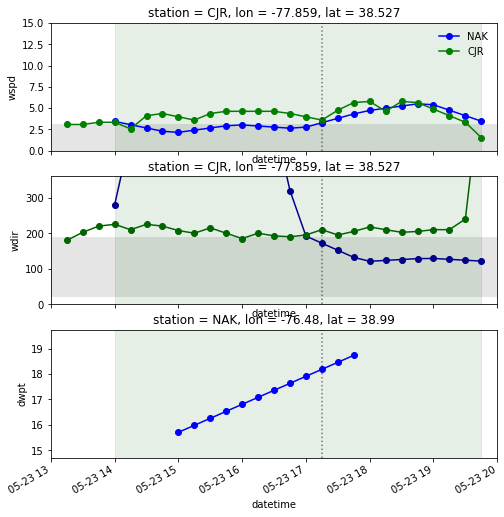

bay breeze validated for 5/30/2019


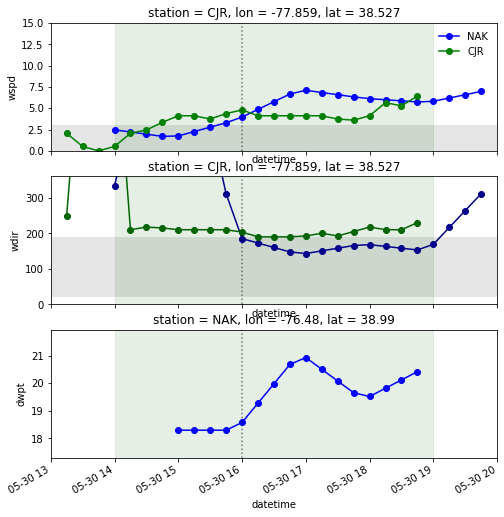

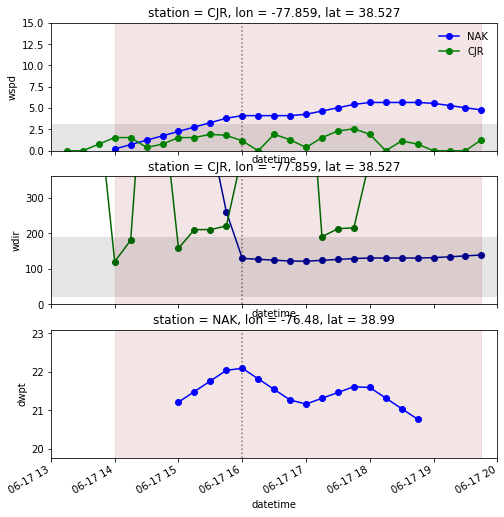

bay breeze validated for 6/19/2019


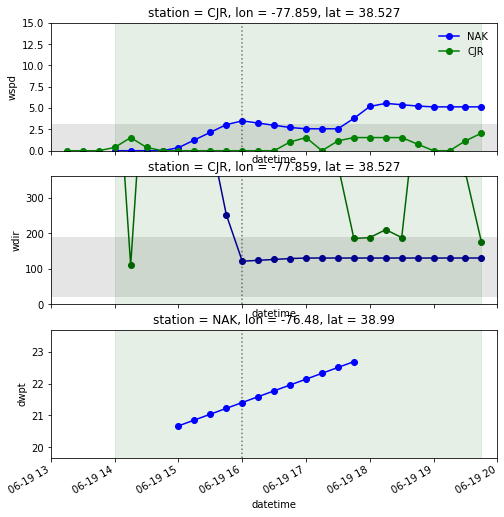

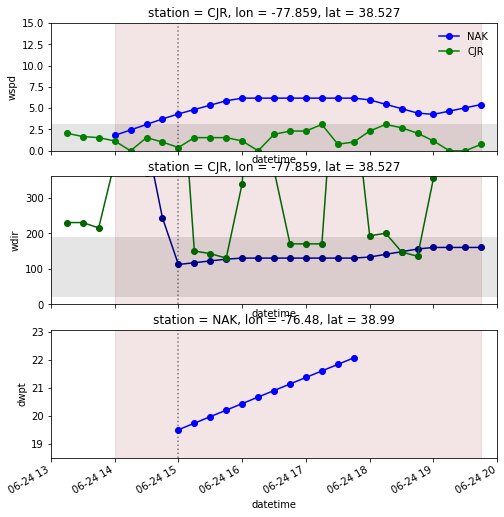

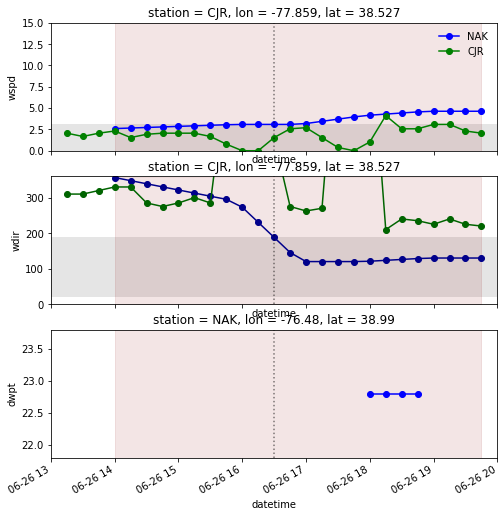

bay breeze validated for 6/27/2019


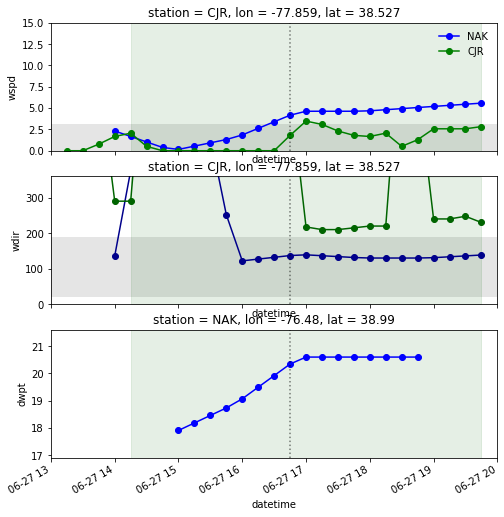

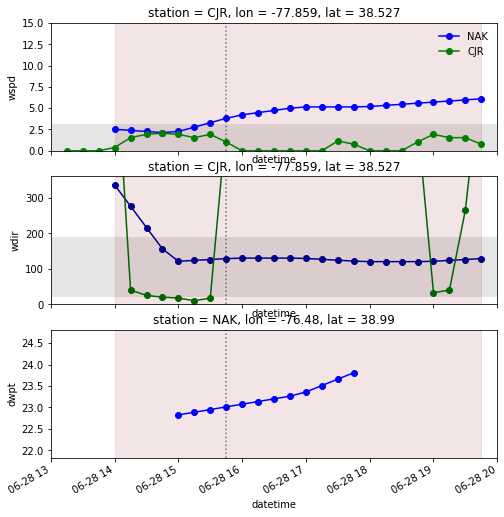

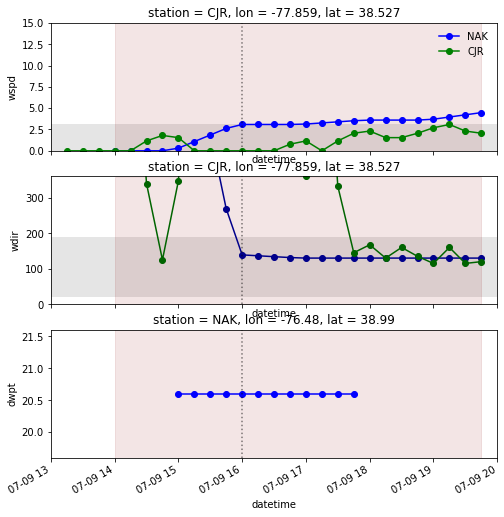

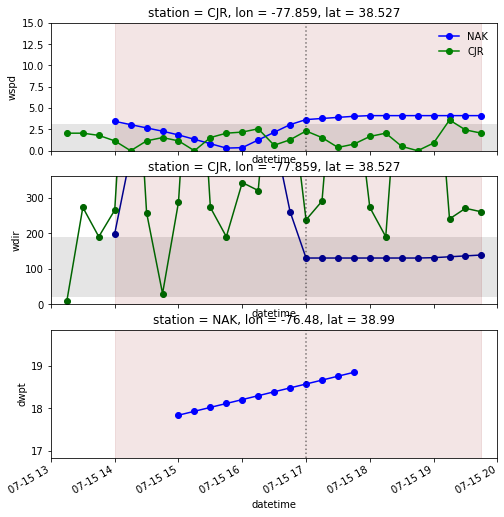

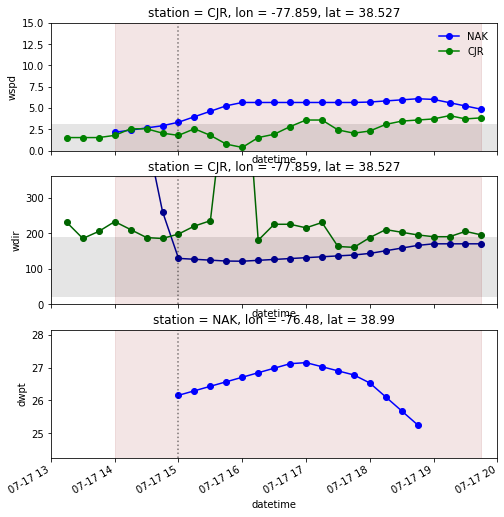

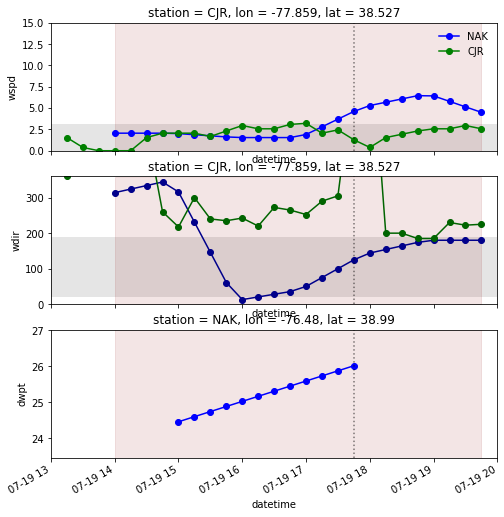

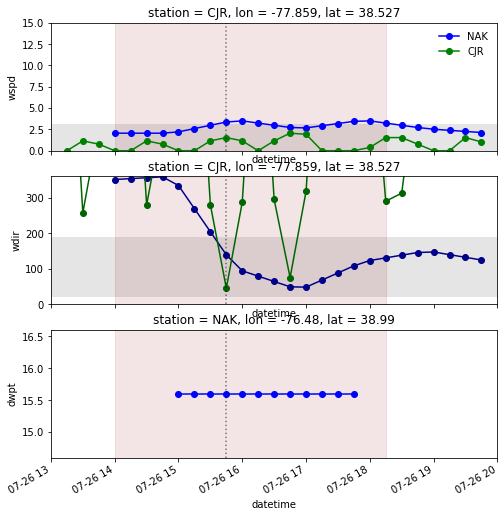

bay breeze validated for 7/28/2019


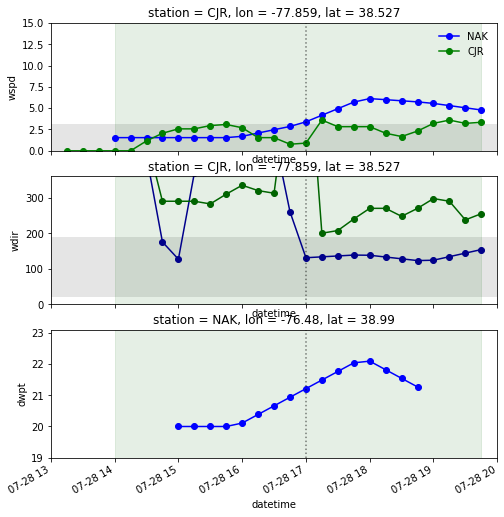

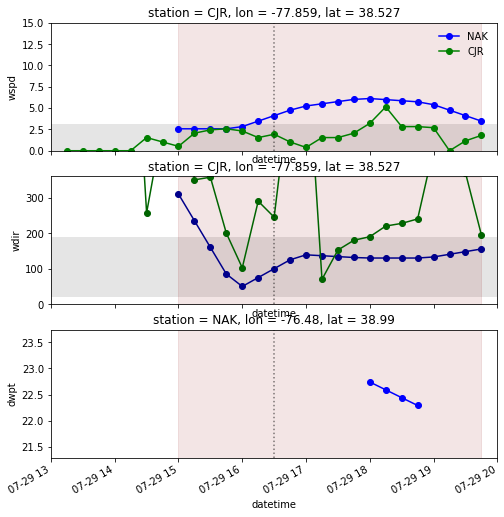

Unable to fill...
Unable to draw line...


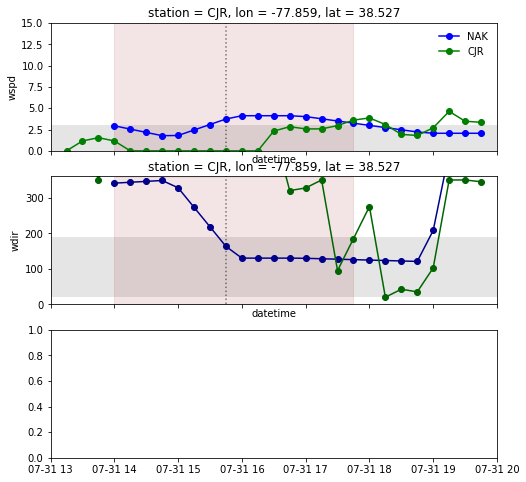

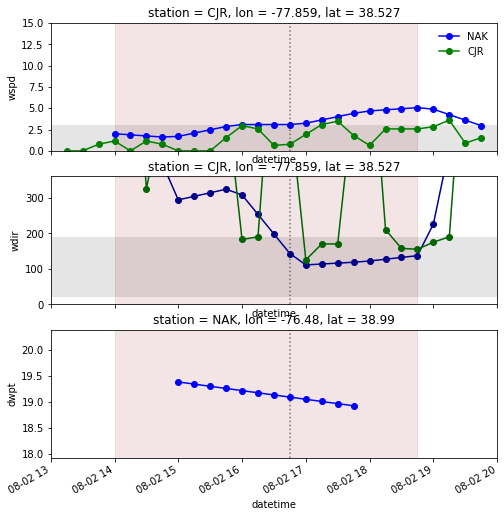

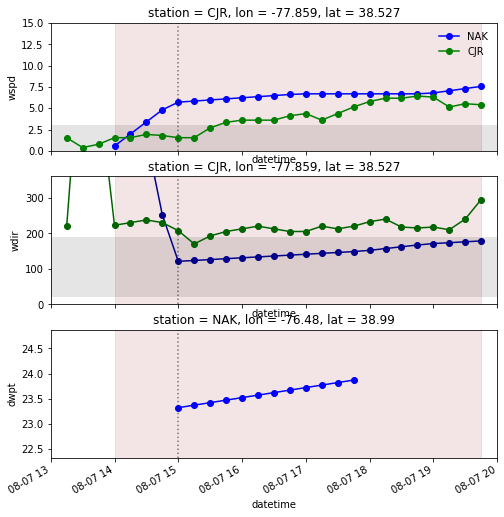

bay breeze validated for 8/11/2019


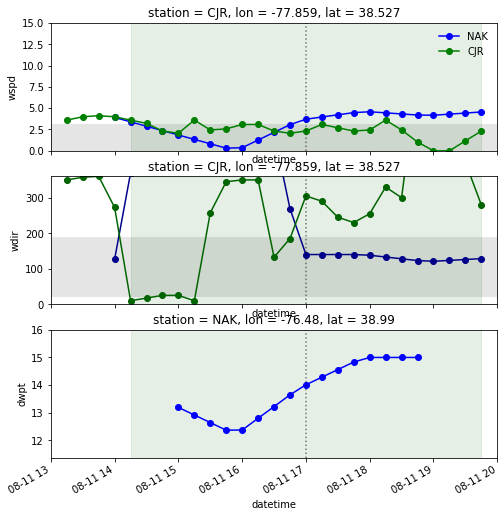

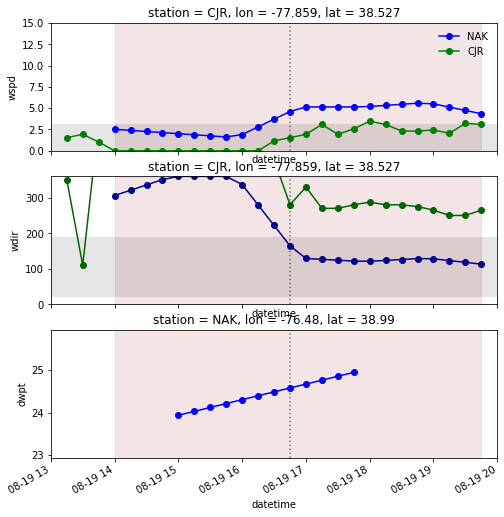

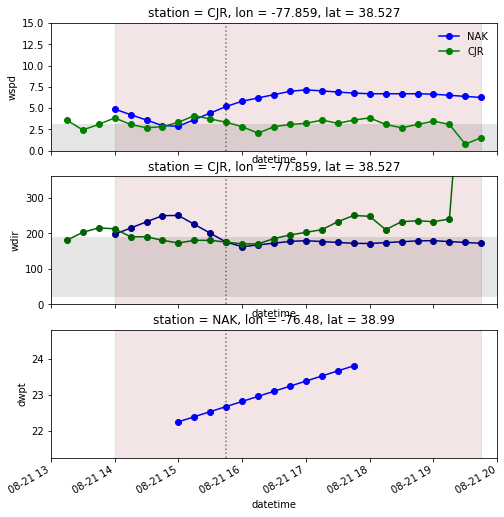

bay breeze validated for 9/7/2019


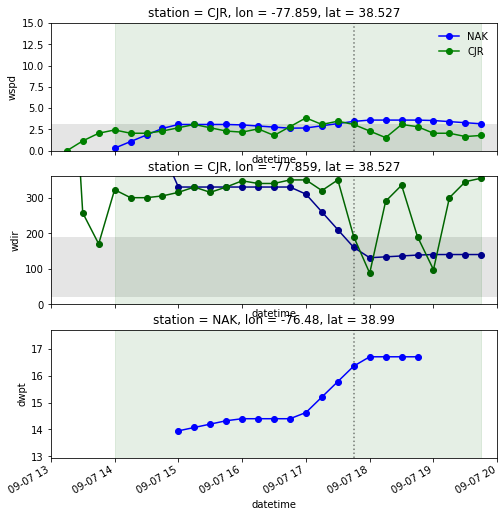

bay breeze validated for 9/8/2019


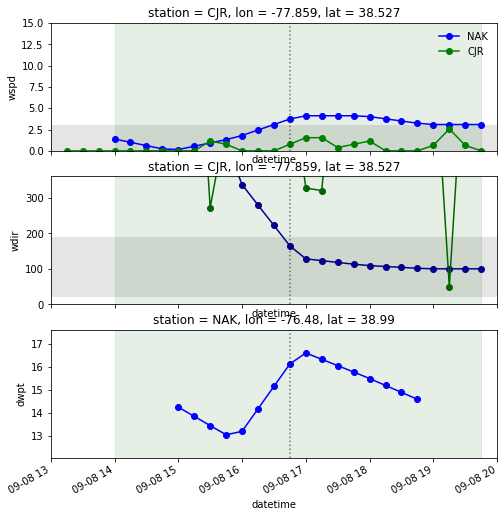

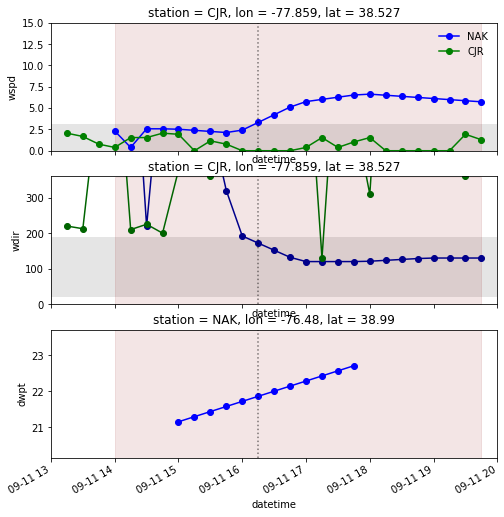

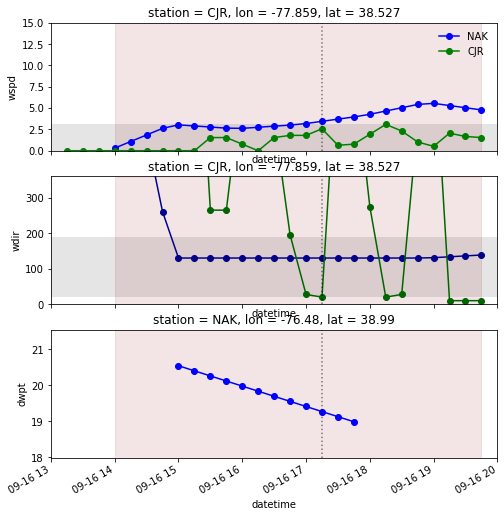

Unable to fill...
Unable to draw line...


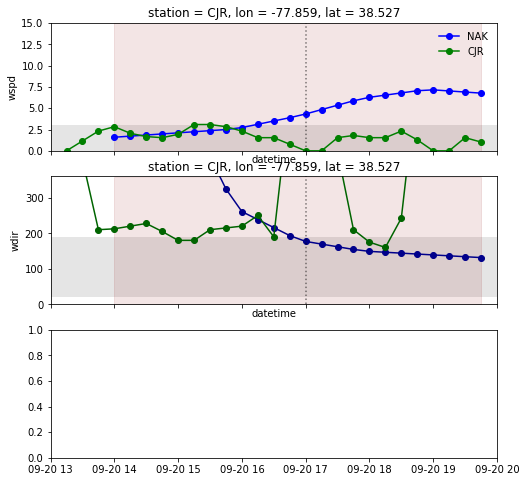

bay breeze validated for 9/21/2019


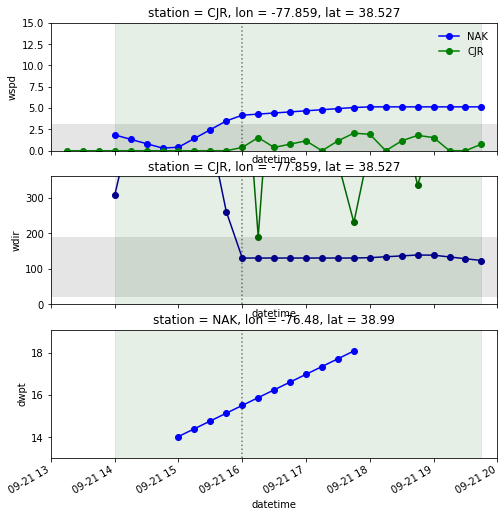

bay breeze validated for 9/23/2019


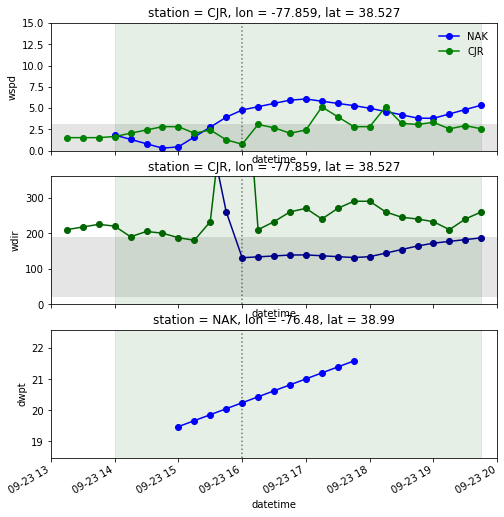

bay breeze validated for 9/25/2019


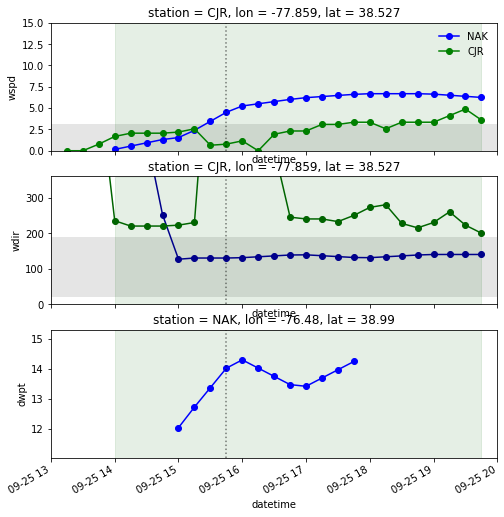

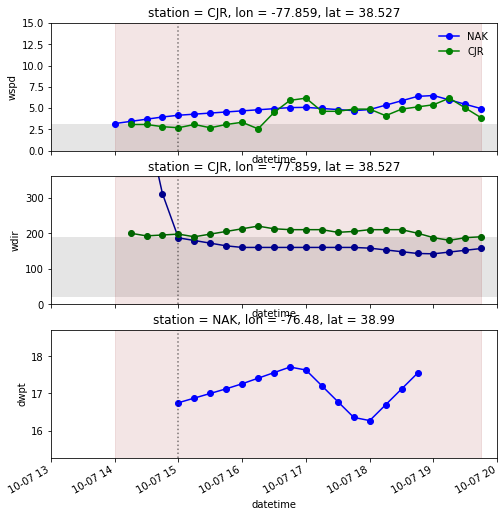

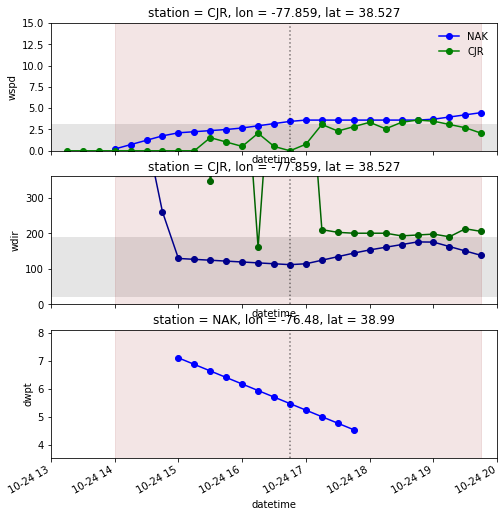

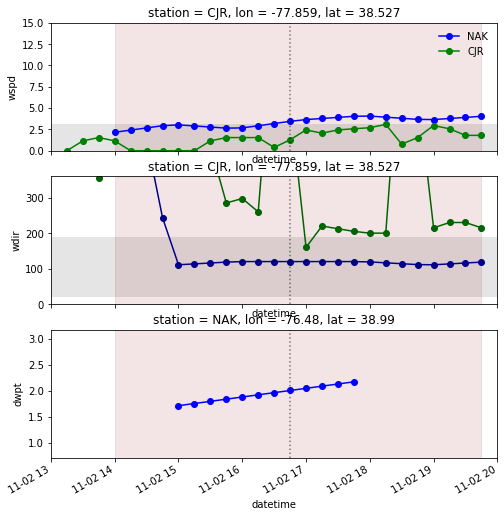

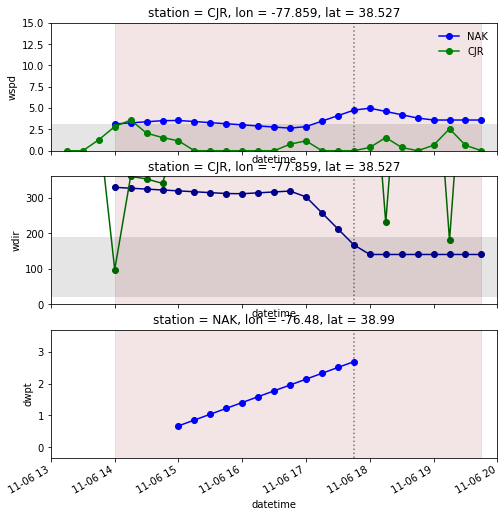

bay breeze validated for 11/10/2019


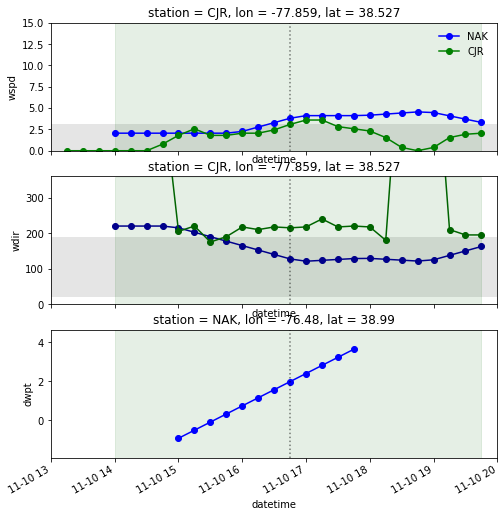

bay breeze validated for 11/11/2019


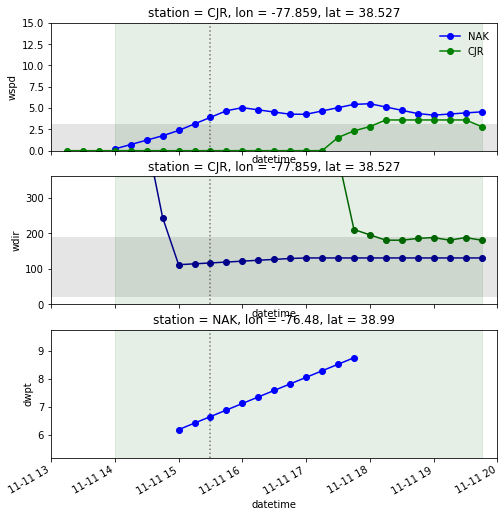

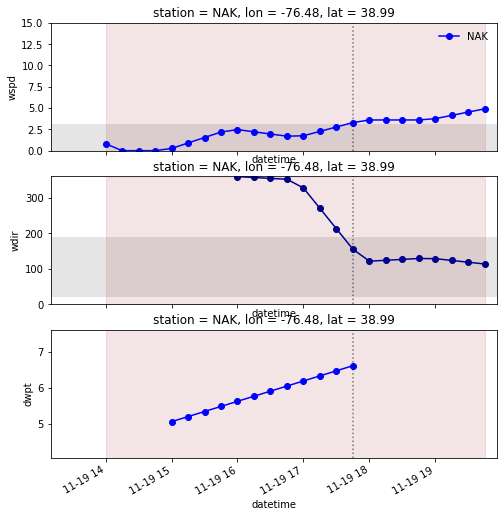

bay breeze validated for 11/25/2019


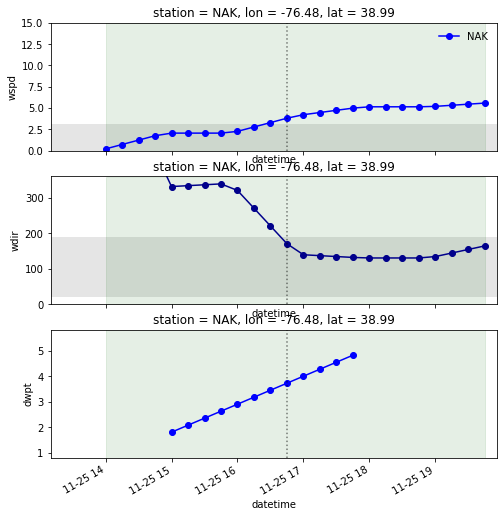

bay breeze validated for 11/26/2019


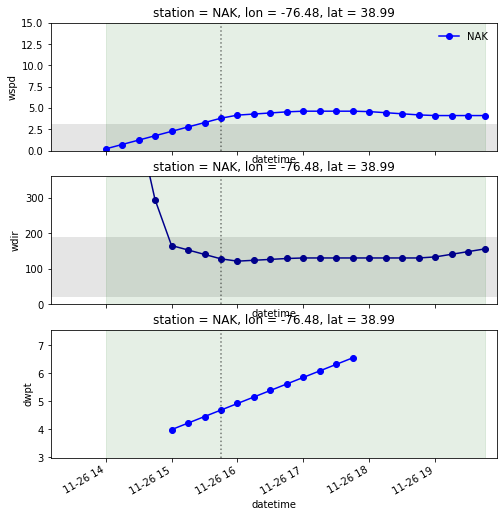

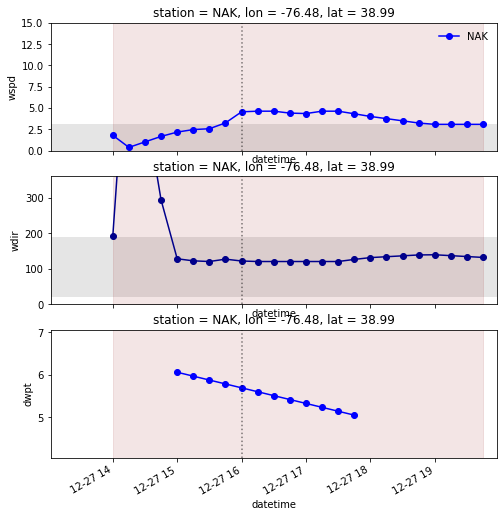

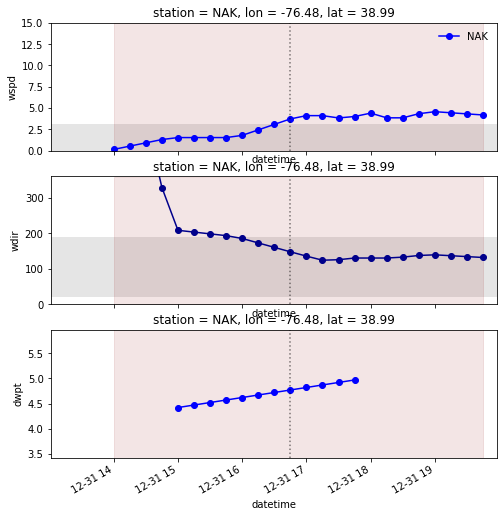

starting station: NHK
Year: 2019


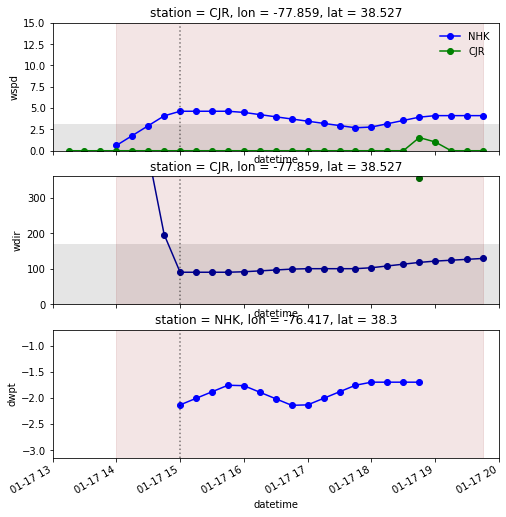

bay breeze validated for 2/2/2019


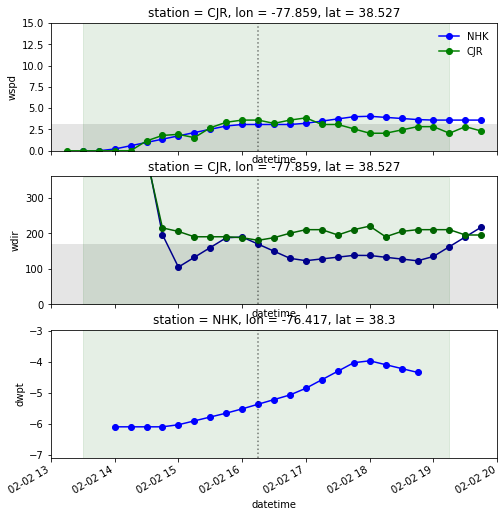

bay breeze validated for 2/10/2019


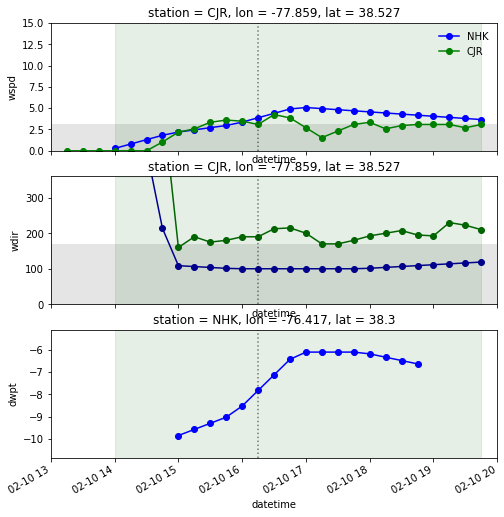

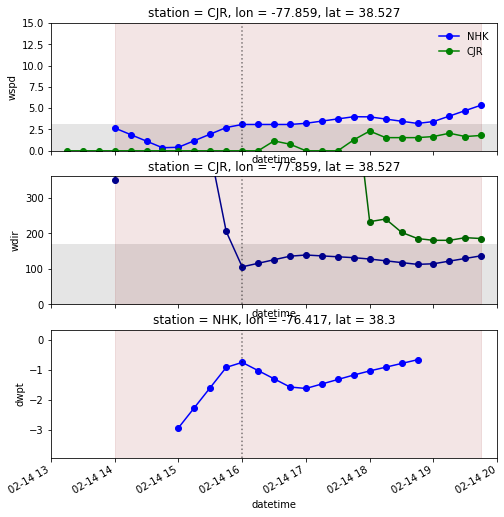

bay breeze validated for 2/16/2019


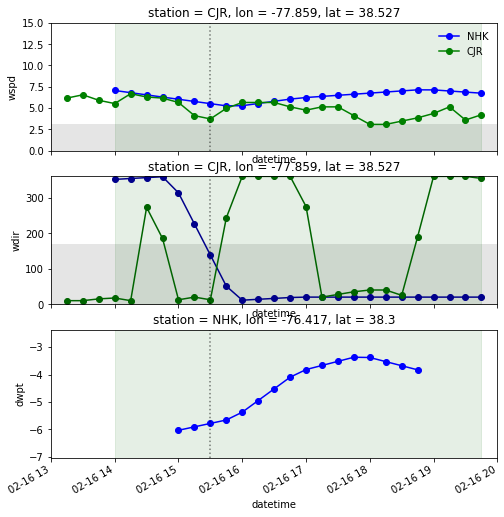

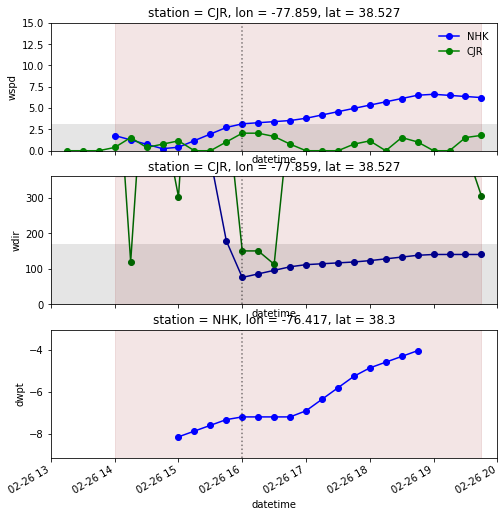

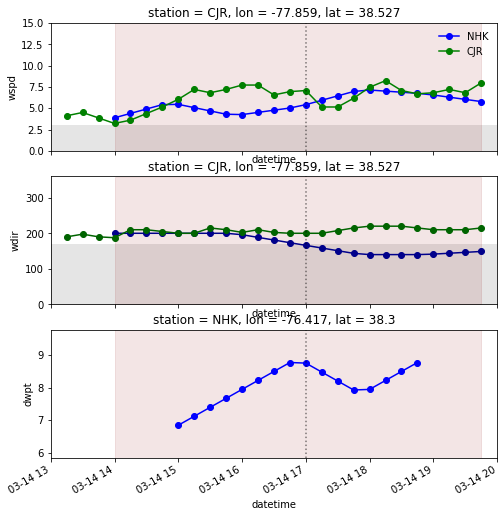

bay breeze validated for 3/17/2019


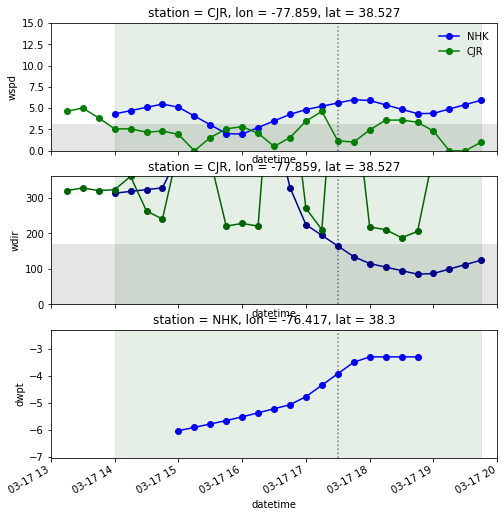

bay breeze validated for 3/24/2019


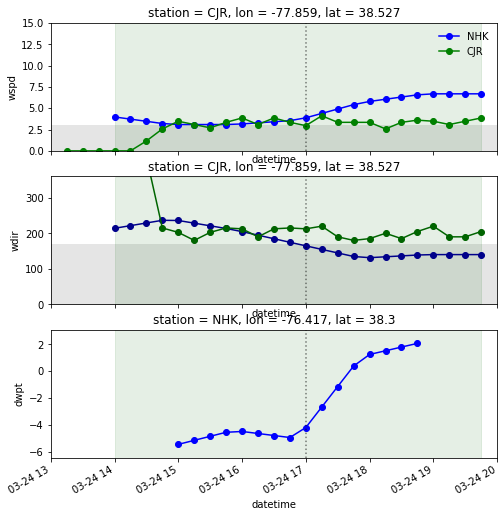

bay breeze validated for 3/29/2019


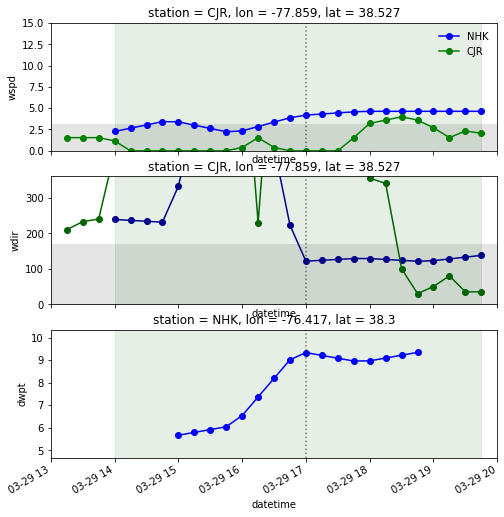

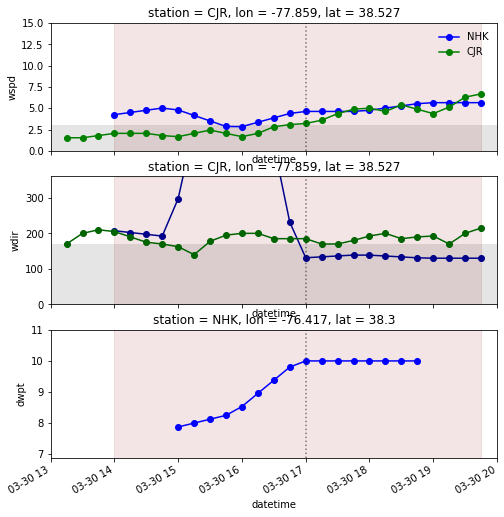

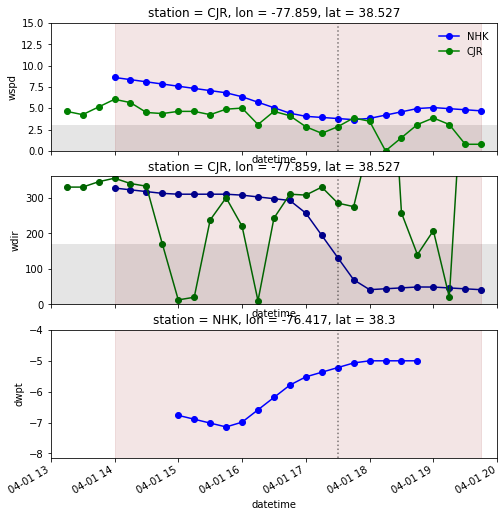

bay breeze validated for 4/10/2019


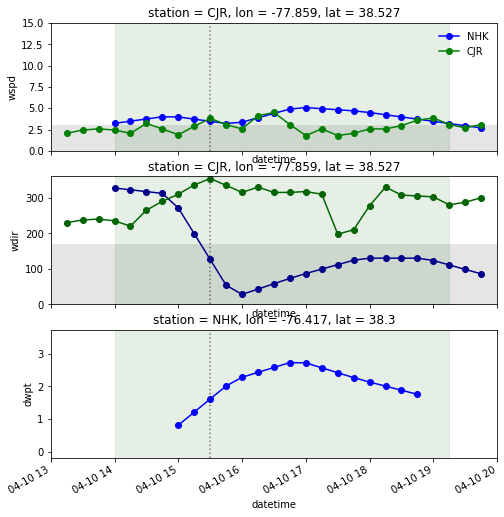

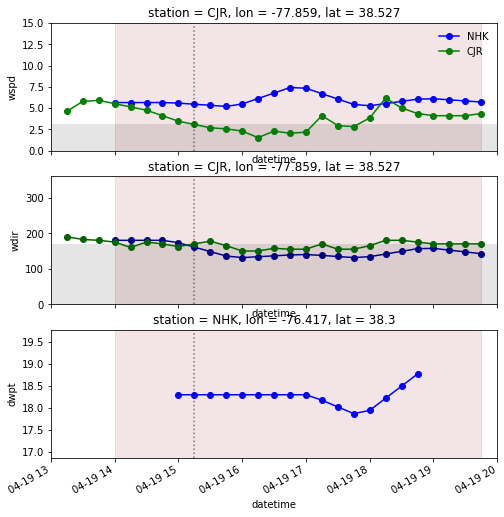

bay breeze validated for 4/21/2019


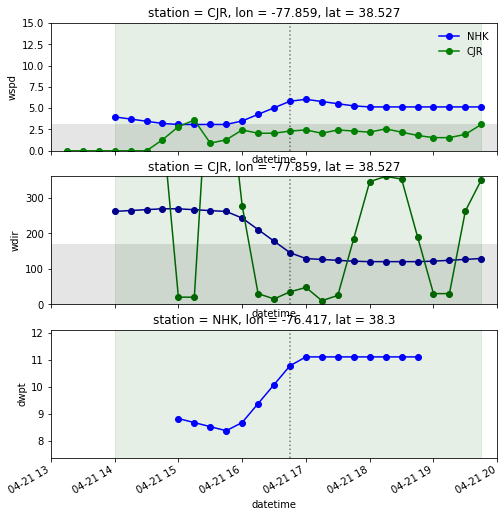

bay breeze validated for 4/26/2019


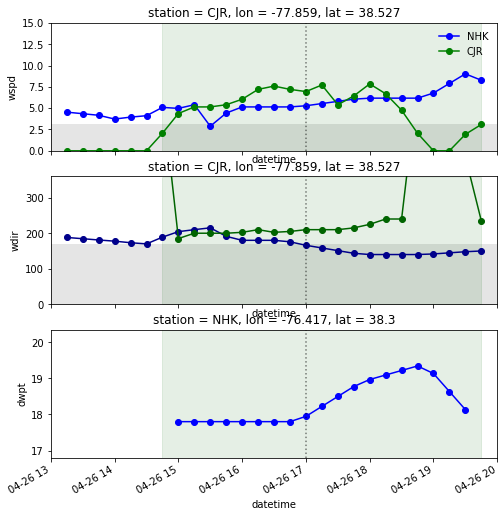

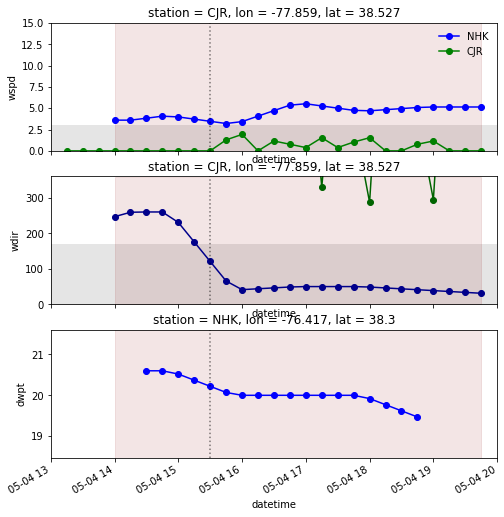

bay breeze validated for 5/7/2019


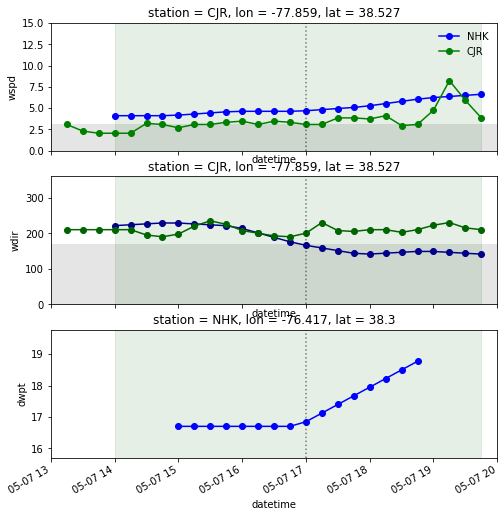

bay breeze validated for 5/16/2019


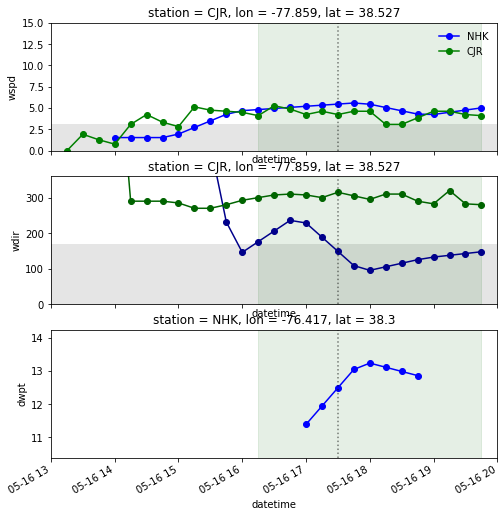

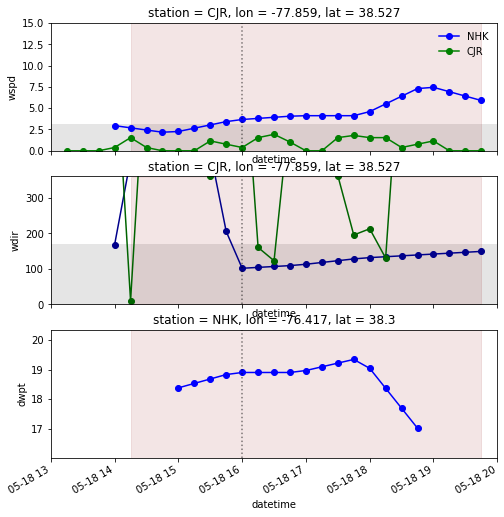

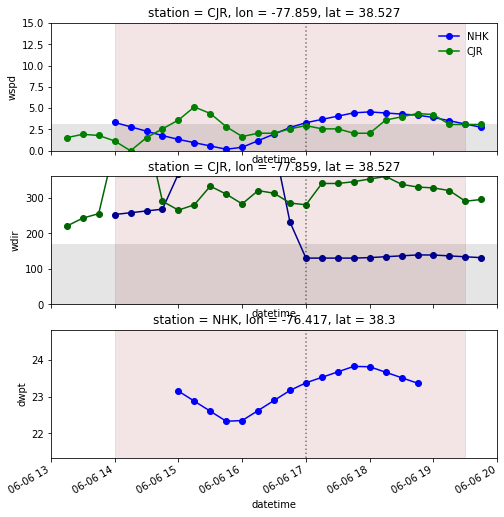

bay breeze validated for 6/17/2019


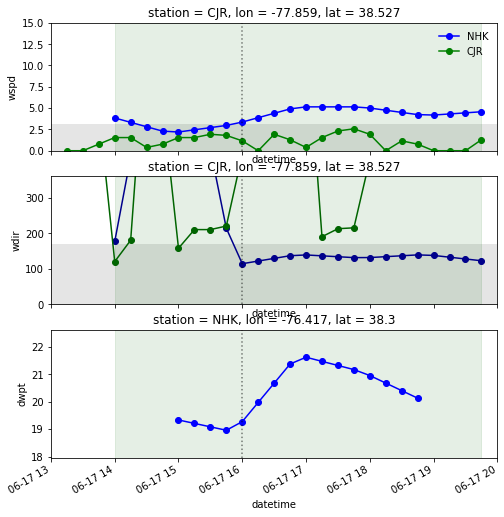

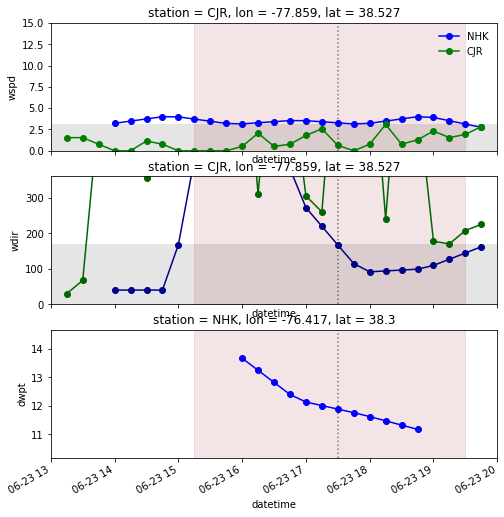

bay breeze validated for 6/24/2019


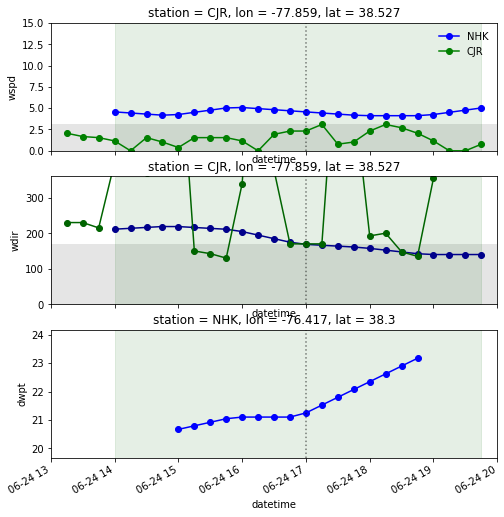

bay breeze validated for 6/28/2019


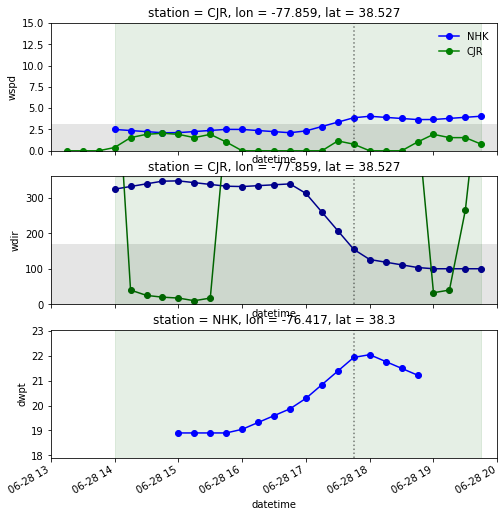

bay breeze validated for 7/10/2019


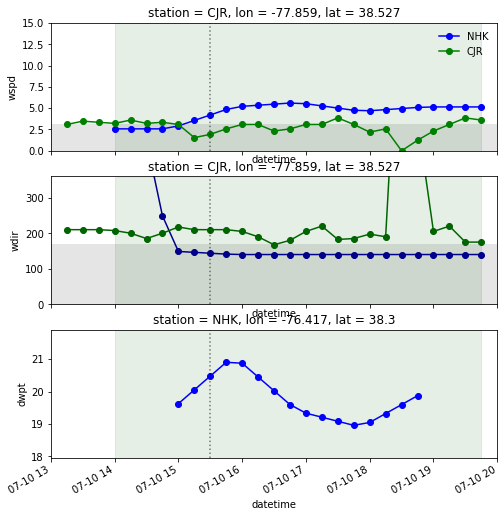

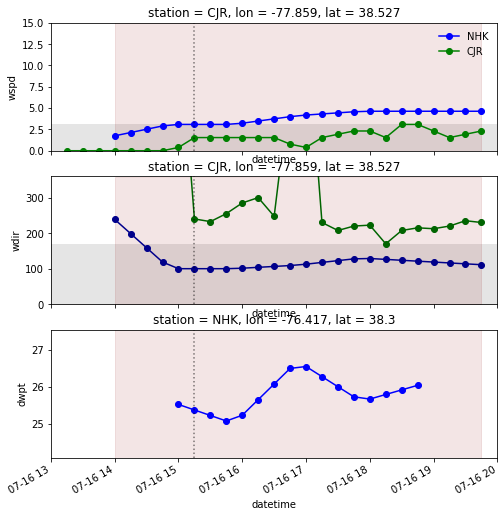

bay breeze validated for 7/19/2019


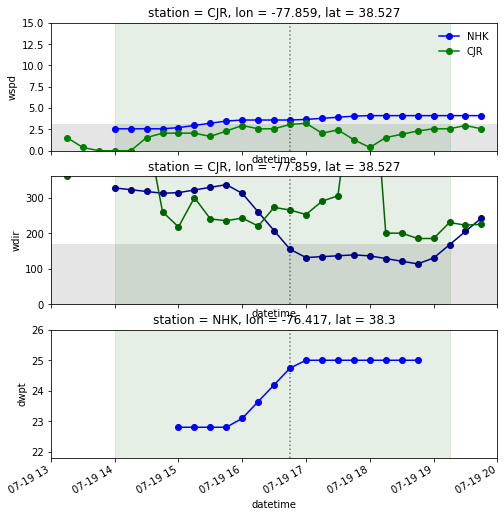

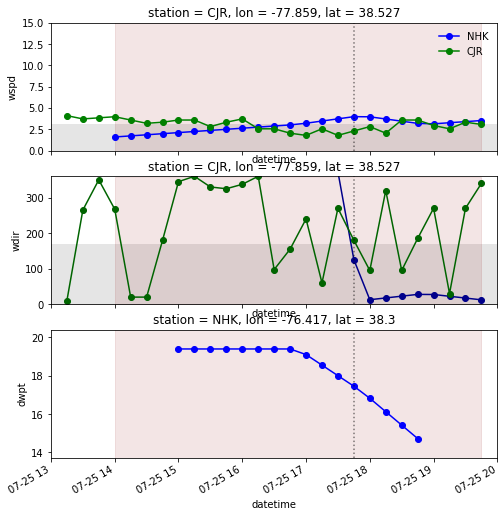

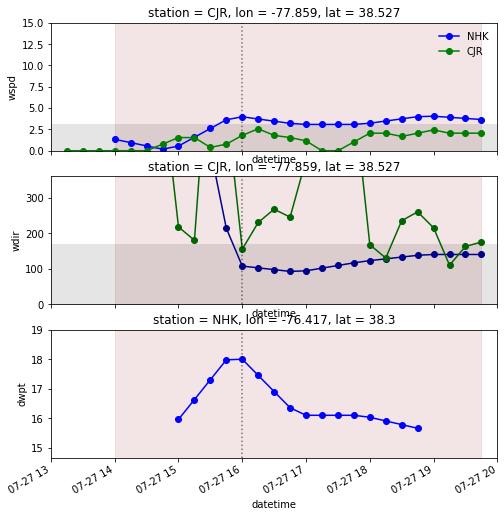

bay breeze validated for 7/28/2019


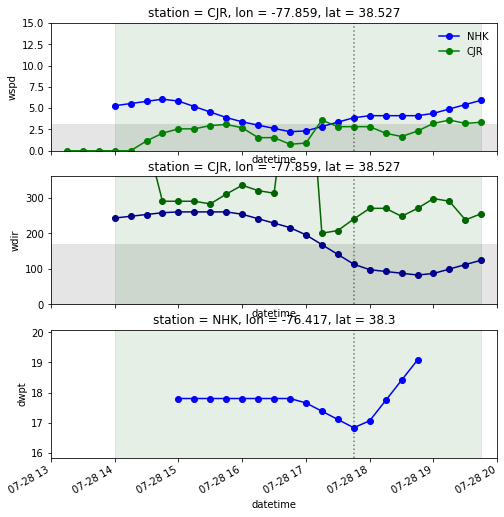

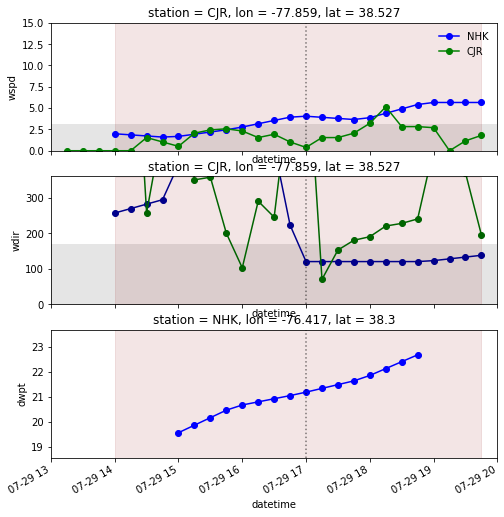

bay breeze validated for 7/30/2019


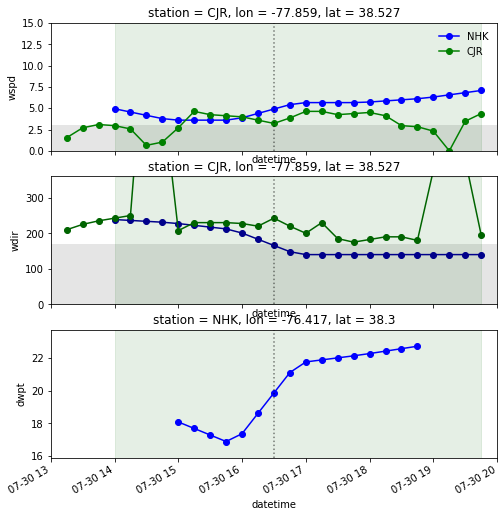

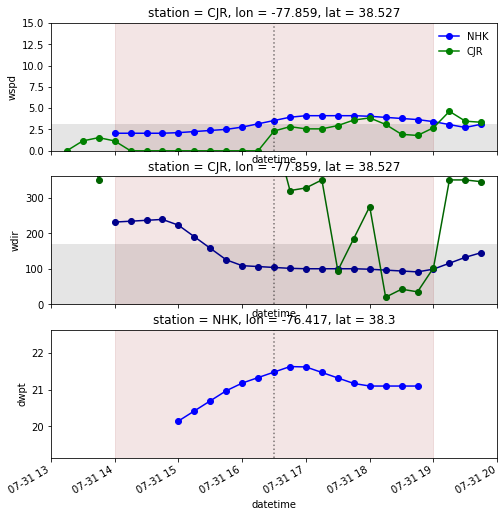

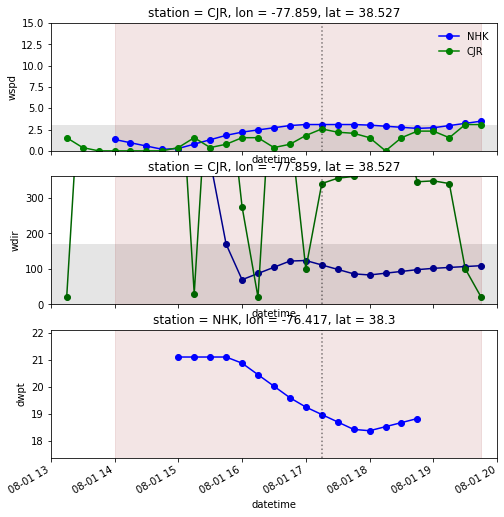

bay breeze validated for 8/2/2019


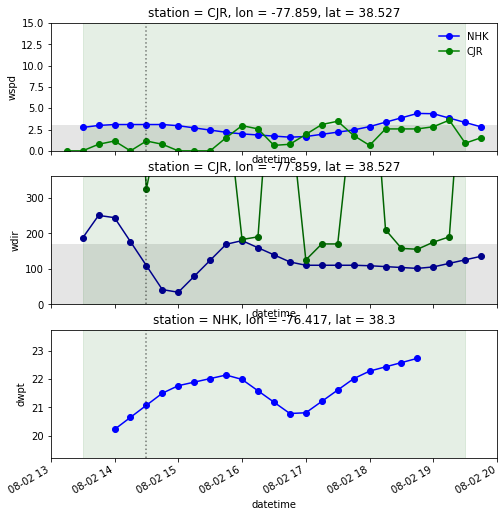

bay breeze validated for 8/14/2019


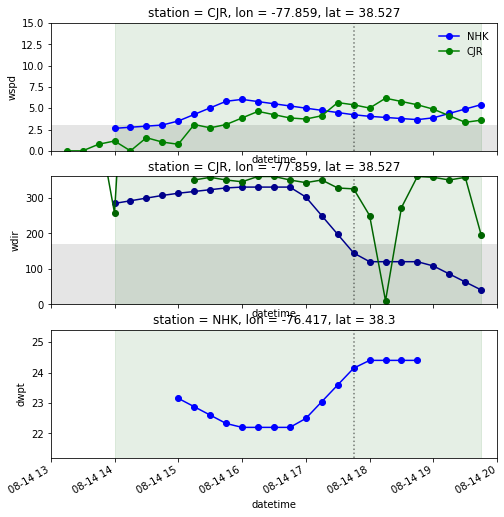

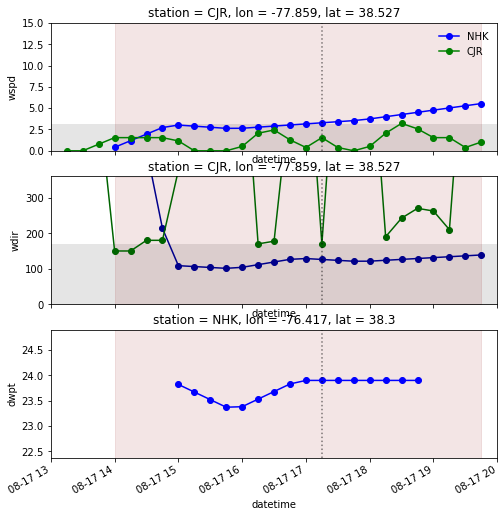

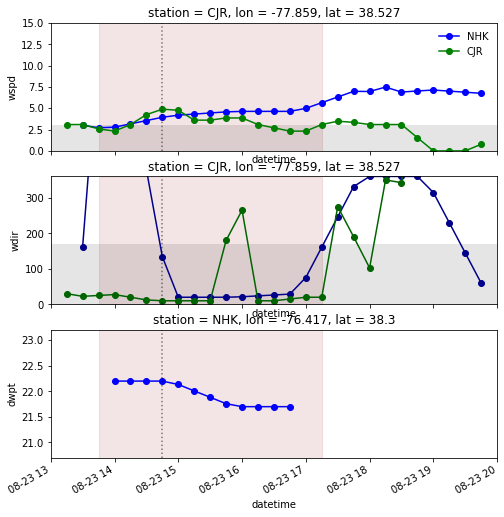

bay breeze validated for 9/16/2019


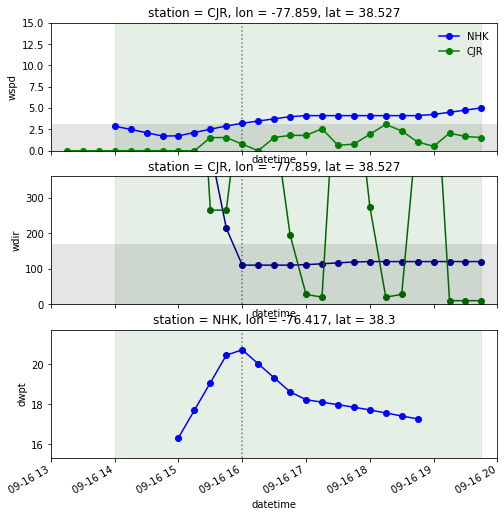

bay breeze validated for 9/20/2019


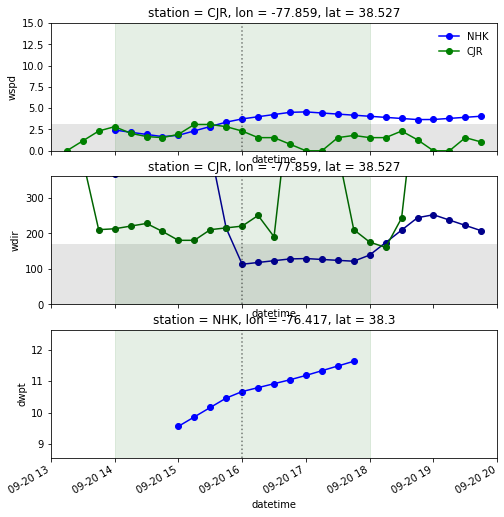

bay breeze validated for 9/21/2019


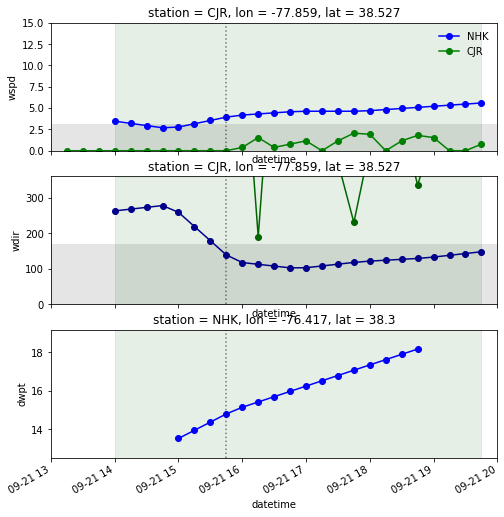

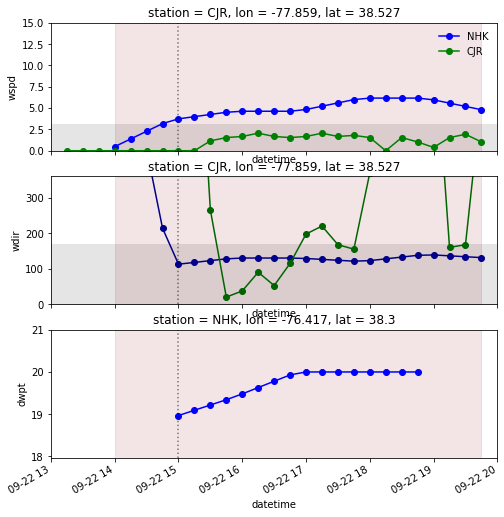

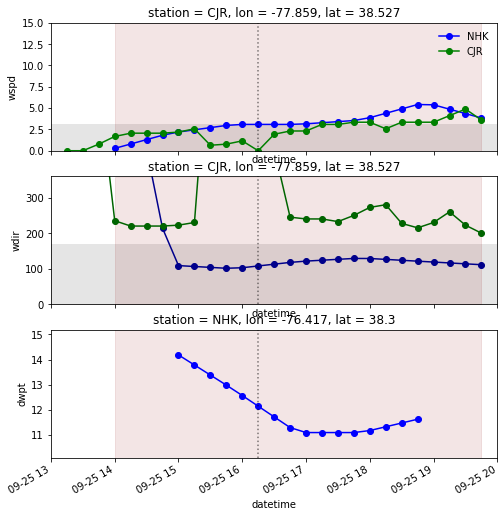

bay breeze validated for 10/1/2019


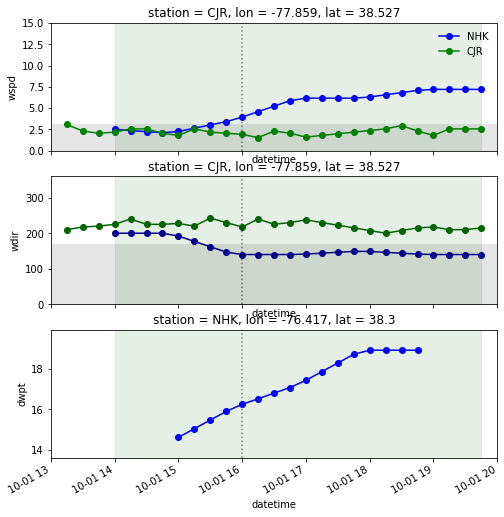

bay breeze validated for 10/7/2019


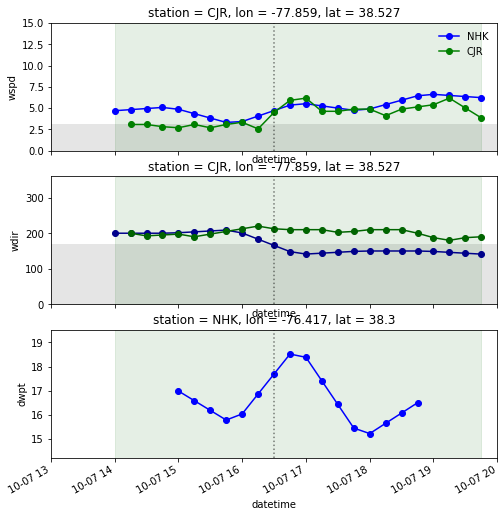

bay breeze validated for 10/11/2019


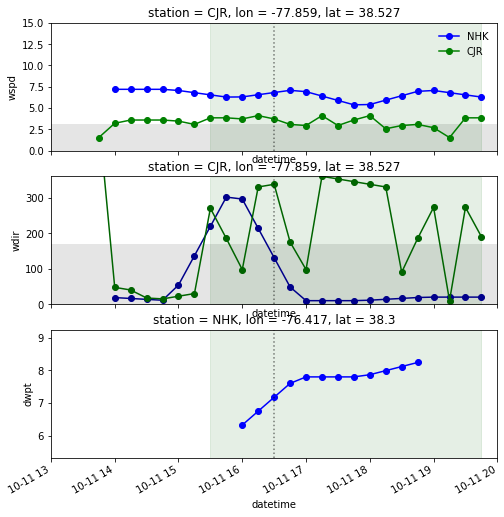

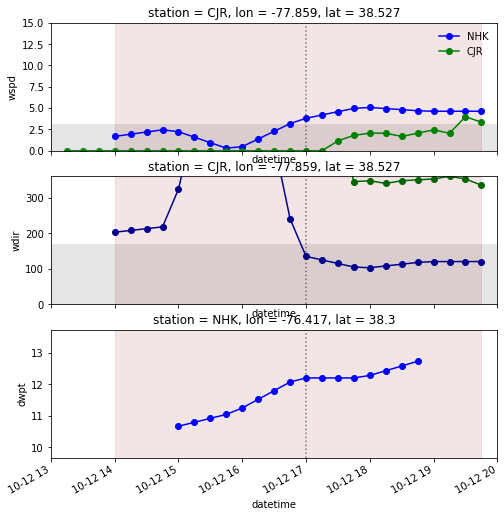

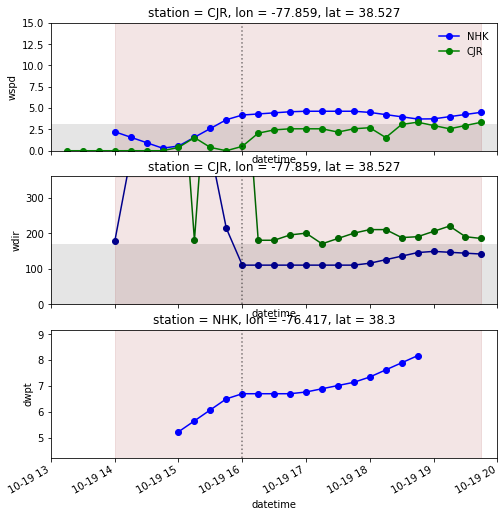

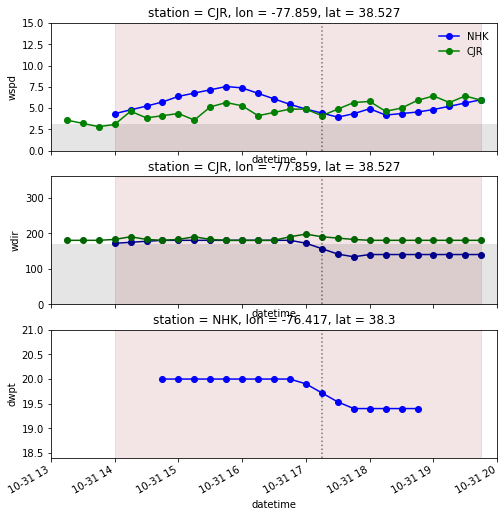

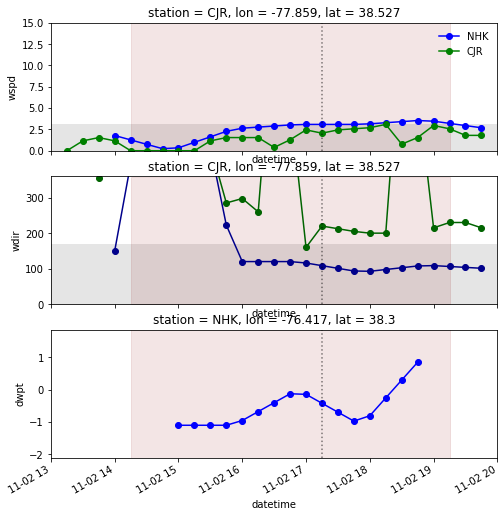

bay breeze validated for 11/6/2019


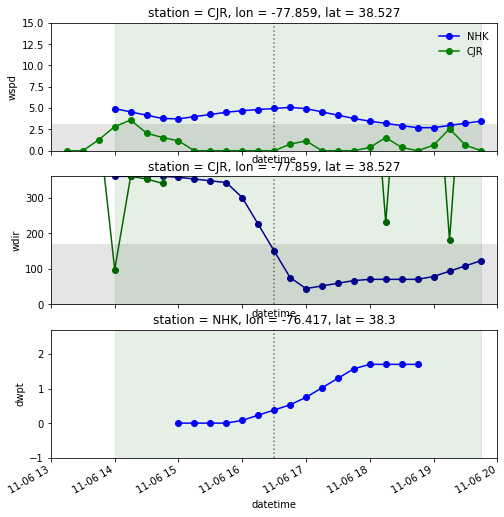

bay breeze validated for 11/11/2019


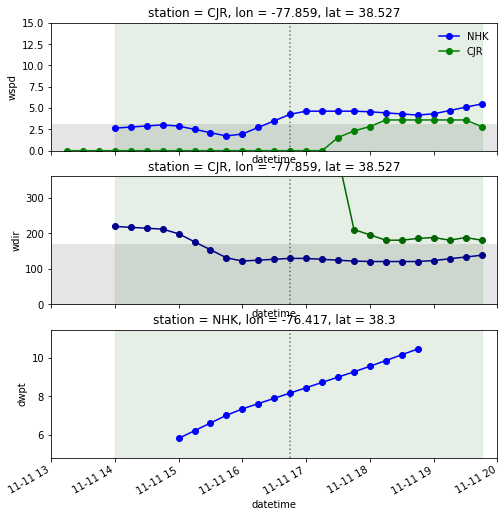

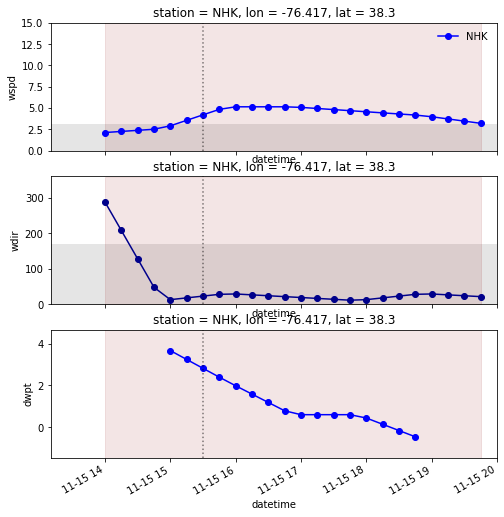

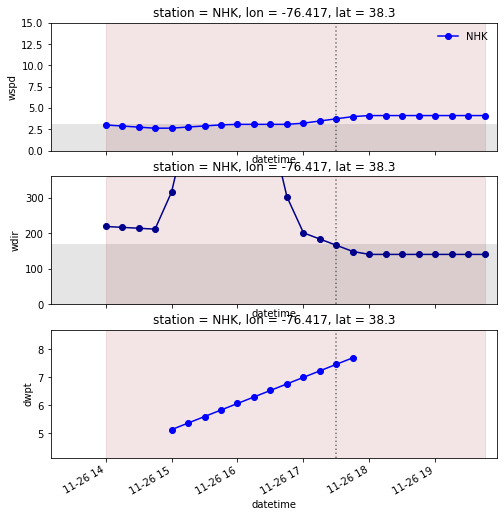

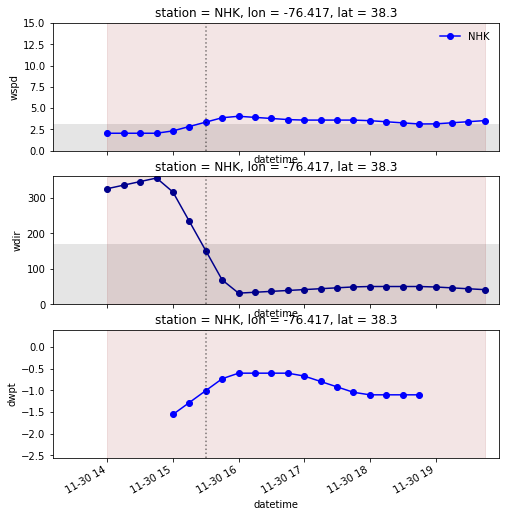

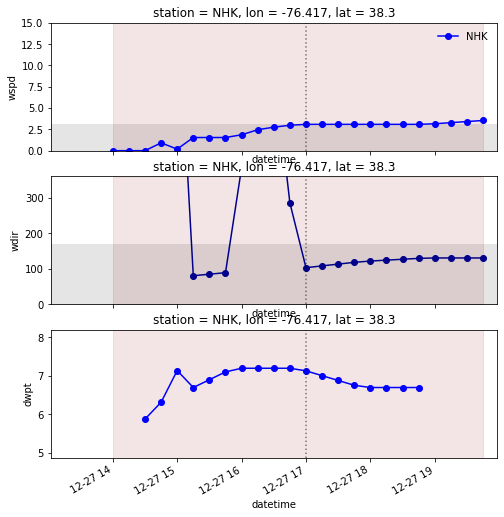

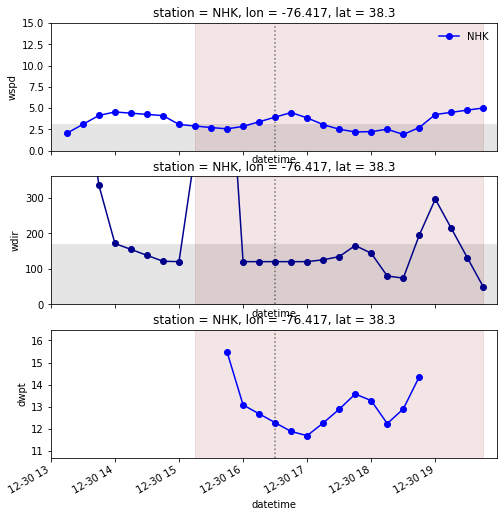

starting station: NUI
Year: 2019


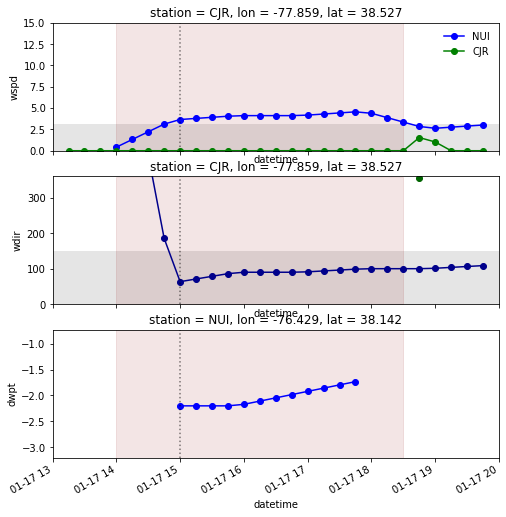

bay breeze validated for 2/16/2019


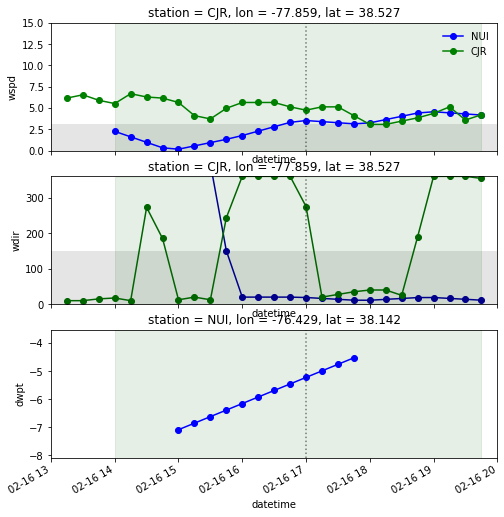

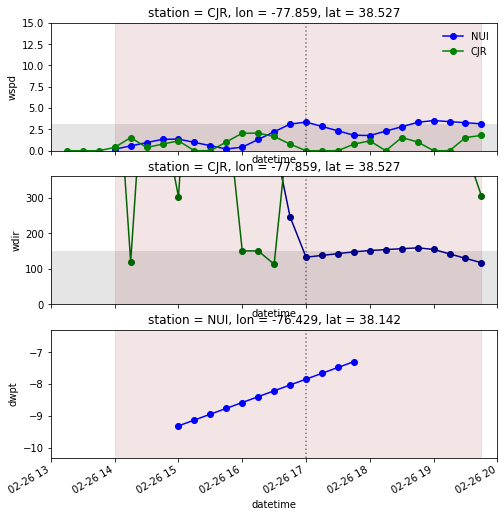

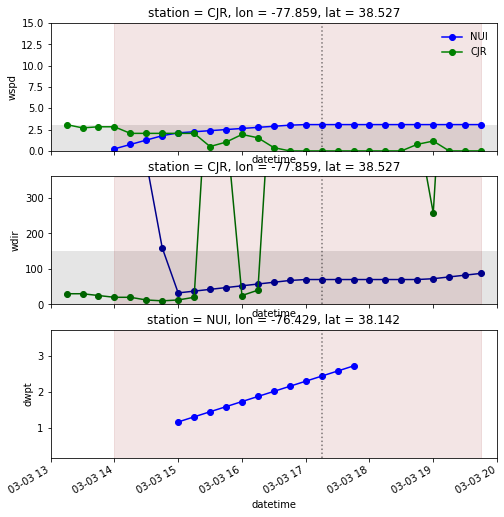

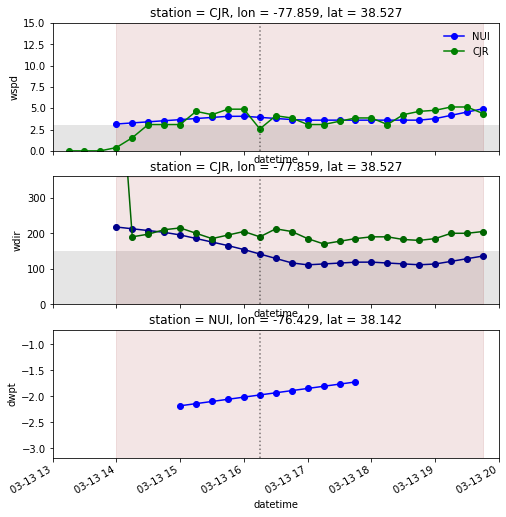

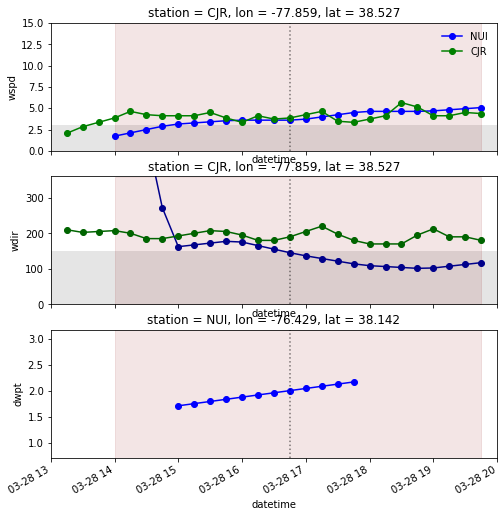

Unable to fill...
Unable to draw line...


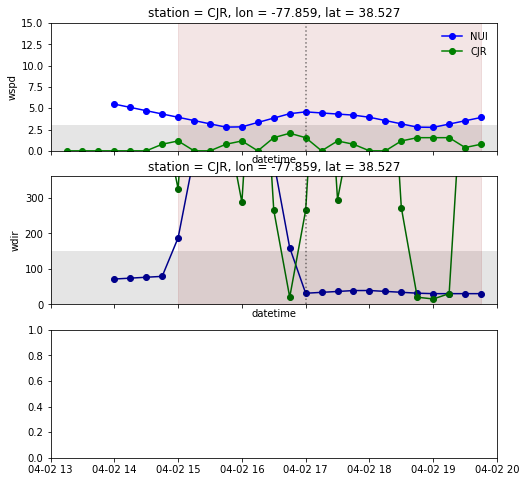

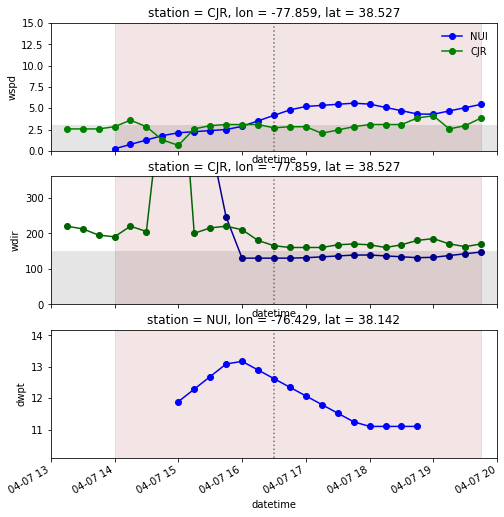

Unable to fill...
Unable to draw line...


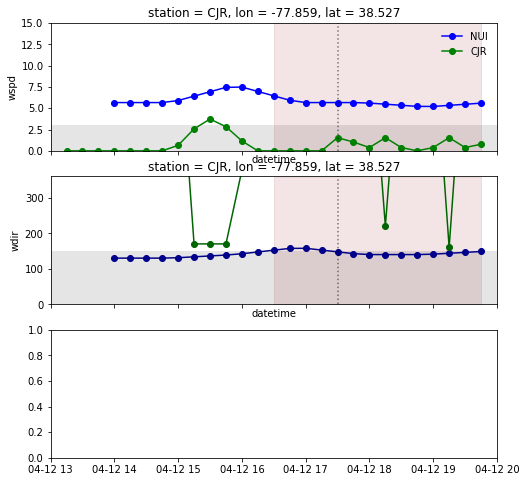

bay breeze validated for 4/17/2019


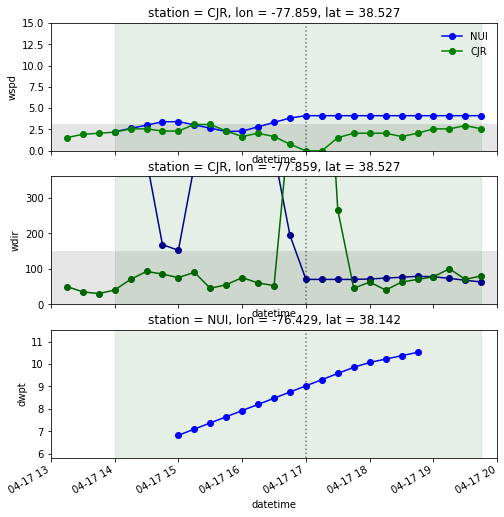

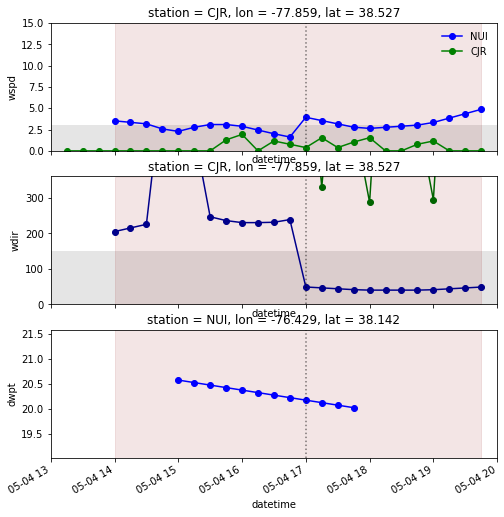

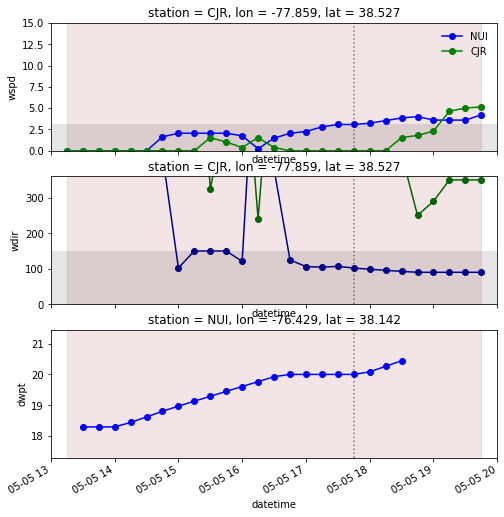

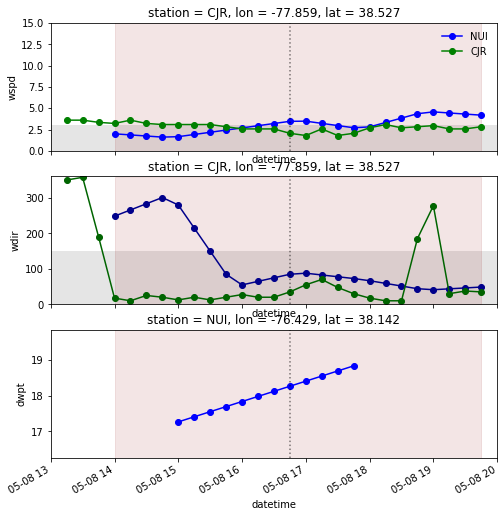

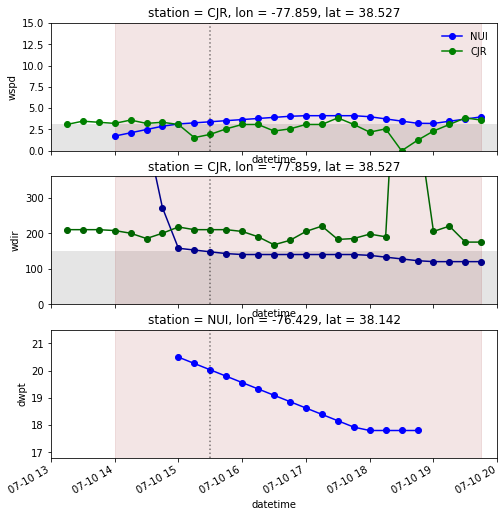

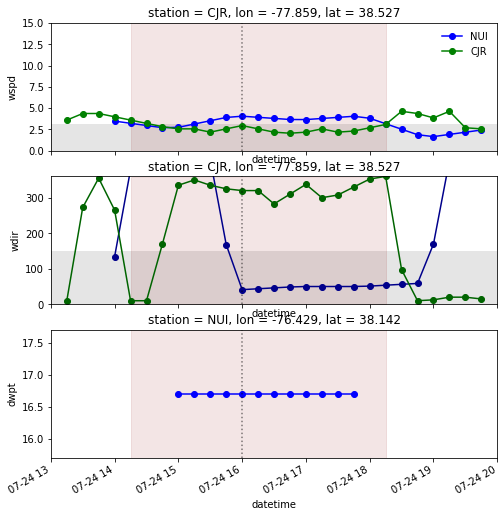

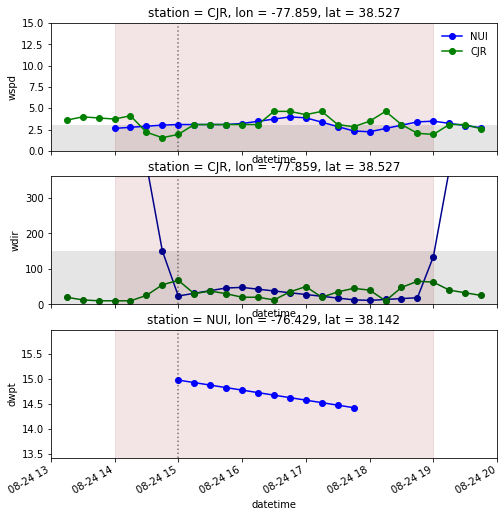

Unable to fill...
Unable to draw line...


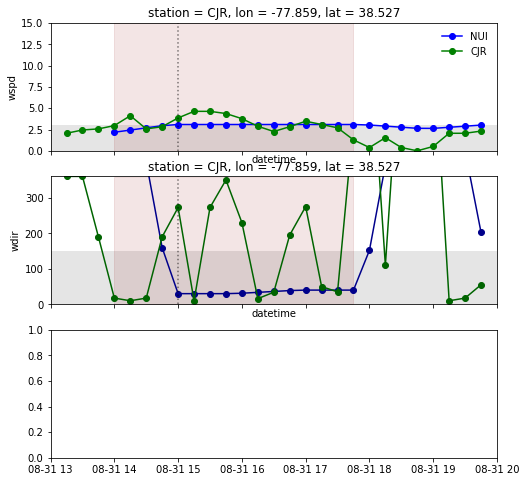

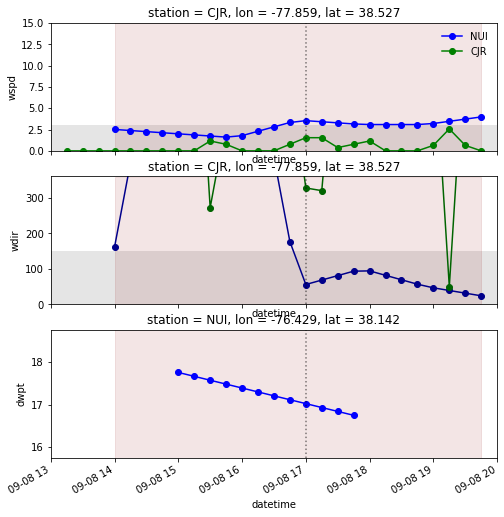

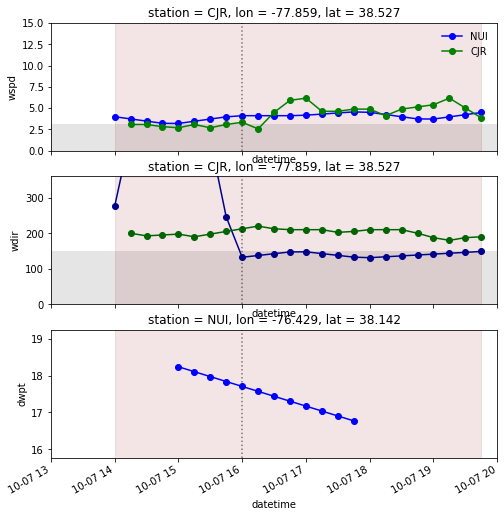

Unable to fill...
Unable to draw line...


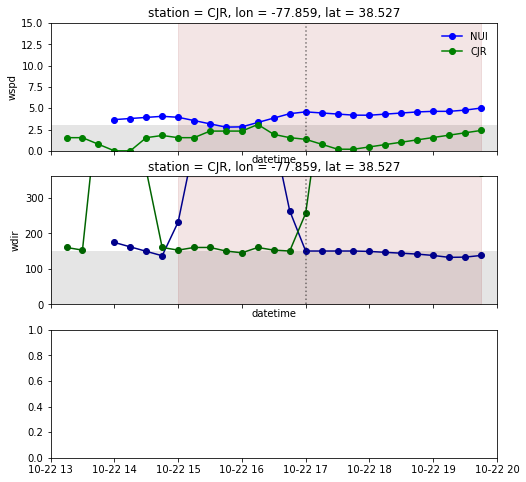

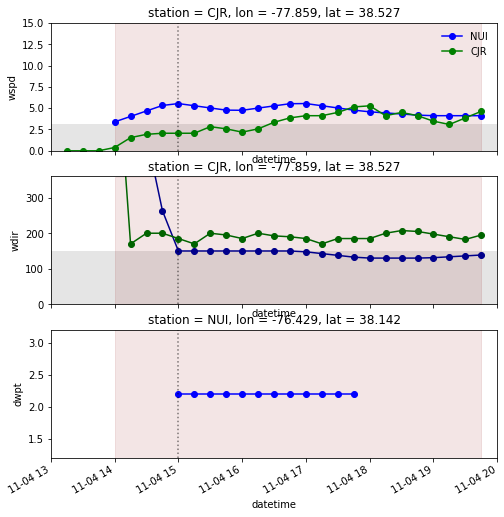

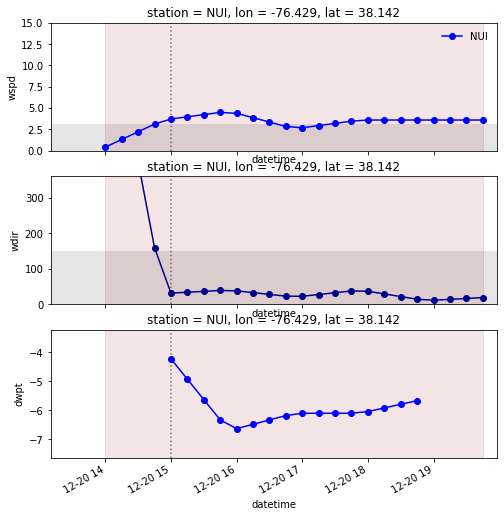

bay breeze validated for 12/29/2019


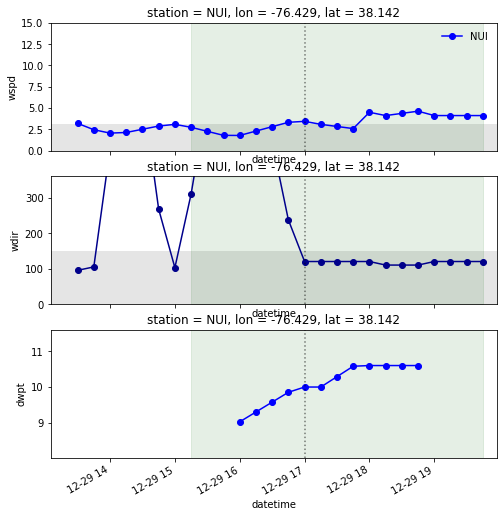

starting station: APG
Year: 2019
starting station: BWI
Year: 2019
onshore inland: True


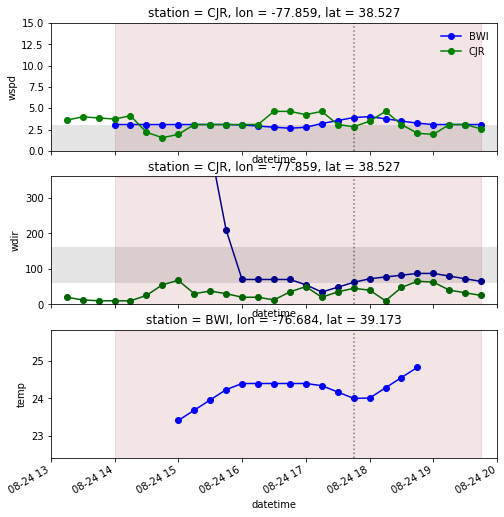

starting station: MTN
Year: 2019
starting station: NAK
Year: 2019
onshore inland: False
bay breeze validated for 2/5/2019


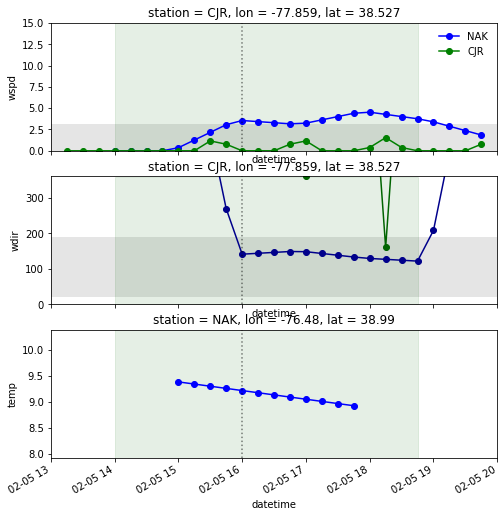

onshore inland: False
bay breeze validated for 2/14/2019


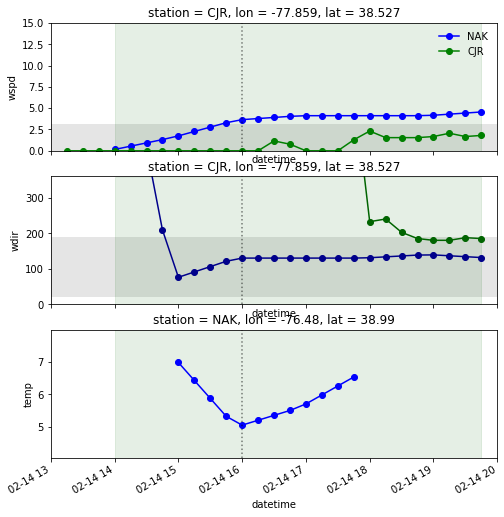

onshore inland: True


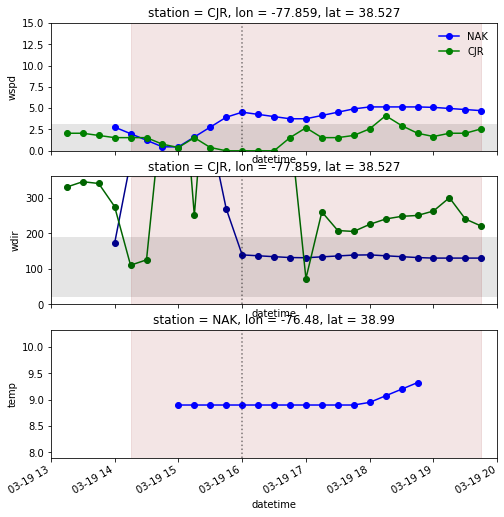

onshore inland: True


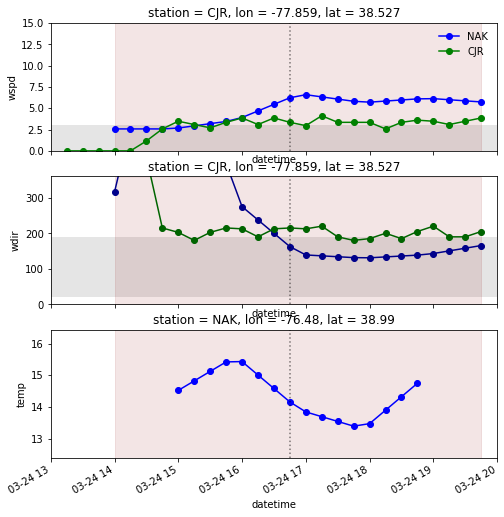

onshore inland: True


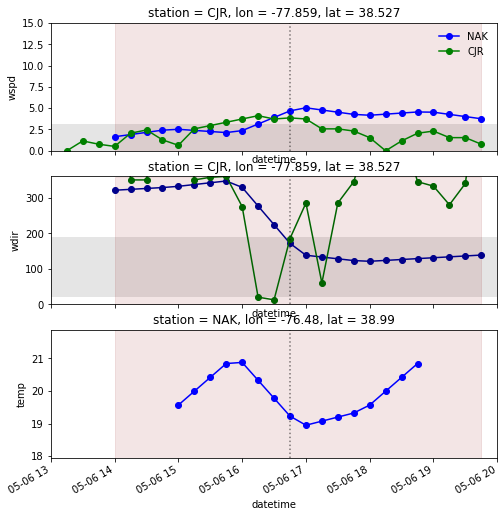

onshore inland: False
bay breeze validated for 5/23/2019


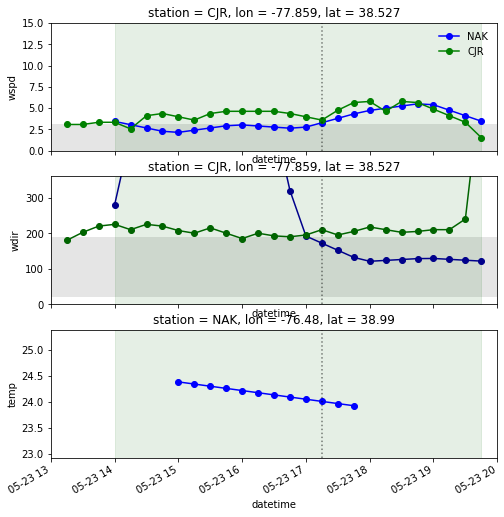

onshore inland: True


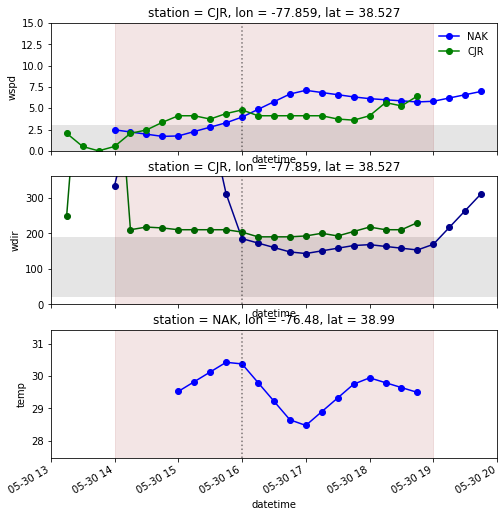

onshore inland: True


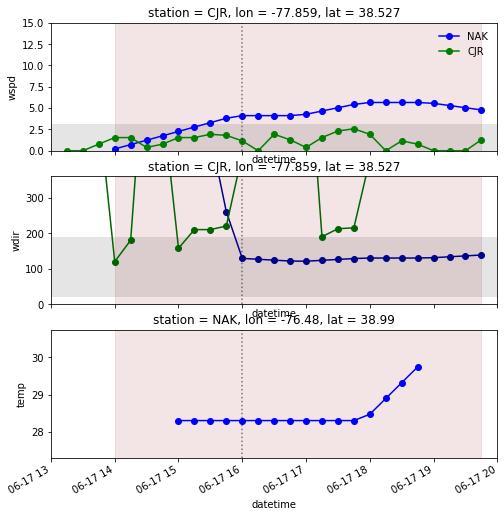

onshore inland: False
bay breeze validated for 6/27/2019


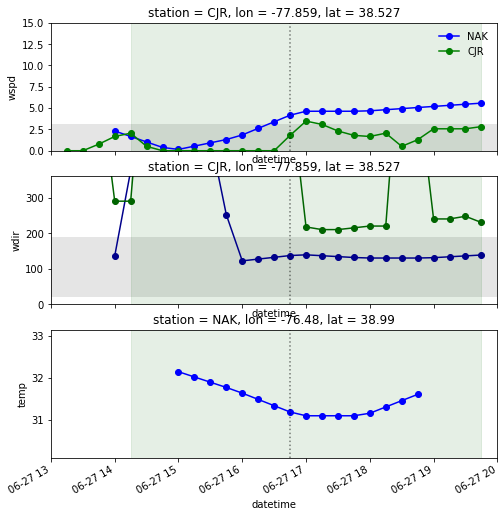

onshore inland: False
bay breeze validated for 7/28/2019


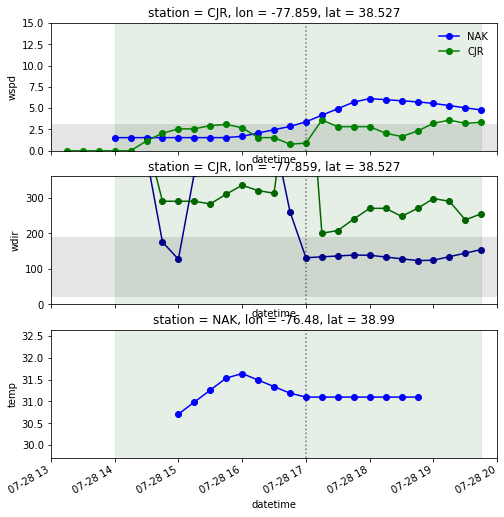

onshore inland: False
bay breeze validated for 8/11/2019


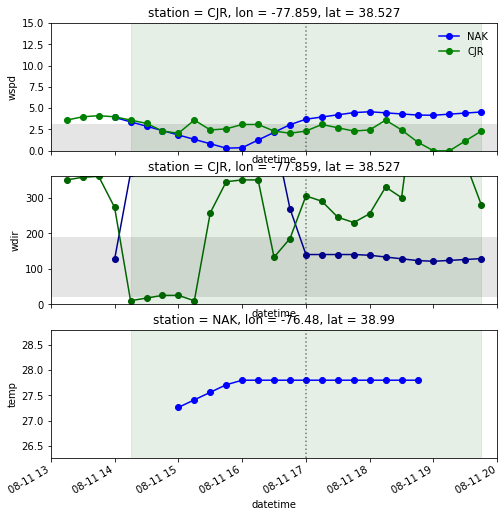

onshore inland: True


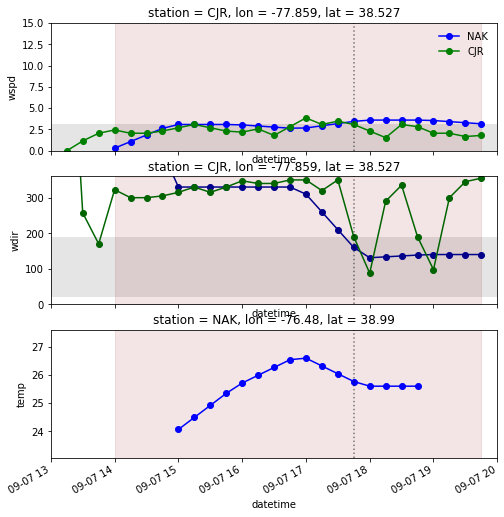

onshore inland: False
bay breeze validated for 9/8/2019


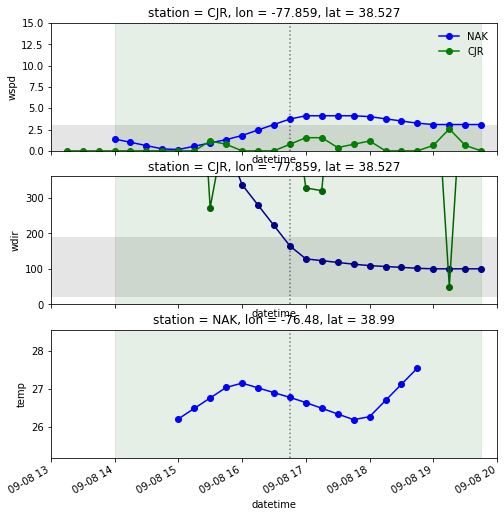

onshore inland: False
bay breeze validated for 9/23/2019


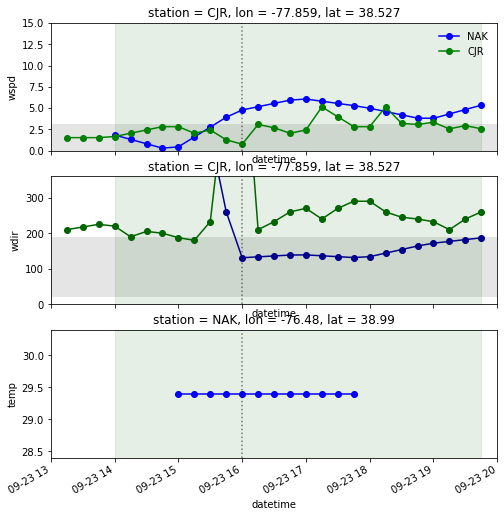

onshore inland: False
bay breeze validated for 9/25/2019


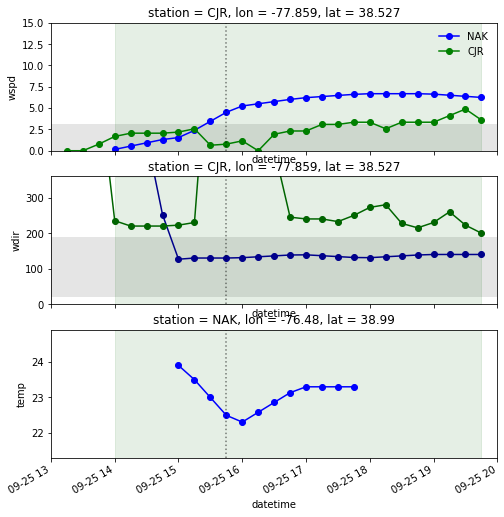

starting station: NHK
Year: 2019
onshore inland: False
bay breeze validated for 2/14/2019


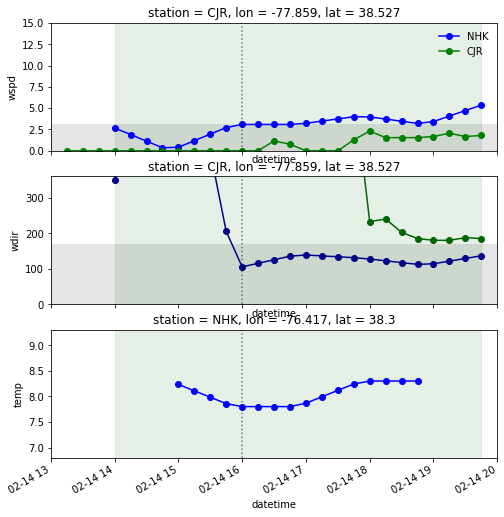

onshore inland: True


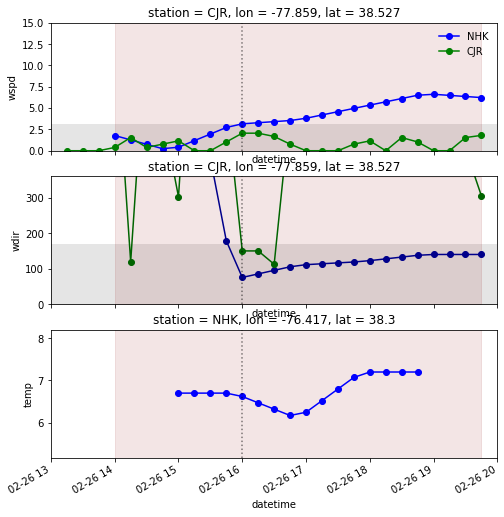

onshore inland: False
bay breeze validated for 3/14/2019


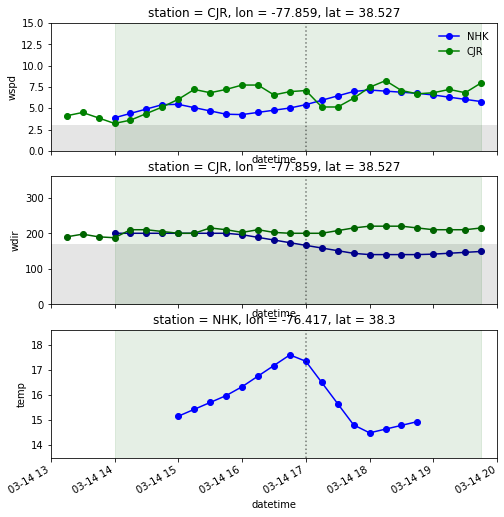

onshore inland: False
bay breeze validated for 3/17/2019


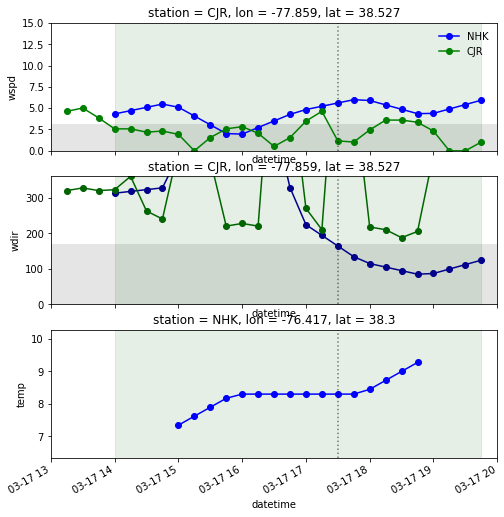

onshore inland: True


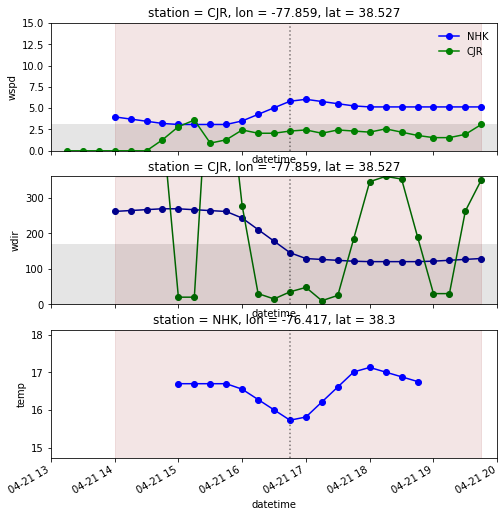

onshore inland: False
bay breeze validated for 5/7/2019


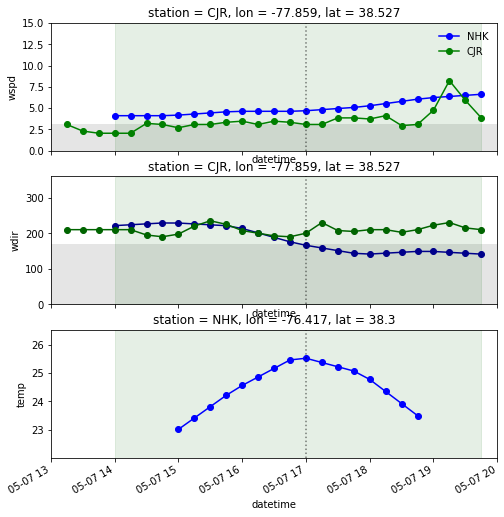

onshore inland: True


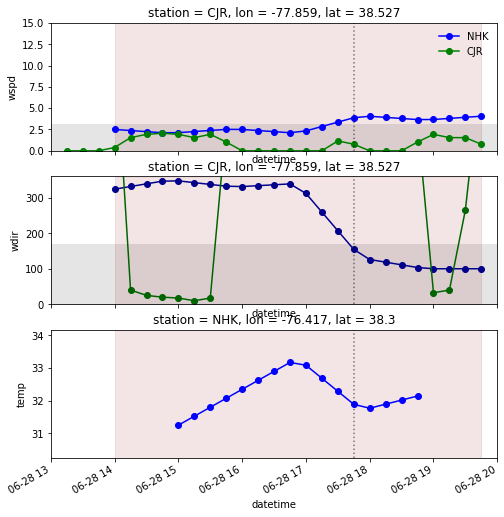

onshore inland: True


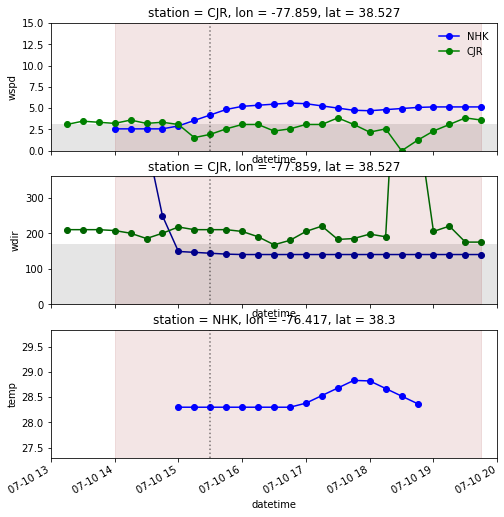

onshore inland: False
bay breeze validated for 7/16/2019


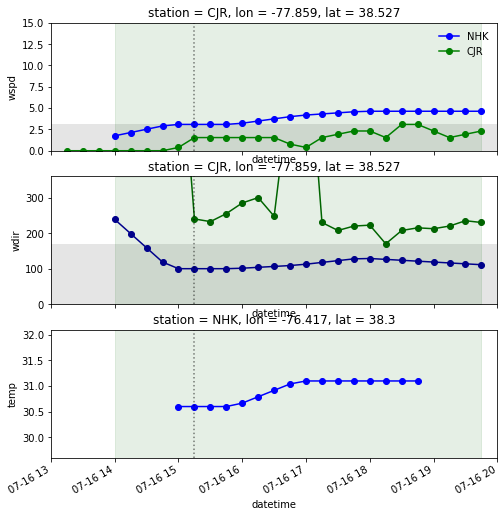

onshore inland: False
bay breeze validated for 7/19/2019


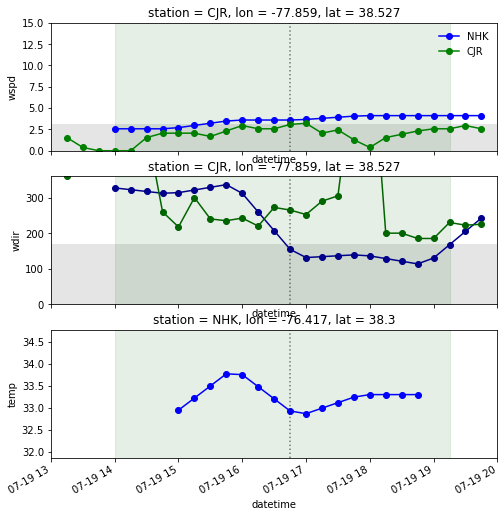

onshore inland: True


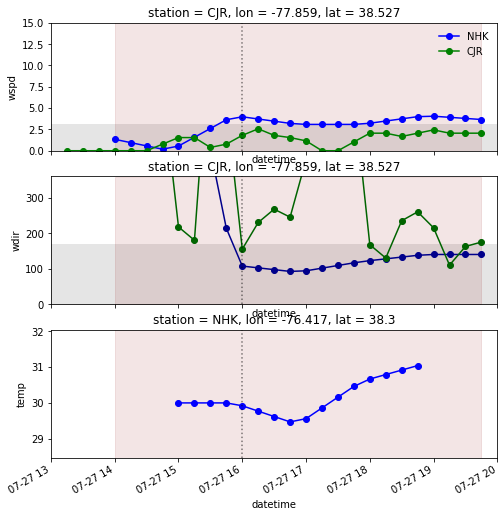

onshore inland: False
bay breeze validated for 7/30/2019


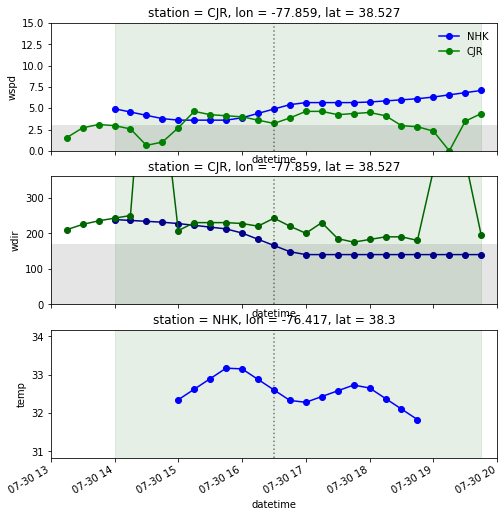

onshore inland: True


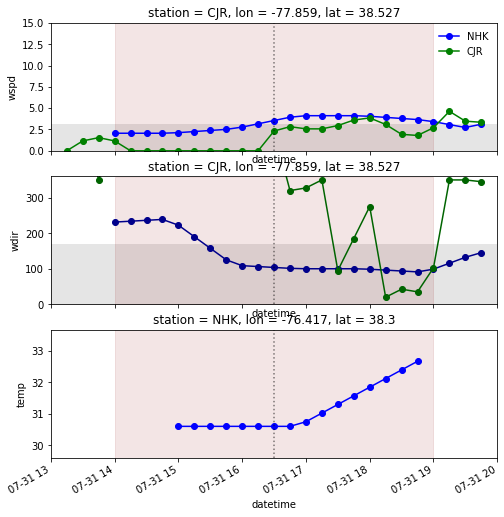

onshore inland: False
bay breeze validated for 10/1/2019


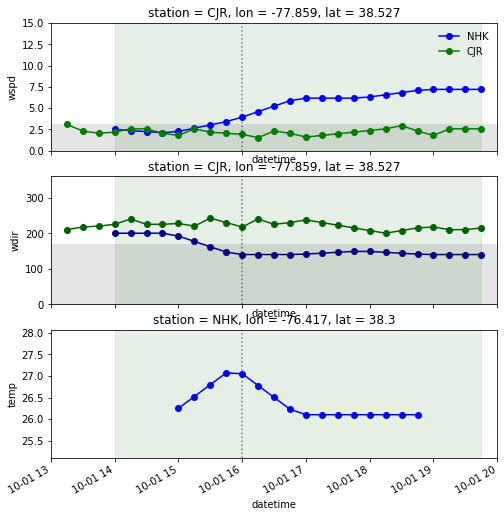

onshore inland: False
bay breeze validated for 11/6/2019


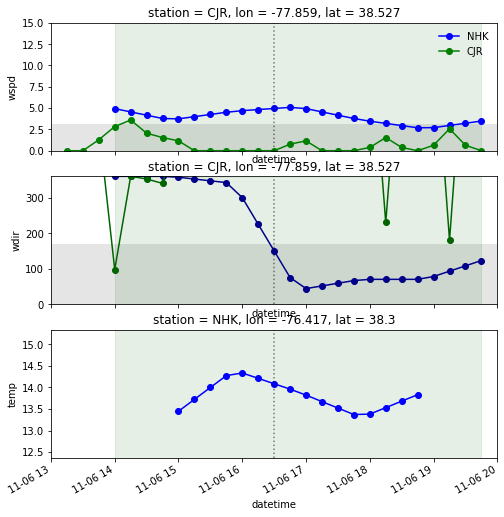

onshore inland: False
bay breeze validated for 11/11/2019


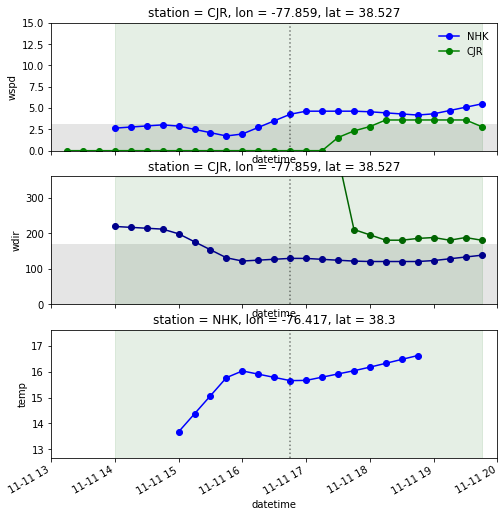

starting station: NUI
Year: 2019
onshore inland: False
bay breeze validated for 5/4/2019


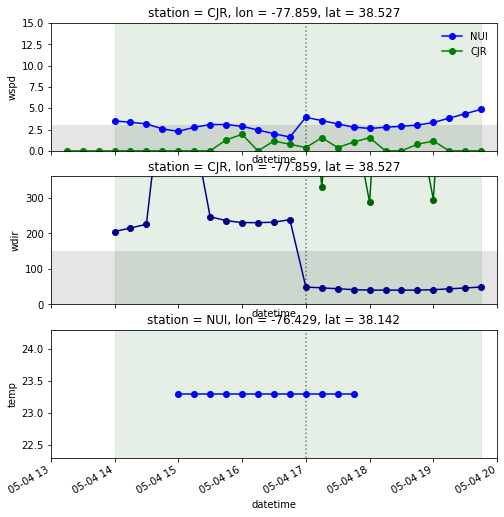

In [50]:
bay_breeze_ds_f = {}
for inland_station_name in inland_station_names[:2]:
    for detection_method in detection_methods:
        #month_count = np.zeros((nstations,period_len))
        near_shore_station_num = len(near_shore_stations)
        missing_days   = np.zeros((near_shore_station_num,nyears,12)) 
        analyzed_days  = np.zeros((near_shore_station_num,nyears,12)) 
        detected_days  = np.zeros((near_shore_station_num,nyears,12)) 
        validated_days = np.zeros((near_shore_station_num,nyears,12)) 

        for ss,stn in enumerate(near_shore_stations):   
            print('starting station: {}'.format(stn))
            ds               = ds_stn.sel(station=stn)

            inland_stationsf = ds_stn.sel(station=inland_station_name)
            bay_breeze_days = []
            if ss == 0:
                bay_breeze_detected  = []
                bay_breeze_validated = []
                bay_breeze_passage   = []
                bay_breeze_day_dict  = {}
                days                 = []

            elif ss == 1:
                bay_breeze_detected_f       = np.asarray([[None]*day_count]*near_shore_station_num)
                bay_breeze_detected_f[0,:]  = bay_breeze_detected
                bay_breeze_validated_f      = np.asarray([[None]*day_count]*near_shore_station_num)
                bay_breeze_validated_f[0,:] = bay_breeze_validated
                bay_breeze_passage_f        = np.asarray([[None]*day_count]*near_shore_station_num)
                bay_breeze_passage_f[0,:]   = bay_breeze_passage

            day_count = 0

            for yy,year in enumerate(year_range):
                print('Year: {}'.format(year))
                period_start = pd.to_datetime('{0}-{1} 00:00:00'.format(year,date_start))
                period_end   = pd.to_datetime('{0}-{1} 23:59:59'.format(year,date_end))
                month_start  = period_start.month
                period_len   = period_end.month - period_start.month
                for day in pd.date_range(start=period_start, end=period_end):
                    station = ds.sel(datetime=slice(str(pd.to_datetime(day)+start_time),
                                                str(pd.to_datetime(day)+end_time)))
                    inland_stations = inland_stationsf.sel(datetime=slice(str(pd.to_datetime(day)+start_time),
                                                str(pd.to_datetime(day)+end_time)))

                    #bay_breeze = bbd.BayBreezeDetection(station,inland_stations,resample=True,sample_rate='30min',
                    #                                        show_plot=False,method=detection_method,verbose=False)


                    bay_breeze = DetectBayBreeze(station,inland=inland_stations,verbose=False,resample=True,
                               sample_rate='15min',show_plot=True,method=detection_method)            


                    month_ind = day.month - month_start            
                    if bay_breeze.analyzed:
                        analyzed_days[ss,yy,month_ind] += 1
                    else:
                        missing_days[ss,yy,month_ind] += 1
                    if bay_breeze.detected: detected_days[ss,yy,month_ind] += 1
                    if bay_breeze.validated: validated_days[ss,yy,month_ind] += 1

                    if ss == 0: 
                        bay_breeze_detected.append(bay_breeze.detected)
                        bay_breeze_validated.append(bay_breeze.validated)
                    else:
                        bay_breeze_detected_f[ss,day_count]  = bay_breeze.detected
                        bay_breeze_validated_f[ss,day_count] = bay_breeze.validated

                    if bay_breeze.detected:
                        if bay_breeze.validated:
                            fill_color = 'darkgreen'
                            bay_breeze_days.append(pd.to_datetime(bay_breeze.passage.values).strftime('%Y-%m-%d %H:%M:%S'))
                        else:
                            fill_color = 'darkred'
                        if ss == 0: 
                            bay_breeze_passage.append(pd.to_datetime(bay_breeze.passage.values).strftime('%Y-%m-%d %H:%M:%S'))
                        else:
                            bay_breeze_passage_f[ss,day_count] = pd.to_datetime(bay_breeze.passage.values).strftime('%Y-%m-%d %H:%M:%S')
                    else:
                        if ss == 0: 
                            bay_breeze_passage.append('None')
                        else:
                            bay_breeze_passage_f[ss,day_count] = 'None'

                    if ss == 0: days.append(day)
                    day_count += 1

            bay_breeze_day_dict[stn] = bay_breeze_days   



        bay_breeze_ds = xr.Dataset({
                          'analyzed_count': (['station','year','month'],analyzed_days),
                           'missing_count': (['station','year','month'],missing_days),
                          'detected_count': (['station','year','month'],detected_days),
                         'validated_count': (['station','year','month'],validated_days),
                           'detected_days': (['station','day'],bay_breeze_detected_f.astype('str')),
                          'validated_days': (['station','day'],bay_breeze_validated_f.astype('str')),
                            'passage_time': (['station','day'],bay_breeze_passage_f.astype('str'))
                                    },
                         coords={'station': (['station'],near_shore_stations),
                                    'year': (['year'],year_range),
                                   'month': (['month'],np.arange(month_start,month_start+period_len+1)),
                                     'day': (['day'],days)
                                 })
        bay_breeze_ds.attrs['inland_station'] = inland_station_name

        bay_breeze_ds.to_netcdf('{}{}_{}_bay_breeze_inland{}.nc'.format(fdir,obs_type,detection_method,inland_station_name),'w')
        bay_breeze_ds_f[detection_method] = bay_breeze_ds

In [53]:
bay_breeze_ds_f = {}
for obs_type in ['ASOS','AWOS']:
    bay_breeze_ds_f[obs_type] = {}
    if obs_type == 'ASOS':
        inland_station_names = ['IAD','DCA','MRB','HGR']
    elif obs_type == 'AWOS':
        inland_station_names = ['IAD','CJR','GAI','FDK']

    for detection_method in detection_methods:
        bay_breeze_ds_f[obs_type][detection_method] = {}
        for inland_station_name in inland_station_names:
            fname = '{}{}_{}_bay_breeze_inland{}.nc'.format(fdir,obs_type,detection_method,inland_station_name)
            bay_breeze_ds_f[obs_type][detection_method][inland_station_name] = xr.open_dataset(fname)
        


# Check Sensitivity to Reference Inland Station:

In [432]:
days = bay_breeze_ds_f['ASOS']['StaufferThompson2015']['IAD'].day.data
inland_station_name = 'IAD'

bb_passage = []

for obs_type in ['ASOS','AWOS']:
    for detection_method in detection_methods:
        for dd, day in enumerate(days):
            day_line = '{}: '.format(str(day)[:10])
            if dd == 0:
                month_0 = int(str(day)[5:7])
            month = int(str(day)[5:7])
            if month != month_0:
                month_0 = month
            
            bb_ds = bay_breeze_ds_f[obs_type][detection_method][inland_station_name].sel(day=day)
            for ss,stn in enumerate(bb_ds.station.data):
                val_bool = bb_ds.sel(station=stn).validated_days.data
                if val_bool == 'True':
                    bb_passage = np.append(bb_passage,'{} [{}]'.format(bb_ds.sel(station=stn).passage_time.data,stn))
bb_passage = np.unique(bb_passage)


In [86]:
days = bay_breeze_ds_f['ASOS']['StaufferThompson2015']['IAD'].day.data

num_per_inland_station = {}

for obs_type in ['ASOS','AWOS']:
    #print(obs_type)
    num_per_inland_station[obs_type] = {}
    for detection_method in detection_methods:
        #print(detection_method)
        num_per_inland_station[obs_type][detection_method] = {}
        for dd, day in enumerate(days):
            day_line = '{}: '.format(str(day)[:10])
            if dd == 0:
                month_0 = int(str(day)[5:7])
            month = int(str(day)[5:7])
            if month != month_0:
                #print()
                month_0 = month
            for inland_station_name in list(bay_breeze_ds_f[obs_type][detection_method].keys()):
                if dd == 0: num_per_inland_station[obs_type][detection_method][inland_station_name] = 0
                got_one_today = False
                inland_str = ''
                bb_ds = bay_breeze_ds_f[obs_type][detection_method][inland_station_name].sel(day=day)
                for ss,stn in enumerate(bb_ds.station.data):
                    val_bool = bb_ds.sel(station=stn).validated_days.data
                    if val_bool == 'True':
                        if got_one_today == True:
                            inland_str += ',{}'.format(stn)
                        else:
                            inland_str = '\t\t{}:{}'.format(inland_station_name,stn)
                            got_one_today = True
                        num_per_inland_station[obs_type][detection_method][inland_station_name] += 1
                if inland_str != '': 
                    day_line += inland_str
            #if day_line != '{}: '.format(str(day)[:10]): print(day_line)
        #print('\n\n\n\n')
                
            


In [168]:
for obs_type in ['ASOS','AWOS']:
    for detection_method in detection_methods:
        for inland_station_name in list(bay_breeze_ds_f[obs_type][detection_method].keys()):
            print(obs_type,detection_method,inland_station_name,num_per_inland_station[obs_type][detection_method][inland_station_name])

ASOS StaufferThompson2015 IAD 61
ASOS StaufferThompson2015 DCA 46
ASOS StaufferThompson2015 MRB 57
ASOS StaufferThompson2015 HGR 71
ASOS Stauffer2015 IAD 81
ASOS Stauffer2015 DCA 81
ASOS Stauffer2015 MRB 81
ASOS Stauffer2015 HGR 81
ASOS Sikora2010 IAD 25
ASOS Sikora2010 DCA 19
ASOS Sikora2010 MRB 23
ASOS Sikora2010 HGR 33
AWOS StaufferThompson2015 IAD 115
AWOS StaufferThompson2015 CJR 121
AWOS StaufferThompson2015 GAI 135
AWOS StaufferThompson2015 FDK 134
AWOS Stauffer2015 IAD 55
AWOS Stauffer2015 CJR 55
AWOS Stauffer2015 GAI 55
AWOS Stauffer2015 FDK 55
AWOS Sikora2010 IAD 28
AWOS Sikora2010 CJR 20
AWOS Sikora2010 GAI 31
AWOS Sikora2010 FDK 31


In [444]:
print(list(bay_breeze_ds_f['ASOS'][detection_method].keys()))
print(list(bay_breeze_ds_f['AWOS'][detection_method].keys()))


['IAD', 'DCA', 'MRB', 'HGR']
['IAD', 'CJR', 'GAI', 'FDK']


In [583]:
inland_station_name = 'IAD'
month_dict = {}

header_lines = r'\begin{table}\label{LABEL_PLACEHOLDER}' + '\n' + \
               r'\bgroup' + '\n' + r'\def\arraystretch{1.5}' + '\n' + \
               r'\begin{tabular}{|>{\centering\arraybackslash}m{0.07\textwidth}|' + \
               r'>{\centering\arraybackslash}m{0.25\textwidth}|'*3  + '}' + \
               '\n' + r'\hline'
footer_lines = r'\end{tabular}' + '\n' + r'\egroup' + '\n' + r'\end{table}'

detection_method_names_dict = {'StaufferThompson2015':'Stauffer and Thompson (2015)',
                                       'Stauffer2015':'Stauffer et al. (2015)',
                                         'Sikora2010':'Sikora et al. (2010)'}
month_lines_dict = {}
for obs_type in ['ASOS','AWOS']:
    if obs_type == 'ASOS': inland_station_name = 'IAD'
    if obs_type == 'AWOS': inland_station_name = 'IAD'
        
    #print(header_lines)
    #print(obs_type)
    methods_line = 'Month & '
    month_lines_dict[obs_type] = ['']*12
    month_dict[obs_type] = {}
    for detection_method in detection_methods:
        methods_line += detection_method_names_dict[detection_method] +' & '
        #print(detection_method)
        month_dict[obs_type][detection_method] = {}
        
        for dd, day in enumerate(days):
            day_line = '{}: '.format(str(day)[:10])
            if dd == 0:
                month_0 = int(str(day)[5:7])
                month_dict[obs_type][detection_method][month_0] = ''
            month = int(str(day)[5:7])
            if month != month_0:
                month_dict[obs_type][detection_method][month_0] = month_dict[obs_type][detection_method][month_0][:-2]
                #print(month_0,month_dict[obs_type][detection_method][month_0])
                if month_dict[obs_type][detection_method][month_0] == '':
                    month_dict[obs_type][detection_method][month_0] = '--'
                month_lines_dict[obs_type][month_0-1] += month_dict[obs_type][detection_method][month_0] + ' & '
                month_0 = month
                month_dict[obs_type][detection_method][month_0] = ''
            got_one_today = False
            day_stn_list = []
            bb_ds = bay_breeze_ds_f[obs_type][detection_method][inland_station_name].sel(day=day)
            for ss,stn in enumerate(bb_ds.station.data):
                val_bool = bb_ds.sel(station=stn).validated_days.data
                if val_bool == 'True':
                    if got_one_today == True:
                        day_stn_list.append(stn)
                    else:
                        month_dict[obs_type][detection_method][month_0] += str(int(str(day)[8:10]))
                        day_stn_list = [stn]
                        got_one_today = True
            if len(day_stn_list) > 1:
                day_str = '({}), '.format(len(day_stn_list))
            else:
                day_str = ', '
            
            if got_one_today:
                month_dict[obs_type][detection_method][month_0] += day_str
        month_dict[obs_type][detection_method][month_0] = month_dict[obs_type][detection_method][month_0][:-2]
        #print(month_0,month_dict[obs_type][detection_method][month_0])
        if month_dict[obs_type][detection_method][month_0] == '':
            month_dict[obs_type][detection_method][month_0] = '--'
        month_lines_dict[obs_type][month_0-1] += month_dict[obs_type][detection_method][month_0] + ' & '
        
    methods_line = methods_line[:-2]
    methods_line += r'\\'
    print(header_lines.replace('LABEL_PLACEHOLDER','table:{}'.format(obs_type)))
    print(methods_line)
    print(r'\hline')
    for mm, month in enumerate(month_lines_dict[obs_type]):
        month_line = str(mm+1) + ' & ' + month[:-2] + r'\\'
        print(month_line)
        print(r'\hline')

    print(footer_lines)
    print('\n\n\n\n')
    


\begin{table}\label{table:ASOS}
\bgroup
\def\arraystretch{1.5}
\begin{tabular}{|>{\centering\arraybackslash}m{0.07\textwidth}|>{\centering\arraybackslash}m{0.25\textwidth}|>{\centering\arraybackslash}m{0.25\textwidth}|>{\centering\arraybackslash}m{0.25\textwidth}|}
\hline
Month & Stauffer and Thompson (2015) & Stauffer et al. (2015) & Sikora et al. (2010) \\
\hline
1 & 26, 28 & 8, 17(2), 26, 28 & -- \\
\hline
2 & 5, 14(2) & 5, 10, 14, 16 & 14 \\
\hline
3 & 17, 24, 27 & 5, 10, 17, 24(2), 25, 28, 29 & 17, 24 \\
\hline
4 & 1, 4, 6, 7, 10, 13, 20, 21, 30 & 1, 4, 6, 10, 13, 19, 20, 21, 23, 30 & 1, 6, 10, 20, 30 \\
\hline
5 & 2, 4, 6, 16, 18, 19 & 4(2), 5, 6, 16, 18, 19, 27, 30 & 6, 16, 19 \\
\hline
6 & 26, 27, 28 & 13, 19, 24, 26, 28 & 26, 28 \\
\hline
7 & 1, 9, 15, 19, 25, 28, 29(2), 30(2) & 1, 9, 19, 25, 27, 28, 29(2), 30, 31 & 1, 15, 19, 28 \\
\hline
8 & 5, 6, 11, 12, 18, 19 & 2, 6, 7, 11, 12, 19, 20, 30, 31 & 19 \\
\hline
9 & 7, 8(2), 11, 18, 22(2), 25, 26 & 7, 8(2), 11, 16(2), 22(2), 2

# Merged tables:

In [585]:
def remove_duplicates(days,asos_days,awos_days,format_text=False,good_days=None):
    for dd,day in enumerate(days):
        day = day.strip()
        #print(day)
        if '(' in day:
            day = day.split('(')[0]
        if day != '--':
            days[dd] = int(day)
        else:
            days[dd] = 0
    days = list(np.unique(days))
    if 0 in days:
        days.remove(0)
    
    days_temp = days.copy()
    if good_days != None:
        for dd,day in enumerate(days_temp):
            if day not in good_days:
                days.remove(day)
    if format_text:
        formatted_days = days.copy()
        for dd,day in enumerate(days):
            day = str(day)
            if (day in asos_days) & (day not in awos_days):
                #print('asos',day)
                days[dd] = r'\textbf{\textcolor{ASOS}{' + day + '}}'

            elif (day in awos_days) & (day not in asos_days):
                days[dd] = r'\textbf{\textcolor{AWOS}{' + day + '}}'
            else:
                days[dd] = day

        days = ', '.join(np.asarray(days,dtype=str))
        if days == '':
            days = ' -- '
    return(days)



In [572]:
asos_month_lines = month_lines_dict['ASOS']
awos_month_lines = month_lines_dict['AWOS']

print(header_lines.replace('LABEL_PLACEHOLDER','table:{}'.format('combined')))
print(methods_line)
print(r'\hline')
for mm,month in enumerate(range(1,13)):
    asos_days = asos_month_lines[mm].split('&')
    awos_days = awos_month_lines[mm].split('&')

    StTh_days = list(np.append(asos_days[0].split(','),awos_days[0].split(',')))
    St_days   = list(np.append(asos_days[1].split(','),awos_days[1].split(',')))
    Sk_days   = list(np.append(asos_days[2].split(','),awos_days[2].split(',')))
    
    
    StTh_days = remove_duplicates(StTh_days,asos_days[0],awos_days[0],format_text=True)
    St_days = remove_duplicates(St_days,asos_days[1],awos_days[1],format_text=True)
    Sk_days = remove_duplicates(Sk_days,asos_days[2],awos_days[2],format_text=True)
    #if month == 10: 
    #    print(asos_days[0])
    #    print(awos_days[0])
    print(str(month) + ' & ' + StTh_days + ' & ' + St_days + ' & ' + Sk_days + r' \\')
    print(r'\hline')

print(footer_lines)
print('\n\n\n\n')    
    

    

\begin{table}\label{table:combined}
\bgroup
\defrraystretch{1.5}
\begin{tabular}{|>{\centering\arraybackslash}b{0.07\textwidth}|>{\centering\arraybackslash}b{0.25\textwidth}|>{\centering\arraybackslash}b{0.25\textwidth}|>{\centering\arraybackslash}b{0.25\textwidth}|}
\hline
Month & Stauffer and Thompson (2015) & Stauffer et al. (2015) & Sikora et al. (2010) \\
\hline
1 & \textcolor{ASOS}{26}, \textcolor{ASOS}{28} & \textcolor{ASOS}{8}, \textcolor{ASOS}{17}, \textcolor{AWOS}{23}, \textcolor{ASOS}{26}, \textcolor{ASOS}{28} &  --  \\
\hline
2 & \textbf{2}, \textbf{4}, \textbf{5}, \textcolor{AWOS}{10}, \textbf{14}, \textcolor{AWOS}{26}, \textcolor{AWOS}{28} & \textcolor{AWOS}{2}, \textcolor{ASOS}{5}, \textbf{10}, \textbf{14}, \textbf{16} & \textcolor{AWOS}{5}, \textbf{14}, \textcolor{AWOS}{26} \\
\hline
3 & \textcolor{AWOS}{14}, \textbf{17}, \textcolor{AWOS}{19}, \textcolor{ASOS}{24}, \textcolor{ASOS}{27}, \textcolor{AWOS}{28} & \textbf{5}, \textcolor{ASOS}{10}, \textcolor{AWOS}{13}, \tex

# Days to check radar/obs:

In [598]:
asos_month_lines = month_lines_dict['ASOS']
awos_month_lines = month_lines_dict['AWOS']
full_month_dict = {}
count = 0
for mm,month in enumerate(range(1,13)):
    asos_days = asos_month_lines[mm].split('&')
    awos_days = awos_month_lines[mm].split('&')

    StTh_days = list(np.append(asos_days[0].split(','),awos_days[0].split(',')))
    St_days   = list(np.append(asos_days[1].split(','),awos_days[1].split(',')))
    Sk_days   = list(np.append(asos_days[2].split(','),awos_days[2].split(',')))
    
    
    StTh_days = remove_duplicates(StTh_days,asos_days[0],awos_days[0])
    St_days = remove_duplicates(St_days,asos_days[1],awos_days[1])
    Sk_days = remove_duplicates(Sk_days,asos_days[2],awos_days[2])
    full_day_list = list(np.unique(np.asarray(np.concatenate([StTh_days,St_days,Sk_days]),dtype=int)))
    for dd,day in enumerate(full_day_list):
        full_day_list[dd] = '2019-{0:02d}-{1:02d}'.format(month,day)
        
    full_month_dict[month] = full_day_list
    for day in full_day_list:
        for day_time in bb_passage:
            date = day_time[:10]
            if day == date:
                print('{}: '.format(day_time))
        count += 1
    print()
    

    

2019-01-08 17:30:00 [NAK]: 
2019-01-17 14:00:00 [NAK]: 
2019-01-17 14:15:00 [NHK]: 
2019-01-23 15:15:00 [NAK]: 
2019-01-26 14:30:00 [NAK]: 
2019-01-28 17:30:00 [BWI]: 

2019-02-02 16:15:00 [NHK]: 
2019-02-04 15:30:00 [MTN]: 
2019-02-05 16:00:00 [NAK]: 
2019-02-05 16:15:00 [NAK]: 
2019-02-10 15:45:00 [NAK]: 
2019-02-10 16:00:00 [NAK]: 
2019-02-10 16:15:00 [NHK]: 
2019-02-14 16:00:00 [NAK]: 
2019-02-14 16:00:00 [NHK]: 
2019-02-14 16:15:00 [NHK]: 
2019-02-14 16:45:00 [NAK]: 
2019-02-16 15:30:00 [NHK]: 
2019-02-16 17:00:00 [NUI]: 
2019-02-26 16:00:00 [NHK]: 
2019-02-26 17:00:00 [NUI]: 
2019-02-28 17:30:00 [NAK]: 

2019-03-05 16:15:00 [NAK]: 
2019-03-10 16:30:00 [NAK]: 
2019-03-13 17:00:00 [BWI]: 
2019-03-14 17:00:00 [NHK]: 
2019-03-17 17:15:00 [NHK]: 
2019-03-17 17:30:00 [NHK]: 
2019-03-19 15:45:00 [MTN]: 
2019-03-19 16:00:00 [NAK]: 
2019-03-19 16:15:00 [APG]: 
2019-03-24 16:45:00 [NAK]: 
2019-03-24 17:00:00 [NAK]: 
2019-03-24 17:00:00 [NHK]: 
2019-03-24 17:30:00 [NUI]: 
2019-03-25 16:45:0

In [396]:
command_str = 'curl -O '
gif_loc = 'https://www.wpc.ncep.noaa.gov/archives/sfc/{0:04d}/namussfc{0:04d}{1:02d}{2:02d}{3:02d}.gif'

for mm,month in enumerate(full_month_dict):
    for day in full_month_dict[month]:
        day = pd.to_datetime(day)
        f_loc = gif_loc.format(day.year,day.month,day.day,18)
        print(command_str + f_loc)

curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019010818.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019011718.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019012318.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019012618.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019012818.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019020218.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019020418.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019020518.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019021018.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019021418.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019021618.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019022618.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2

In [574]:
day_analysis_dict = {
                    '2019-01-08 17:30:00 [NAK]': 'radar clear. warm front.           ',
                    '2019-01-17 14:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-01-17 14:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-01-23 15:15:00 [NAK]': 'radar clear. warm front.           ',
                    '2019-01-26 14:30:00 [NAK]': 'radar clear. stat. front.          ',
                    '2019-01-28 17:30:00 [BWI]': 'radar clear. no synoptic.          ',
                    '2019-02-02 16:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-02-04 15:30:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-02-05 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-02-05 16:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-02-10 15:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-02-10 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-02-10 16:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-02-14 16:00:00 [NAK]': 'drizzel in area. no synoptic.      ',
                    '2019-02-14 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-02-14 16:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-02-14 16:45:00 [NAK]': 'drizzel in area. no synoptic.      ',
                    '2019-02-16 15:30:00 [NHK]': 'storms in area. no synoptic.       ',
                    '2019-02-16 17:00:00 [NUI]': 'storms in area. no synoptic.       ',
                    '2019-02-26 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-02-26 17:00:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-02-28 17:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-03-05 16:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-03-10 16:30:00 [NAK]': 'radar clear. warm front.           ',
                    '2019-03-13 17:00:00 [BWI]': 'radar clear. no synoptic.          ',
                    '2019-03-14 17:00:00 [NHK]': 'radar clear. warm front.           ',
                    '2019-03-17 17:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-03-17 17:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-03-19 15:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-03-19 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-03-19 16:15:00 [APG]': 'radar clear. no synoptic.          ',
                    '2019-03-24 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-03-24 17:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-03-24 17:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-03-24 17:30:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-03-25 16:45:00 [NUI]': 'radar clear. cold front.           ',
                    '2019-03-27 14:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-03-28 16:45:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-03-28 18:00:00 [BWI]': 'radar clear. no synoptic.          ',
                    '2019-03-29 16:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-03-29 17:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-04-01 17:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-04-01 17:45:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-04-04 14:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-04-06 15:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-04-06 15:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-04-06 16:30:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-04-07 14:30:00 [NHK]': 'radar clear. warm front.           ',
                    '2019-04-07 16:30:00 [NUI]': 'radar clear. warm front.           ',
                    '2019-04-10 15:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-04-10 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-04-13 15:30:00 [NAK]': 'storms in area. cold front.        ',
                    '2019-04-17 16:00:00 [NAK]': 'radar clear. cold front.           ',
                    '2019-04-17 17:00:00 [NUI]': 'radar clear. cold front.           ',
                    '2019-04-19 17:00:00 [BWI]': 'storms in area. no synoptic.       ',
                    '2019-04-20 16:30:00 [NAK]': 'radar clear. cold front.           ',
                    '2019-04-21 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-04-21 16:45:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-04-21 17:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-04-23 15:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-04-26 17:00:00 [NHK]': 'storms in area. warm front.        ',
                    '2019-04-30 15:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-05-02 15:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-05-02 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-05-04 16:00:00 [NHK]': 'radar clear. cold front.           ',
                    '2019-05-04 17:00:00 [NUI]': 'radar clear. cold front.           ',
                    '2019-05-05 15:45:00 [NHK]': 'rain in area. stat. front.         ',
                    '2019-05-06 16:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-05-06 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-05-07 17:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-05-16 16:45:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-05-16 17:30:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-05-18 18:00:00 [NUI]': 'radar clear. warm front.           ',
                    '2019-05-19 16:45:00 [BWI]': 'radar clear. stat. front.          ',
                    '2019-05-23 17:15:00 [NAK]': 'radar clear. warm front.           ',
                    '2019-05-27 14:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-05-30 16:00:00 [NAK]': 'drizzel in area. no synoptic.      ',
                    '2019-05-30 17:00:00 [NAK]': 'drizzel in area. no synoptic.      ',
                    '2019-06-13 17:15:00 [NAK]': 'radar clear. warm front.           ',
                    '2019-06-17 15:00:00 [MTN]': 'radar clear. SWT in area.          ',
                    '2019-06-17 16:00:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-06-17 16:00:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-06-19 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-19 18:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-23 17:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-06-24 15:00:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-06-24 17:00:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-06-26 16:30:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-06-26 16:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-26 17:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-27 16:00:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-06-27 16:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-27 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-28 15:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-06-28 16:00:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-06-28 17:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-06-28 17:45:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-01 17:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-09 14:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-07-09 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-09 17:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-10 15:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-10 15:30:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-07-15 16:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-07-15 17:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-15 17:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-16 15:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-17 15:00:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-07-19 15:00:00 [MTN]': 'radar clear. SWT in area.          ',
                    '2019-07-19 16:45:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-07-19 17:00:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-07-19 17:45:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-07-24 16:00:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-07-25 17:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-26 14:45:00 [MTN]': 'possible sea breeze. no synoptic.  ',
                    '2019-07-26 15:45:00 [NAK]': 'possible sea breeze. no synoptic.  ',
                    '2019-07-26 16:00:00 [BWI]': 'possible sea breeze. no synoptic.  ',
                    '2019-07-27 15:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-27 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-27 16:15:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-07-28 17:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-28 17:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-28 17:45:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-29 16:00:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-07-29 16:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-29 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-29 17:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-07-30 14:45:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-07-30 16:30:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-07-30 16:30:00 [NUI]': 'radar clear. SWT in area.          ',
                    '2019-07-31 15:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-07-31 16:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-08-01 15:00:00 [MTN]': 'radar clear. stat. front.          ',
                    '2019-08-01 17:15:00 [NHK]': 'radar clear. stat. front.          ',
                    '2019-08-02 14:30:00 [NHK]': 'rain in area. cold front.          ',
                    '2019-08-02 17:00:00 [NAK]': 'radar clear. cold front.           ',
                    '2019-08-03 14:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-08-05 15:45:00 [NAK]': 'radar clear. stat. front.          ',
                    '2019-08-06 15:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-07 14:45:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-08-11 16:00:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-08-11 17:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-11 17:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-12 14:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-12 15:15:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-08-14 17:45:00 [NHK]': 'storms in area. stat. front.       ',
                    '2019-08-17 17:15:00 [NHK]': 'storms in area. stat. front.       ',
                    '2019-08-18 15:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-19 16:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-19 16:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-08-19 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-20 14:45:00 [APG]': 'radar clear. no synoptic.          ',
                    '2019-08-20 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-20 17:00:00 [BWI]': 'radar clear. no synoptic.          ',
                    '2019-08-30 14:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-08-30 15:15:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-08-31 15:30:00 [NHK]': 'radar clear. cold front.           ',
                    '2019-09-07 17:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-07 17:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-08 14:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-09-08 16:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-08 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-08 17:00:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-09-11 16:15:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-09-11 16:45:00 [MTN]': 'radar clear. SWT in area.          ',
                    '2019-09-16 15:15:00 [NHK]': 'rain in area. no synoptic.         ',
                    '2019-09-16 16:00:00 [NHK]': 'rain in area. no synoptic.         ',
                    '2019-09-16 17:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-16 17:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-18 17:15:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-09-18 17:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-20 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-09-20 16:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-09-20 17:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-21 15:45:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-09-21 16:00:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-09-22 15:00:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-09-22 15:00:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-09-22 15:30:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-09-22 17:30:00 [MTN]': 'radar clear. SWT in area.          ',
                    '2019-09-23 16:00:00 [NAK]': 'drizzle in area. SWT in area.      ',
                    '2019-09-25 15:45:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-09-25 15:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-09-25 16:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-09-26 14:15:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-10-01 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-10-07 15:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-10-07 16:00:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-10-07 16:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-10-11 16:30:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-10-12 17:00:00 [NHK]': 'radar clear. SWT in area.          ',
                    '2019-10-19 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-10-19 16:00:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-10-19 16:15:00 [MTN]': 'radar clear. no synoptic.          ',
                    '2019-10-24 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-10-28 15:15:00 [BWI]': 'radar clear. no synoptic.          ',
                    '2019-10-28 15:45:00 [APG]': 'radar clear. no synoptic.          ',
                    '2019-11-02 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-02 17:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-11-04 15:00:00 [NUI]': 'radar clear. no synoptic.          ',
                    '2019-11-06 16:30:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-11-06 17:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-06 18:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-10 16:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-10 17:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-11 15:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-11 15:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-11 16:45:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-11-15 15:15:00 [NHK]': 'drizzle in area. no synoptic.      ',
                    '2019-11-15 16:00:00 [NUI]': 'drizzle in area. no synoptic.      ',
                    '2019-11-19 17:15:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-21 18:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-25 16:45:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-11-25 17:00:00 [NAK]': 'radar clear. SWT in area.          ',
                    '2019-11-26 15:30:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-11-26 15:45:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-12-12 16:00:00 [NAK]': 'radar clear. no synoptic.          ',
                    '2019-12-20 14:15:00 [NHK]': 'radar clear. no synoptic.          ',
                    '2019-12-29 17:00:00 [NUI]': 'rain in area. no synoptic.         ',
                    '2019-12-30 14:45:00 [NHK]': 'drizzle in area. cold front.       ',
                    }

In [580]:
count = 0
good_days = []
for day in day_analysis_dict:
    day_analysis = day_analysis_dict[day].strip()
    #if (day_analysis == 'radar clear. no synoptic.') or (day_analysis == 'radar clear. SWT in area.'):
    if (day_analysis == 'radar clear. no synoptic.'):
        count+=1
        good_days = np.append(good_days,day[:10])

In [581]:
len(good_days)

146

In [586]:
asos_month_lines = month_lines_dict['ASOS']
awos_month_lines = month_lines_dict['AWOS']

print(header_lines.replace('LABEL_PLACEHOLDER','table:{}'.format('combined')))
print(methods_line)
print(r'\hline')
for mm,month in enumerate(range(1,13)):
    asos_days = asos_month_lines[mm].split('&')
    awos_days = awos_month_lines[mm].split('&')

    StTh_days = list(np.append(asos_days[0].split(','),awos_days[0].split(',')))
    St_days   = list(np.append(asos_days[1].split(','),awos_days[1].split(',')))
    Sk_days   = list(np.append(asos_days[2].split(','),awos_days[2].split(',')))
    good_days_month = []
    for day in good_days:
        if day[5:7] == '{0:02d}'.format(month):
            good_days_month.append(int(day[8:10]))
    good_days_month = list(np.unique(good_days_month))
#    print(good_days_month)
    StTh_days = remove_duplicates(StTh_days,asos_days[0],awos_days[0],format_text=True,good_days=good_days_month)
    St_days   = remove_duplicates(St_days,  asos_days[1],awos_days[1],format_text=True,good_days=good_days_month)
    Sk_days   = remove_duplicates(Sk_days,  asos_days[2],awos_days[2],format_text=True,good_days=good_days_month)
    #if month == 10: 
    #    print(asos_days[0])
    #    print(awos_days[0])
    print(str(month) + ' & ' + StTh_days + ' & ' + St_days + ' & ' + Sk_days + r' \\')
    print(r'\hline')

print(footer_lines)
print('\n\n\n\n')    
    

    

\begin{table}\label{table:combined}
\bgroup
\def\arraystretch{1.5}
\begin{tabular}{|>{\centering\arraybackslash}m{0.07\textwidth}|>{\centering\arraybackslash}m{0.25\textwidth}|>{\centering\arraybackslash}m{0.25\textwidth}|>{\centering\arraybackslash}m{0.25\textwidth}|}
\hline
Month & Stauffer and Thompson (2015) & Stauffer et al. (2015) & Sikora et al. (2010) \\
\hline
1 & \textbf{\textcolor{ASOS}{28}} & \textbf{\textcolor{ASOS}{17}}, \textbf{\textcolor{ASOS}{28}} &  --  \\
\hline
2 & 2, 4, 5, \textbf{\textcolor{AWOS}{10}}, 14, \textbf{\textcolor{AWOS}{26}}, \textbf{\textcolor{AWOS}{28}} & \textbf{\textcolor{AWOS}{2}}, \textbf{\textcolor{ASOS}{5}}, 10, 14 & \textbf{\textcolor{AWOS}{5}}, 14, \textbf{\textcolor{AWOS}{26}} \\
\hline
3 & 17, \textbf{\textcolor{AWOS}{19}}, \textbf{\textcolor{ASOS}{24}}, \textbf{\textcolor{ASOS}{27}}, \textbf{\textcolor{AWOS}{28}} & 5, \textbf{\textcolor{AWOS}{13}}, 17, 24, \textbf{\textcolor{ASOS}{28}}, 29 & 17, \textbf{\textcolor{ASOS}{24}} \\
\hline
4 & 1

# July BB Days

In [620]:
month = 7
mm = month-1

asos_days = asos_month_lines[mm].split('&')
awos_days = awos_month_lines[mm].split('&')

StTh_days = list(np.append(asos_days[0].split(','),awos_days[0].split(',')))
St_days   = list(np.append(asos_days[1].split(','),awos_days[1].split(',')))
Sk_days   = list(np.append(asos_days[2].split(','),awos_days[2].split(',')))

good_days_month = []
for day in good_days:
    if day[5:7] == '{0:02d}'.format(month):
        good_days_month.append(int(day[8:10]))
good_days_month = list(np.unique(good_days_month))

StTh_days = remove_duplicates(StTh_days,asos_days[0],awos_days[0],format_text=False,good_days=good_days_month)
St_days   = remove_duplicates(St_days,  asos_days[1],awos_days[1],format_text=False,good_days=good_days_month)
Sk_days   = remove_duplicates(Sk_days,  asos_days[2],awos_days[2],format_text=False,good_days=good_days_month)
july_days_dict = {'StaufferThompson2015':StTh_days,
                  'Stauffer2015':St_days,
                  'Sikora2010':Sk_days                  
                 }
print("bb_observed_dates = {")
for detection_method in july_days_dict.keys():
    print("                     {}".format("'{}'".format(detection_method)).rjust(22) + " : {")
    days = july_days_dict[detection_method]
    for day in days:
        day_str = '2019-{0:02d}-{1:02d}'.format(month,day)
        day_stn = []
        for bb_day in bb_passage:
            if day_str in bb_day:
                day_stn.append(bb_day.split(' ')[-1].replace('[','').replace(']',''))
        print("                                               '{}' : {},".format(day_str,day_stn))
        #print(day_str)
    print('                                              },')
print("                     }")

bb_observed_dates = {
                     'StaufferThompson2015' : {
                                               '2019-07-01' : ['NHK'],
                                               '2019-07-09' : ['MTN', 'NAK', 'NAK'],
                                               '2019-07-10' : ['NHK', 'NUI'],
                                               '2019-07-15' : ['MTN', 'NAK', 'NAK'],
                                               '2019-07-16' : ['NHK'],
                                               '2019-07-24' : ['NUI'],
                                               '2019-07-25' : ['NAK'],
                                               '2019-07-27' : ['NAK', 'NHK', 'MTN'],
                                               '2019-07-28' : ['NAK', 'NAK', 'NHK'],
                                               '2019-07-29' : ['MTN', 'NAK', 'NAK', 'NHK'],
                                               '2019-07-31' : ['NAK', 'NHK'],
                                              },
         

# Need to run this all twice (ASOS,AWOS) to gt bb_observed_dates_f:

In [752]:
# FIRST TIME ONLY:
#bb_observed_dates_f = {}

In [559]:
bb_observed_dates = {}
for detection_method in detection_methods:
    bb_observed_dates[detection_method] = {}
    bb_ds = bay_breeze_ds_f[detection_method]
    for dd,day in enumerate(bb_ds.day):
        got_bb_today = False
        day_str = pd.to_datetime(day.data).strftime('%Y-%m-%d')
        bb_day_ds = bb_ds.sel(day=day)
        bb_day_f = {}
        for ss,stn in enumerate(bb_ds.station.data):
            #print(bb_day_ds.sel(station=stn).passage_time.data)
            if bb_day_ds.sel(station=stn).passage_time.data != 'None':
                got_bb_today = True
                bb_day_f[stn] = pd.to_datetime(bb_day_ds.sel(station=stn).passage_time.data).strftime('%Y-%m-%d %H:%M:%S')
                print(stn,bb_day_ds.sel(station=stn).passage_time.data)
                #bb_day_f.append(bb_day)
        if got_bb_today:
            bb_observed_dates[detection_method][day_str] = bb_day_f
bb_observed_dates_f[obs_type] = bb_observed_dates

NAK 2019-01-26 14:30:00
BWI 2019-01-28 17:30:00
NAK 2019-02-05 16:15:00
NAK 2019-02-10 16:00:00
NAK 2019-02-14 16:45:00
NHK 2019-02-14 16:15:00
NHK 2019-02-26 15:30:00
NUI 2019-02-26 16:45:00
NAK 2019-03-05 16:15:00
NHK 2019-03-17 17:15:00
NAK 2019-03-24 17:00:00
NUI 2019-03-24 17:30:00
NUI 2019-03-25 16:45:00
NAK 2019-03-27 14:00:00
BWI 2019-03-28 18:00:00
NHK 2019-03-29 16:15:00
NHK 2019-04-01 17:45:00
NAK 2019-04-04 14:30:00
NAK 2019-04-06 15:15:00
NHK 2019-04-07 14:30:00
NHK 2019-04-10 16:00:00
NAK 2019-04-13 15:30:00
NAK 2019-04-18 15:30:00
NAK 2019-04-20 16:30:00
NAK 2019-04-21 16:00:00
NAK 2019-04-23 15:00:00
NAK 2019-04-30 15:15:00
NAK 2019-05-02 16:00:00
NHK 2019-05-04 16:00:00
NUI 2019-05-04 17:00:00
NAK 2019-05-06 16:15:00
NAK 2019-05-16 16:45:00
NUI 2019-05-18 18:00:00
BWI 2019-05-19 16:45:00
NAK 2019-06-24 15:00:00
NAK 2019-06-26 17:15:00
NAK 2019-06-27 16:30:00
NHK 2019-06-28 17:15:00
NHK 2019-07-01 17:30:00
NAK 2019-07-09 17:30:00
NAK 2019-07-15 17:15:00
NHK 2019-07-19 1

In [592]:
bb_observed_dates_sum = {}
bb_observed_dates_sum_July = {}

for dm,detection_method in enumerate(bb_observed_dates_f['ASOS']):
    bb_observed_dates_sum[detection_method] = {}
    bb_observed_dates_sum_July[detection_method] = {}
    asos_hits = bb_observed_dates_f['ASOS'][detection_method]
    awos_hits = bb_observed_dates_f['AWOS'][detection_method]
    asos_dates = list(asos_hits.keys())
    awos_dates = list(awos_hits.keys())
    #test = {**asos_hits,**awos_hits}
    full_list_of_dates = np.concatenate([asos_dates,awos_dates])
    for date_str in sorted(full_list_of_dates):
        hits = {}
        if date_str in asos_dates:
            hits.update(asos_hits[date_str])
        if date_str in awos_dates:
            hits.update(awos_hits[date_str])
        bb_observed_dates_sum[detection_method][date_str] = hits
        if pd.to_datetime(date_str).month == 7:
            bb_observed_dates_sum_July[detection_method][date_str] = hits


    

#### Old bb_observed_dates:

In [751]:
print("bb_observed_dates = {")
for key in bb_observed_dates_sum_July.keys():
    mth_days = bb_observed_dates_sum_July[key]
    print("                     {}".format("'{}'".format(key)).rjust(22) + " : {")
    for dates in mth_days.keys():
        hits = np.asarray(list(mth_days[dates].items()))
        n_hits = len(hits)
        
        if n_hits > 1:
            hits_str = list(hits[:,0])
            
        else:
            hits_str = [np.squeeze(hits)[0]]
        #print(hits_str)
        print("                                               '{}' : {},".format(dates,hits_str))
    print('                                              },')
print("                     }")


bb_observed_dates = {
                     'StaufferThompson2015' : {
                                               '2019-07-01' : ['NHK'],
                                               '2019-07-09' : ['NAK', 'MTN'],
                                               '2019-07-10' : ['NHK', 'NUI'],
                                               '2019-07-15' : ['NAK', 'MTN'],
                                               '2019-07-16' : ['NHK'],
                                               '2019-07-17' : ['NAK'],
                                               '2019-07-19' : ['NHK', 'MTN', 'NAK'],
                                               '2019-07-20' : ['MTN'],
                                               '2019-07-24' : ['NUI'],
                                               '2019-07-25' : ['NAK', 'NHK'],
                                               '2019-07-26' : ['BWI', 'MTN', 'NAK'],
                                               '2019-07-27' : ['NAK', 'MTN', 'NHK'],
        

In [620]:
print("{")
for key in bb_observed_dates_sum_July.keys():
    mth_days = bb_observed_dates_sum_July[key]
    print("{}".format("'{}'".format(key)).rjust(22) + " : {")
    for dates in mth_days.keys():
        print("\t\t\t  '{}' : {},".format(dates,mth_days[dates]))
    print('\t\t\t },')
print("}")


{
'StaufferThompson2015' : {
			  '2019-07-01' : {'NHK': '2019-07-01 17:30:00'},
			  '2019-07-09' : {'NAK': '2019-07-09 16:00:00', 'MTN': '2019-07-09 14:45:00'},
			  '2019-07-10' : {'NHK': '2019-07-10 15:30:00', 'NUI': '2019-07-10 15:30:00'},
			  '2019-07-15' : {'NAK': '2019-07-15 17:00:00', 'MTN': '2019-07-15 16:45:00'},
			  '2019-07-16' : {'NHK': '2019-07-16 15:15:00'},
			  '2019-07-17' : {'NAK': '2019-07-17 15:00:00'},
			  '2019-07-19' : {'NHK': '2019-07-19 16:45:00', 'MTN': '2019-07-19 15:00:00', 'NAK': '2019-07-19 17:45:00'},
			  '2019-07-20' : {'MTN': '2019-07-20 17:30:00'},
			  '2019-07-24' : {'NUI': '2019-07-24 16:00:00'},
			  '2019-07-25' : {'NAK': '2019-07-25 17:45:00', 'NHK': '2019-07-25 17:45:00'},
			  '2019-07-26' : {'BWI': '2019-07-26 16:00:00', 'MTN': '2019-07-26 14:45:00', 'NAK': '2019-07-26 15:45:00'},
			  '2019-07-27' : {'NAK': '2019-07-27 15:15:00', 'MTN': '2019-07-27 16:15:00', 'NHK': '2019-07-27 16:00:00'},
			  '2019-07-28' : {'NAK': '2019-07-28 17:00:0

# Check radar at the following times

In [749]:
all_days = []
all_days_with_stn = []

for key in bb_observed_dates_sum_July.keys():
    mth_days = bb_observed_dates_sum_July[key]
    for dates in list(mth_days.keys()):

        day_str = list(mth_days[dates].values())
        day_stn = list(mth_days[dates].keys())
        for dd,dstr in enumerate(day_str):
            day_str[dd] = pd.to_datetime(dstr).strftime('%Y-%m-%d %H:%M:%S')
            day_stn[dd] = '{}_{}'.format(day_str[dd],day_stn[dd])
        #print(day_str,day_stn)
        
        all_days = np.concatenate([all_days,day_str])
        all_days_with_stn = np.concatenate([all_days_with_stn,day_stn])
        #print(all_days)

for day in np.unique(all_days_with_stn):
    print(day.split('_')[0])

2019-07-01 17:30:00
2019-07-05 17:00:00
2019-07-09 14:45:00
2019-07-09 16:00:00
2019-07-10 15:30:00
2019-07-10 15:30:00
2019-07-15 16:45:00
2019-07-15 17:00:00
2019-07-15 17:15:00
2019-07-16 15:15:00
2019-07-17 15:00:00
2019-07-19 15:00:00
2019-07-19 16:45:00
2019-07-19 17:45:00
2019-07-20 17:30:00
2019-07-24 16:00:00
2019-07-25 17:45:00
2019-07-25 17:45:00
2019-07-26 14:45:00
2019-07-26 15:45:00
2019-07-26 16:00:00
2019-07-27 15:15:00
2019-07-27 16:00:00
2019-07-27 16:15:00
2019-07-28 17:00:00
2019-07-28 17:00:00
2019-07-28 17:45:00
2019-07-29 16:00:00
2019-07-29 16:30:00
2019-07-29 16:45:00
2019-07-29 17:00:00
2019-07-30 14:45:00
2019-07-30 16:30:00
2019-07-30 16:30:00
2019-07-30 17:15:00
2019-07-31 15:45:00
2019-07-31 16:30:00


In [754]:
radar_check = [
                ['2019-07-01 17:30:00','good'],
                ['2019-07-05 17:00:00','small storms in area'],
                ['2019-07-09 14:45:00','good'],
                ['2019-07-09 16:00:00','good'],
                ['2019-07-10 15:30:00','good'],
                ['2019-07-10 15:30:00','good'],
                ['2019-07-15 16:45:00','good'],
                ['2019-07-15 17:00:00','good'],
                ['2019-07-15 17:15:00','good'],
                ['2019-07-16 15:15:00','good'],
                ['2019-07-17 15:00:00','storms late'],
                ['2019-07-19 15:00:00','good'],
                ['2019-07-19 16:45:00','small storms in area'],
                ['2019-07-19 17:45:00','small storms in area'],
                ['2019-07-20 17:30:00','good'],
                ['2019-07-24 16:00:00','good'],
                ['2019-07-25 17:45:00','good'],
                ['2019-07-25 17:45:00','good'],
                ['2019-07-26 14:45:00','possible sea breeze'],
                ['2019-07-26 15:45:00','possible sea breeze'],
                ['2019-07-26 16:00:00','possible sea breeze'],
                ['2019-07-27 15:15:00','good'],
                ['2019-07-27 16:00:00','good'],
                ['2019-07-27 16:15:00','good'],
                ['2019-07-28 17:00:00','good'],
                ['2019-07-28 17:00:00','good'],
                ['2019-07-28 17:45:00','good'],
                ['2019-07-29 16:00:00','good'],
                ['2019-07-29 16:30:00','good'],
                ['2019-07-29 16:45:00','good'],
                ['2019-07-29 17:00:00','good'],
                ['2019-07-30 14:45:00','good'],
                ['2019-07-30 16:30:00','good'],
                ['2019-07-30 16:30:00','good'],
                ['2019-07-30 17:15:00','good'],
                ['2019-07-31 15:45:00','good'],
                ['2019-07-31 16:30:00','good']
              ]

In [770]:
sfc_check = [
                ['2019-07-01 17:30:00','good'],
                ['2019-07-05 17:00:00','good'],
                ['2019-07-09 14:45:00','good'],
                ['2019-07-09 16:00:00','good'],
                ['2019-07-10 15:30:00','good'],
                ['2019-07-10 15:30:00','good'],
                ['2019-07-15 16:45:00','good'],
                ['2019-07-15 17:00:00','good'],
                ['2019-07-15 17:15:00','good'],
                ['2019-07-16 15:15:00','good'],
                ['2019-07-17 15:00:00','SW trough in area'],
                ['2019-07-19 15:00:00','good'],
                ['2019-07-19 16:45:00','good'],
                ['2019-07-19 17:45:00','good'],
                ['2019-07-20 17:30:00','SW trough in area'],
                ['2019-07-24 16:00:00','good'],
                ['2019-07-25 17:45:00','good'],
                ['2019-07-25 17:45:00','good'],
                ['2019-07-26 14:45:00','good'],
                ['2019-07-26 15:45:00','good'],
                ['2019-07-26 16:00:00','good'],
                ['2019-07-27 15:15:00','good'],
                ['2019-07-27 16:00:00','good'],
                ['2019-07-27 16:15:00','good'],
                ['2019-07-28 17:00:00','good'],
                ['2019-07-28 17:00:00','good'],
                ['2019-07-28 17:45:00','good'],
                ['2019-07-29 16:00:00','good'],
                ['2019-07-29 16:30:00','good'],
                ['2019-07-29 16:45:00','good'],
                ['2019-07-29 17:00:00','good'],
                ['2019-07-30 14:45:00','SW trough to W'],
                ['2019-07-30 16:30:00','SW trough to W'],
                ['2019-07-30 16:30:00','SW trough to W'],
                ['2019-07-30 17:15:00','SW trough to W'],
                ['2019-07-31 15:45:00','good'],
                ['2019-07-31 16:30:00','good']
              ]

In [769]:
command_str = 'curl -O '
gif_loc = 'https://www.wpc.ncep.noaa.gov/archives/sfc/{0:04d}/namussfc{0:04d}{1:02d}{2:02d}{3:02d}.gif'
day_list = []
for day in np.unique(all_days):
#    day = pd.to_datetime(day.split('_')[0])
    day = pd.to_datetime(day)
    day_list.append('{0:04d}-{1:02d}-{2:02d} 00:00:00'.format(day.year,day.month,day.day))

for day in np.unique(day_list):
#    day = pd.to_datetime(day.split('_')[0])
    day = pd.to_datetime(day)
    f_loc = gif_loc.format(day.year,day.month,day.day,18)
    print(command_str + f_loc)


curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019070118.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019070518.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019070918.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019071018.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019071518.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019071618.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019071718.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019071918.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019072018.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019072418.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019072518.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2019/namussfc2019072618.gif
curl -O https://www.wpc.ncep.noaa.gov/archives/sfc/2

In [755]:
radar_check

[['2019-07-01 17:30:00', 'good'],
 ['2019-07-05 17:00:00', 'TBD'],
 ['2019-07-09 14:45:00', 'TBD'],
 ['2019-07-09 16:00:00', 'TBD'],
 ['2019-07-10 15:30:00', 'TBD'],
 ['2019-07-10 15:30:00', 'TBD'],
 ['2019-07-15 16:45:00', 'TBD'],
 ['2019-07-15 17:00:00', 'TBD'],
 ['2019-07-15 17:15:00', 'TBD'],
 ['2019-07-16 15:15:00', 'TBD'],
 ['2019-07-17 15:00:00', 'TBD'],
 ['2019-07-19 15:00:00', 'TBD'],
 ['2019-07-19 16:45:00', 'TBD'],
 ['2019-07-19 17:45:00', 'TBD'],
 ['2019-07-20 17:30:00', 'TBD'],
 ['2019-07-24 16:00:00', 'TBD'],
 ['2019-07-25 17:45:00', 'TBD'],
 ['2019-07-25 17:45:00', 'TBD'],
 ['2019-07-26 14:45:00', 'TBD'],
 ['2019-07-26 15:45:00', 'TBD'],
 ['2019-07-26 16:00:00', 'TBD'],
 ['2019-07-27 15:15:00', 'TBD'],
 ['2019-07-27 16:00:00', 'TBD'],
 ['2019-07-27 16:15:00', 'TBD'],
 ['2019-07-28 17:00:00', 'TBD'],
 ['2019-07-28 17:00:00', 'TBD'],
 ['2019-07-28 17:45:00', 'TBD'],
 ['2019-07-29 16:00:00', 'TBD'],
 ['2019-07-29 16:30:00', 'TBD'],
 ['2019-07-29 16:45:00', 'TBD'],
 ['2019-0

# Not used...

In [866]:
STwNewDegs_bb_ds = bay_breeze_ds.copy()

In [726]:
plot_ds = ST_bb_ds.copy()
fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).analyzed_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).missing_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

NameError: name 'ST_bb_ds' is not defined

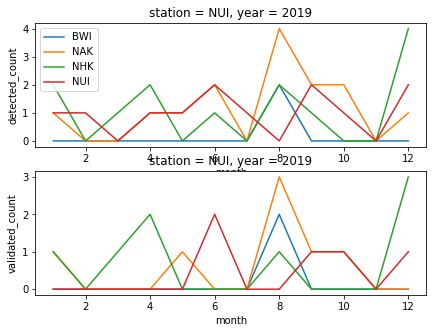

In [869]:
plot_ds = STwMRB_bb_ds.copy()

fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

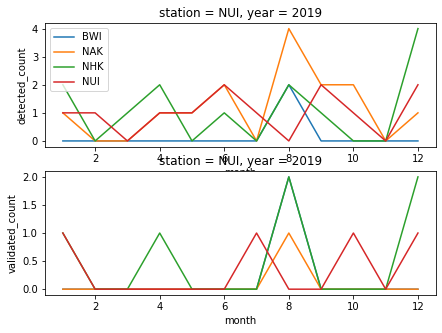

In [870]:
plot_ds = STwHGR_bb_ds.copy()

fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

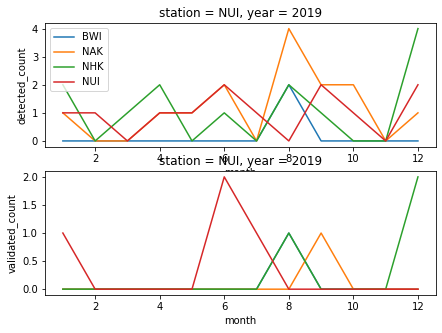

In [871]:
plot_ds = STwDCA_bb_ds.copy()

fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

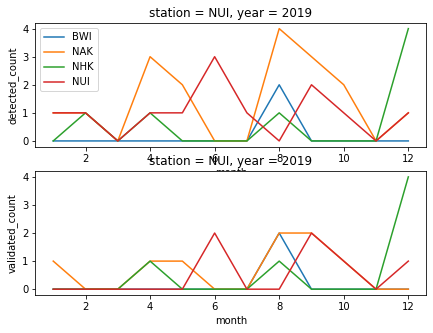

In [868]:
plot_ds = STwNewDegs_bb_ds.copy()
fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

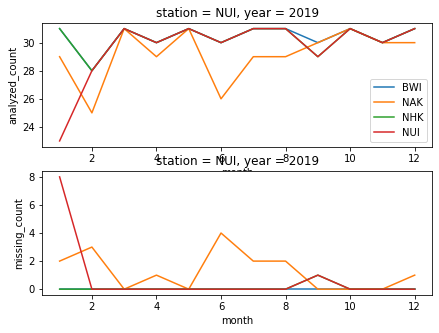

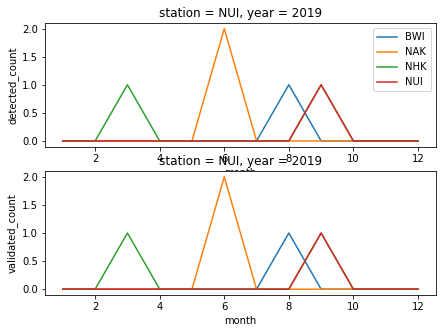

In [844]:
plot_ds = stauffer_bb_ds.copy()
fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).analyzed_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).missing_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

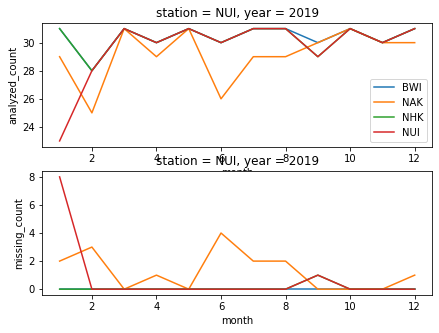

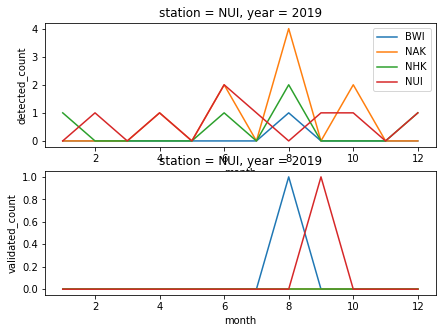

In [840]:
plot_ds = sikora_bb_ds.copy()
fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).analyzed_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).missing_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

fig,ax = plt.subplots(nrows=2,figsize=(7,5))
for stn in plot_ds.station.data:
    plot_ds.sel(station=stn).detected_count.plot(ax=ax[0],label=stn)
    plot_ds.sel(station=stn).validated_count.plot(ax=ax[1])
ax[0].legend()
plt.show()

In [444]:
test_stn = station.copy()

In [560]:
test_inland = inland_stations.copy()

In [525]:
test_stn['pcip'] = test_stn.pcip.astype('float')


In [651]:
bb_passage_ind = np.where(test_stn.datetime.data == test.passage.data)[0][0]
nt = len(test_stn.datetime.values)
test_stn.dwpt.data[bb_passage_ind:] = test_stn.dwpt.data[bb_passage_ind:]+2.0

In [657]:
test_stn.cldc.data = np.asarray(['CLR']*nt)
test_stn.pcip.data = np.zeros(nt)

In [436]:
bb_passage_ind = 22
nt = len(test_stn.datetime.values)
test_stn.wspd.data = np.zeros(nt) + 5.0
test_stn.wspd.data[bb_passage_ind:] = test_stn.wspd.data[bb_passage_ind:] + 2.0
#test_stn.wspd.data[24:42] = 0.0
test_stn.wspd.data[38] = np.nan

test_stn.wdir.data = np.ones(nt)*270.0
test_stn.wdir.data[bb_passage_ind:] = test_stn.wdir.data[bb_passage_ind:]*0.0 + 90.0

test_stn.wdir.data[45] = 260.0
test_stn.cldc.data = np.asarray(['CLR']*nt)
test_stn.pcip.data = np.zeros(nt)
#test_stn.dwpt.data = np.ones(nt)*10.0
#test_stn.dwpt.data[bb_passage_ind:] = test_stn.dwpt.data[bb_passage_ind:] + 2.0
test_stn.temp.data = np.linspace(5.0,10.0,nt)
test_stn.temp.data[bb_passage_ind:] = test_stn.temp.data[bb_passage_ind:]-1.0

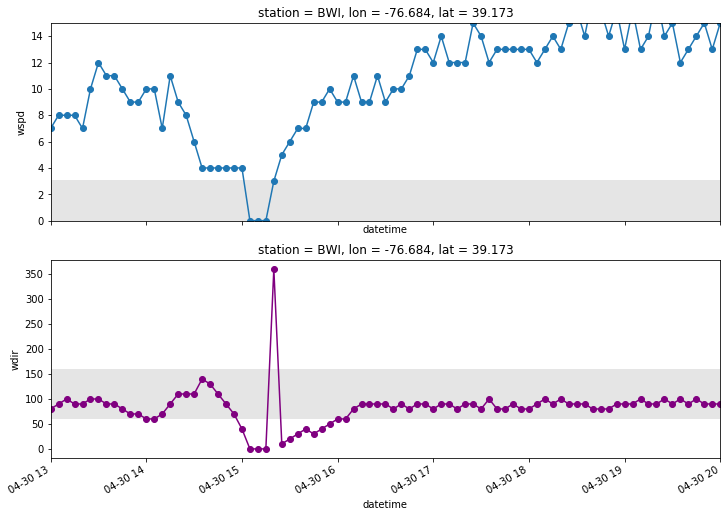

evaluating clouds
clear skies:  True
dry:  False
BAY BREEZE DETECTED


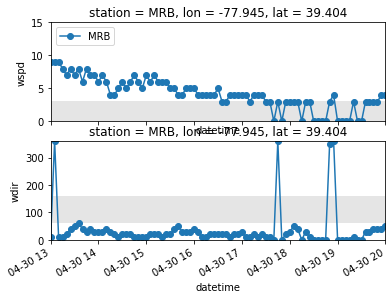

Bay Breeze Validated!


In [561]:
bay_breeze = bbd.BayBreezeDetection(test_stn,test_inland,resample=False,sample_rate='30min',
                                        show_plot=True,method=detection_method,verbose=False)

bay breeze validated for 4/30/2019


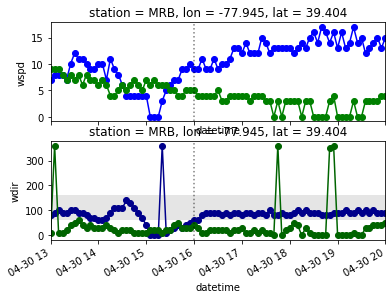

In [712]:
test = DetectBayBreeze(test_stn,inland=test_inland,verbose=False,resample=False,
                       sample_rate='10min',show_plot=True,method='StaufferThompson2015')

starting station: APG
Year: 2019


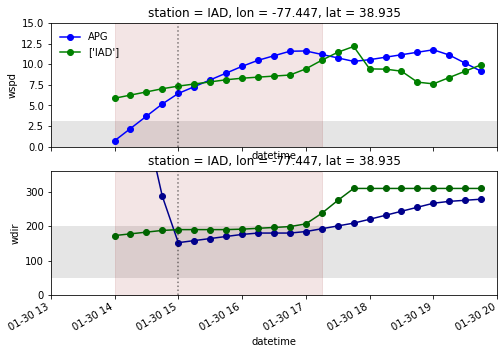

bay breeze validated for 3/19/2019


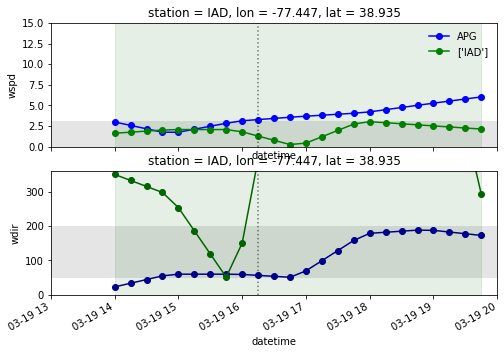

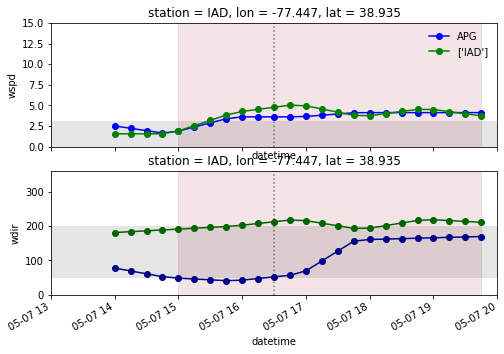

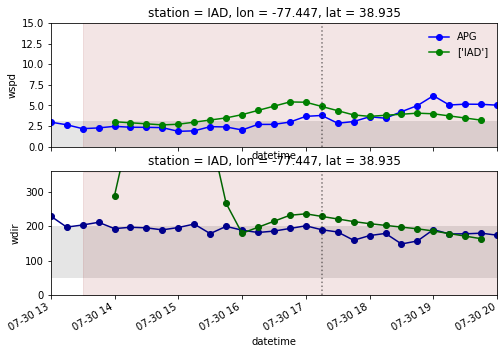

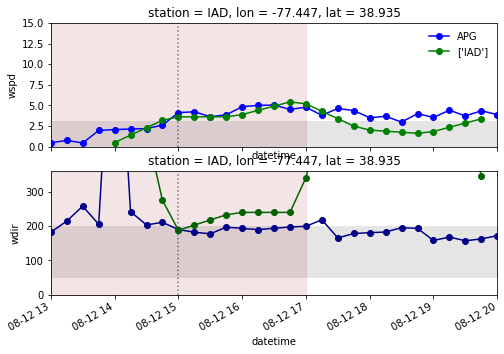

bay breeze validated for 8/20/2019


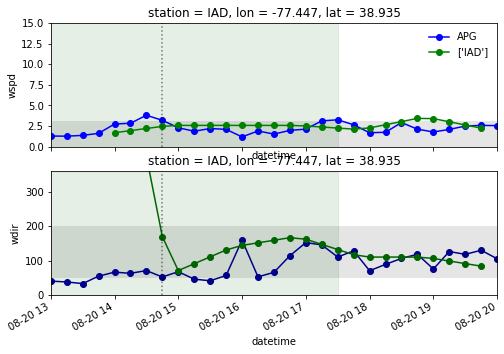

bay breeze validated for 10/28/2019


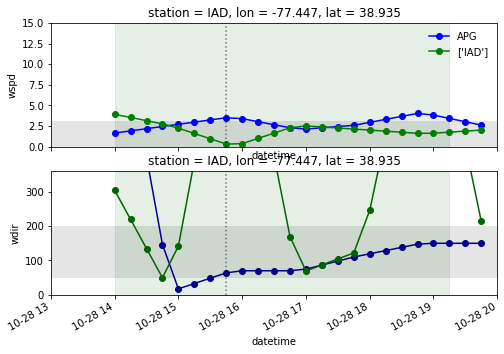

starting station: BWI
Year: 2019
bay breeze validated for 7/26/2019


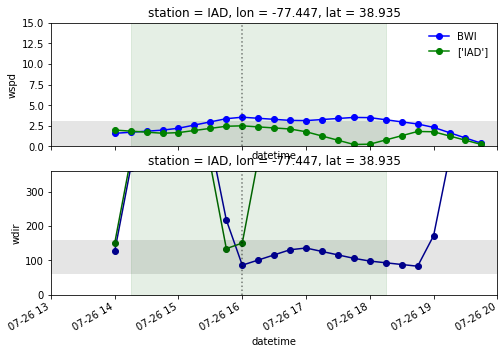

bay breeze validated for 8/20/2019


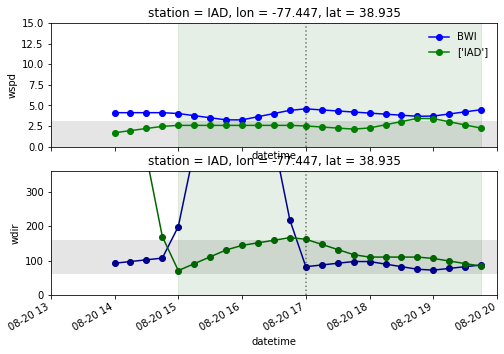

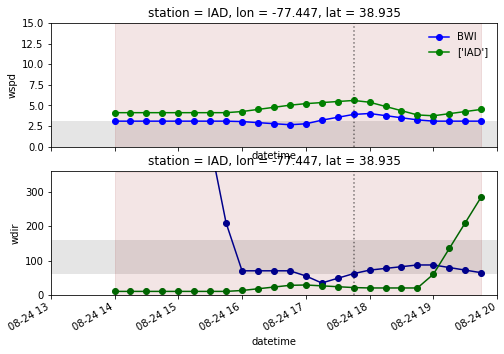

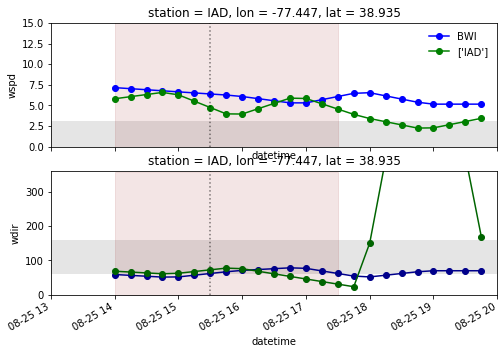

bay breeze validated for 10/28/2019


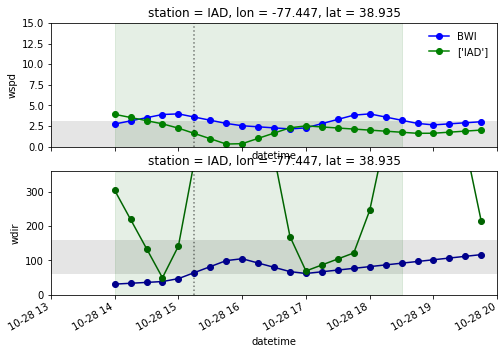

starting station: MTN
Year: 2019


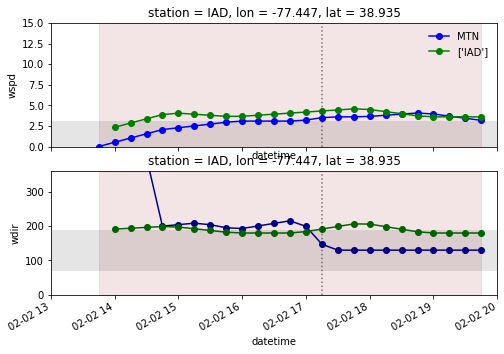

bay breeze validated for 2/4/2019


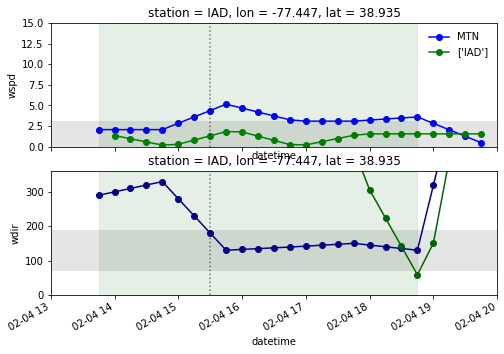

bay breeze validated for 3/19/2019


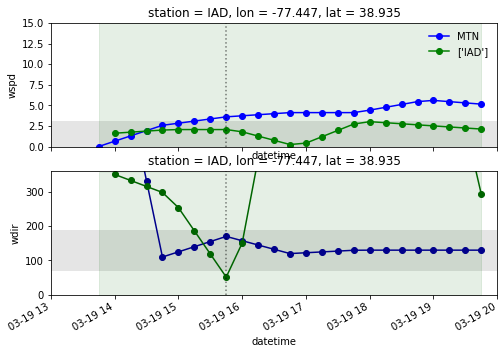

bay breeze validated for 4/6/2019


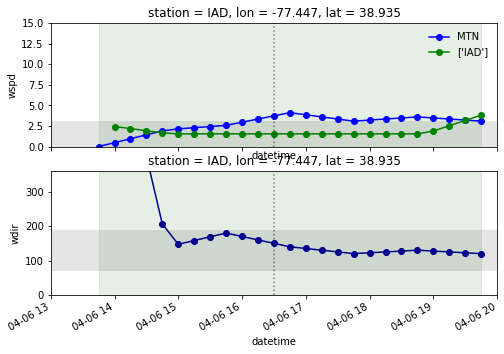

bay breeze validated for 6/17/2019


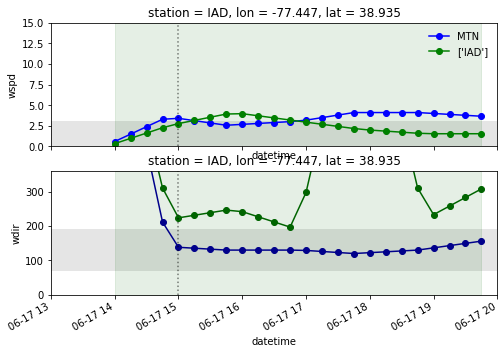

bay breeze validated for 6/26/2019


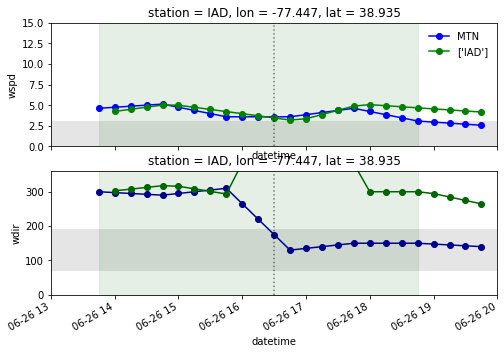

bay breeze validated for 6/27/2019


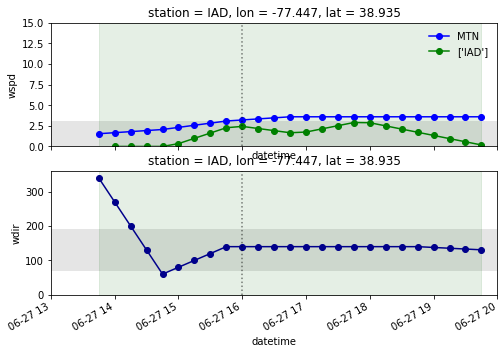

bay breeze validated for 6/28/2019


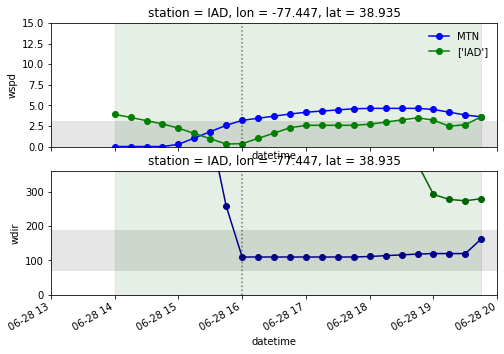

bay breeze validated for 7/9/2019


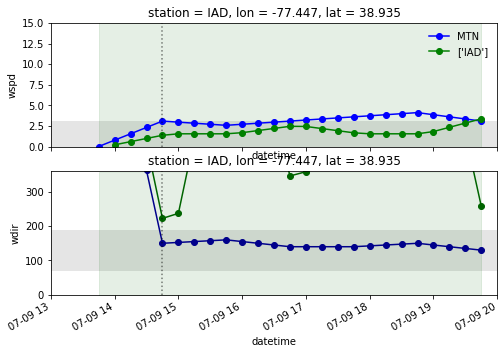

bay breeze validated for 7/15/2019


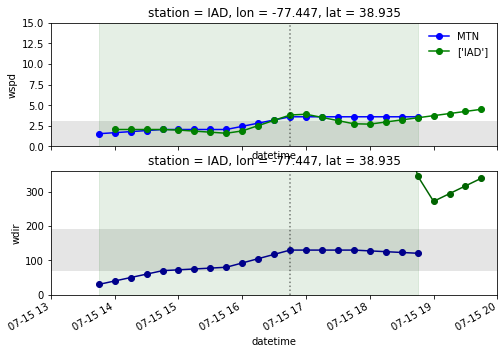

bay breeze validated for 7/19/2019


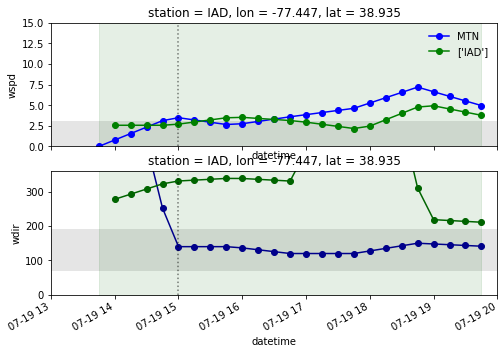

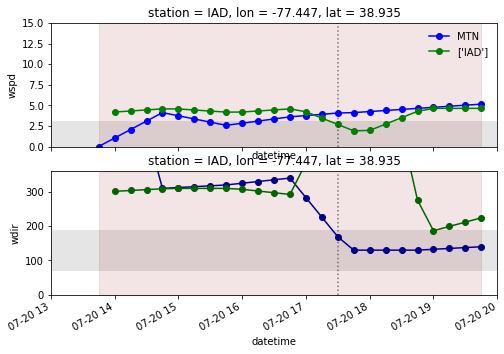

bay breeze validated for 7/26/2019


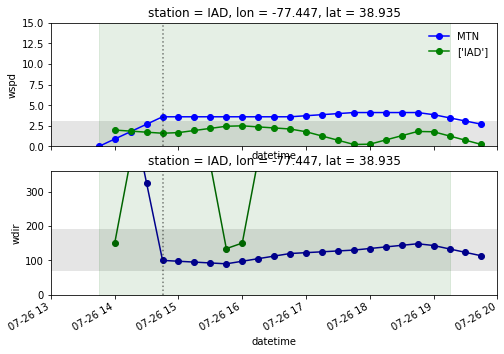

bay breeze validated for 7/27/2019


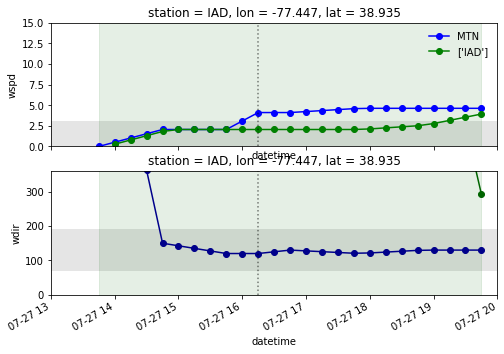

bay breeze validated for 7/29/2019


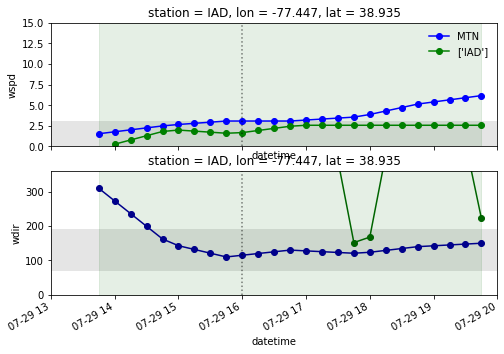

bay breeze validated for 8/1/2019


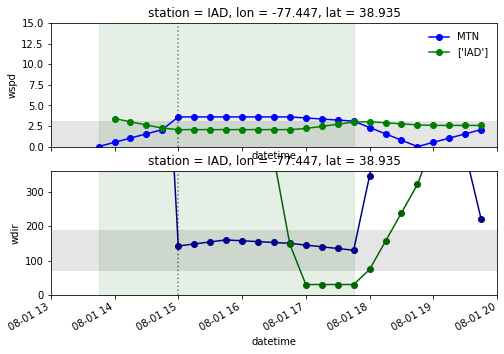

bay breeze validated for 8/3/2019


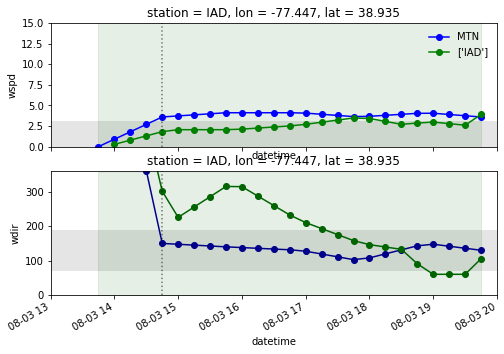

bay breeze validated for 8/11/2019


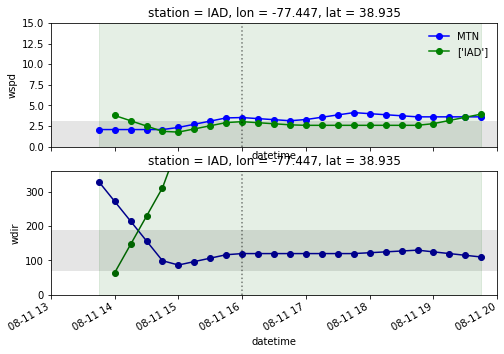

bay breeze validated for 8/12/2019


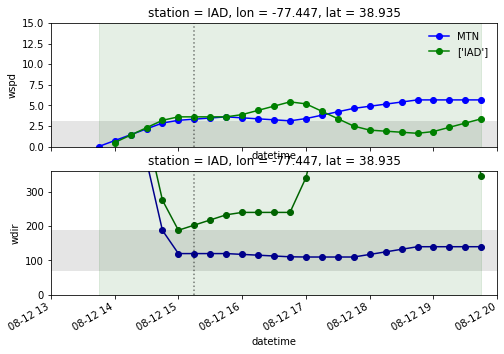

bay breeze validated for 8/19/2019


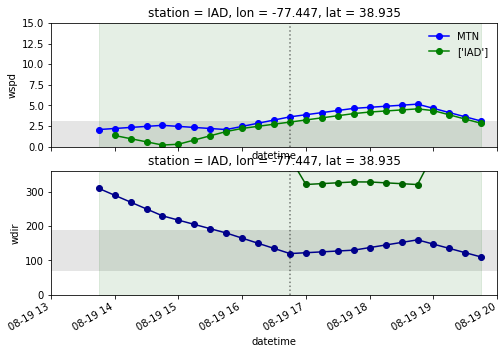

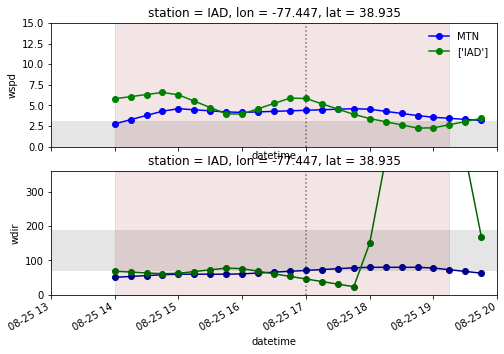

bay breeze validated for 8/30/2019


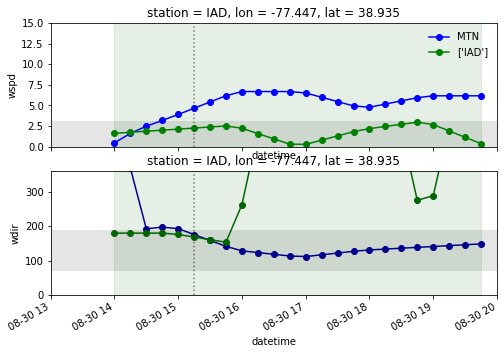

bay breeze validated for 9/11/2019


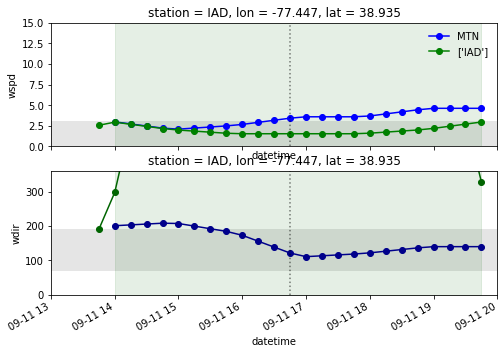

bay breeze validated for 9/18/2019


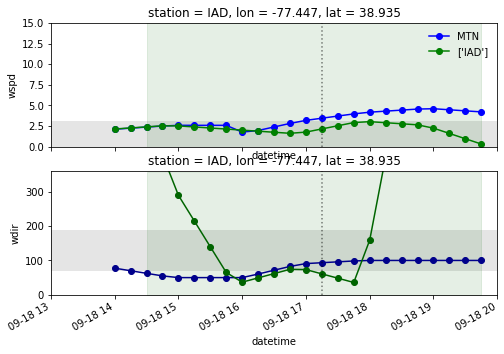

bay breeze validated for 9/20/2019


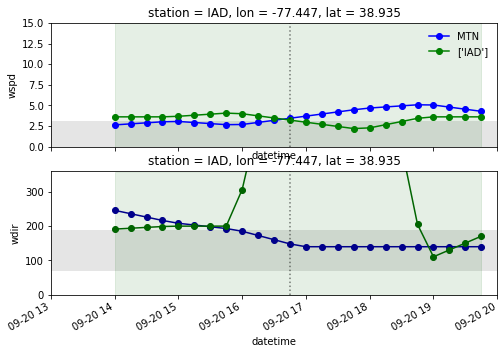

bay breeze validated for 9/22/2019


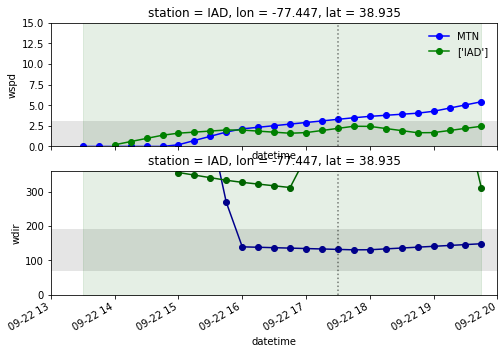

bay breeze validated for 9/25/2019


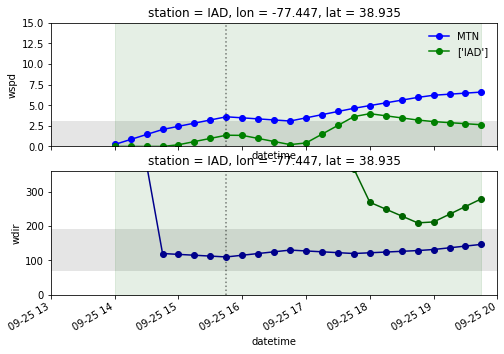

bay breeze validated for 10/19/2019


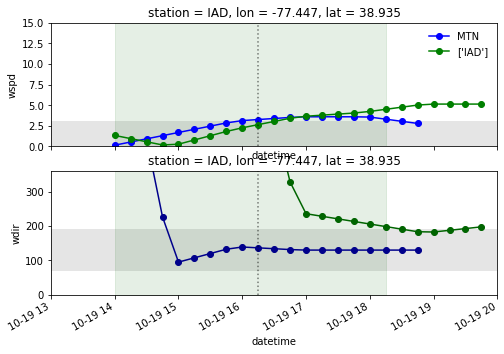

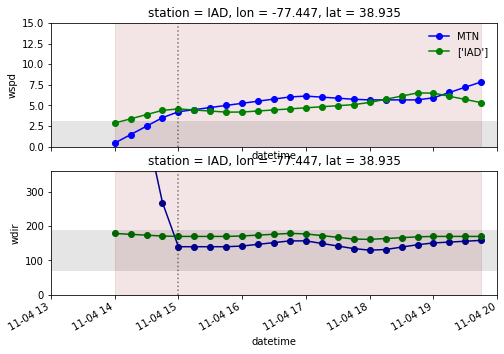

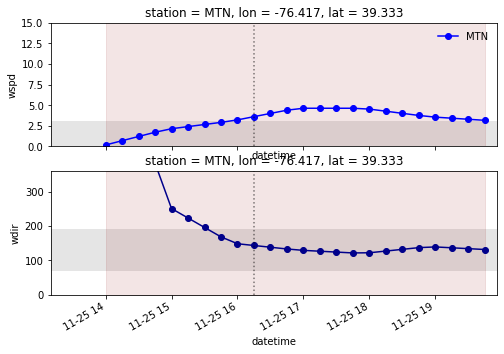

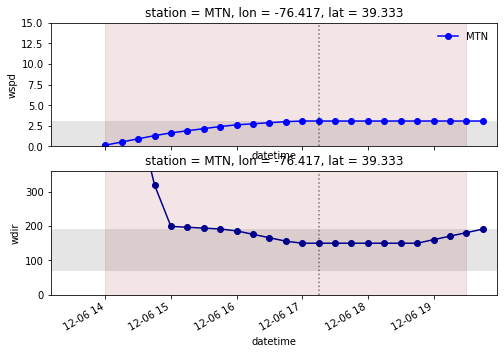

starting station: NAK
Year: 2019


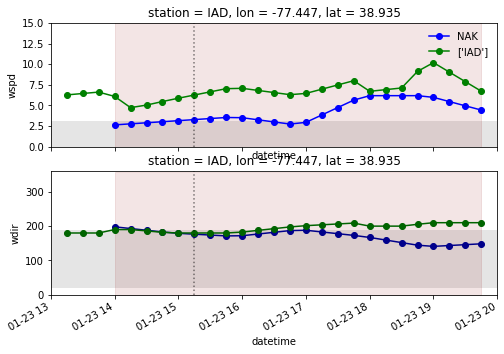

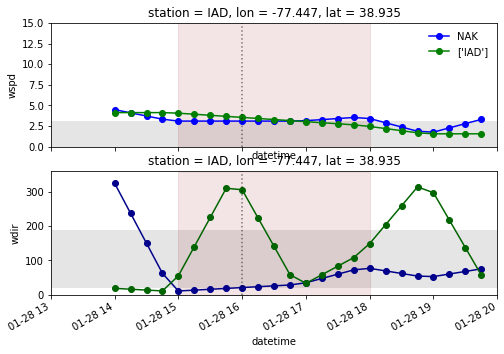

bay breeze validated for 2/5/2019


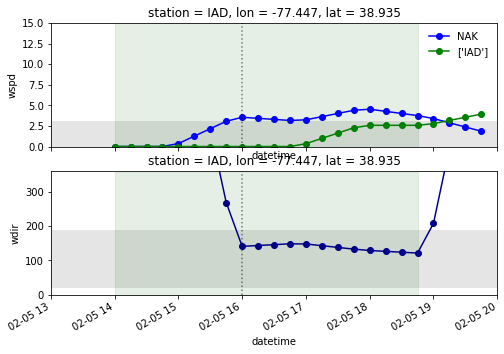

bay breeze validated for 2/10/2019


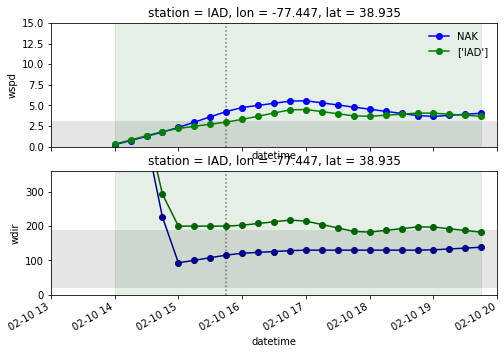

bay breeze validated for 2/14/2019


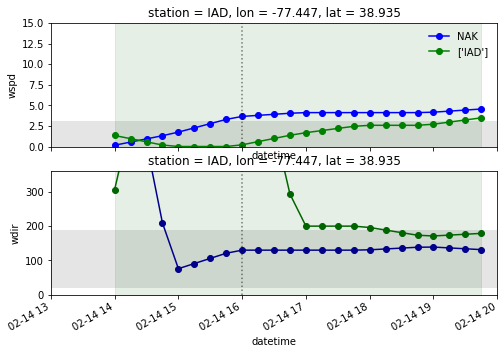

bay breeze validated for 2/28/2019


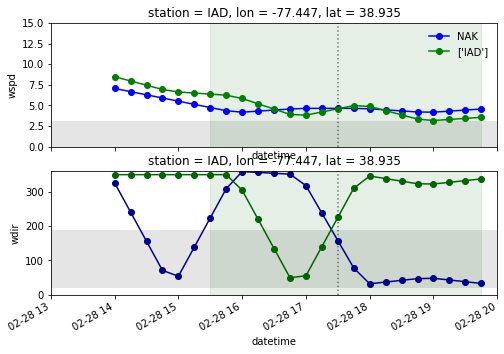

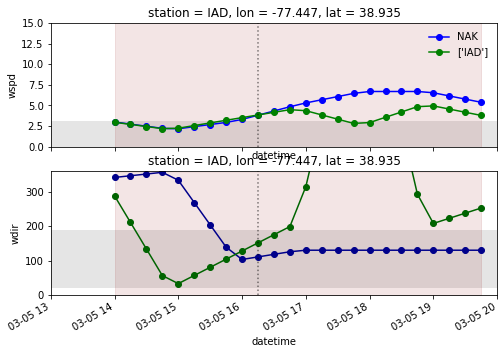

bay breeze validated for 3/19/2019


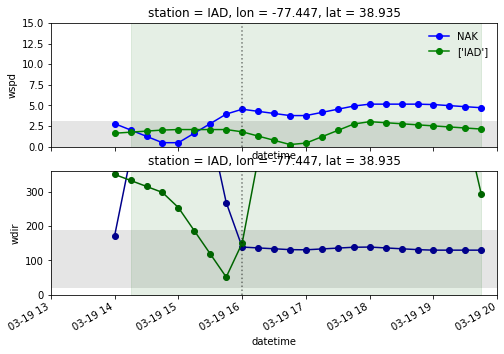

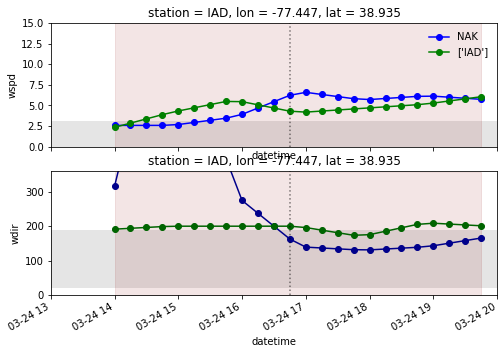

bay breeze validated for 4/6/2019


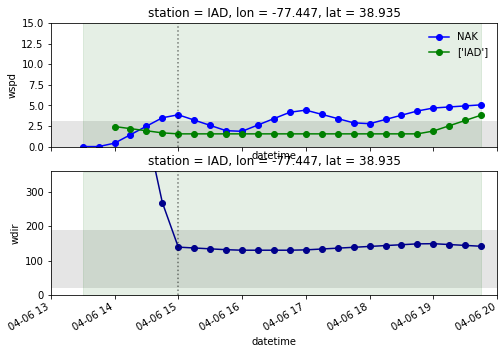

bay breeze validated for 4/17/2019


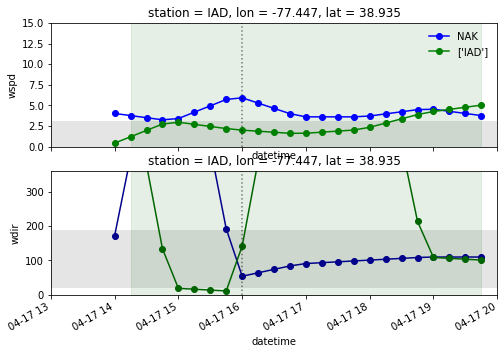

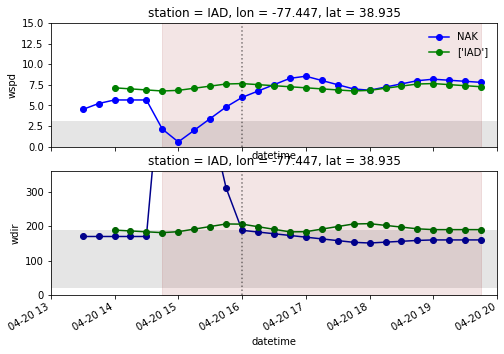

bay breeze validated for 4/21/2019


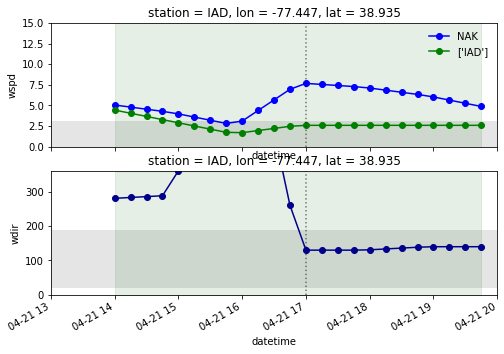

bay breeze validated for 5/2/2019


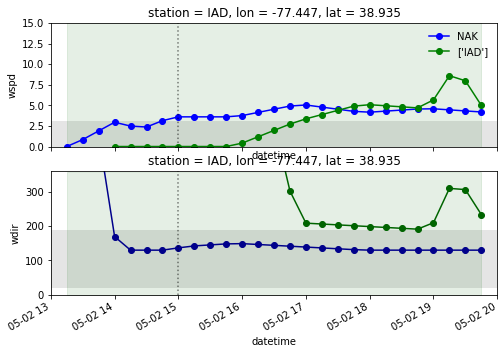

bay breeze validated for 5/6/2019


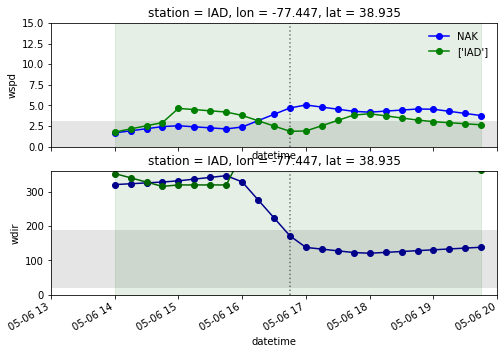

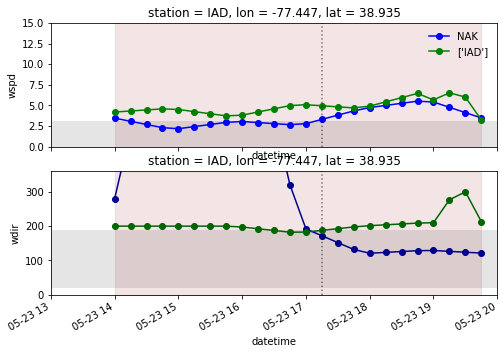

bay breeze validated for 5/30/2019


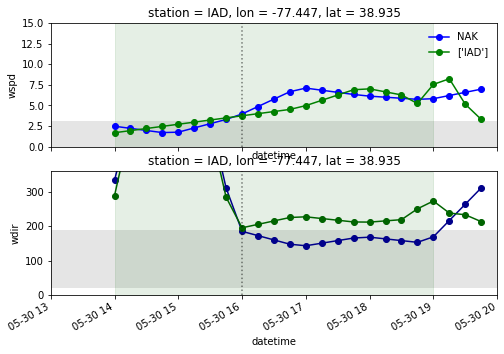

bay breeze validated for 6/17/2019


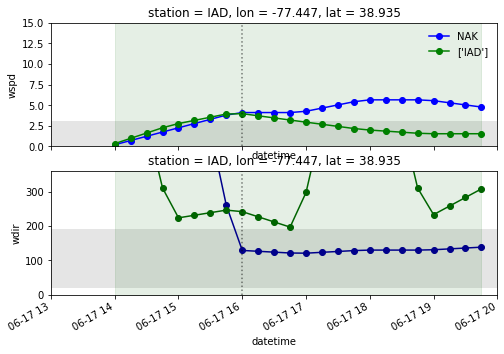

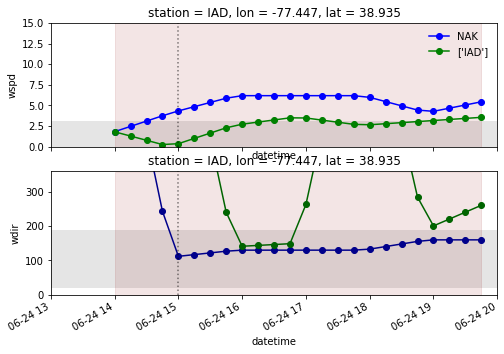

bay breeze validated for 6/26/2019


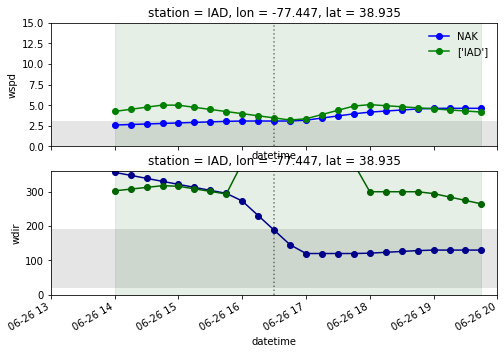

bay breeze validated for 6/27/2019


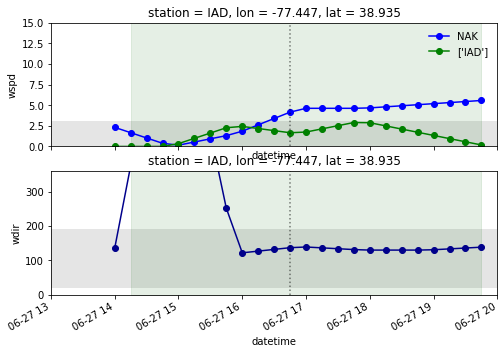

bay breeze validated for 6/28/2019


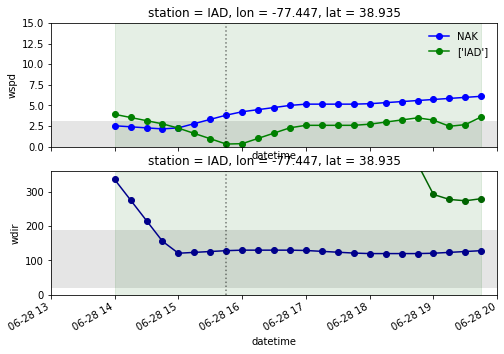

bay breeze validated for 7/9/2019


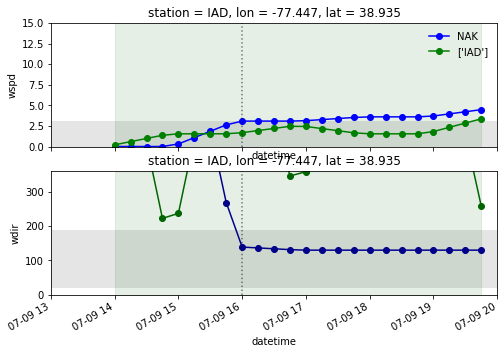

bay breeze validated for 7/15/2019


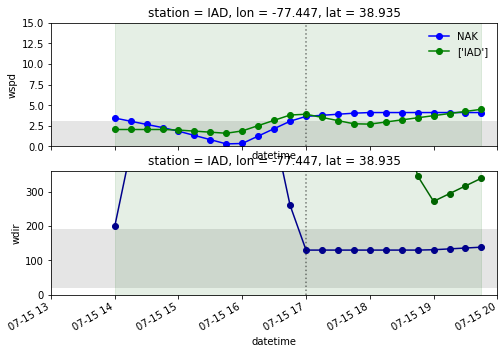

bay breeze validated for 7/17/2019


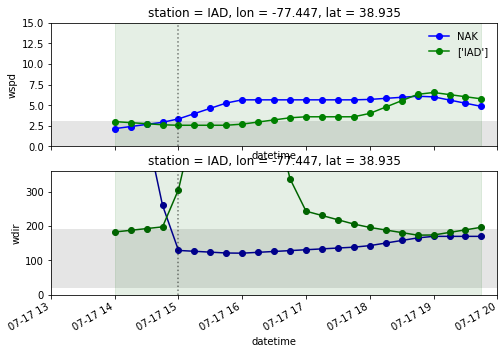

bay breeze validated for 7/19/2019


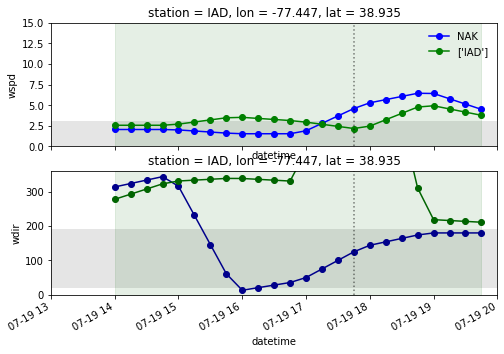

bay breeze validated for 7/26/2019


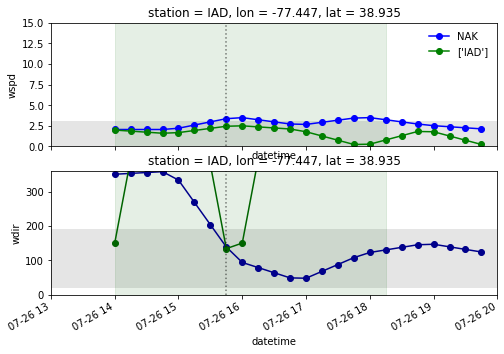

bay breeze validated for 7/28/2019


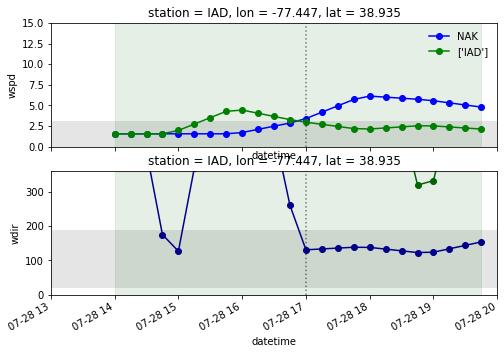

bay breeze validated for 7/29/2019


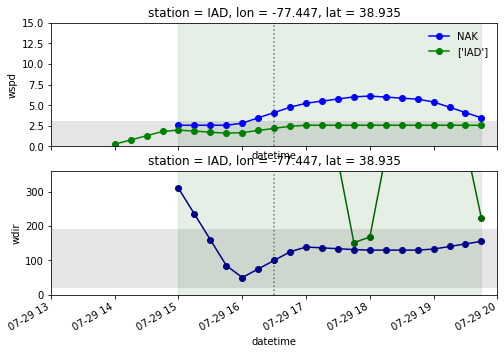

bay breeze validated for 7/31/2019


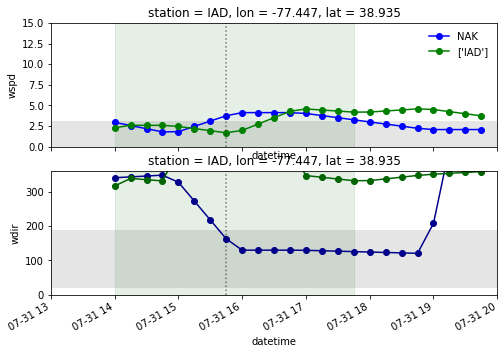

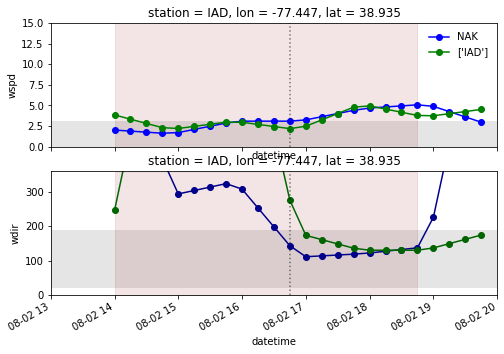

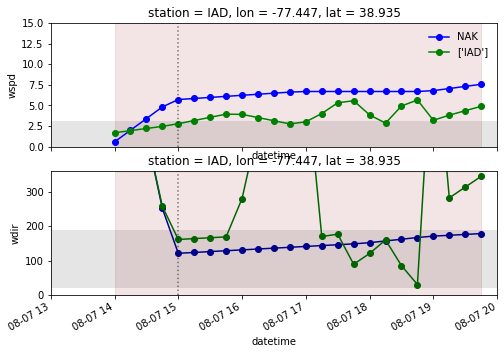

bay breeze validated for 8/11/2019


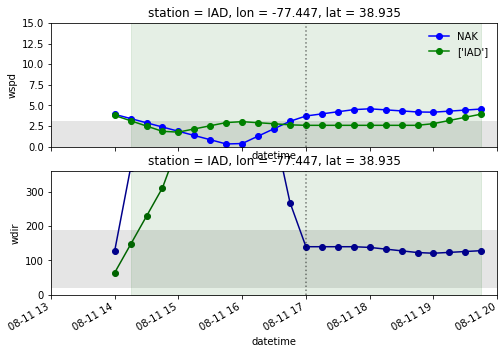

bay breeze validated for 8/19/2019


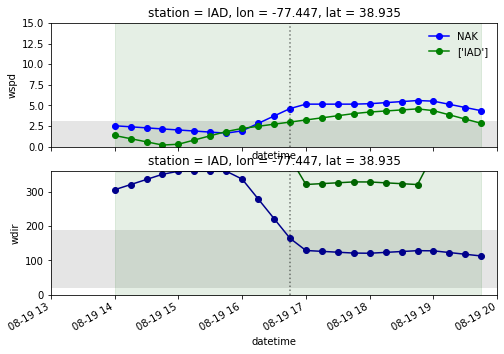

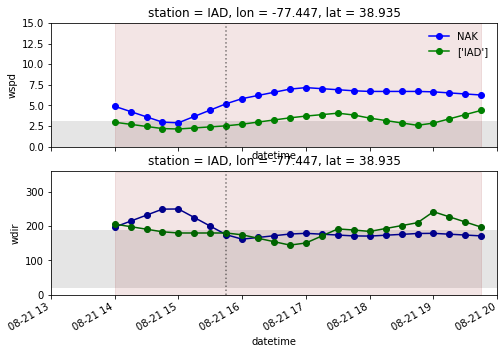

bay breeze validated for 9/7/2019


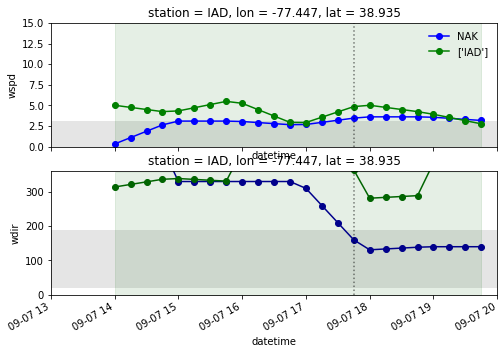

bay breeze validated for 9/8/2019


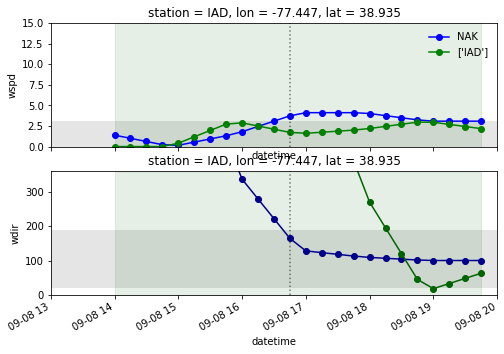

bay breeze validated for 9/11/2019


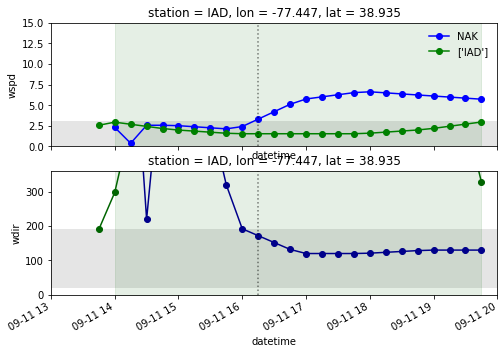

bay breeze validated for 9/16/2019


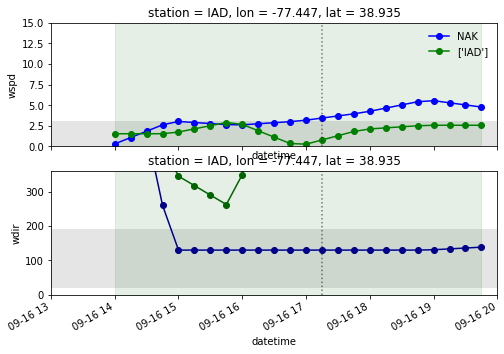

bay breeze validated for 9/20/2019


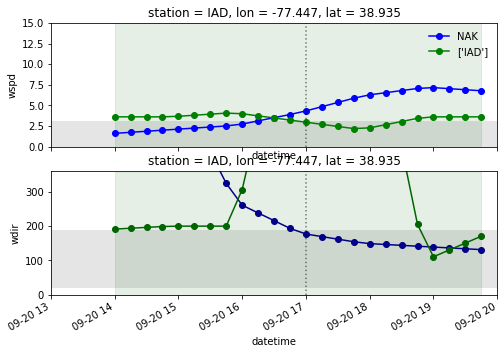

bay breeze validated for 9/21/2019


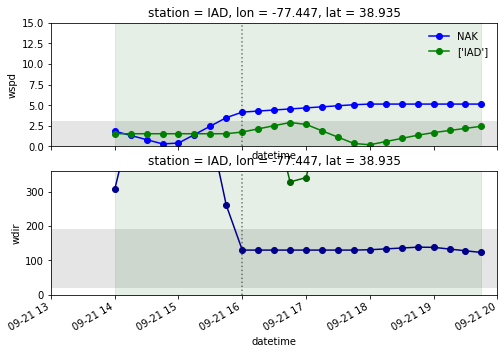

bay breeze validated for 9/23/2019


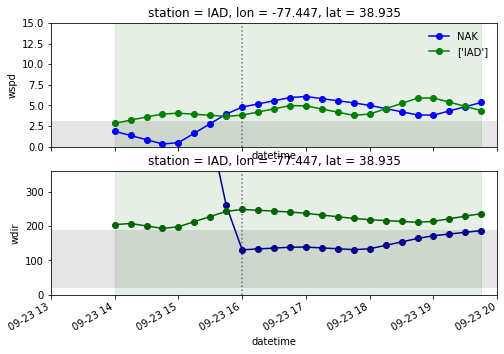

bay breeze validated for 9/25/2019


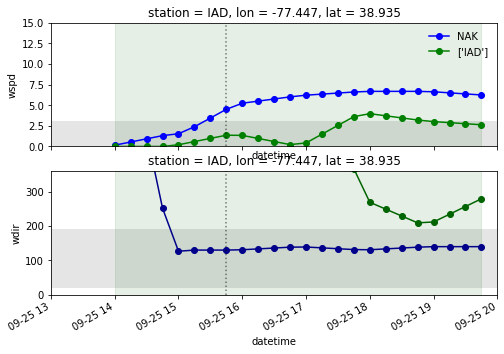

bay breeze validated for 10/7/2019


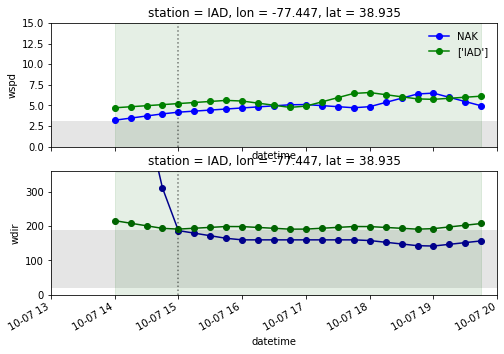

bay breeze validated for 10/24/2019


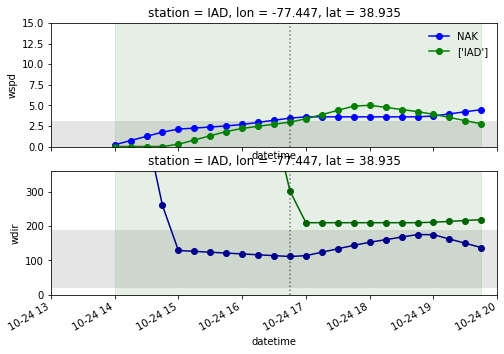

bay breeze validated for 11/2/2019


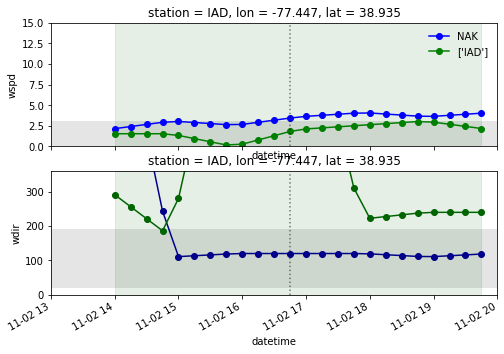

bay breeze validated for 11/6/2019


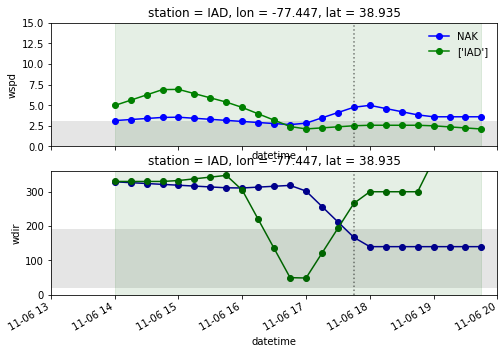

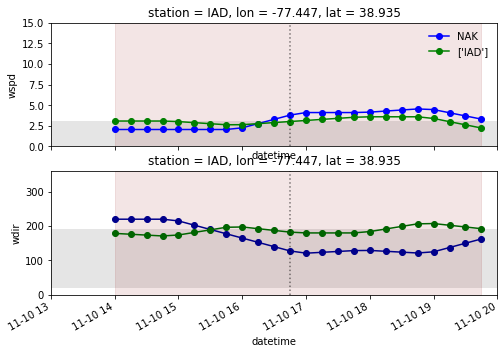

bay breeze validated for 11/11/2019


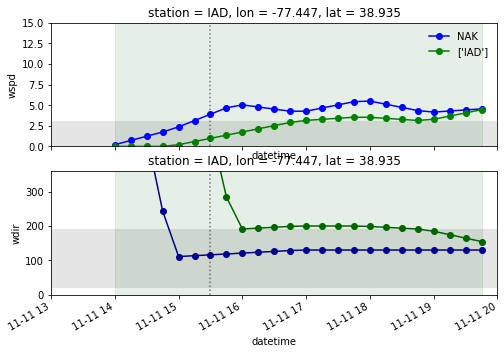

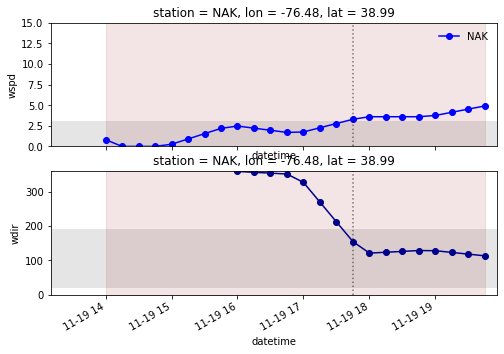

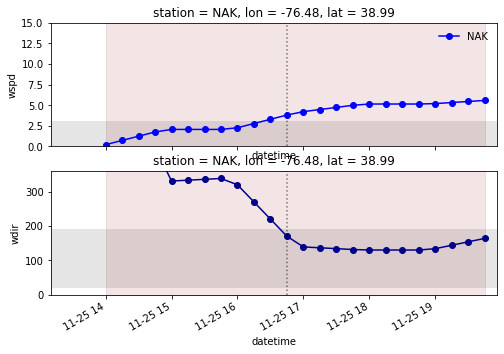

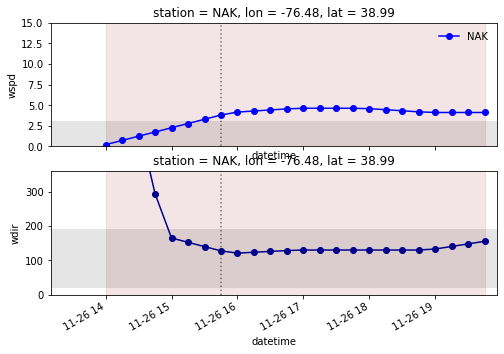

starting station: NHK
Year: 2019
bay breeze validated for 2/2/2019


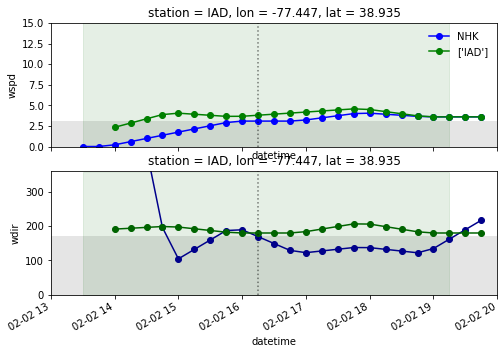

bay breeze validated for 2/10/2019


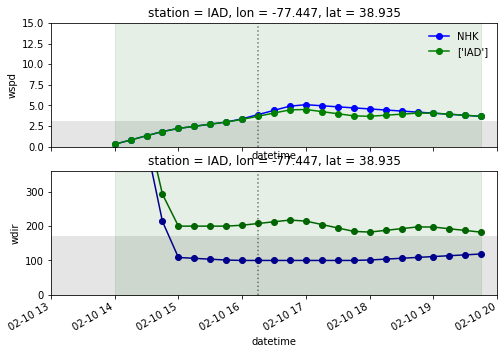

bay breeze validated for 2/14/2019


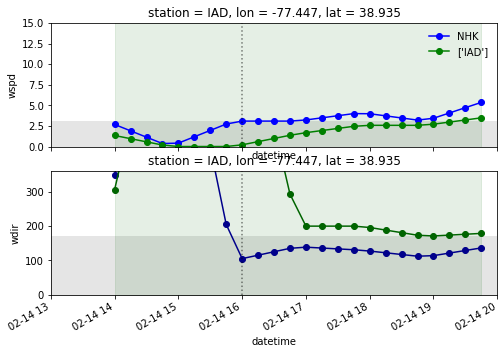

bay breeze validated for 2/26/2019


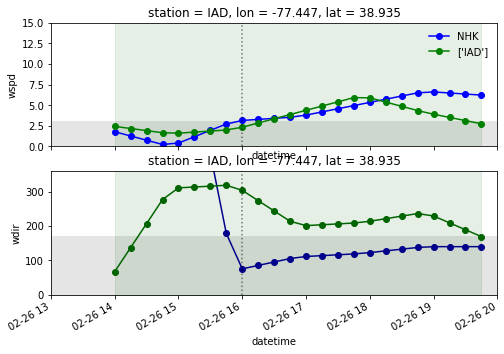

bay breeze validated for 3/14/2019


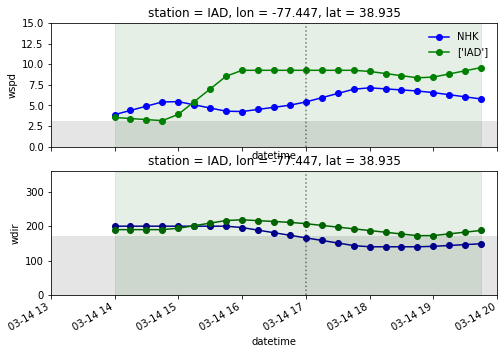

bay breeze validated for 3/17/2019


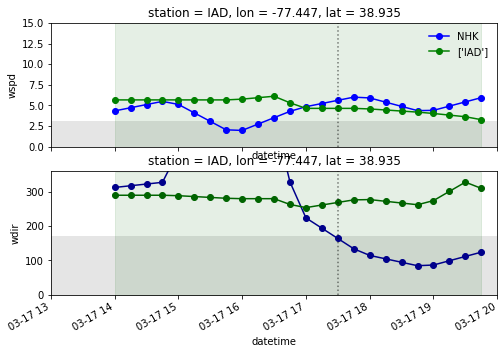

bay breeze validated for 4/1/2019


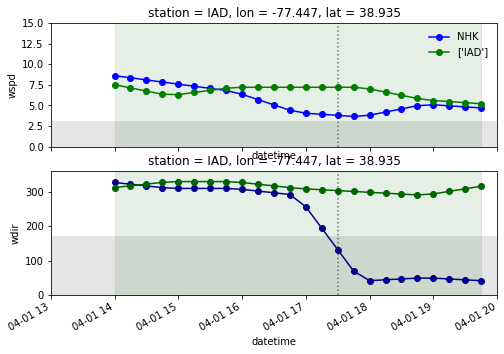

bay breeze validated for 4/10/2019


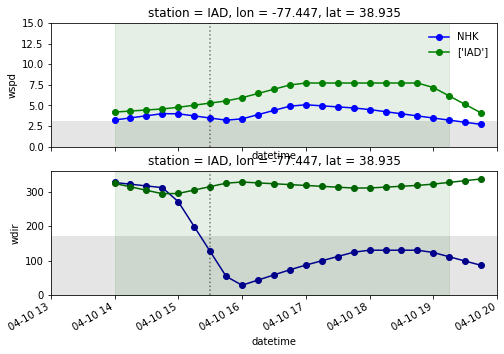

bay breeze validated for 4/21/2019


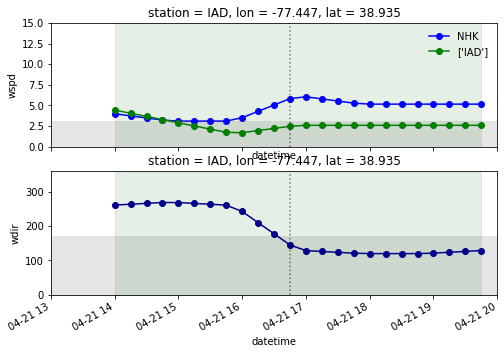

bay breeze validated for 5/7/2019


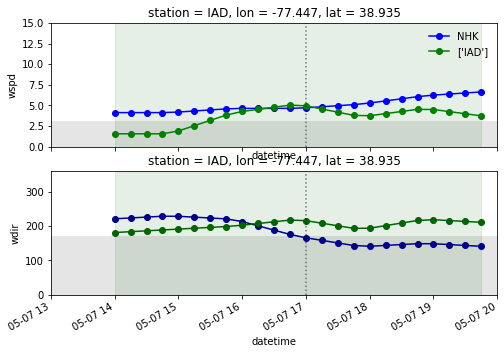

bay breeze validated for 5/16/2019


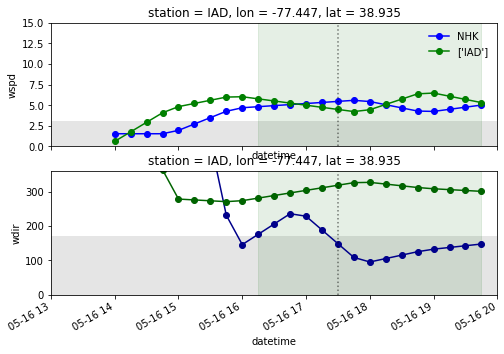

bay breeze validated for 6/17/2019


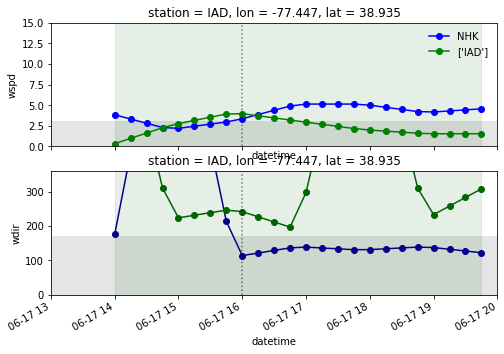

bay breeze validated for 6/23/2019


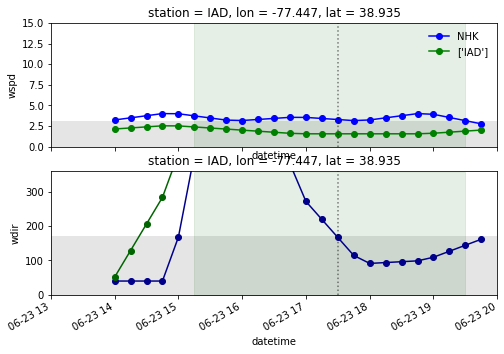

bay breeze validated for 6/24/2019


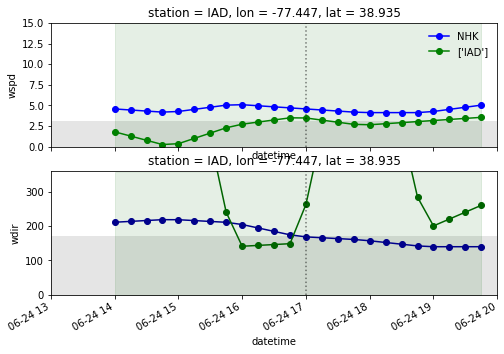

bay breeze validated for 6/28/2019


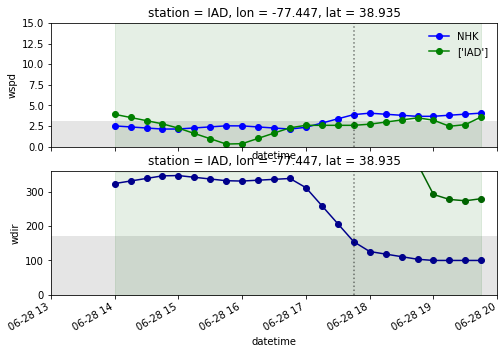

bay breeze validated for 7/10/2019


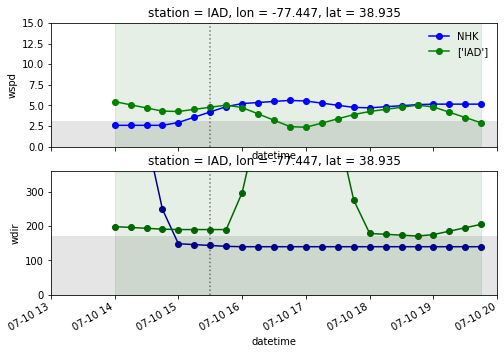

bay breeze validated for 7/16/2019


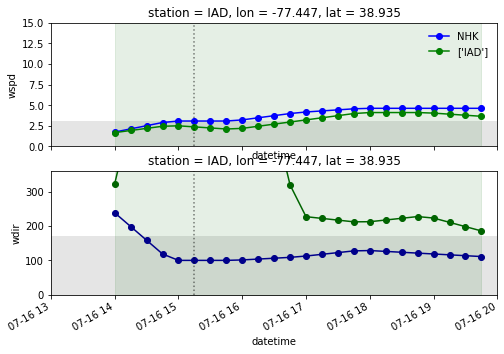

bay breeze validated for 7/19/2019


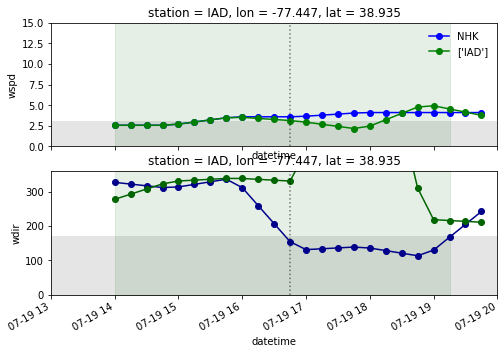

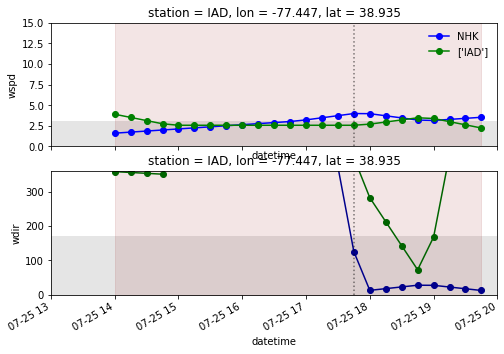

bay breeze validated for 7/27/2019


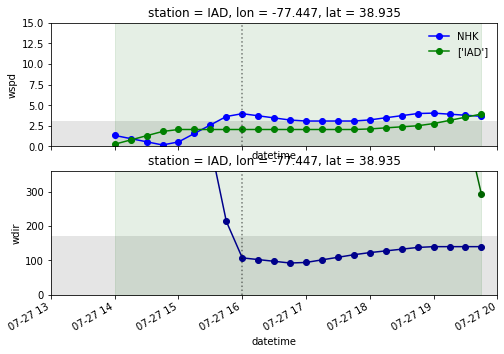

bay breeze validated for 7/28/2019


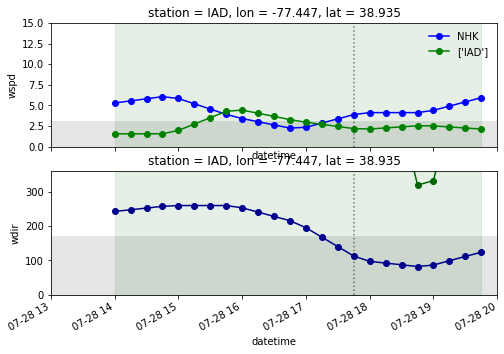

bay breeze validated for 7/29/2019


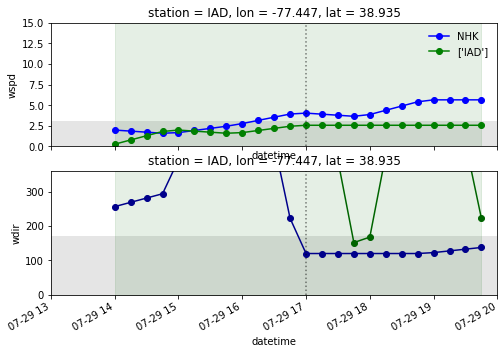

bay breeze validated for 7/30/2019


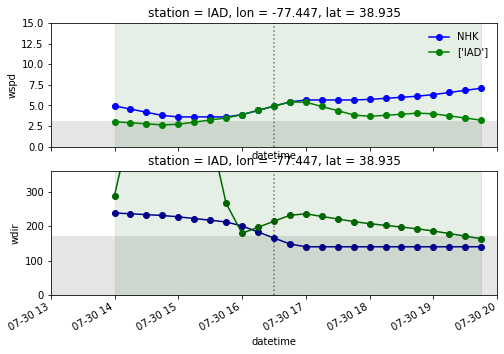

bay breeze validated for 7/31/2019


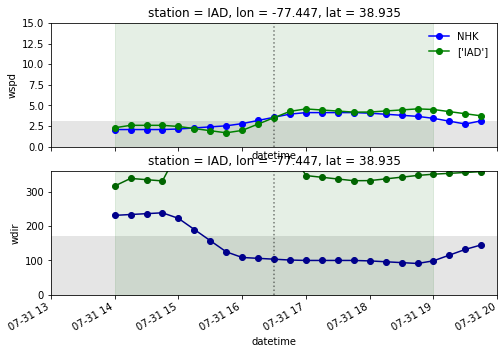

bay breeze validated for 8/1/2019


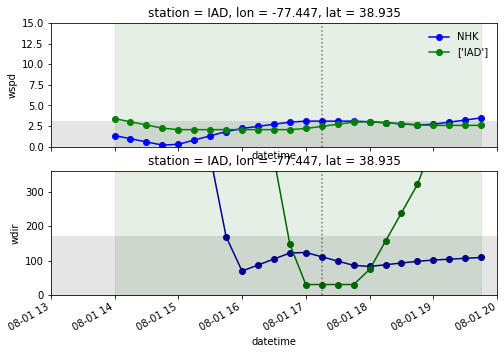

bay breeze validated for 8/17/2019


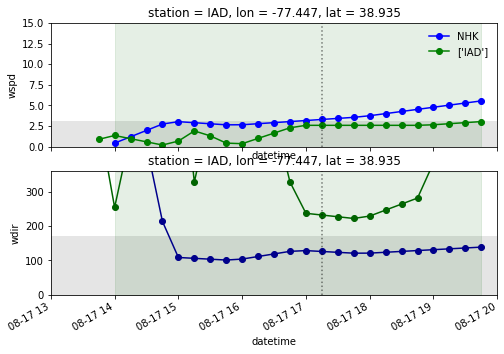

bay breeze validated for 9/16/2019


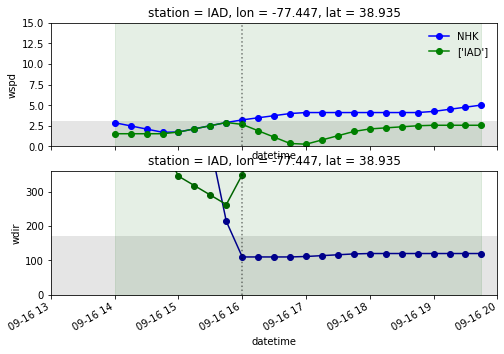

bay breeze validated for 9/20/2019


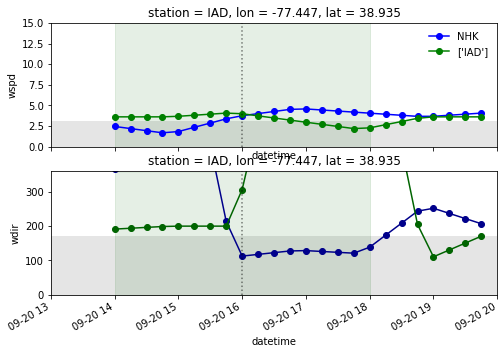

bay breeze validated for 9/21/2019


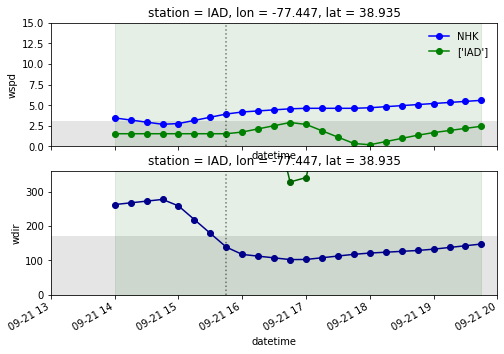

bay breeze validated for 9/22/2019


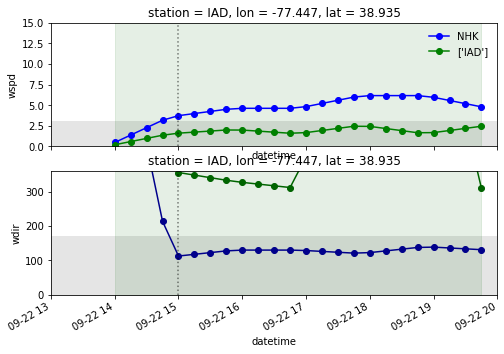

bay breeze validated for 9/25/2019


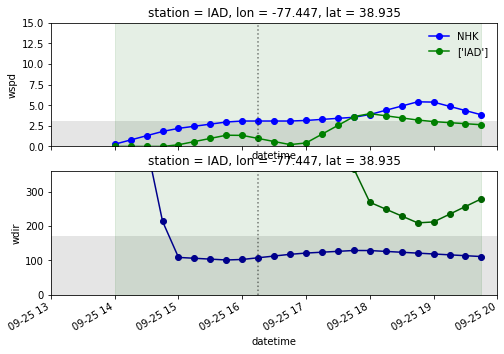

bay breeze validated for 10/1/2019


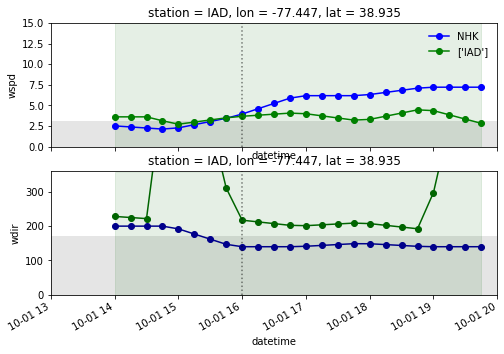

bay breeze validated for 10/11/2019


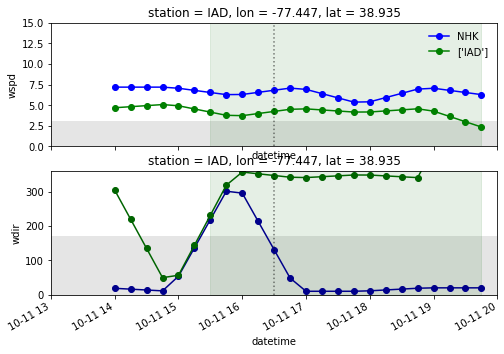

bay breeze validated for 10/12/2019


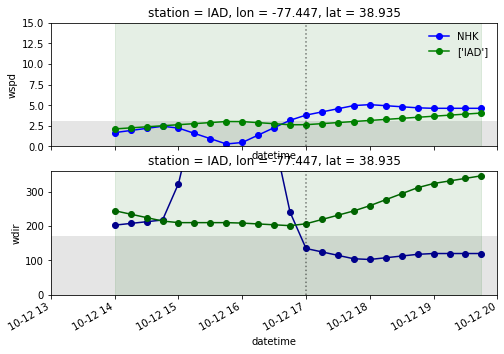

bay breeze validated for 10/19/2019


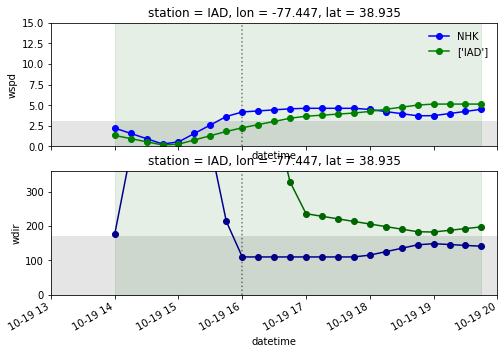

bay breeze validated for 11/2/2019


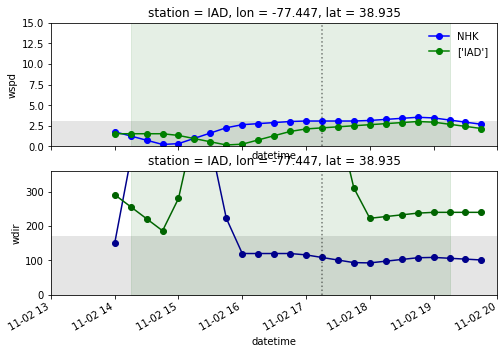

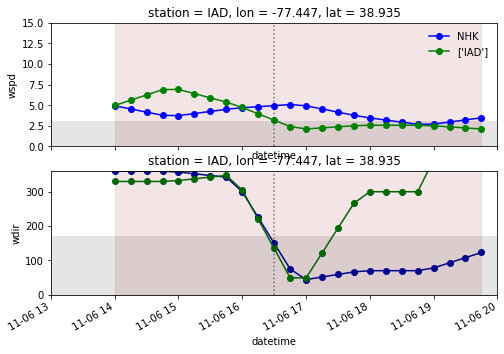

bay breeze validated for 11/11/2019


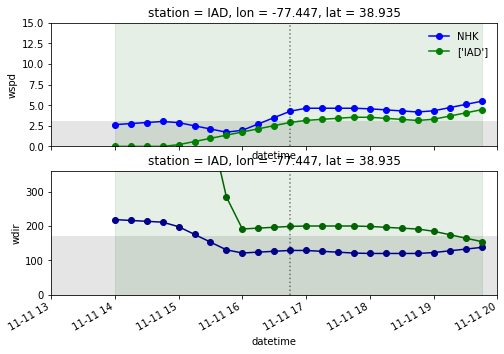

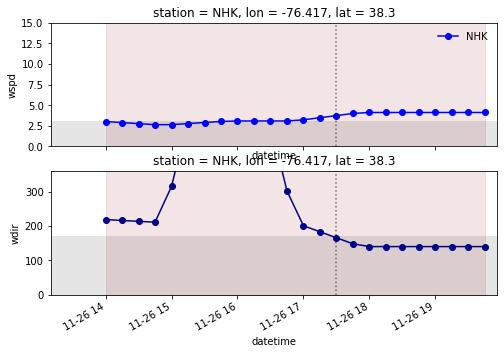

starting station: NUI
Year: 2019


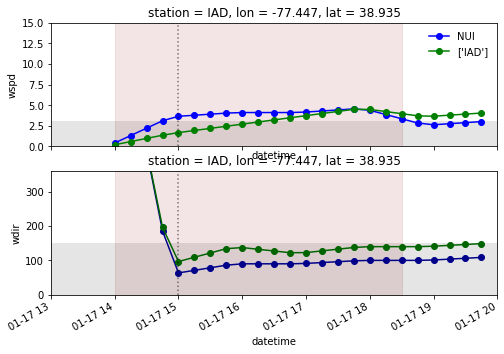

bay breeze validated for 2/26/2019


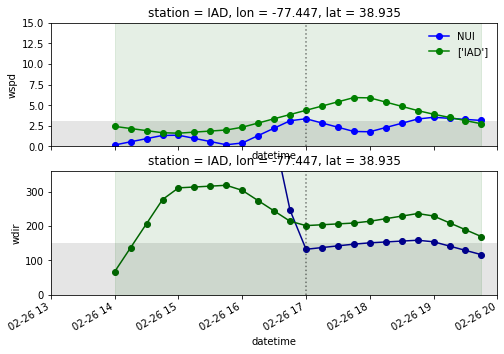

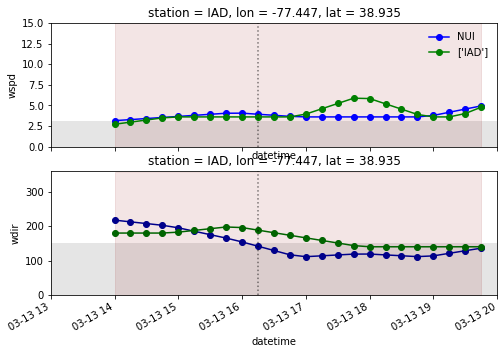

bay breeze validated for 3/28/2019


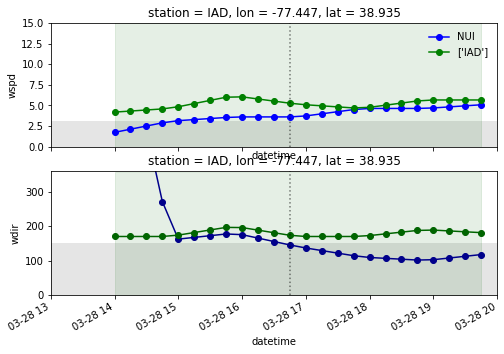

bay breeze validated for 4/7/2019


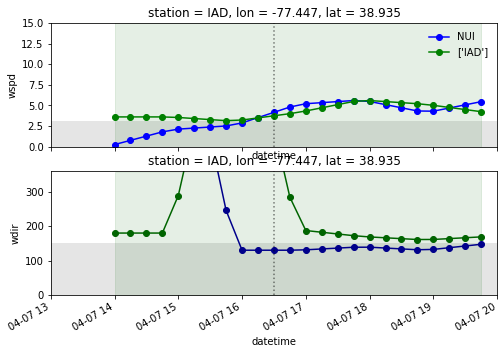

bay breeze validated for 4/17/2019


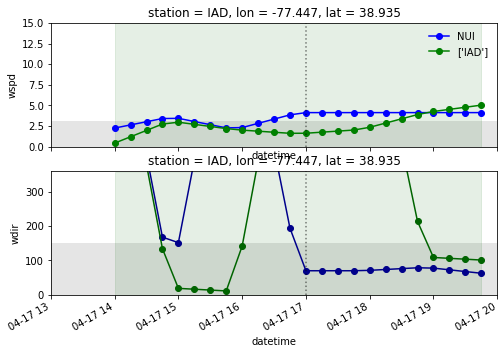

bay breeze validated for 5/4/2019


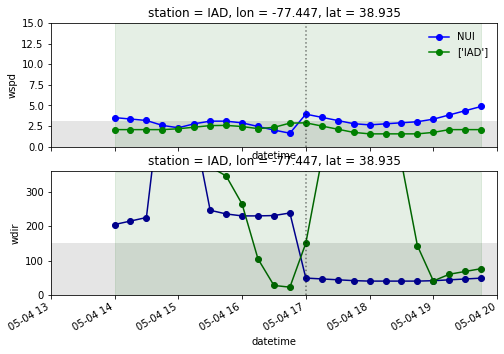

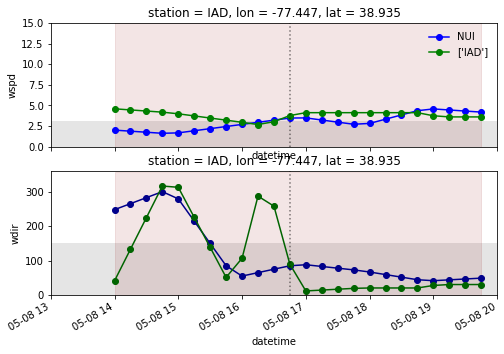

bay breeze validated for 7/10/2019


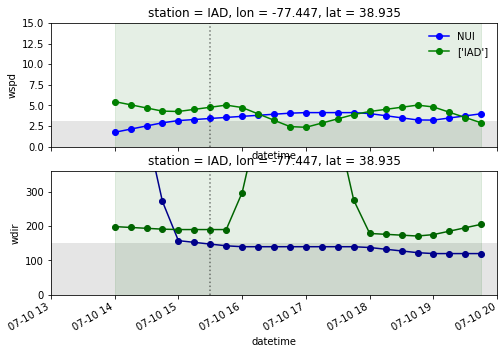

bay breeze validated for 7/24/2019


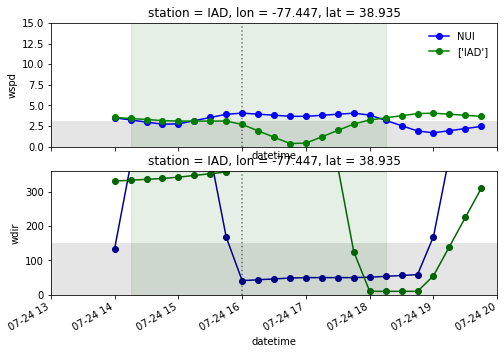

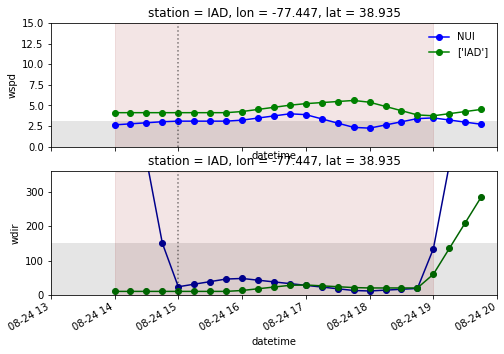

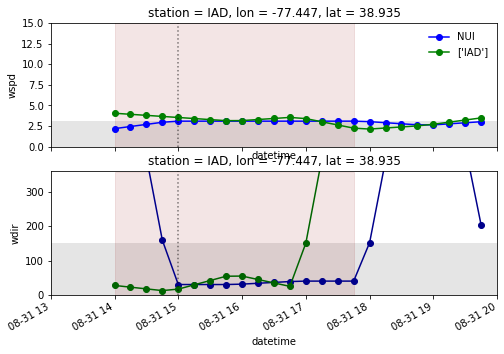

bay breeze validated for 9/8/2019


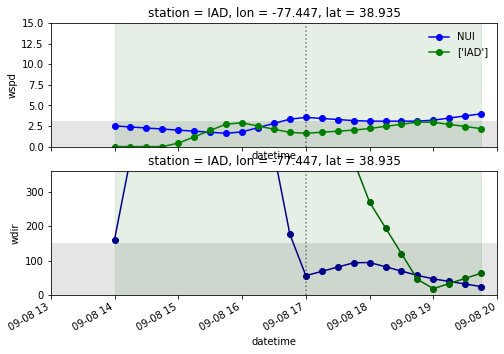

bay breeze validated for 10/7/2019


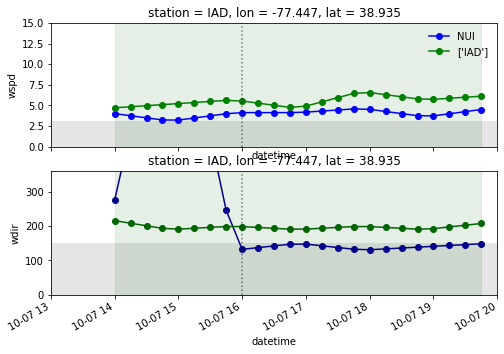

bay breeze validated for 11/4/2019


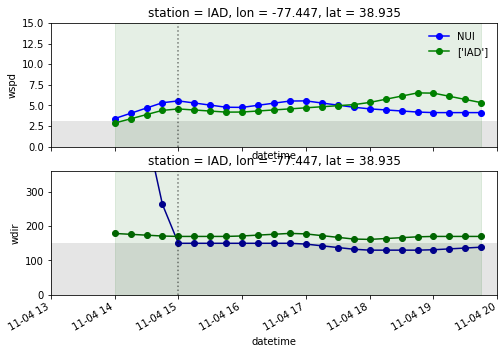

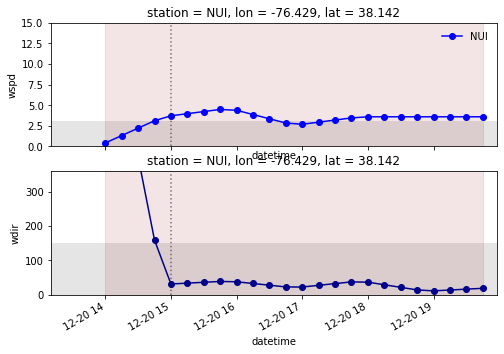

In [466]:
#month_count = np.zeros((nstations,period_len))
near_shore_station_num = len(near_shore_stations)
missing_days   = np.zeros((near_shore_station_num,nyears,12)) 
analyzed_days  = np.zeros((near_shore_station_num,nyears,12)) 
detected_days  = np.zeros((near_shore_station_num,nyears,12)) 
validated_days = np.zeros((near_shore_station_num,nyears,12)) 

for ss,stn in enumerate(near_shore_stations):   
    print('starting station: {}'.format(stn))
    ds               = ds_stn.sel(station=stn)
#    if stn == 'NAK':
#        ds['onshore_min'] = 50
#        ds['onshore_max'] = 170
#    elif stn == 'NHK':
#        ds['onshore_min'] = 10
#        ds['onshore_max'] = 130
#    elif stn == 'NUI':
#        ds['onshore_min'] = 20
#        ds['onshore_max'] = 140
#    elif stn == 'MTN':
#        ds['onshore_min'] = 80
#        ds['onshore_max'] = 180
#    elif stn == 'APG':
#        ds['onshore_min'] = 60
#        ds['onshore_max'] = 180

    inland_stationsf = ds_stn.sel(station=inland_station_names)
    bay_breeze_days = []
    if ss == 0:
        bay_breeze_detected  = []
        bay_breeze_validated = []
        bay_breeze_day_dict  = {}
        days                 = []

    elif ss == 1:
        bay_breeze_detected_f       = np.asarray([[None]*day_count]*near_shore_station_num)
        bay_breeze_detected_f[0,:]  = bay_breeze_detected
        bay_breeze_validated_f      = np.asarray([[None]*day_count]*near_shore_station_num)
        bay_breeze_validated_f[0,:] = bay_breeze_validated

    day_count = 0

    for yy,year in enumerate(year_range):
        print('Year: {}'.format(year))
        period_start = pd.to_datetime('{0}-{1:0d}-01 00:00:00'.format(year,month_start))
        period_end   = pd.to_datetime('{0}-{1:0d}-01 00:00:00'.format(year,month_start)) + \
                       pd.Timedelta(period_len, 'M').floor('D') - pd.Timedelta(1,'D')

        for day in pd.date_range(start=period_start, end=period_end):
            station = ds.sel(datetime=slice(str(pd.to_datetime(day)+start_time),
                                        str(pd.to_datetime(day)+end_time)))
            inland_stations = inland_stationsf.sel(datetime=slice(str(pd.to_datetime(day)+start_time),
                                        str(pd.to_datetime(day)+end_time)))
            
            #bay_breeze = bbd.BayBreezeDetection(station,inland_stations,resample=True,sample_rate='30min',
            #                                        show_plot=False,method=detection_method,verbose=False)
            
            
            bay_breeze = DetectBayBreeze(station,inland=inland_stations,verbose=False,resample=True,
                       sample_rate='15min',show_plot=True,method=detection_method)            

            
            month_ind = day.month - month_start            
            if bay_breeze.analyzed:
                analyzed_days[ss,yy,month_ind] += 1
            else:
                missing_days[ss,yy,month_ind] += 1
            if bay_breeze.detected: 
                detected_days[ss,yy,month_ind] += 1
                
            if bay_breeze.validated: validated_days[ss,yy,month_ind] += 1
                
            if ss == 0: 
                bay_breeze_detected.append(bay_breeze.detected)
                bay_breeze_validated.append(bay_breeze.validated)
            else:
                bay_breeze_detected_f[ss,day_count]  = bay_breeze.detected
                bay_breeze_validated_f[ss,day_count] = bay_breeze.validated
                
            if bay_breeze.detected:
                if bay_breeze.validated:
                    fill_color = 'darkgreen'
                    bay_breeze_days.append(pd.to_datetime(bay_breeze.passage.values).strftime('%Y-%m-%d %H:%M:%S'))
                else:
                    fill_color = 'darkred'
            
            if ss == 0: days.append(day)
            day_count += 1
    bay_breeze_day_dict[stn] = bay_breeze_days   
    